In [3]:
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt

def glamper(p, e, i, a, mu, frac):
    b = (64/5)*mu*(1 + mu)
    full = ((p/(1 - e**2))**4)/(4*b)
    dt = full*frac
    E, L, C = mm.schmidtparam3(p/(1 - e**2), e, i, a)
    print(E, L, C)
    cosi = L/np.sqrt(L**2 + C)
    f1 = lambda x: 1 + (73/24)*(x**2) + (37/96)*(x**4)
    f2 = lambda x: 73/12 + (823/24)*(x**2) + (949/32)*(x**4) + (491/192)*(x**6)
    f3 = lambda x: 1 + (7/8)*(x**2)
    f4 = lambda x: 61/24 + (63/8)*(x**2) + (94/64)*(x**4)
    f5 = lambda x: 61/8 + (91/4)*(x**2) + (461/64)*(x**4)
    f6 = lambda x: 97/12 + (37/2)*(x**2) + (211/32)*(x**4)
    vals = [[0, p, e, cosi, E, L, C]]
    p0 = p
    while p > 6:
        E_dot = (-32/5)*(mu**2)*(p**(-5))*((1 - e**2)**(3/2))*(f1(e) - a*(p**(-3/2))*cosi*f2(e))
        L_dot = (-32/5)*(mu**2)*(p**(-7/2))*((1 - e**2)**(3/2))*(cosi*f3(e) + a*(p**(-3/2))*(f4(e) - (cosi**2)*f5(e)))
        Q_dot = (-64/5)*(mu**3)*(p**(-3))*((1 - e**2)**(3/2))*(f3(e) - a*(p**(-3/2))*cosi*f6(e))
        C_dot = 2*(C/L)*L_dot #Q_dot - 2*L*L_dot
        E += E_dot*dt
        L += L_dot*dt
        C += C_dot*dt
        turns, flats, zs = mm.root_getter(E, L, C, a)
        turns = np.real(turns)
        e = (turns[-1] - turns[-2])/(turns[-1] + turns[-2])
        cosi = L/np.sqrt(L**2 + C)
        p = 0.5*(turns[-1] + turns[-2])*(1 - e**2)
        vals.append([vals[-1][0] + dt, p, e, cosi, E, L, C])
        if p < 0.9*p0:
            print(p)
            p0 = p
        #print(p, e, cosi)
    return np.array(vals)


In [ ]:
garf = [2]
tests = [glamper(20, 0.1, np.pi/2, 0.0, 1e-3, 10**(-dt)) for dt in garf]
sim = ml.EMRIGenerator(0.0, 1e-3, endflag="radius < 2", params=[20/(1 - 0.1**2), 0.1, np.pi/2], bonk=3, label="wonk pure geo inc=pi/2 conch5", trigger=2, err_target=1e-12, conch=5)
sim2 = ml.EMRIGenerator(0.0, 1e-3, endflag="radius < 2", params=[20/(1 - 0.1**2), 0.1, np.pi/2], bonk=3, label="wonk pure geo inc=pi/2 conch7", trigger=2, err_target=1e-12, conch=7)


fig, ax = plt.subplots()
for i in range(1):
    ax.plot(tests[i][:,1], tests[i][:,2], label="glamp")
ax.plot(sim["p"], sim["e"], label=sim["name"])
ax.plot(sim2["p"], sim2["e"], label=sim2["name"])
#plt.scatter(test[:,1], test[:,2])
ax.legend()
ax.set_title("Semilat v Eccentricity")

new


 80%|████████  | 8000189.221233675/10000000 [14:02<00:02, 732483.46it/s]  c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\matplotlib\cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\matplotlib\cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\numpy\ma\core.py:3448: ComplexWarning: Casting complex values to real discards the imaginary part
  _data[indx] = dval
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\matplotlib\collections.py:197: ComplexWarning: Casting complex values to real discards the imaginary part
  offsets = np.asanyarray(offsets, float)
 82%|████████▏ | 8235373.041387

[5.98620005+0.20143592j 5.98620005-0.20143592j 1.50087925+0.j        ]
[5.98620005 5.98620005 1.50087925]
[ -0.44532588   6.         -23.97825781  23.97825781]
[1.50087925 1.50087925 1.50087925]
sta
1.500879246768472 [1.50087925]
ROOTER
(array([8.88178420e-16+0.j        , 5.77017018e+00+0.j        ,
       6.09710113e+00-0.38900376j, 6.09710113e+00+0.38900376j]), array([1.50087925+0.j        , 5.98620005+0.20143592j,
       5.98620005-0.20143592j]), array([-9.32163061e+01+0.j, -1.12279949e-07+0.j,  1.12279949e-07+0.j,
        9.32163061e+01+0.j]))
(-0.023374093017831422+0.01088405980442258j) -1e-12 whoops

Ending program


c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MainLoopStreamline.py:715: ComplexWarning: Casting complex values to real discards the imaginary part
  "trackix": np.array([int(num) for num in tracker[:,6]]),


new


 80%|███████▉  | 7993156.427085029/10000000 [19:06<00:02, 711550.11it/s]  c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MetricMathStreamline.py:641: ComplexWarning: Casting complex values to real discards the imaginary part
  new_state[4:] = np.array([ttau, rtau, thetau, phitau])
100%|█████████▉| 9999894.388170738/10000000 [19:07<00:00, 8715.95it/s]   
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MainLoopStreamline.py:658: ComplexWarning: Casting complex values to real discards the imaginary part
  constants = np.array([entry*np.array([mass*(c**2), mass*mass*G/c, (mass*mass*G/c)**2]) for entry in np.array(constants)], dtype=np.float64)


Text(0.5, 1.0, 'Semilat v Eccentricity')

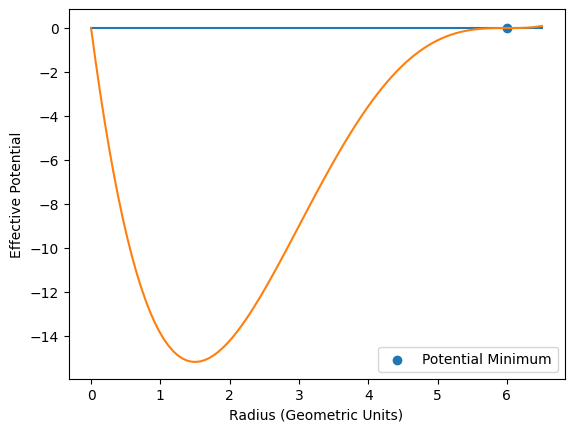

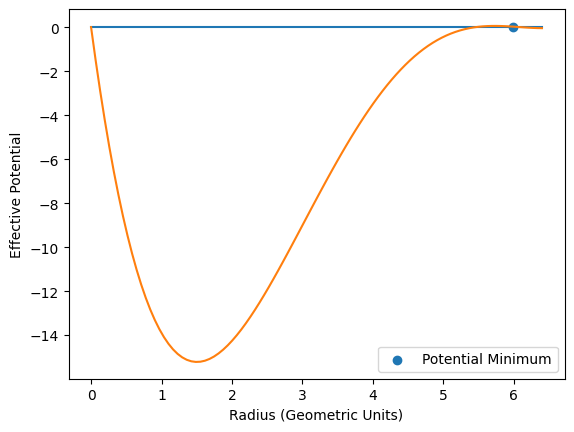

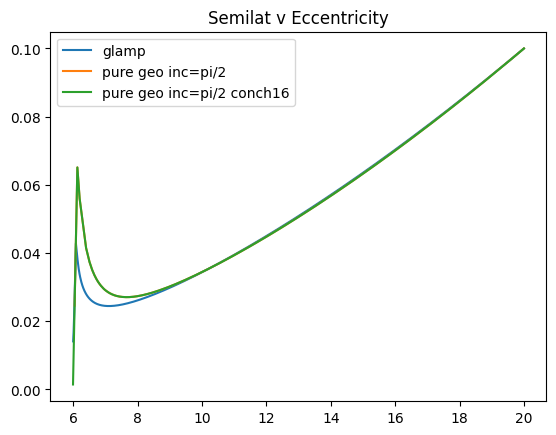

In [2]:
sim3 = ml.EMRIGenerator(0.0, 1e-3, endflag="radius < 2", params=[20/(1 - 0.1**2), 0.1, np.pi/2], bonk=3, label="pure geo inc=pi/2", trigger=2, err_target=1e-12)
sim4 = ml.EMRIGenerator(0.0, 1e-3, endflag="radius < 2", params=[20/(1 - 0.1**2), 0.1, np.pi/2], bonk=3, label="pure geo inc=pi/2 conch16", trigger=2, err_target=1e-12, conch=16)

fig, ax = plt.subplots()
for i in range(1):
    ax.plot(tests[i][:,1], tests[i][:,2], label="glamp")
ax.plot(sim3["p"], sim3["e"], label=sim3["name"])
ax.plot(sim4["p"], sim4["e"], label=sim4["name"])
#plt.scatter(test[:,1], test[:,2])
ax.legend()
ax.set_title("Semilat v Eccentricity")

5012 79886
0.9499532946074064


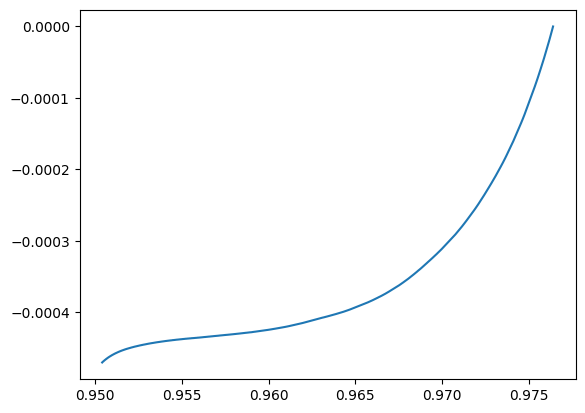

In [35]:
thing = np.linspace(tests[0][0,4], tests[0][-1,4], 100)
#print(thing)
print(len(sim["energy"]), len(tests[0][:,4]))
print(sim["energy"][-1])
#np.interp(tests[0][:,4], sim["energy"], sim["phi_momentum"])

#plt.plot(tests[0][:79100,4], tests[0][:79100,5])
#plt.plot(tests[0][:79100,4], np.flip(np.interp(np.flip(tests[0][:,4]), np.flip(sim["energy"]), np.flip(sim["phi_momentum"])))[:79100])

#plt.plot(sim["energy"], sim["phi_momentum"])
#plt.plot(tests[0][:,4], tests[0][:,5])

plt.plot(tests[0][:79000,4], tests[0][:79000,5]- np.flip(np.interp(np.flip(tests[0][:,4]), np.flip(sim["energy"]), np.flip(sim["phi_momentum"])))[:79000])

Sum inc=0.0: new=2.6235755703834185, old=2.6245801931057002, diff=-0.001004622722281745
Sum inc=0.0: new=-0.17352999287156093, old=-0.17254566136539176, diff=-0.000984331506169167
Sum inc=0.39: new=2.3003963683958375, old=2.300594353371007, diff=-0.0001979849751694296
Sum inc=0.39: new=-0.14567380129871346, old=-0.14599430965552584, diff=0.0003205083568123823
Sum inc=0.79: new=1.352714154488437, old=1.3528552159718528, diff=-0.00014106148341586078
Sum inc=0.79: new=-0.08511173729287635, old=-0.08539416680179054, diff=0.0002824295089141893
Sum inc=1.18: new=0.37676720798307317, old=0.37680102689390393, diff=-3.381891083076294e-05
Sum inc=1.18: new=-0.025134609861485267, old=-0.02535730911784777, diff=0.00022269925636250396
Sum inc=1.57: new=-1.228869092129159e-05, old=-1.057671258064552e-05, diff=-1.7119783406460698e-06
Sum inc=1.57: new=7.275929790134827e-05, old=7.317234032679261e-05, diff=-4.130424254443401e-07


Text(0.5, 1.0, 'zz component of Q_doubledot')

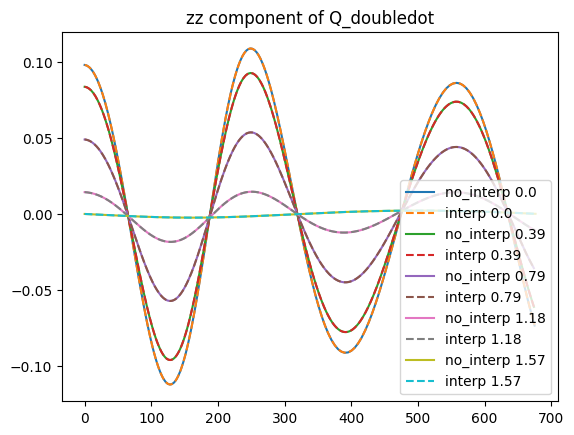

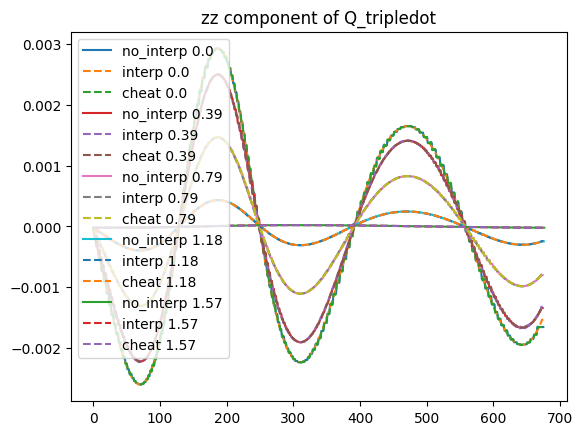

In [43]:
incs = np.arange(5)*np.pi/8
#print(incs)
#pure_geos = [ml.EMRIGenerator(0.0, 0.0, endflag="rad_orbit > 0.99", params=[20/(1 - 0.1**2), 0.1, inc], bonk=3, label="pure geo inc=pi/2", trigger=2, err_target=1e-12) for inc in incs]

int_stuff = [mm.interpolate(sim["raw"][:,1:4], sim["raw"][:, 0], False) for sim in pure_geos]
int_quads = [mm.trace_ortholize(thing[0]) for thing in int_stuff]
quads = [mm.trace_ortholize(sim["raw"][:,1:4]) for sim in pure_geos]
delta = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
int_cools = [quad - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad), delta) for quad in int_quads]
cools = [quad - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad), delta) for quad in quads]

int_dt2 = [mm.matrix_derive(int_cools[i], int_stuff[i][1], 2) for i in range(len(int_stuff))]
int_dt3 = [mm.matrix_derive(int_cools[i], int_stuff[i][1], 3) for i in range(len(int_stuff))]
#print(np.shape(cools[0]))
#print(np.shape(pure_geos[0]["raw"][:, 0]))
#print(np.shape(int_stuff[i]))
dt2 = [mm.matrix_derive2(cools[i], pure_geos[i]["raw"][:, 0], int_stuff[i][1], 2) for i in range(len(int_stuff))]
dt3 = [mm.matrix_derive2(cools[i], pure_geos[i]["raw"][:, 0], int_stuff[i][1], 3) for i in range(len(int_stuff))]
cheat_dt3 = [mm.matrix_derive2(dt2[i], int_stuff[i][1], int_stuff[i][1], 1) for i in range(len(int_stuff))]

fig1, ax1 = plt.subplots()
fig2, ax2 = plt.subplots()
a, b = 2, 2
for i in range(len(int_stuff)):
    ax1.plot(int_stuff[i][1], dt2[i][:,a,b], label="no_interp %s"%np.round(incs[i], 2))
    ax1.plot(int_stuff[i][1], int_dt2[i][:,a,b], label="interp %s"%np.round(incs[i], 2), linestyle="--")
    print("Sum inc=%s: new=%s, old=%s, diff=%s"%(np.round(incs[i], 2), np.sum(dt2[i][:,a,b]), np.sum(int_dt2[i][:,a,b]), np.sum(dt2[i][:,a,b]) - np.sum(int_dt2[i][:,a,b])))
    ax2.plot(int_stuff[i][1], dt3[i][:,a,b], label="no_interp %s"%np.round(incs[i], 2))
    ax2.plot(int_stuff[i][1], int_dt3[i][:,a,b], label="interp %s"%np.round(incs[i], 2), linestyle="--")
    ax2.plot(int_stuff[i][1], cheat_dt3[i][:,a,b], label="cheat %s"%np.round(incs[i], 2), linestyle="--")
    print("Sum inc=%s: new=%s, old=%s, diff=%s"%(np.round(incs[i], 2), np.sum(dt3[i][:,a,b]), np.sum(int_dt3[i][:,a,b]), np.sum(dt3[i][:,a,b]) - np.sum(int_dt3[i][:,a,b])))
ax1.legend()
ax2.legend()
#ax2.set_xlim(150, 220)
#ax2.set_ylim(0.000001, 0.003)
#ax1.set_xlim(230, 280)
#ax1.set_ylim(0.000001, 0.11)
ax2.set_title("zz component of Q_tripledot")
ax1.set_title("zz component of Q_doubledot")

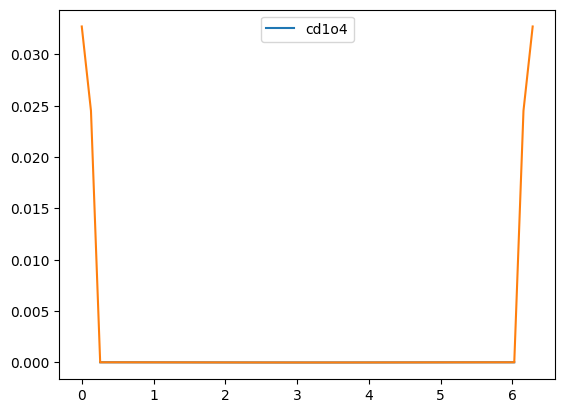

In [84]:
#Difference tester
t = np.linspace(0, 2*np.pi)

dt = np.mean(np.diff(t))
u = np.sin(t)

fig1, ax1 = plt.subplots()
#ax1.plot(t[1:], np.cos(t[1:]) - (u[1:] - u[:-1])/dt, label="ld1o1")
#ax1.plot(t[2:], np.cos(t[2:]) - (3*u[2:] - 4*u[1:-1] + u[:-2])/(2*dt), label="ld1o2")
#ax1.plot(t[:-1], np.cos(t[:-1]) - (u[1:] - u[:-1])/dt, label="rd1o1")
#ax1.plot(t[:-2], np.cos(t[:-2]) - (-3*u[:-2] + 4*u[1:-1] -u[2:])/(2*dt), label="rd1o2")
#ax1.plot(t[1:-1], np.cos(t[1:-1]) - (u[2:] - u[:-2])/(2*dt), label="cd1o2")
ax1.plot(t[2:-2], np.cos(t[2:-2]) - (-u[4:] + 8*u[3:-1] - 8*u[1:-3] + u[:-4])/(12*dt), label="cd1o4")
bop = np.interp(t, t[2:-2], (-u[4:] + 8*u[3:-1] - 8*u[1:-3] + u[:-4])/(12*dt))
#deg = 9
#bop[:3] = np.polyval(np.polyfit(t[3:10], bop[3:10], deg), t[:3])
#bop[-3:] = np.polyval(np.polyfit(t[-10:-3], bop[-10:-3], deg), t[-3:])
ax1.plot(t, np.cos(t) - bop)
ax1.legend()





In [ ]:
new_incs = np.pi*np.array([1/2, 1/4, 1/8, 1/16, 0.0])
hopes2 = [ml.EMRIGenerator(0.0, 1e-3, endflag="radius < 2", params=[20/(1 - 0.1**2), 0.1, inc], bonk=3, label="wink pure geo inc=%s"%(inc), trigger=2, err_target=1e-12) for inc in new_incs]

'''
op.plotvalue3(hopes2, "semilat", "ecc")
op.plotvalue3(hopes2, "semilat", "inc")
op.plotvalue3(hopes2, "tracktime", "semilat")
op.plotvalue3(hopes2, "tracktime", "semilat", derv=1)
op.plotvalue3(hopes2, "tracktime", "semilat", derv=2)
op.plotvalue3(hopes2, "tracktime", "ecc")
op.plotvalue3(hopes2, "tracktime", "ecc", derv=1)
op.plotvalue3(hopes2, "tracktime", "ecc", derv=2)
op.plotvalue3(hopes2, "tracktime", "inc")
op.plotvalue3(hopes2, "tracktime", "inc", derv=1)
op.plotvalue3(hopes2, "tracktime", "inc", derv=2)
op.plotvalue3(hopes2, "tracktime", "energy")
op.plotvalue3(hopes2, "tracktime", "energy", derv=1)
op.plotvalue3(hopes2, "tracktime", "energy", derv=2)
op.plotvalue3(hopes2, "tracktime", "approx_L")
op.plotvalue3(hopes2, "tracktime", "approx_L", derv=1)
op.plotvalue3(hopes2, "tracktime", "approx_L", derv=2)
'''

print(len(hopes2))
for i in range(1):
    plt.plot(tests[i][:,1], tests[i][:,2], label="glamp")
for i in range(len(new_incs)):
    plt.plot(hopes2[i]["p"], hopes2[i]["e"], label="shiny %s"%np.round(new_incs[i]%3))
plt.legend()
plt.title("p vs e")

new


  0%|          | 0/10000000 [00:00<?, ?it/s]c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\matplotlib\cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\matplotlib\cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)
 11%|█         | 1109633.6559910583/10000000 [00:07<00:59, 149368.89it/s]


[19.89338828 10.66223329  1.16830201]
[19.89338828 10.66223329  1.16830201]
[ -0.18913171   6.         -46.86799985  46.86799985]
[19.89338828 10.66223329  1.16830201]
sta
19.893388284954945 [19.89338828 10.66223329  1.16830201]
ROOTER
(array([-4.97379915e-14+0.j        ,  2.50308787e+00+0.j        ,
        1.98977385e+01+0.28409644j,  1.98977385e+01-0.28409644j]), array([ 1.16830201+0.j, 10.66223329+0.j, 19.89338828+0.j]), array([-470.83381462+0.j,    0.        +0.j,    0.        +0.j,
        470.83381462+0.j]))
(-1.3205462239133656+0j) -1e-12 whoops

Ending program
new


 11%|█         | 1109877.0198112847/10000000 [00:15<02:06, 70412.46it/s]  


[19.90398795 10.66382631  1.16824635]
[19.90398795 10.66382631  1.16824635]
[ -0.18905938   6.         -46.8798086   46.8798086 ]
[19.90398795 10.66382631  1.16824635]
sta
19.903987945359688 [19.90398795 10.66382631  1.16824635]
ROOTER
(array([1.24344979e-14+0.j        , 2.50290019e+00+0.j        ,
       1.99059236e+01-0.18957692j, 1.99059236e+01+0.18957692j]), array([ 1.16824635+0.j, 10.66382631+0.j, 19.90398795+0.j]), array([-471.16285304+0.j,   -0.70710596+0.j,    0.70710596+0.j,
        471.16285304+0.j]))
(-0.5883976592688327+0j) -1e-12 whoops

Ending program
new


 11%|█         | 1109877.6178419124/10000000 [00:05<00:41, 214091.38it/s]



Ending program
new


 11%|█         | 1109871.0032363236/10000000 [00:13<00:00, 9347224.44it/s]

c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\matplotlib\cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\matplotlib\cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


Text(0.5, 1.0, 'p vs e')

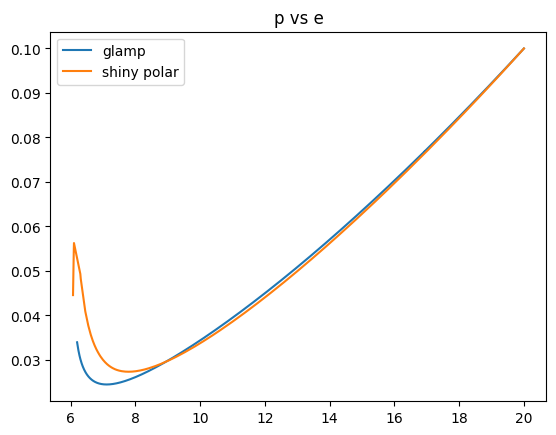

In [15]:
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt

def root_getter_oof(E, L, C, spin):
    a, b, c, d, e = np.array([(E**2 - 1.0), 2.0, ((spin**2)*(E**2 - 1.0) - L**2 - C),  (2*((L - spin*E)**2) + 2*C), -(spin**2)*C]).astype(complex)
    #print(a,b,c,d,e)
    p1 = 2*(c**3) - 9*b*c*d + 27*a*(d**2) + 27*(b**2)*e - 72*a*c*e
    p2 = p1 + (-4*(c**2 - 3*b*d + 12*a*e)**3 + p1**2)**0.5
    p3 = (c**2 - 3*b*d + 12*a*e)/(3*a*((0.5*p2)**(1/3))) + ((0.5*p2)**(1/3))/(3*a)
    p4 = ((b**2)/(4*(a**2)) - (2*c)/(3*a) + p3)**(0.5)
    p5 = (b**2)/(2*(a**2)) - (4*c)/(3*a) - p3
    p6 = (-(b**3)/(a**3) + (4*b*c)/(a**2) - 8*d/a)/(4*p4)
    x1 = -b/(4*a) - p4/2 - 0.5*((p5 - p6)**0.5)
    x2 = -b/(4*a) - p4/2 + 0.5*((p5 - p6)**0.5)
    x3 = -b/(4*a) + p4/2 - 0.5*((p5 + p6)**0.5)
    x4 = -b/(4*a) + p4/2 + 0.5*((p5 + p6)**0.5) 
    turns = np.array([np.real(num) if np.abs(np.imag(num)) < 1e-12 else num for num in [x1, x2, x3, x4]]).astype(complex)
    
    try:
        flats = np.roots([4*a,3*b,2*c,d])
    except:
        print(a,b,c,d,e)
        print(E, L, C, L**2, np.sqrt(L**2 + C))
        flats = np.array([float(input("number baybee: ")) for i in range(5)])
    flats = np.array([np.real(num) if np.abs(np.imag(num)) < 1e-12 else num for num in flats]).astype(complex)
    
    a, b, c, d, e = np.array([(a**2)*(1 - E**2), 0.0, -(C + (a**2)*(1 - E**2) + L**2), 0.0, C]).astype(complex)
    p1 = 2*(c**3) - 9*b*c*d + 27*a*(d**2) + 27*(b**2)*e - 72*a*c*e
    p2 = p1 + (-4*(c**2 - 3*b*d + 12*a*e)**3 + p1**2)**0.5
    p3 = (c**2 - 3*b*d + 12*a*e)/(3*a*((0.5*p2)**(1/3))) + ((0.5*p2)**(1/3))/(3*a)
    p4 = ((b**2)/(4*(a**2)) - (2*c)/(3*a) + p3)**(0.5)
    p5 = (b**2)/(2*(a**2)) - (4*c)/(3*a) - p3
    p6 = (-(b**3)/(a**3) + (4*b*c)/(a**2) - 8*d/a)/(4*p4)
    x1 = -b/(4*a) - p4/2 - 0.5*((p5 - p6)**0.5)
    x2 = -b/(4*a) - p4/2 + 0.5*((p5 - p6)**0.5)
    x3 = -b/(4*a) + p4/2 - 0.5*((p5 + p6)**0.5)
    x4 = -b/(4*a) + p4/2 + 0.5*((p5 + p6)**0.5) 
    zs = np.array([np.real(num) if np.abs(np.imag(num)) < 1e-5 else num for num in [x1, x2, x3, x4]]).astype(complex)
    
    return np.sort(turns), np.sort(flats), np.sort(zs)

def glamper(p, e, i, a, mu, frac):
    b = (64/5)*mu*(1 + mu)
    full = ((p/(1 - e**2))**4)/(4*b)
    dt = full*frac
    E, L, C = mm.schmidtparam3(p/(1 - e**2), e, i, a)
    print(E, L, C)
    cosi = L/np.sqrt(L**2 + C)
    f1 = lambda x: 1 + (73/24)*(x**2) + (37/96)*(x**4)
    f2 = lambda x: 73/12 + (823/24)*(x**2) + (949/32)*(x**4) + (491/192)*(x**6)
    f3 = lambda x: 1 + (7/8)*(x**2)
    f4 = lambda x: 61/24 + (63/8)*(x**2) + (94/64)*(x**4)
    f5 = lambda x: 61/8 + (91/4)*(x**2) + (461/64)*(x**4)
    f6 = lambda x: 97/12 + (37/2)*(x**2) + (211/32)*(x**4)
    vals = [[0, p, e, cosi, E, L, C]]
    p0 = p
    while p/(1 + e) > mm.find_rms(a):
        E_dot = (-32/5)*(mu**2)*(p**(-5))*((1 - e**2)**(3/2))*(f1(e) - a*(p**(-3/2))*cosi*f2(e))
        L_dot = (-32/5)*(mu**2)*(p**(-7/2))*((1 - e**2)**(3/2))*(cosi*f3(e) + a*(p**(-3/2))*(f4(e) - (cosi**2)*f5(e)))
        Q_dot = (-64/5)*(mu**3)*(p**(-3))*((1 - e**2)**(3/2))*(f3(e) - a*(p**(-3/2))*cosi*f6(e))
        C_dot = 2*(C/L)*L_dot if L != 0 else Q_dot - 2*L*L_dot
        E += E_dot*dt
        L += L_dot*dt
        C += C_dot*dt
        turns, flats, zs = root_getter_oof(E, L, C, a)
        turns = np.real(turns)
        e = (turns[-1] - turns[-2])/(turns[-1] + turns[-2])
        cosi = L/np.sqrt(L**2 + C)
        p = 0.5*(turns[-1] + turns[-2])*(1 - e**2)
        vals.append([vals[-1][0] + dt, p, e, cosi, E, L, C])
        if p < 0.9*p0:
            #print(p)
            p0 = p
        #print(p, e, cosi)
    return np.array(vals)
#polar = ml.EMRIGenerator(0.0, 1e-3, endflag="radius < 2", params=[20/(1 - 0.1**2), 0.1, np.pi/2], bonk=3, label="wink pure geo inc=%s"%(np.pi/2), trigger=2, err_target=1e-12)
#test = glamper(20, 0.1, np.pi/2, 0.0, 1e-3, 10**(-2))
#rint(len(hopes2))
plt.plot(test[:,1], test[:,2], label="glamp")
plt.plot(polar["p"], polar["e"], label="shiny polar")
plt.legend()
plt.title("p vs e")

C:\Users\camcinto\AppData\Local\Temp\1\ipykernel_25448\3331828519.py:42: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\matplotlib\cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\matplotlib\cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)
C:\Users\camcinto\AppData\Local\Temp\1\ipykernel_25448\3331828519.py:53: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


'\nfor dataset in big_data:\n    fig, ax = plt.subplots()\n    for sim in dataset[1]:\n        ax.plot(sim["energy"], np.sqrt(sim["phi_momentum"]**2 + sim["carter"]), label=sim["name"][5:])\n    ax.plot(dataset[0][:,4], np.sqrt(dataset[0][:,5]**2 + dataset[0][:,6]), label="glamp", linestyle="--")\n    ax.legend()\n    ax.set_title("EvL Spin = %s"%dataset[2])\n    fig.show()\n'

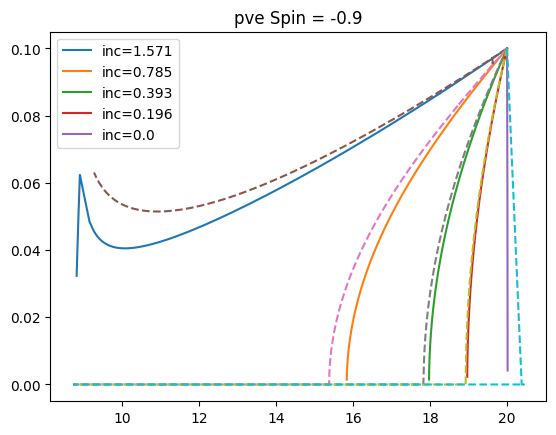

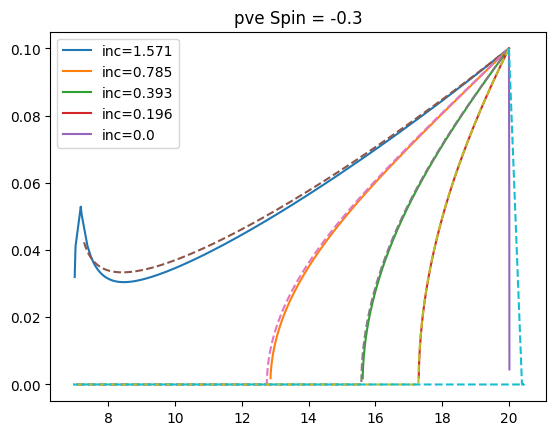

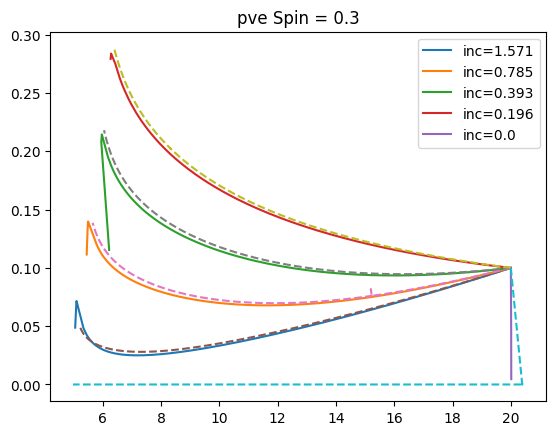

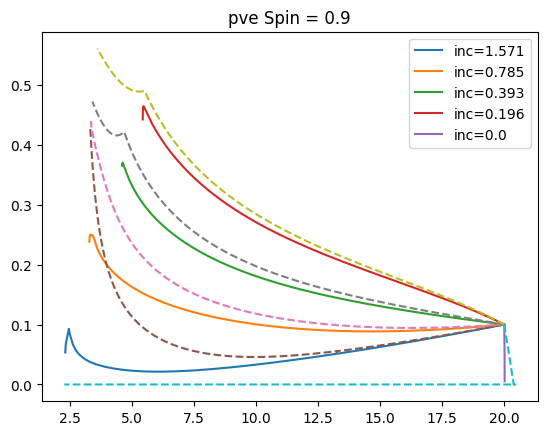

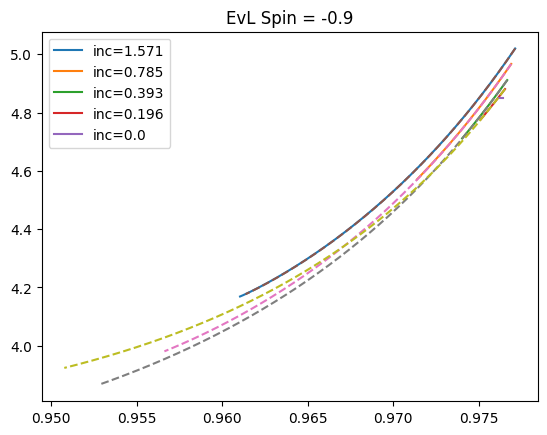

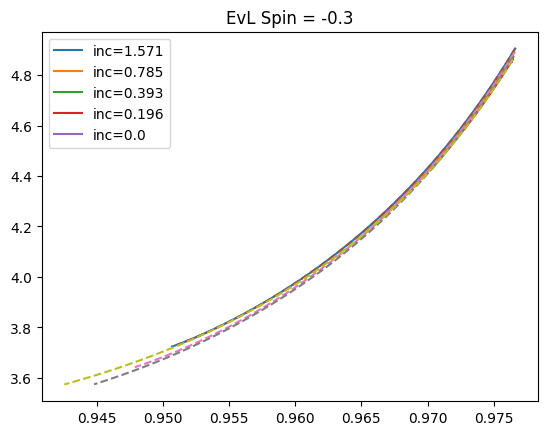

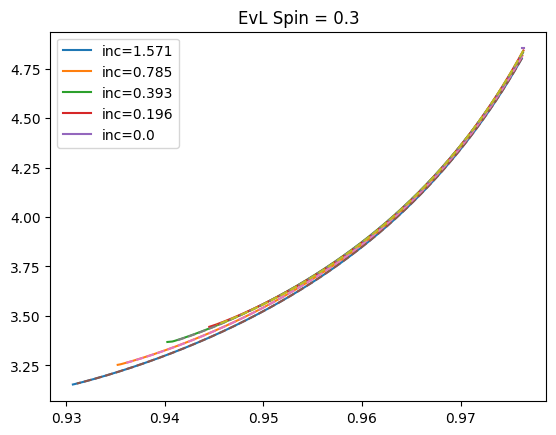

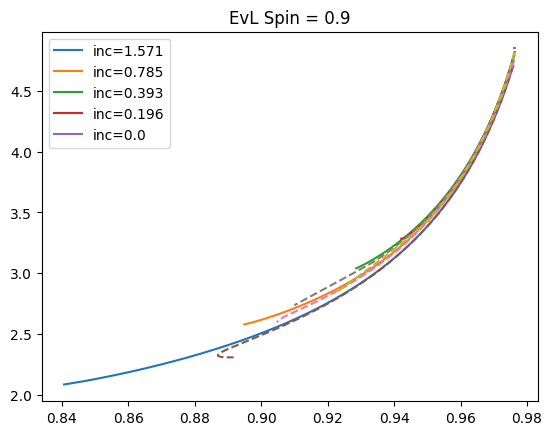

In [45]:
'''
#test = glamper(20, 0.1, np.pi/2, 0.0, 1e-3, 10**(-2))
plt.plot(test[:,1], test[:,2], label="glamp")
print(len(test))
p, e = test[57743][1:3]
test2 = glamper(p, e, np.pi/2, 0.0, 1e-3, 10**(-3))
plt.plot(test2[:,1], test2[:,2], label="glamp")
'''
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt

def inc_shows(p, e, a, mu):
    test = glamper(p, e, np.pi/2, a, mu, 10**(-2))
    incs = np.pi*np.array([1/2, 1/4, 1/8, 1/16, 0.0])
    sims = [ml.EMRIGenerator(a, mu, endflag="radius < 2", params=[p/(1 - e**2), e, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 3)), trigger=2, err_target=1e-12) for inc in incs]
    #fig, ax = plt.subplots()
    #for sim in sims:
    #    ax.plot(sim["p"], sim["e"], label=sim["name"][5:])
    #ax.plot(test[:,1], test[:,2], label="glamp", linestyle="--")
    #ax.legend()
    #ax.set_title("Spin = %s"%a)
    #fig.show()
    return test, sims, a

spins = [-0.9, -0.3, 0.3, 0.9]

#big_data = [inc_shows(20, 0.1, a, 1e-3) for a in spins]
#glamp_add = [[glamper(20, 0.1, inc, a, 1e-3, 10**(-2)) for inc in np.pi*np.array([1/2, 1/4, 1/8, 1/16, 0.0])] for a in spins]

for i in range(len(big_data)):
    fig, ax = plt.subplots()
    for sim in big_data[i][1]:
        ax.plot(sim["p"], sim["e"], label=sim["name"][5:])
    for sim in glamp_add[i]:
        ax.plot(sim[:,1], sim[:,2], linestyle="--")
    #ax.plot(dataset[0][:,1], dataset[0][:,2], label="glamp", linestyle="--")
    ax.legend()
    ax.set_title("pve Spin = %s"%big_data[i][2])
    fig.show()

for i in range(len(big_data)):
    fig, ax = plt.subplots()
    for sim in big_data[i][1]:
        ax.plot(sim["energy"], np.sqrt(sim["phi_momentum"]**2 + sim["carter"]), label=sim["name"][5:])
    for sim in glamp_add[i][:-1]:
        ax.plot(sim[:,4], np.sqrt(sim[:,5]**2 + sim[:,6]), linestyle="--")
    #ax.plot(dataset[0][:,1], dataset[0][:,2], label="glamp", linestyle="--")
    ax.legend()
    ax.set_title("EvL Spin = %s"%big_data[i][2])
    fig.show()
'''
for dataset in big_data:
    fig, ax = plt.subplots()
    for sim in dataset[1]:
        ax.plot(sim["energy"], np.sqrt(sim["phi_momentum"]**2 + sim["carter"]), label=sim["name"][5:])
    ax.plot(dataset[0][:,4], np.sqrt(dataset[0][:,5]**2 + dataset[0][:,6]), label="glamp", linestyle="--")
    ax.legend()
    ax.set_title("EvL Spin = %s"%dataset[2])
    fig.show()
'''

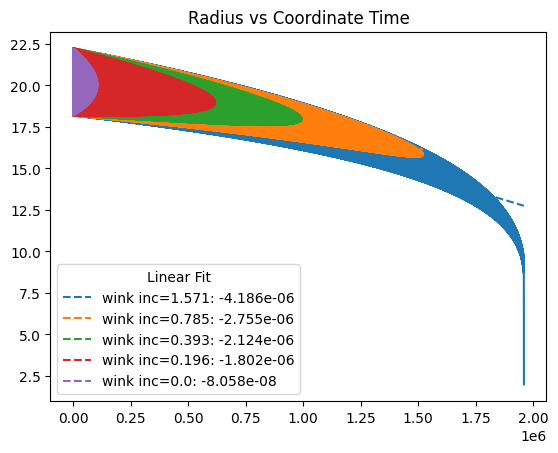

c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


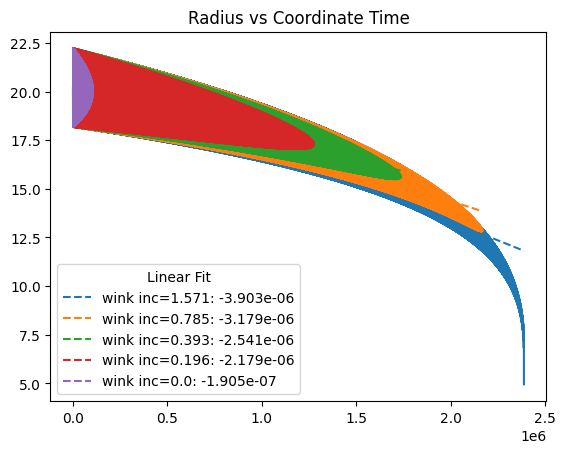

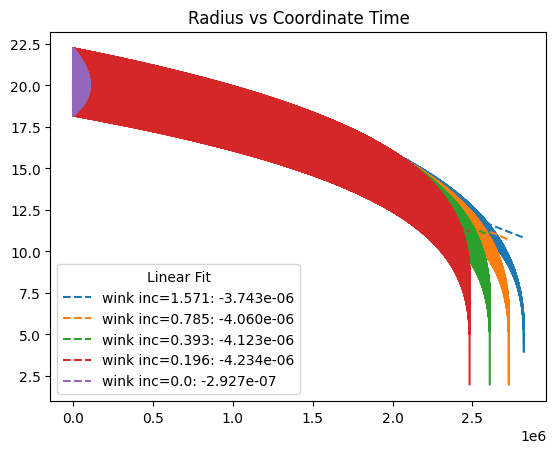

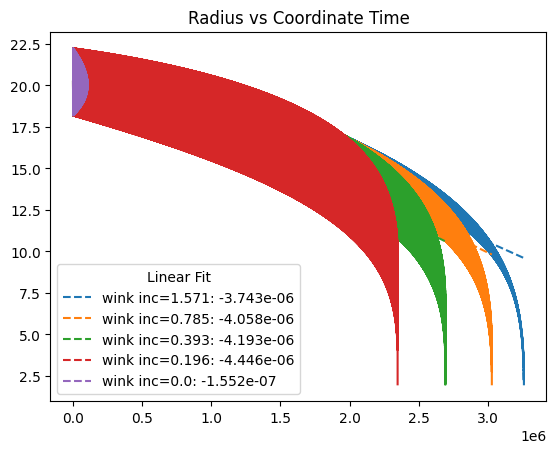

In [46]:
for i in range(len(spins)):
    op.plotvalue3(big_data[i][1], "time", "radius")


In [44]:
bruh1 = [glamper(20, 0.4, np.pi/2, 0.5, 1e-4, 1e-3),
        glamper(20, 0.99, np.pi/2, 0.5, 1e-4, 1e-3),
        glamper(14, 0.99, np.pi/2, 0.5, 1e-4, 1e-3),
        glamper(10, 0.99, np.pi/2, 0.5, 1e-4, 1e-3)]

bruh2 = [glamper(20, 0.4, np.pi/2, 0.9, 1e-4, 1e-3),
        glamper(20, 0.99, np.pi/2, 0.9, 1e-4, 1e-3),
        glamper(14, 0.99, np.pi/2, 0.9, 1e-4, 1e-3),
        glamper(10, 0.99, np.pi/2, 0.9, 1e-4, 1e-3)]

bruh3 = [glamper(20, 0.4, np.pi/2, -0.5, 1e-4, 1e-3),
        glamper(20, 0.99, np.pi/2, -0.5, 1e-4, 1e-3),
        glamper(14, 0.99, np.pi/2, -0.5, 1e-4, 1e-3),
        glamper(10, 0.99, np.pi/2, -0.5, 1e-4, 1e-3)]

bruh4 = [glamper(20, 0.4, np.pi/2, -0.9, 1e-4, 1e-3),
        glamper(20, 0.99, np.pi/2, -0.9, 1e-4, 1e-3),
        glamper(14, 0.99, np.pi/2, -0.9, 1e-4, 1e-3),
        glamper(10, 0.99, np.pi/2, -0.9, 1e-4, 1e-3)]

fig, ax = plt.subplots()
for thing in bruh1:
    plt.plot(thing[:,1], thing[:,2])
ax.set_title("a = 0.5 prograde")
fig.show()

fig, ax = plt.subplots()
for thing in bruh2:
    plt.plot(thing[:,1], thing[:,2])
ax.set_title("a = 0.9 prograde")
fig.show()

fig, ax = plt.subplots()
for thing in bruh3:
    plt.plot(thing[:,1], thing[:,2])
ax.set_title("a = 0.5 retrograde")
fig.show()

fig, ax = plt.subplots()
for thing in bruh4:
    plt.plot(thing[:,1], thing[:,2])
ax.set_title("a = 0.9 retrograde")
fig.show()

0.979606027113292 4.786044524330666 0.0


KeyboardInterrupt: 

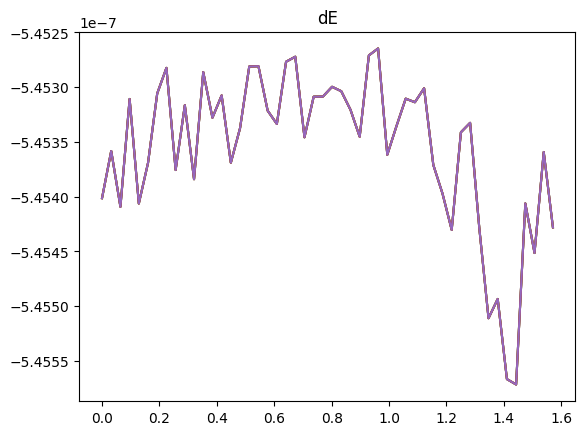

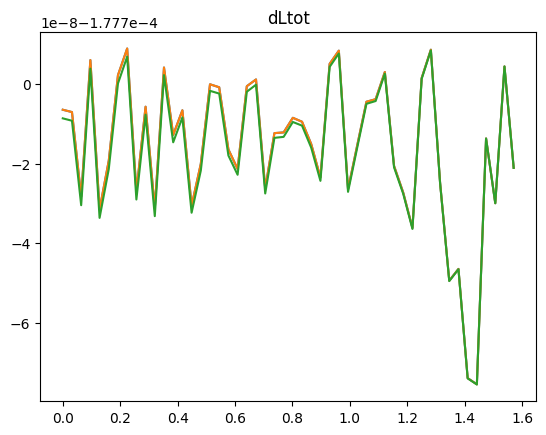

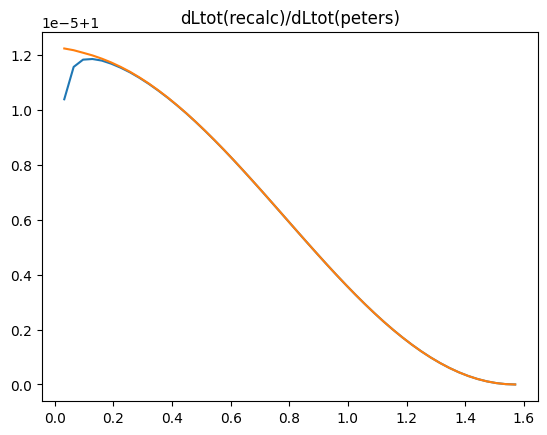

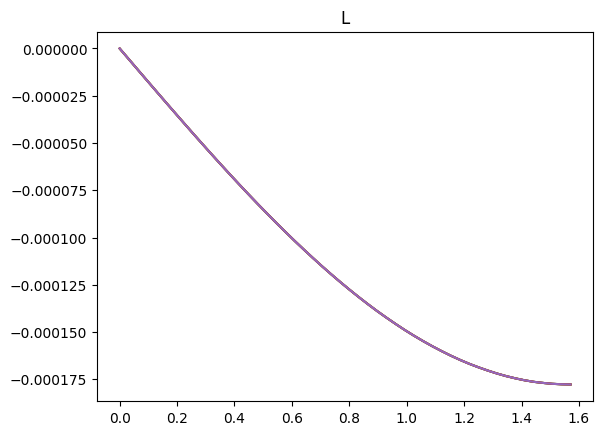

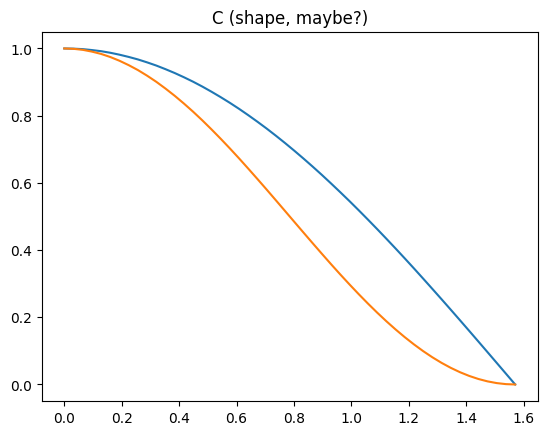

In [128]:
def peters_integrate6_4_full(states, a, mu, ind1, ind2):
    '''
    Calculates change in characteristic orbital values from path of test particle through space 

    Parameters
    ----------
    states : N x 8 numpy array of floats
        list of state vectors - [4-position, 4-velocity] in geometric units
    a : int/float
        dimensionless spin constant of black hole, between 0 and 1 inclusive
    mu : float
        mass ratio of test particle to central body
    ind1 : int
        index value of the first entry in states relative to the master state list in clean_inspiral
    ind2 : int
        index value of the last entry in states relative to the master state list in clean_inspiral

    Returns
    -------
     4-element numpy array of floats
        change in orbital characteristics (energy, cartesian components of L) per unit mass 
    '''
    #dedt, dldt = 0, np.array([0.0, 0.0, 0.0])
    if (ind2 - ind1) > 2:
        states = np.array(states)
        sphere, time = states[:, 1:4], states[:, 0]
        int_sphere, int_time = mm.interpolate(sphere, time, False)
        div = np.mean(np.diff(int_time))
        quad = mm.trace_ortholize(sphere)
        delta = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
        coolquad = quad - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad), delta)
        dt2, dt3 = mm.matrix_derive3(coolquad, time, int_time)
        levciv = np.array([[[0, 0, 0],   #Levi-civita tensor
                            [0, 0, 1],
                            [0, -1, 0]],
                           [[0, 0, -1],
                            [0, 0, 0],
                            [1, 0, 0]],
                           [[0, 1, 0],
                            [-1, 0, 0],
                            [0, 0, 0]]])
        dedt = (-1/5)*(np.einsum('ijk,ijk ->i', dt3, dt3) - (1/3)*np.einsum('ijj,ikk ->i', dt3, dt3))
        dldt = (-2/5)*np.einsum("ijk, ljm, lkm -> li", levciv, dt2, dt3)
        dE = np.sum(dedt*div)*mu
        dLx, dLy, dLz = np.sum(dldt*div, axis=0)*mu
        #print(dE, np.sqrt(dLx**2 + dLy**2 + dLz**2))
        #print(len(time), time[-1]-time[0], dE, np.linalg.norm([dLx, dLy, dLz]))
    return np.array([dE, dLx, dLy, dLz])
    #return quad

def peters_integrate6_4_small(states, a, mu, ind1, ind2):
    '''
    Calculates change in characteristic orbital values from path of test particle through space 

    Parameters
    ----------
    states : N x 8 numpy array of floats
        list of state vectors - [4-position, 4-velocity] in geometric units
    a : int/float
        dimensionless spin constant of black hole, between 0 and 1 inclusive
    mu : float
        mass ratio of test particle to central body
    ind1 : int
        index value of the first entry in states relative to the master state list in clean_inspiral
    ind2 : int
        index value of the last entry in states relative to the master state list in clean_inspiral

    Returns
    -------
     4-element numpy array of floats
        change in orbital characteristics (energy, cartesian components of L) per unit mass 
    '''
    #dedt, dldt = 0, np.array([0.0, 0.0, 0.0])
    if (ind2 - ind1) > 2:
        states = np.array(states)
        sphere, time = states[:, 1:4], states[:, 0]
        int_sphere, int_time = mm.interpolate(sphere, time, False)
        div = np.mean(np.diff(int_time))
        quad = mm.trace_ortholize(sphere)
        delta = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
        coolquad = quad - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad), delta)
        dt2, dt3 = mm.matrix_derive3(coolquad, time, int_time)
        levciv = np.array([[[0, 0, 0],   #Levi-civita tensor
                            [0, 0, 1],
                            [0, -1, 0]],
                           [[0, 0, -1],
                            [0, 0, 0],
                            [1, 0, 0]],
                           [[0, 1, 0],
                            [-1, 0, 0],
                            [0, 0, 0]]])
        dedt = (-1/5)*(np.einsum('ijk,ijk ->i', dt3, dt3))
        dldt = (-2/5)*np.einsum("ijk, ljm, lkm -> li", levciv, dt2, dt3)
        dE = np.sum(dedt*div)*mu
        dLx, dLy, dLz = np.sum(dldt*div, axis=0)*mu
        #print(dE, np.sqrt(dLx**2 + dLy**2 + dLz**2))
        #print(len(time), time[-1]-time[0], dE, np.linalg.norm([dLx, dLy, dLz]))
    return np.array([dE, dLx, dLy, dLz])
    #return quad

test_incs = np.linspace(0.0, np.pi/2)
#pure_geos = [ml.EMRIGenerator(0.0, 0.0, endflag="rad_orbit > 10", params=[50/(1-0.2**2), 0.2, inc], bonk=3, label="pure geo inc=%s"%(inc), trigger=2, err_target=1e-12) for inc in test_incs]
peter_stuff_full = [peters_integrate6_4_full(sim["raw"], 0.0, 1e-3, 0, 10) for sim in pure_geos]
peter_stuff_small = [peters_integrate6_4_small(sim["raw"], 0.0, 1e-3, 0, 10) for sim in pure_geos]
recalc_full = np.array([mm.new_recalc_state6([pure_geos[i]["energy"][0], pure_geos[i]["phi_momentum"][0], pure_geos[i]["carter"][0]], peter_stuff_full[i], pure_geos[i]["raw"][-1], 0.0)[1] for i in range(len(test_incs))])
recalc_small = np.array([mm.new_recalc_state6([pure_geos[i]["energy"][0], pure_geos[i]["phi_momentum"][0], pure_geos[i]["carter"][0]], peter_stuff_small[i], pure_geos[i]["raw"][-1], 0.0)[1] for i in range(len(test_incs))])
recalc_haha = np.array([mm.new_recalc_state9([pure_geos[i]["energy"][0], pure_geos[i]["phi_momentum"][0], pure_geos[i]["carter"][0]], peter_stuff_small[i], pure_geos[i]["raw"][-1], 0.0)[1] for i in range(len(test_incs))])

plt.plot(test_incs, [sim[0] for sim in peter_stuff_full], label="peters dE")
#plt.plot(test_incs, [sim[0] for sim in peter_stuff_small])
plt.plot(test_incs, recalc_full[:,0] - np.array([pure_geos[i]["energy"][0] for i in range(len(test_incs))]), label="recalc_state dE")
#plt.plot(test_incs, recalc_small[:,0] - np.array([pure_geos[i]["energy"][0] for i in range(len(test_incs))]))
#plt.plot(test_incs, recalc_haha[:,0] - np.array([pure_geos[i]["energy"][0] for i in range(len(test_incs))]))
plt.title("dE")
plt.show()
plt.plot(test_incs, [-np.linalg.norm(sim[1:]) for sim in peter_stuff_full], label="peters dL")
#plt.plot(test_incs, [-np.linalg.norm(sim[1:]) for sim in peter_stuff_small])
#plt.plot(test_incs[:], np.sqrt(recalc_full[:,1]**2 + recalc_full[:,2]) - np.array([np.sqrt(pure_geos[i]["phi_momentum"][0]**2 + pure_geos[i]["carter"][0]) for i in range(len(test_incs))]))
#plt.plot(test_incs[:], np.sqrt(recalc_small[:,1]**2 + recalc_small[:,2]) - np.array([np.sqrt(pure_geos[i]["phi_momentum"][0]**2 + pure_geos[i]["carter"][0]) for i in range(len(test_incs))]))
plt.plot(test_incs[:], np.sqrt(recalc_haha[:,1]**2 + recalc_haha[:,2]) - np.array([np.sqrt(pure_geos[i]["phi_momentum"][0]**2 + pure_geos[i]["carter"][0]) for i in range(len(test_incs))]), label="recalc_state dL")
plt.title("dLtot")
plt.show()

#LOOK LOOK DO YOU SEE??
#LOOK CLOSER
plt.plot(test_incs[1:], (np.array([-np.linalg.norm(sim[1:]) for sim in peter_stuff_full[1:]])/(np.sqrt(recalc_full[1:,1]**2 + recalc_full[1:,2]) - np.array([np.sqrt(pure_geos[i+1]["phi_momentum"][0]**2 + pure_geos[i+1]["carter"][0]) for i in range(len(test_incs)-1)])))**(-1))
plt.plot(test_incs[1:], (np.array([-np.linalg.norm(sim[1:]) for sim in peter_stuff_full[1:]])/(np.sqrt(recalc_haha[1:,1]**2 + recalc_haha[1:,2]) - np.array([np.sqrt(pure_geos[i+1]["phi_momentum"][0]**2 + pure_geos[i+1]["carter"][0]) for i in range(len(test_incs)-1)])))**(-1))
plt.title("dLtot(recalc)/dLtot(peters)")
plt.show()

#FOR WHATEVER REASON, THE NEW_RECALC_STATE FUNCTION SLIGHTLY ENHANCES THE LOSS OF ANGULAR MOMENTUM AT HIGHER ECCENTRICITIES
#AT ZERO SPIN THIS LOOKS LIKE NOTHING, BUT WHAT ABOUT NONZERO SPIN???

#CHECK STUFF L COMPONENTS
plt.plot(test_incs, [sim[3] for sim in peter_stuff_full])
plt.plot(test_incs, [sim[3] for sim in peter_stuff_small])
plt.plot(test_incs[:], recalc_full[:,1] - np.array([pure_geos[i]["phi_momentum"][0] for i in range(len(test_incs))]))
plt.plot(test_incs[:], recalc_small[:,1] - np.array([pure_geos[i]["phi_momentum"][0] for i in range(len(test_incs))]))
plt.plot(test_incs[:], recalc_haha[:,1] - np.array([pure_geos[i]["phi_momentum"][0] for i in range(len(test_incs))]))
plt.title("L")
plt.show()
plt.plot(test_incs, np.array([-np.linalg.norm(sim[1:3]) for sim in peter_stuff_full])/np.min([-np.linalg.norm(sim[1:3]) for sim in peter_stuff_full]))
#plt.plot(test_incs, [-np.linalg.norm(sim[1:3]) for sim in peter_stuff_small])
#plt.plot(test_incs[:], (recalc_full[:,2] - np.array([pure_geos[i]["carter"][0] for i in range(len(test_incs))]))/np.min(recalc_full[:,2] - np.array([pure_geos[i]["carter"][0] for i in range(len(test_incs))])))
plt.plot(test_incs[:], (recalc_haha[:,2] - np.array([pure_geos[i]["carter"][0] for i in range(len(test_incs))]))/np.min(recalc_haha[:,2] - np.array([pure_geos[i]["carter"][0] for i in range(len(test_incs))])))
#plt.plot(test_incs[1:], recalc_small[1:,2] - np.array([pure_geos[i+1]["carter"][0] for i in range(len(test_incs)-1)]))
#Not exactly C, but comparing the shape at least?
plt.title("C (shape, maybe?)")
plt.show()

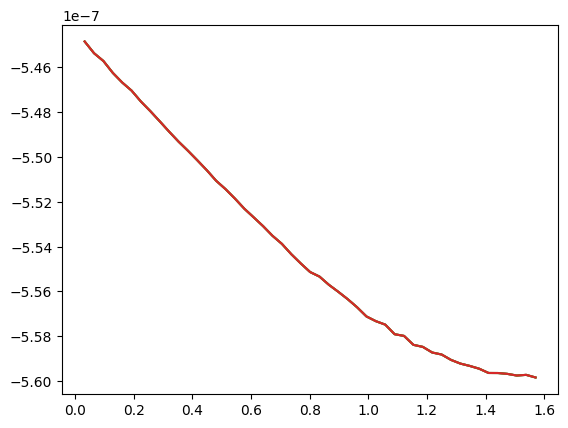

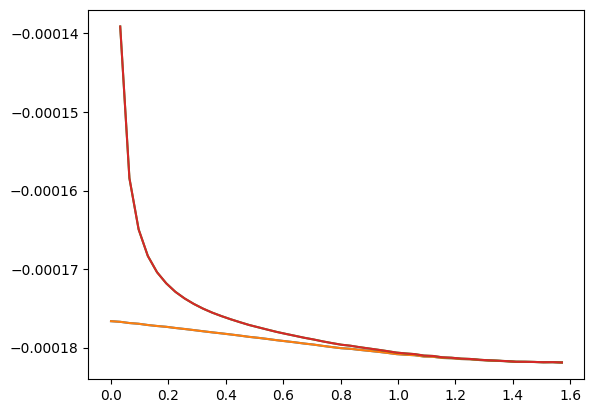

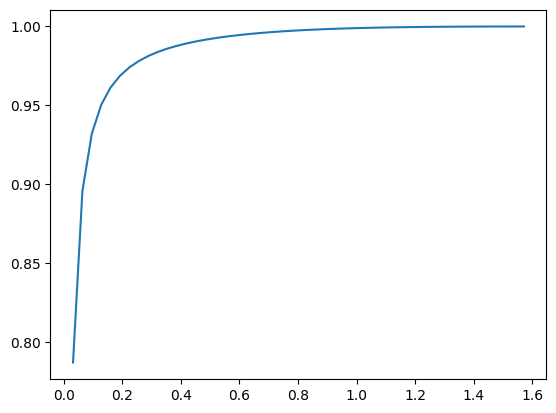

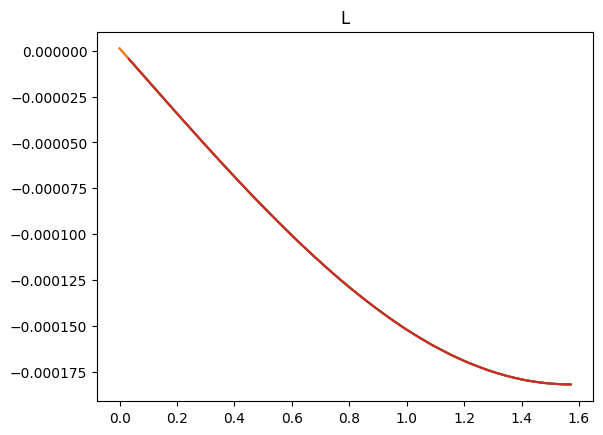

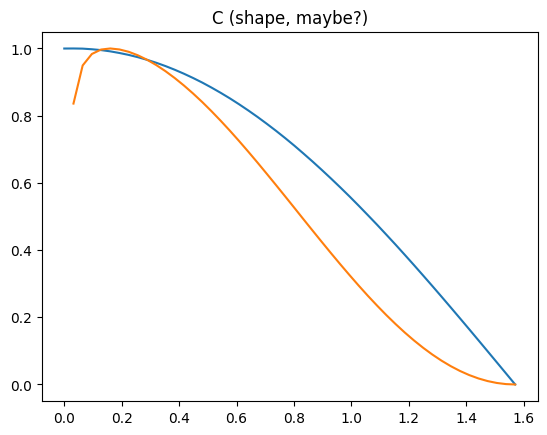

In [119]:
def peters_integrate6_4_full(states, a, mu, ind1, ind2):
    '''
    Calculates change in characteristic orbital values from path of test particle through space 

    Parameters
    ----------
    states : N x 8 numpy array of floats
        list of state vectors - [4-position, 4-velocity] in geometric units
    a : int/float
        dimensionless spin constant of black hole, between 0 and 1 inclusive
    mu : float
        mass ratio of test particle to central body
    ind1 : int
        index value of the first entry in states relative to the master state list in clean_inspiral
    ind2 : int
        index value of the last entry in states relative to the master state list in clean_inspiral

    Returns
    -------
     4-element numpy array of floats
        change in orbital characteristics (energy, cartesian components of L) per unit mass 
    '''
    #dedt, dldt = 0, np.array([0.0, 0.0, 0.0])
    if (ind2 - ind1) > 2:
        states = np.array(states)
        sphere, time = states[:, 1:4], states[:, 0]
        int_sphere, int_time = mm.interpolate(sphere, time, False)
        div = np.mean(np.diff(int_time))
        quad = mm.trace_ortholize(sphere)
        delta = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
        coolquad = quad - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad), delta)
        dt2, dt3 = mm.matrix_derive3(coolquad, time, int_time)
        levciv = np.array([[[0, 0, 0],   #Levi-civita tensor
                            [0, 0, 1],
                            [0, -1, 0]],
                           [[0, 0, -1],
                            [0, 0, 0],
                            [1, 0, 0]],
                           [[0, 1, 0],
                            [-1, 0, 0],
                            [0, 0, 0]]])
        dedt = (-1/5)*(np.einsum('ijk,ijk ->i', dt3, dt3) - (1/3)*np.einsum('ijj,ikk ->i', dt3, dt3))
        dldt = (-2/5)*np.einsum("ijk, ljm, lkm -> li", levciv, dt2, dt3)
        dE = np.sum(dedt*div)*mu
        dLx, dLy, dLz = np.sum(dldt*div, axis=0)*mu
        #print(dE, np.sqrt(dLx**2 + dLy**2 + dLz**2))
        #print(len(time), time[-1]-time[0], dE, np.linalg.norm([dLx, dLy, dLz]))
    return np.array([dE, dLx, dLy, dLz])
    #return quad

def peters_integrate6_4_small(states, a, mu, ind1, ind2):
    '''
    Calculates change in characteristic orbital values from path of test particle through space 

    Parameters
    ----------
    states : N x 8 numpy array of floats
        list of state vectors - [4-position, 4-velocity] in geometric units
    a : int/float
        dimensionless spin constant of black hole, between 0 and 1 inclusive
    mu : float
        mass ratio of test particle to central body
    ind1 : int
        index value of the first entry in states relative to the master state list in clean_inspiral
    ind2 : int
        index value of the last entry in states relative to the master state list in clean_inspiral

    Returns
    -------
     4-element numpy array of floats
        change in orbital characteristics (energy, cartesian components of L) per unit mass 
    '''
    #dedt, dldt = 0, np.array([0.0, 0.0, 0.0])
    if (ind2 - ind1) > 2:
        states = np.array(states)
        sphere, time = states[:, 1:4], states[:, 0]
        int_sphere, int_time = mm.interpolate(sphere, time, False)
        div = np.mean(np.diff(int_time))
        quad = mm.trace_ortholize(sphere)
        delta = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
        coolquad = quad - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad), delta)
        dt2, dt3 = mm.matrix_derive3(coolquad, time, int_time)
        levciv = np.array([[[0, 0, 0],   #Levi-civita tensor
                            [0, 0, 1],
                            [0, -1, 0]],
                           [[0, 0, -1],
                            [0, 0, 0],
                            [1, 0, 0]],
                           [[0, 1, 0],
                            [-1, 0, 0],
                            [0, 0, 0]]])
        dedt = (-1/5)*(np.einsum('ijk,ijk ->i', dt3, dt3))
        dldt = (-2/5)*np.einsum("ijk, ljm, lkm -> li", levciv, dt2, dt3)
        dE = np.sum(dedt*div)*mu
        dLx, dLy, dLz = np.sum(dldt*div, axis=0)*mu
        #print(dE, np.sqrt(dLx**2 + dLy**2 + dLz**2))
        #print(len(time), time[-1]-time[0], dE, np.linalg.norm([dLx, dLy, dLz]))
    return np.array([dE, dLx, dLy, dLz])
    #return quad

test_incs = np.linspace(0.0, np.pi/2)
#pure_geospin = [ml.EMRIGenerator(-0.9, 0.0, endflag="rad_orbit > 10", params=[50/(1-0.2**2), 0.2, inc], bonk=3, label="pure geo inc=%s"%(inc), trigger=2, err_target=1e-12) for inc in test_incs]
peter_stuff_full = [peters_integrate6_4_full(sim["raw"], -0.9, 1e-3, 0, 10) for sim in pure_geospin]
peter_stuff_small = [peters_integrate6_4_small(sim["raw"], -0.9, 1e-3, 0, 10) for sim in pure_geospin]
recalc_full = np.array([mm.new_recalc_state6([pure_geospin[i]["energy"][0], pure_geospin[i]["phi_momentum"][0], pure_geospin[i]["carter"][0]], peter_stuff_full[i], pure_geospin[i]["raw"][-1], -0.9)[1] for i in range(len(test_incs))])
recalc_small = np.array([mm.new_recalc_state6([pure_geospin[i]["energy"][0], pure_geospin[i]["phi_momentum"][0], pure_geospin[i]["carter"][0]], peter_stuff_small[i], pure_geospin[i]["raw"][-1], -0.9)[1] for i in range(len(test_incs))])

plt.plot(test_incs[1:], [sim[0] for sim in peter_stuff_full][1:])
plt.plot(test_incs[1:], [sim[0] for sim in peter_stuff_small][1:])
plt.plot(test_incs[1:], (recalc_full[:,0] - np.array([pure_geospin[i]["energy"][0] for i in range(len(test_incs))]))[1:])
plt.plot(test_incs[1:], (recalc_small[:,0] - np.array([pure_geospin[i]["energy"][0] for i in range(len(test_incs))]))[1:])
plt.show()
plt.plot(test_incs, [-np.linalg.norm(sim[1:]) for sim in peter_stuff_full])
plt.plot(test_incs, [-np.linalg.norm(sim[1:]) for sim in peter_stuff_small])
plt.plot(test_incs[1:], np.sqrt(recalc_full[1:,1]**2 + recalc_full[1:,2]) - np.array([np.sqrt(pure_geospin[i+1]["phi_momentum"][0]**2 + pure_geospin[i+1]["carter"][0]) for i in range(len(test_incs)-1)]))
plt.plot(test_incs[1:], np.sqrt(recalc_small[1:,1]**2 + recalc_small[1:,2]) - np.array([np.sqrt(pure_geospin[i+1]["phi_momentum"][0]**2 + pure_geospin[i+1]["carter"][0]) for i in range(len(test_incs)-1)]))
plt.show()

#LOOK LOOK DO YOU SEE??
#LOOK CLOSER
plt.plot(test_incs[1:], (np.array([-np.linalg.norm(sim[1:]) for sim in peter_stuff_full[1:]])/(np.sqrt(recalc_full[1:,1]**2 + recalc_full[1:,2]) - np.array([np.sqrt(pure_geospin[i+1]["phi_momentum"][0]**2 + pure_geospin[i+1]["carter"][0]) for i in range(len(test_incs)-1)])))**(-1))
plt.show()

#FOR WHATEVER REASON, THE NEW_RECALC_STATE FUNCTION SLIGHTLY ENHANCES THE LOSS OF ANGULAR MOMENTUM AT HIGHER ECCENTRICITIES
#AT ZERO SPIN THIS LOOKS LIKE NOTHING, BUT WHAT ABOUT NONZERO SPIN???
#AH HAHA!! IT IS SIGNIFICANT! AT HIGHER ECCENTRICITIES RECALC PREDICTS HIGHER L LOSSES THAN PETERS DOES FOR THE SAME LOSS IN ENERGY
#WHICH WOULD RESULT IN HIGHER ECCENTRICITY DECAY
#technically the zero spin version predicts the opposite effect, slower e decay, but it's real close and probably negligible
#BUT STILL NOTICEABLE HERE YES AND IT WOULD CREATE THOSE SWOOP BOOMS WE KEPT SEEING
#BUT THIS WAS RETROGRADE?? WHAT ABOUT PROGRADE??

#CHECK STUFF L COMPONENTS
plt.plot(test_incs, [sim[3] for sim in peter_stuff_full])
plt.plot(test_incs, [sim[3] for sim in peter_stuff_small])
plt.plot(test_incs[1:], recalc_full[1:,1] - np.array([pure_geospin[i+1]["phi_momentum"][0] for i in range(len(test_incs)-1)]))
plt.plot(test_incs[1:], recalc_small[1:,1] - np.array([pure_geospin[i+1]["phi_momentum"][0] for i in range(len(test_incs)-1)]))
plt.title("L")
plt.show()
plt.plot(test_incs, np.array([-np.linalg.norm(sim[1:3]) for sim in peter_stuff_full])/np.min([-np.linalg.norm(sim[1:3]) for sim in peter_stuff_full]))
#plt.plot(test_incs, [-np.linalg.norm(sim[1:3]) for sim in peter_stuff_small])
plt.plot(test_incs[1:], (recalc_full[1:,2] - np.array([pure_geospin[i+1]["carter"][0] for i in range(len(test_incs)-1)]))/np.min(recalc_full[1:,2] - np.array([pure_geospin[i+1]["carter"][0] for i in range(len(test_incs)-1)])))
#plt.plot(test_incs[1:], recalc_small[1:,2] - np.array([pure_geos[i+1]["carter"][0] for i in range(len(test_incs)-1)]))
#Not exactly C, but comparing the shape at least?
plt.title("C (shape, maybe?)")
plt.show()

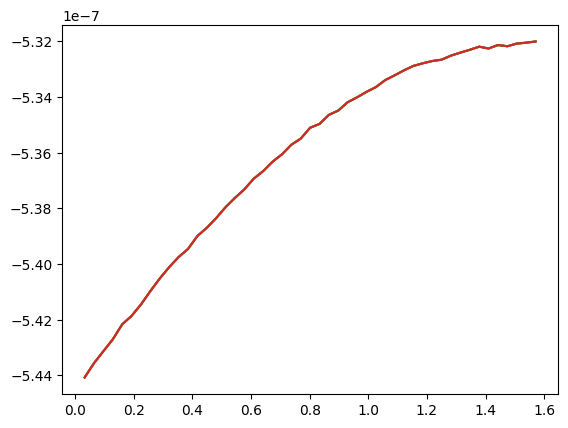

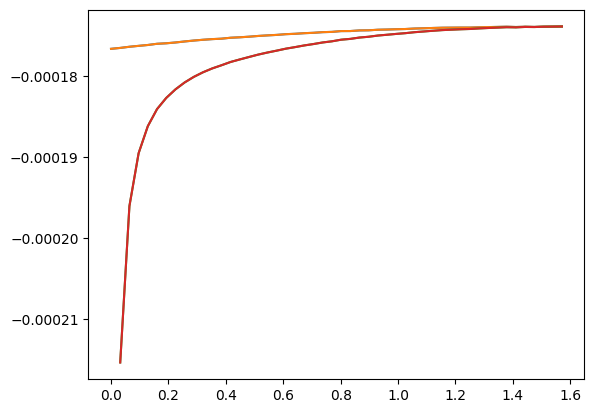

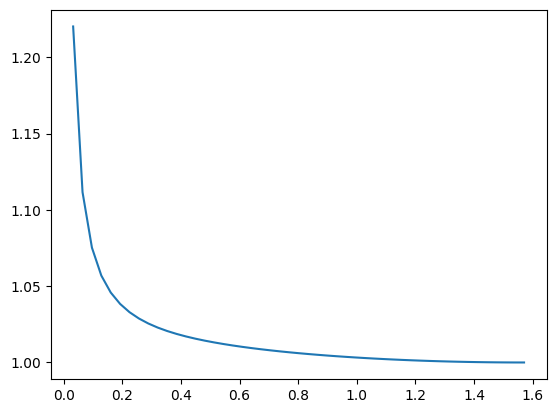

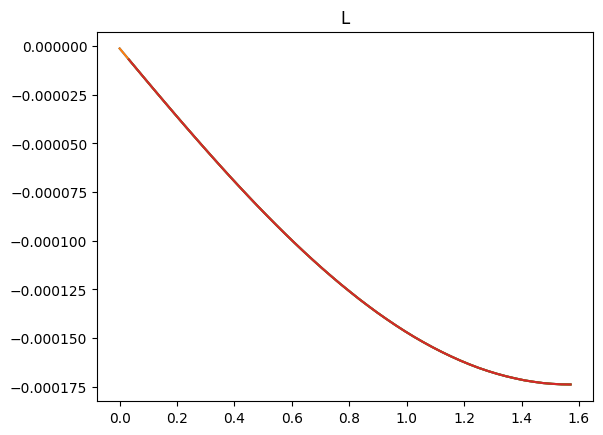

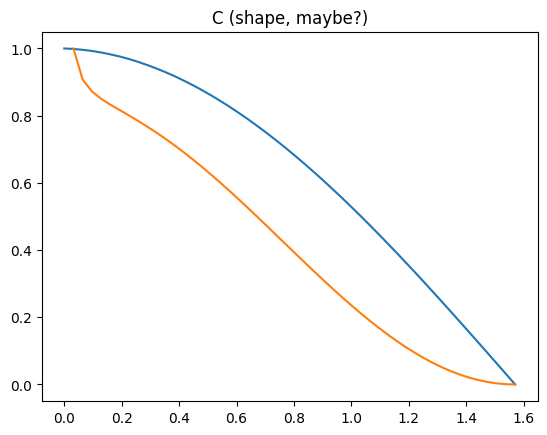

In [120]:
def peters_integrate6_4_full(states, a, mu, ind1, ind2):
    '''
    Calculates change in characteristic orbital values from path of test particle through space 

    Parameters
    ----------
    states : N x 8 numpy array of floats
        list of state vectors - [4-position, 4-velocity] in geometric units
    a : int/float
        dimensionless spin constant of black hole, between 0 and 1 inclusive
    mu : float
        mass ratio of test particle to central body
    ind1 : int
        index value of the first entry in states relative to the master state list in clean_inspiral
    ind2 : int
        index value of the last entry in states relative to the master state list in clean_inspiral

    Returns
    -------
     4-element numpy array of floats
        change in orbital characteristics (energy, cartesian components of L) per unit mass 
    '''
    #dedt, dldt = 0, np.array([0.0, 0.0, 0.0])
    if (ind2 - ind1) > 2:
        states = np.array(states)
        sphere, time = states[:, 1:4], states[:, 0]
        int_sphere, int_time = mm.interpolate(sphere, time, False)
        div = np.mean(np.diff(int_time))
        quad = mm.trace_ortholize(sphere)
        delta = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
        coolquad = quad - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad), delta)
        dt2, dt3 = mm.matrix_derive3(coolquad, time, int_time)
        levciv = np.array([[[0, 0, 0],   #Levi-civita tensor
                            [0, 0, 1],
                            [0, -1, 0]],
                           [[0, 0, -1],
                            [0, 0, 0],
                            [1, 0, 0]],
                           [[0, 1, 0],
                            [-1, 0, 0],
                            [0, 0, 0]]])
        dedt = (-1/5)*(np.einsum('ijk,ijk ->i', dt3, dt3) - (1/3)*np.einsum('ijj,ikk ->i', dt3, dt3))
        dldt = (-2/5)*np.einsum("ijk, ljm, lkm -> li", levciv, dt2, dt3)
        dE = np.sum(dedt*div)*mu
        dLx, dLy, dLz = np.sum(dldt*div, axis=0)*mu
        #print(dE, np.sqrt(dLx**2 + dLy**2 + dLz**2))
        #print(len(time), time[-1]-time[0], dE, np.linalg.norm([dLx, dLy, dLz]))
    return np.array([dE, dLx, dLy, dLz])
    #return quad

def peters_integrate6_4_small(states, a, mu, ind1, ind2):
    '''
    Calculates change in characteristic orbital values from path of test particle through space 

    Parameters
    ----------
    states : N x 8 numpy array of floats
        list of state vectors - [4-position, 4-velocity] in geometric units
    a : int/float
        dimensionless spin constant of black hole, between 0 and 1 inclusive
    mu : float
        mass ratio of test particle to central body
    ind1 : int
        index value of the first entry in states relative to the master state list in clean_inspiral
    ind2 : int
        index value of the last entry in states relative to the master state list in clean_inspiral

    Returns
    -------
     4-element numpy array of floats
        change in orbital characteristics (energy, cartesian components of L) per unit mass 
    '''
    #dedt, dldt = 0, np.array([0.0, 0.0, 0.0])
    if (ind2 - ind1) > 2:
        states = np.array(states)
        sphere, time = states[:, 1:4], states[:, 0]
        int_sphere, int_time = mm.interpolate(sphere, time, False)
        div = np.mean(np.diff(int_time))
        quad = mm.trace_ortholize(sphere)
        delta = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
        coolquad = quad - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad), delta)
        dt2, dt3 = mm.matrix_derive3(coolquad, time, int_time)
        levciv = np.array([[[0, 0, 0],   #Levi-civita tensor
                            [0, 0, 1],
                            [0, -1, 0]],
                           [[0, 0, -1],
                            [0, 0, 0],
                            [1, 0, 0]],
                           [[0, 1, 0],
                            [-1, 0, 0],
                            [0, 0, 0]]])
        dedt = (-1/5)*(np.einsum('ijk,ijk ->i', dt3, dt3))
        dldt = (-2/5)*np.einsum("ijk, ljm, lkm -> li", levciv, dt2, dt3)
        dE = np.sum(dedt*div)*mu
        dLx, dLy, dLz = np.sum(dldt*div, axis=0)*mu
        #print(dE, np.sqrt(dLx**2 + dLy**2 + dLz**2))
        #print(len(time), time[-1]-time[0], dE, np.linalg.norm([dLx, dLy, dLz]))
    return np.array([dE, dLx, dLy, dLz])
    #return quad

test_incs = np.linspace(0.0, np.pi/2)
#pure_geospin2 = [ml.EMRIGenerator(0.9, 0.0, endflag="rad_orbit > 10", params=[50/(1-0.2**2), 0.2, inc], bonk=3, label="pure geo inc=%s"%(inc), trigger=2, err_target=1e-12) for inc in test_incs]
peter_stuff_full = [peters_integrate6_4_full(sim["raw"], 0.9, 1e-3, 0, 10) for sim in pure_geospin2]
peter_stuff_small = [peters_integrate6_4_small(sim["raw"], 0.9, 1e-3, 0, 10) for sim in pure_geospin2]
recalc_full = np.array([mm.new_recalc_state6([pure_geospin2[i]["energy"][0], pure_geospin2[i]["phi_momentum"][0], pure_geospin2[i]["carter"][0]], peter_stuff_full[i], pure_geospin2[i]["raw"][-1], 0.9)[1] for i in range(len(test_incs))])
recalc_small = np.array([mm.new_recalc_state6([pure_geospin2[i]["energy"][0], pure_geospin2[i]["phi_momentum"][0], pure_geospin2[i]["carter"][0]], peter_stuff_small[i], pure_geospin2[i]["raw"][-1], 0.9)[1] for i in range(len(test_incs))])

plt.plot(test_incs[1:], [sim[0] for sim in peter_stuff_full][1:])
plt.plot(test_incs[1:], [sim[0] for sim in peter_stuff_small][1:])
plt.plot(test_incs[1:], (recalc_full[:,0] - np.array([pure_geospin2[i]["energy"][0] for i in range(len(test_incs))]))[1:])
plt.plot(test_incs[1:], (recalc_small[:,0] - np.array([pure_geospin2[i]["energy"][0] for i in range(len(test_incs))]))[1:])
plt.show()
plt.plot(test_incs, [-np.linalg.norm(sim[1:]) for sim in peter_stuff_full])
plt.plot(test_incs, [-np.linalg.norm(sim[1:]) for sim in peter_stuff_small])
plt.plot(test_incs[1:], np.sqrt(recalc_full[1:,1]**2 + recalc_full[1:,2]) - np.array([np.sqrt(pure_geospin2[i+1]["phi_momentum"][0]**2 + pure_geospin2[i+1]["carter"][0]) for i in range(len(test_incs)-1)]))
plt.plot(test_incs[1:], np.sqrt(recalc_small[1:,1]**2 + recalc_small[1:,2]) - np.array([np.sqrt(pure_geospin2[i+1]["phi_momentum"][0]**2 + pure_geospin2[i+1]["carter"][0]) for i in range(len(test_incs)-1)]))
plt.show()

#LOOK LOOK DO YOU SEE??
#LOOK CLOSER
plt.plot(test_incs[1:], (np.array([-np.linalg.norm(sim[1:]) for sim in peter_stuff_full[1:]])/(np.sqrt(recalc_full[1:,1]**2 + recalc_full[1:,2]) - np.array([np.sqrt(pure_geospin2[i+1]["phi_momentum"][0]**2 + pure_geospin2[i+1]["carter"][0]) for i in range(len(test_incs)-1)])))**(-1))
plt.show()

#FOR WHATEVER REASON, THE NEW_RECALC_STATE FUNCTION SLIGHTLY ENHANCES THE LOSS OF ANGULAR MOMENTUM AT HIGHER ECCENTRICITIES
#AT ZERO SPIN THIS LOOKS LIKE NOTHING, BUT WHAT ABOUT NONZERO SPIN???
#AH HAHA!! IT IS SIGNIFICANT! AT HIGHER ECCENTRICITIES RECALC PREDICTS HIGHER L LOSSES THAN PETERS DOES FOR THE SAME LOSS IN ENERGY
#WHICH WOULD RESULT IN HIGHER ECCENTRICITY DECAY
#technically the zero spin version predicts the opposite effect, slower e decay, but it's real close and probably negligible
#BUT STILL NOTICEABLE HERE YES AND IT WOULD CREATE THOSE SWOOP BOOMS WE KEPT SEEING
#BUT THIS WAS RETROGRADE?? WHAT ABOUT PROGRADE??
#IT IS THE OPPOSITE EFFECT!! EXTREMELY DELAYED DECAY!! YESSS!! 
#technically not a good pattern but now I see it
#BUT IS IT CARTER AND L_z?? OR ONE OR THE OTHER???
#RUN THEM ALL AGAIN

#CHECK STUFF L COMPONENTS
plt.plot(test_incs, [sim[3] for sim in peter_stuff_full])
plt.plot(test_incs, [sim[3] for sim in peter_stuff_small])
plt.plot(test_incs[1:], recalc_full[1:,1] - np.array([pure_geospin2[i+1]["phi_momentum"][0] for i in range(len(test_incs)-1)]))
plt.plot(test_incs[1:], recalc_small[1:,1] - np.array([pure_geospin2[i+1]["phi_momentum"][0] for i in range(len(test_incs)-1)]))
plt.title("L")
plt.show()
plt.plot(test_incs, np.array([-np.linalg.norm(sim[1:3]) for sim in peter_stuff_full])/np.min([-np.linalg.norm(sim[1:3]) for sim in peter_stuff_full]))
#plt.plot(test_incs, [-np.linalg.norm(sim[1:3]) for sim in peter_stuff_small])
plt.plot(test_incs[1:], (recalc_full[1:,2] - np.array([pure_geospin2[i+1]["carter"][0] for i in range(len(test_incs)-1)]))/np.min(recalc_full[1:,2] - np.array([pure_geospin2[i+1]["carter"][0] for i in range(len(test_incs)-1)])))
#plt.plot(test_incs[1:], recalc_small[1:,2] - np.array([pure_geos[i+1]["carter"][0] for i in range(len(test_incs)-1)]))
#Not exactly C, but comparing the shape at least?
plt.title("C (shape, maybe?)")
plt.show()

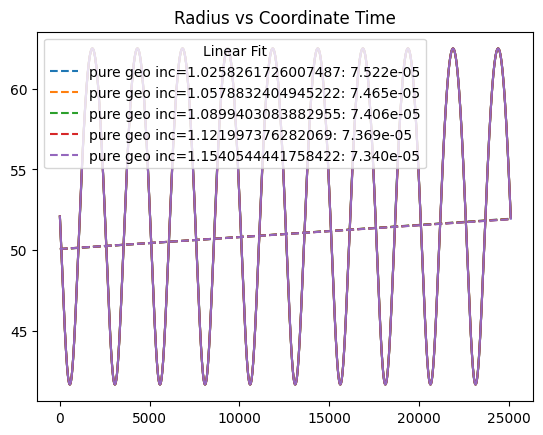

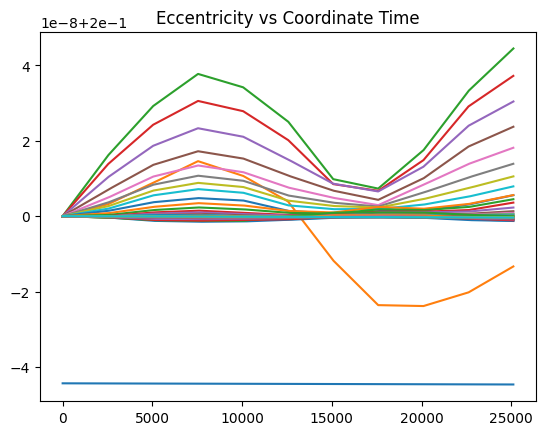

In [92]:
op.plotvalue3(pure_geos[32:37], "time", "radius")
#sub_geos = [ml.EMRIGenerator(0.0, 0.0, endflag="rad_orbit > 10", params=[50/(1-0.2**2), 0.2, inc*np.pi], bonk=3, label="pure geo inc=%s"%(inc), trigger=2, err_target=1e-12) for inc in test_incs[31:38]]
#op.plotvalue3(sub_geos, "time", "radius", linefit=False)
op.plotvalue3(pure_geos, "time", "ecc", linefit=False)


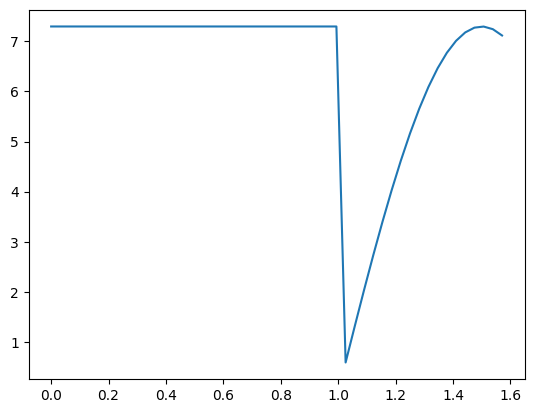

In [74]:
plt.plot(test_incs, [np.sqrt(sim["phi_momentum"][0]**2 + sim["carter"][0]) for sim in pure_geos])
#plt.plot(test_incs, [sim[0] for sim in peter_stuff_small])
plt.show()

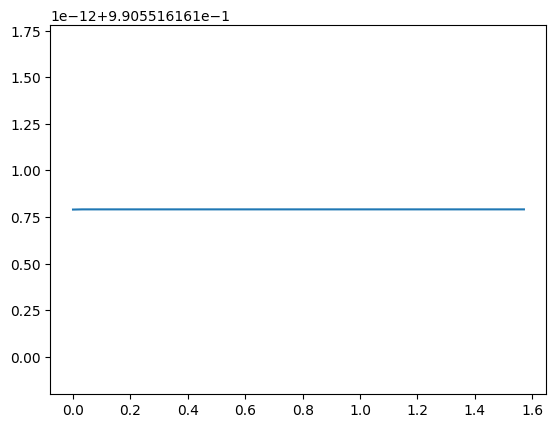

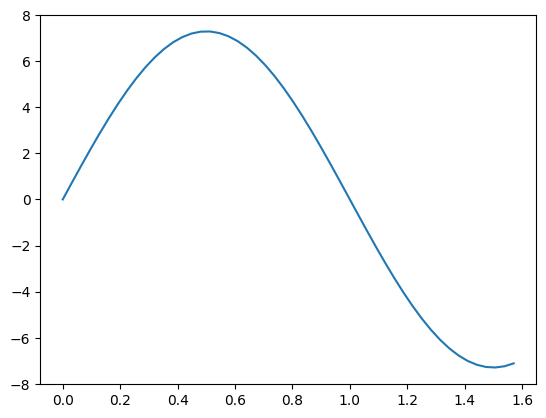

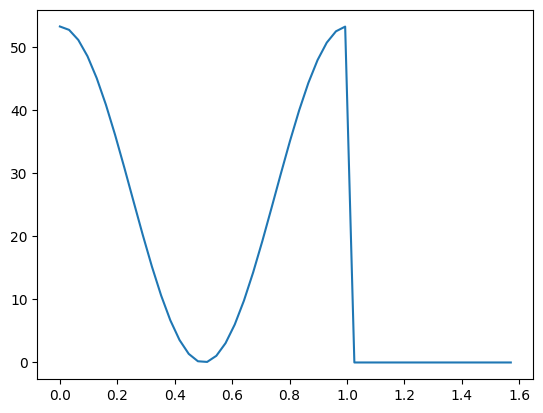

In [73]:
wtf = np.array([mm.schmidtparam3(50/(1-0.2**2), 0.2, inc*np.pi, 0.0) for inc in test_incs])
plt.plot(test_incs, wtf[:,0])
plt.show()
plt.plot(test_incs, wtf[:,1])
plt.show()
plt.plot(test_incs, wtf[:,2])
plt.show()

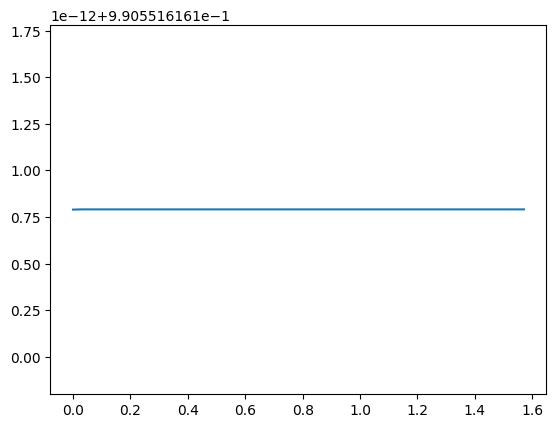

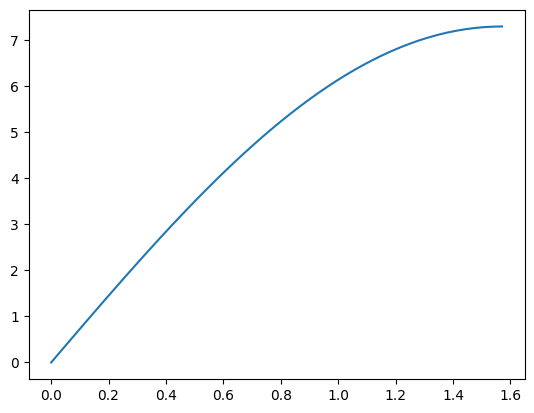

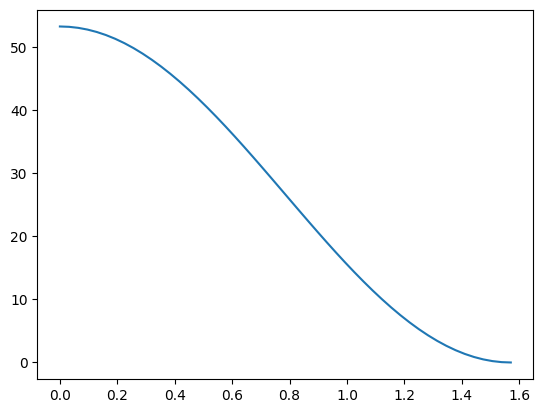

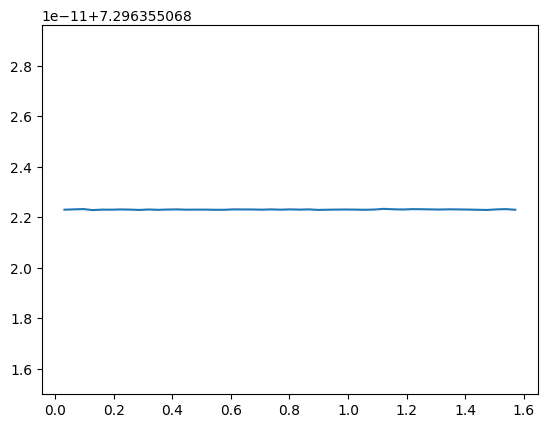

In [89]:
import sympy as sp

def schmidtparam4(r0, e, i, a):
    '''
    Returns characteristic constants of an orbit given observable parameters + spin
    Cannot generate unbound orbits (e >= 1.0)

    Parameters
    ----------
    r0 : int/float
        semi-major axis of the approximate Keplerian orbit
    e : int/float
        eccentricity of approximate Keplerian orbit, between 0 and 1
    i : int/float
        inclination of orbit w.r.t. angular momentum of black hole, where pi/2 is a prograde equatorial orbit, 0 is a northward polar orbit, and -pi/2 is a retrograde equatorial orbit
        parameter space extends in both directions s.t. any i + 2*n*pi is equivalent for any integer n
    a : int/float
        dimensionlesss spin constant of black hole, between 0 and 1 inclusive

    Returns
    -------
    cons : 3-element list/array of floats
        energy, angular momentum, and carter constant per unit mass
    '''
    #sympy doesn't like tiny e?? idk what the issue is
    e = 0.0 if e < 1e-15 else e
    p = r0*(1 - (e**2))  #p is semi-latus rectum 
    rp, ra = p/(1 + e), p/(1 - e)
    polar = False
    j = i
    if i == 0.0 or i == np.pi:
        print("if polar?")
        vals = np.transpose([[inc, *schmidtparam4(r0, e, inc, a)] for inc in np.linspace(np.pi/2, i, endpoint=False)])
        Efit, Lfit, Cfit = np.polyfit(vals[0], vals[1], 10), np.polyfit(vals[0], vals[2], 10), np.polyfit(vals[0], vals[3], 10)
        E, L, C = np.polyval(Efit, i), np.polyval(Lfit, i), np.polyval(Cfit, i)
        coeff = np.array([E**2 - 1.0, 2.0, (a**2)*(E**2 - 1.0) - L**2 - C, 2*((a*E - L)**2 + C), -C*(a**2)])
        coeff2 = np.polyder(coeff)
        turns = np.roots(coeff)
        flats = np.roots(coeff2)
        r02, e2 = (turns[0] + turns[1])/2.0, (turns[0] - turns[1])/(turns[0] + turns[1])
        r_err, e_err = ((r0 - r02)/r0)*100, ((e2 - e)/(2-e))*100
        r_err *= np.sign(r_err)
        e_err *= np.sign(e_err)
        return [E, 0.0, C]
    z = abs(np.cos(j))
    
    def rfuncs(r):
        tri = r**2 - 2*r + a**2
        f = r**4 + (a**2)*(r*(r + 2) + tri*(z**2))
        g = 2*a*r
        h = r*(r - 2) + tri*(z**2)/(max(1e-15, 1 - z**2)) #include a bias for divide by zero error
        d = (r**2 + (a*z)**2)*tri
        return f, g, h, d
    def r_funcs(r):
        f_ = 4*(r**3) + 2*(a**2)*((1 + z**2)*r + (1 - z**2))
        g_ = 2*a
        h_ = 2*(r - 1)/(1 - z**2)
        d_ = 2*(2*r - 3)*(r**2) + 2*(a**2)*((1 + z**2)*r - z**2)
        return f_, g_, h_, d_   
    
    if e == 0.0:
        print("if circ?")
        f1, g1, h1, d1 = rfuncs(p)
        f2, g2, h2, d2 = r_funcs(p)
    else:
        f1, g1, h1, d1 = rfuncs(rp)
        f2, g2, h2, d2 = rfuncs(ra)
    
    def newC(E, L, a, z):
        return (z**2)*((a**2)*(1 - E**2) + (L**2)/(max(1e-15, 1 - z**2)))
    
    x, y = sp.symbols("x y", real=True)
    eq1 = sp.Eq(f1*(x**2) - 2*g1*x*y - h1*(y**2), d1)
    eq2 = sp.Eq(f2*(x**2) - 2*g2*x*y - h2*(y**2), d2)
    symsols = sp.solve([eq1, eq2])

    full_sols = []
    E, L, C = [np.sqrt(1-((1-e**2)/p)), (1 - z**2)*p, p*(z**2)]
    for thing in symsols:
        ene, lel = np.array([thing[x], thing[y]]).astype(float)
        if ene > 0.0 and ene < 1.0: 
            full_sols.append([ene, lel, newC(ene, lel, a, z)])
            E, L, C = [ene, lel, newC(ene, lel, a, z)]
            if np.prod(np.sign([E, L, C])) == np.sign(np.sin(j)):
                break
            else:
                E, L, C = (1 - (1 - e**2)/p)**0.55, ((1 - z**2)*p)**(0.5), p*(z**2)
                
    coeff, ro, count = [-1], 1, 0
    while np.polyval(coeff, ro) < -1e-12 and count < 20:
        E += 10**(-16)
        coeff = np.array([E**2 - 1.0, 2.0, (a**2)*(E**2 - 1.0) - L**2 - C, 2*((a*E - L)**2 + C), -C*(a**2)])
        coeff2 = np.polyder(coeff)
        turns = np.roots(coeff)
        flats = np.roots(coeff2)
        turns = turns.real[abs(turns.imag)<(1e-6)*r0]
        flats = flats.real[abs(flats.imag)<(1e-6)*r0]
        try:
            ro = max(flats)
        except:
            ro = np.max(np.roots(coeff2)).real

    turns = np.sort(turns)
    r02, e2 = (turns[-1] + turns[-2])/2.0, (turns[-1] - turns[-2])/(turns[-1] + turns[-2])
    r_err, e_err = np.abs((r0 - r02)/r0)*100, np.abs((e2 - e)/(2-e))*100
    
    if r_err < 1e-6 and e_err < 1e-6:
        print(L, C, np.sqrt(L**2 + C), (np.sqrt(L**2 + C) - np.abs(L))/L)
        if (np.sqrt(L**2 + C) - np.abs(L))/np.abs(L) < 1e-15:
            print("if EXCUSE ME")
            C = 0.0
        return [E, L, C]
    else:
        print("if err bad?")
        def r__funcs(r):
            f__ = 12*(r**2) + 2*a*(1 + z**2)
            g__ = 0.0
            h__ = 2/(1 - z**2)
            d__ = 4*(r - 1)*(r + 3) + 2*(a**2)*(1 + z**2)
            return f__, g__, h__, d__  
        
        if False not in np.isreal([r_err, e_err]):
            f1, g1, h1, d1 = r_funcs(rp)
        else:
            print("if complex?")
            f1, g1, h1, d1 = r__funcs(rp)

        f2, g2, h2, d2 = rfuncs(ra)
        
        eq1 = sp.Eq(f1*(x**2) - 2*g1*x*y - h1*(y**2), d1)
        eq2 = sp.Eq(f2*(x**2) - 2*g2*x*y - h2*(y**2), d2)

        symsols = sp.solve([eq1, eq2])
        
        full_sols = []
        for thing in symsols:
            ene, lel = np.array([thing[x], thing[y]]).astype(float)
            if ene > 0.0: 
                full_sols.append([ene, lel, newC(ene, lel, a, z)])
        
        for solution in full_sols:
            if (np.prod(np.sign(solution)) == np.sign(np.sin(j))):
                E, L, C = solution
                break     
        if polar == True:
            print("if err polar?")
            L, C = 0.0, C/(z**2) - (a**2)*(1 - E**2)
            
        if (np.sqrt(L**2 + C) - np.abs(L))/L < 1e-15:
            print("if ehllpp????")
            C = 0.0
        return [E, L, C]
    
test_incs = np.linspace(0.0, np.pi/2)
#wtf = np.array([schmidtparam4(50/(1-0.2**2), 0.2, inc, 0.0) for inc in test_incs])
plt.plot(test_incs, wtf[:,0])
plt.show()
plt.plot(test_incs, wtf[:,1])
plt.show()
plt.plot(test_incs, wtf[:,2])
plt.show()
plt.plot(test_incs[1:], np.sqrt(wtf[1:,1]**2 + wtf[1:,2]))
plt.show()
#print(wtf[:,2])

c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\matplotlib\cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\matplotlib\cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


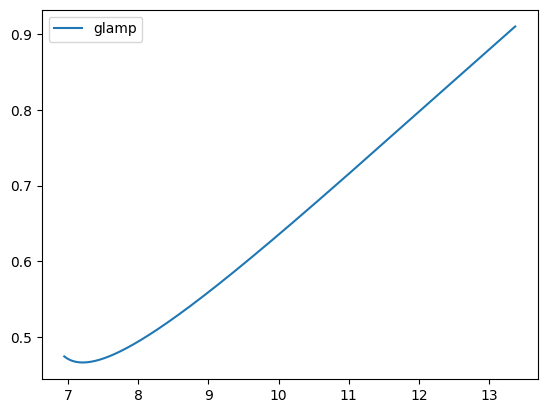

In [ ]:
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt

def sago_update(p, e, inc, a, mu):
    b = (64/5)*mu*(1 + mu)
    full = ((p/(1 - e**2))**4)/(4*b)
    dt = full*1e-2
    E, L, C = mm.schmidtparam3(p/(1 - e**2), e, inc, a)
    y = C/(L**2)
    turns, flats, zs = mm.root_getter(E, L, C, a)
    r_max, r0 = turns[-1], flats[-1]
    e_s, v = (r_max/r0) - 1, np.sqrt(1/r0)
    #Sago definitions of p
    vals = [[0, p, e, inc, r0, e_s, y, E, L, C]]
    p0 = p
    print(E, L, C)
    while p/(1 + e) > mm.find_rms(a):
        dEdt = (-32/5)*(mu**2)*(v**10)*(
                    1 - (1247/336)*(v**2) - ((73/12)*a - 4*np.pi)*(v**3)
                    - (44711/9072 - (33/16)*(a**2))*(v**4) + ((3749/336)*a - (8191/672)*np.pi)*(v**5)
                    + (277/24 - (4001/84)*(v**2) + ((3583/48)*np.pi - (457/4)*a)*(v**3)
                        + (42*(a**2) - 1091291/9072)*(v**4) + ((58487/672)*a - (364337/1344)*np.pi)*(v**5))*(e_s**2)
                    + ((73/24)*a*(v**3) - (527/96)*(a**2)*(v**4) - (3749/672)*a*(v**5))*y
                    + ((457/8)*a*(v**3) - (5407/48)*(a**2)*(v**4) - (58487/1344)*a*(v**5))*(e_s**2)*y)
        dLdt = (-32/5)*(mu**2)*(v**7)*(
                    1 - (1247/336)*(v**2) - ((61/12)*a - 4*np.pi)*(v**3)
                    - (44711/9072 - (33/16)*(a**2))*(v**4) + ((417/56)*a - (8191/672)*np.pi)*(v**5)
                    + (51/8 - (17203/672)*(v**2) + ((-781/12)*a + (369/8)*np.pi)*(v**3)
                        + ((929/32)*(a**2) - 1680185/18144)*(v**4) + ((1809/224)*a - (48373/336)*np.pi)*(v**5))*(e_s**2)
                    + (-0.5 + (1247/672)*(v**2) + ((61/8)*a - 2*np.pi)*(v**3)
                        - ((213/32)*(a**2) - 44711/18144)*(v**4) - ((4301/224)*a - (8191/1344)*np.pi)*(v**5))*y
                    + (-51/16 + (17203/1344)*(v**2) + ((1513/16)*a - (369/16)*np.pi)*(v**3)
                        + (1680185/36288 - (5981/64)*(a**2))*(v**4) - (168*a - (48373/672)*np.pi)*(v**5))*(e_s**2)*y)
        dQdt = (-64/5)*(mu**3)*(v**6)*(
                    1 - a*v - (743/336)*(v**2) - ((1637/336)*a - 4*np.pi)*(v**3)
                    + ((439/48)*(a**2) - 129193/18144 - 4*np.pi*a)*(v**4) + ((151765/18144)*a - (4159/672)*np.pi - (33/16)*(a**3))*(v**5)
                    + (43/8 - (51/8)*a*v - (2425/224)*(v**2) - ((14869/224)*a - (337/8)*np.pi)*(v**3)
                        - (453601/4536 - (3631/32)*(a**2) + (369/8)*np.pi*a)*(v**4)
                        + ((141049/9072)*a - (38029/672)*np.pi - (929/32)*(a**3))*(v**5))*(e_s**2)
                    + (0.5*a*v + (1637/672)*a*(v**3) - ((1355/96)*(a**2) - 2*np.pi*a)*(v**4)
                        - ((151765/36288)*a - (213/32)*(a**3))*(v**5))*y
                    + ((51/16)*a*v + (14869/448)*a*(v**3) + ((369/16)*np.pi*a - (33257/192)*(a**2))*(v**4)
                        + ((-141049/18144)*a + (5981/64)*(a**3))*(v**5))*(e_s**2)*y)
        dCdt = 0 if C == 0.0 else dQdt - 2*(a*E - L)*(a*dEdt - dLdt)

        E, L, C = E + dt*dEdt, L + dt*dLdt, C + dt*dCdt
        y = C/(L**2)
        turns, flats, zs = mm.root_getter(E, L, C, a)
        r_max, r_min, r0 = turns[-1], turns[-2], flats[-1]
        e_s, v = (r_max/r0) - 1, np.sqrt(1/r0)
        e, inc = (r_max - r_min)/(r_max + r_min), np.pi/2 - np.arctan(np.sqrt(y))
        p = 0.5*(r_max + r_min)*(1 - e**2)
        vals.append([vals[-1][0] + dt, p, e, inc, r0, e_s, y, E, L, C])

        b = (64/5)*mu*(1 + mu)
        full = ((p/(1 - e**2))**4)/(4*b)
        dt = full*1e-2

        if p < p0*(2/3) or p > p0:
            print(p)
            p0 = p
    return np.array(vals)
   
def glamper(p, e, i, a, mu, frac):
    b = (64/5)*mu*(1 + mu)
    full = ((p/(1 - e**2))**4)/(4*b)
    dt = full*frac
    E, L, C = mm.schmidtparam3(p/(1 - e**2), e, i, a)
    print(E, L, C)
    cosi = L/np.sqrt(L**2 + C)
    f1 = lambda x: 1 + (73/24)*(x**2) + (37/96)*(x**4)
    f2 = lambda x: 73/12 + (823/24)*(x**2) + (949/32)*(x**4) + (491/192)*(x**6)
    f3 = lambda x: 1 + (7/8)*(x**2)
    f4 = lambda x: 61/24 + (63/8)*(x**2) + (94/64)*(x**4)
    f5 = lambda x: 61/8 + (91/4)*(x**2) + (461/64)*(x**4)
    f6 = lambda x: 97/12 + (37/2)*(x**2) + (211/32)*(x**4)
    vals = [[0, p, e, cosi, E, L, C]]
    p0 = p
    turns, flats, zs = mm.root_getter(E, L, C, a)
    turns = np.real(turns)
    while len(np.unique(turns)) == len(turns):
        E_dot = (-32/5)*(mu**2)*(p**(-5))*((1 - e**2)**(3/2))*(f1(e) - a*(p**(-3/2))*cosi*f2(e))
        L_dot = (-32/5)*(mu**2)*(p**(-7/2))*((1 - e**2)**(3/2))*(cosi*f3(e) + a*(p**(-3/2))*(f4(e) - (cosi**2)*f5(e)))
        Q_dot = (-64/5)*(mu**3)*(p**(-3))*((1 - e**2)**(3/2))*(f3(e) - a*(p**(-3/2))*cosi*f6(e))
        C_dot = 2*(C/L)*L_dot if L != 0 else Q_dot - 2*L*L_dot
        E += E_dot*dt
        L += L_dot*dt
        C += C_dot*dt
        turns, flats, zs = mm.root_getter(E, L, C, a)
        turns = np.real(turns)
        e = (turns[-1] - turns[-2])/(turns[-1] + turns[-2])
        cosi = L/np.sqrt(L**2 + C)
        p = 0.5*(turns[-1] + turns[-2])*(1 - e**2)
        vals.append([vals[-1][0] + dt, p, e, cosi, E, L, C])

        b = (64/5)*mu*(1 + mu)
        full = ((p/(1 - e**2))**4)/(4*b)
        dt = full*1e-2

        if p < (2/3)*p0:
            print(p)
            p0 = p
    return np.array(vals)


#sago = sago_update(20, 0.1, np.pi/2, 0.0, 1e-3)
#glamp = glamper(20, 0.1, np.pi/2, 0.0, 1e-3, 1e-2)
#EMRIc = ml.EMRIGenerator(0.0, 1e-3, params=[20/(1-0.1**2), 0.1, np.pi/2], bonk=3, label="wink pure geo inc=%s"%(3), trigger=2, err_target=1e-11)
plt.show()
#plt.plot(sago[:,1], sago[:,2], label="sago")
plt.plot(glamp[:,1], glamp[:,2], label="glamp")
#plt.plot(EMRIc["p"], EMRIc["e"], label="EMRICode")
plt.legend()


0.9888513796308236 3.9091966159069287 0.0
0.9727963492069713 3.7713494830202254 0.0
0.9622504486493761 3.6742346141747664 0.0
10.800148914230773 0.9879010902463069
0.9551913358642539 3.604735447582641 0.0
10.444560960654314 0.9759136091534942
0.95043661174947 3.5548336255390565 0.0
10.137937310043379 0.9674240542220229
15.20822616503731 0.9929091037857899
0.9472551135958184 3.519334352646007 0.0
9.870979497746738 0.9615708855397476
14.806511013447128 0.9821870451965173
0.9451746977082379 3.494716508997671 0.0
9.636380047746734 0.9576832154158722
14.45463832818424 0.9746856894627544
21.682678477490644 0.9926696633348319
0.9438798074485389 3.478505426185217 0.0
9.428603767569241 0.9552201617778258
14.14292091966016 0.969937680412114
21.214539040089768 0.983766817520461
31.825883904119927 0.9976357179290823
0.943153572578976 3.468909530866052 0.0
9.243272492130986 0.9537416317106833
13.86491137062169 0.9673488108737092
20.797377180597145 0.9786691959423457
31.196080992111956 0.98822038106

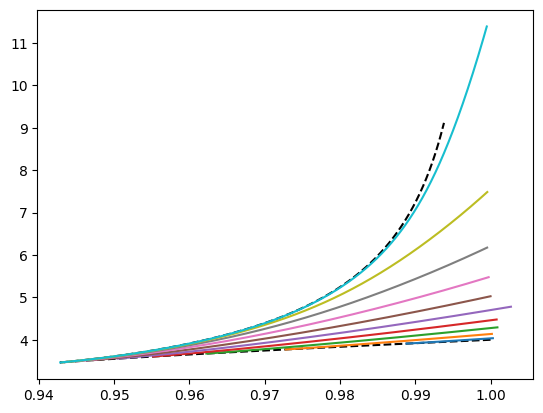

In [192]:
circE = lambda a, r: (1 - (2/r) + a/(r**(3/2)))/np.sqrt(1 - 3/r + 2*a/(r**(3/2)))
circL = lambda a, r: (np.sqrt(r) - (2*a/r) + (a**2)/(r**(3/2)))/np.sqrt(1 - 3/r + 2*a/(r**(3/2)))

#grid = np.array([[mm.schmidtparam3(p/(1 - e**2), e, np.pi/2, 0.0) if p/(1+e) >= 4 else [None, None, None] for e in np.arange(0,1, 0.1)] for p in np.arange(6.5, 19.5)])
#plt.scatter(grid[:,:,0], grid[:,:,1])
test_line = np.array([mm.schmidtparam3(p/(1 - 0.5**2), 0.5, np.pi/2, 0.0) for p in np.arange(7,20, 0.5)])
#print(np.where(7/(1 + np.arange(0,1, 0.1)) >= 4))
#plt.plot(test_line[:,0], test_line[:,1])
#glamp = glamper(19, 0.5, np.pi/2, 0.0, 1e-3, 1e-2)[:, -3:]
#plt.plot(glamp[:,0], glamp[:,1])
#glamp = glamper(19.5, 0.5, np.pi/2, 0.0, 1e-3, 1e-2)[:, -3:]
#plt.plot(glamp[:,0], glamp[:,1])
#plt.scatter(test_line[:,0], test_line[:,1])
#glamps = [glamper(20, e, np.pi/2, 0.0, 1e-3, 1e-2)[:,-3:] for e in (np.arange(0, 1, 0.1))**(0.25)]
#for glamp in glamps:
#    plt.plot(glamp[:,0], glamp[:,1])
    #plt.plot(glamp[op.get_index(glamp[:,0], 0.975):,0], glamp[op.get_index(glamp[:,0], 0.975):,1])

plt.plot(circE(0.0, np.linspace(4, 6)), circL(0.0, np.linspace(4, 6)), color = "k", linestyle = "--")
plt.plot(circE(0.0, np.linspace(6, 80, 300)), circL(0.0, np.linspace(6, 80, 300)), color = "k", linestyle = "--")
#glamps = [glamper(8*(1 + e), e, np.pi/2, 0.0, 1e-3, 1e-2) for e in np.arange(0.9, 1, 0.01)]
glamps = [glamper_reverse(circE(0.0, r), circL(0.0, r), 0.0, 0.0, 1e-3, 1e-2) for r in np.arange(4.1, 6, 0.2)] 
for glamp in glamps:
    plt.plot(glamp[:,-3], glamp[:,-2])
    #print(glamp[op.get_index(glamp[:,-3], 0.975),1:3])
    #plt.plot(glamp[:,1], glamp[:,2])
    #plt.plot(circE(0.0, np.linspace(4.25, 20)), circL(0.0, np.linspace(4.25, 20)), color = "k", linestyle = "--")
    #plt.plot(glamp[:op.get_index(glamp[:,-3], 0.975),-3], glamp[:op.get_index(glamp[:,-3], 0.975),-2])
    #print(glamp[op.get_index(glamp[:,-3], 0.975),1:3])
    #plt.show()

#print(plt.ylim())
#plt.xlim(0.942, 0.955)
#plt.ylim(3.45, 3.8)
#plt.xlim(0.98, 0.982)
#plt.ylim(4.7, 4.9)
#print(glamps[0][:,1])

In [74]:
print(20/(1 + np.arange(0,1, 0.1)))
print(6/(1 - np.arange(0,1, 0.1)))
print(6/(1 - np.arange(0,1, 0.1)**2))
(np.arange(10, 120, 10))**(0.25)


[20.         18.18181818 16.66666667 15.38461538 14.28571429 13.33333333
 12.5        11.76470588 11.11111111 10.52631579]
[ 6.          6.66666667  7.5         8.57142857 10.         12.
 15.         20.         30.         60.        ]
[ 6.          6.06060606  6.25        6.59340659  7.14285714  8.
  9.375      11.76470588 16.66666667 31.57894737]


array([1.77827941, 2.11474253, 2.34034732, 2.51486686, 2.65914795,
       2.78315768, 2.89250761, 2.99069756, 3.08007029, 3.16227766,
       3.23853184])

In [105]:
lst = [0,1,2,3]
print(lst[1::-1])

[1, 0]


In [157]:
a, b, c, d = np.real(mm.root_getter(0.97, 3.6, 0.0, 0.0)[0])
b - c

np.float64(0.0)

In [191]:
def glamper_reverse(E, L, C, a, mu, frac):
    print(E, L, C)
    cosi = L/np.sqrt(L**2 + C)
    f1 = lambda x: 1 + (73/24)*(x**2) + (37/96)*(x**4)
    f2 = lambda x: 73/12 + (823/24)*(x**2) + (949/32)*(x**4) + (491/192)*(x**6)
    f3 = lambda x: 1 + (7/8)*(x**2)
    f4 = lambda x: 61/24 + (63/8)*(x**2) + (94/64)*(x**4)
    f5 = lambda x: 61/8 + (91/4)*(x**2) + (461/64)*(x**4)
    f6 = lambda x: 97/12 + (37/2)*(x**2) + (211/32)*(x**4)
    turns, flats, zs = mm.root_getter(E, L, C, a)
    turns = np.real(turns)
    p = 2*turns[-1]*turns[-2]/(turns[-1] + turns[-2])
    e = (turns[-1] - turns[-2])/(turns[-1] + turns[-2])
    cosi = L/np.sqrt(L**2 + C)
    vals = [[0, p, e, cosi, E, L, C]]
    p0 = p
    b = (64/5)*mu*(1 + mu)
    full = ((p/(1 - e**2))**4)/(4*b)
    dt = full*frac
    #turns, flats, zs = mm.root_getter(E, L, C, a)
    #turns = np.real(turns)
    while E < 0.999500376693:
        E_dot = (-32/5)*(mu**2)*(p**(-5))*((1 - e**2)**(3/2))*(f1(e) - a*(p**(-3/2))*cosi*f2(e))
        L_dot = (-32/5)*(mu**2)*(p**(-7/2))*((1 - e**2)**(3/2))*(cosi*f3(e) + a*(p**(-3/2))*(f4(e) - (cosi**2)*f5(e)))
        Q_dot = (-64/5)*(mu**3)*(p**(-3))*((1 - e**2)**(3/2))*(f3(e) - a*(p**(-3/2))*cosi*f6(e))
        C_dot = 2*(C/L)*L_dot if L != 0 else Q_dot - 2*L*L_dot
        E -= E_dot*dt
        L -= L_dot*dt
        C -= C_dot*dt
        turns, flats, zs = mm.root_getter(E, L, C, a)
        turns = np.real(turns)
        e = (turns[-1] - turns[-2])/(turns[-1] + turns[-2])
        cosi = L/np.sqrt(L**2 + C)
        p = 0.5*(turns[-1] + turns[-2])*(1 - e**2)
        vals.append([vals[-1][0] + dt, p, e, cosi, E, L, C])

        b = (64/5)*mu*(1 + mu)
        full = ((p/(1 - e**2))**4)/(4*b)
        dt = full*1e-2

        if p > (3/2)*p0:
            print(p, E)
            p0 = p
    return np.array(vals)

Test some orbit stuff

In [2]:
def glamp_con(p, e, inc, a, mu):
    r0 = p/(1 - e**2)
    po = p
    beta = (64/5)*mu*(1 + mu)
    dt = 0.01*(r0**4)/(4*beta)
    E, L, C = mm.schmidtparam3(r0, e, inc, a)
    cosi = L/np.sqrt(C + L**2)
    states = [[r0, e, p, cosi, E, L, C, 0.0]] 
    print(states)
    f1 = lambda x: 1 + (73/24)*(x**2) + (37/96)*(x**4)
    f2 = lambda x: 73/12 + (823/24)*(x**2) + (949/32)*(x**4) + (491/192)*(x**6)
    f3 = lambda x: 1 + (7/8)*(x**2)
    f4 = lambda x: 61/24 + (63/8)*(x**2) + (94/64)*(x**4)
    f5 = lambda x: 61/8 + (91/4)*(x**2) + (461/64)*(x**4)
    f6 = lambda x: 97/12 + (37/2)*(x**2) + (211/32)*(x**4)

    while np.real(p/(1 + e)) > mm.find_rms(a):
        dEdt = ((-32/5)*(mu**2)*(p**(-5))*((1 - e**2)**(3/2))*(f1(e) - a*(p**(-3/2))*cosi*f2(e)))
        dLdt = ((-32/5)*(mu**2)*(p**(-7/2))*((1 - e**2)**(3/2))*(cosi*f3(e) + a*(p**(-3/2))*(f4(e) - (cosi**2)*f5(e))))
        dQdt = ((-64/5)*(mu**3)*(p**(-3))*((1 - e**2)**(3/2))*(f3(e) - a*(p**(-3/2))*cosi*f6(e)))
        dCdt = 2*(C/L)*dLdt #dQdt - 2*L*dLdt
        
        E, L, C = E + dEdt*dt, L + dLdt*dt, C + dCdt*dt
        turns, flats, incs = mm.root_getter(E, L, C, a)
        e, r0, p  = (turns[-1] - turns[-2])/(turns[-1] + turns[-2]), 0.5*(turns[-1] + turns[-2]), 2*turns[-1]*turns[-2]/(turns[-1] + turns[-2])
        cosi, t = L/np.sqrt(C + L**2), states[-1][-1] + dt
        dt = 0.01*(r0**4)/(4*beta)
        states.append([r0, e, p, cosi, E, L, C, t])
    return np.array(states)

def peters_quick(r0, e, mu):
    beta = (64/5)*mu*(1 + mu)
    dt = 0.001*(r0**4)/(4*beta)
    p = r0*(1 - e**2)
    po = p
    states = [[r0, e, p, 0.0]] 

    while np.real(p) >= 4:
        dr0dt = (-64/5)*mu*(1 + mu)*(1 + (e**2)*73/24 + (e**4)*37/96)/((r0**3)*((1 - e**2)**(7/2)))
        dedt = (-304/15)*e*mu*(1 + mu)*(1 + (e**2)*121/304)/((r0**4)*((1 - e**2)**(5/2)))
        r0, e, t = r0 + dr0dt*dt, e + dedt*dt, states[-1][-1] + dt
        p, dt = r0*(1 - e**2), 0.001*(r0**4)/(4*beta)
        states.append([r0, e, p, t])
    return np.array(states)

def sago_update(p, e, inc, a, mu):
    b = (64/5)*mu*(1 + mu)
    full = ((p/(1 - e**2))**4)/(4*b)
    dt = full*1e-2
    E, L, C = mm.schmidtparam3(p/(1 - e**2), e, inc, a)
    y = C/(L**2)
    turns, flats, zs = mm.root_getter(E, L, C, a)
    r_max, r0 = turns[-1], flats[-1]
    e_s, v = (r_max/r0) - 1, np.sqrt(1/r0)
    #Sago definitions of p
    vals = [[0, p, e, inc, r0, e_s, y, E, L, C]]
    p0 = p
    while p/(1 + e) > mm.find_rms(a):
        dEdt = (-32/5)*(mu**2)*(v**10)*(
                    1 - (1247/336)*(v**2) - ((73/12)*a - 4*np.pi)*(v**3)
                    - (44711/9072 - (33/16)*(a**2))*(v**4) + ((3749/336)*a - (8191/672)*np.pi)*(v**5)
                    + (277/24 - (4001/84)*(v**2) + ((3583/48)*np.pi - (457/4)*a)*(v**3)
                        + (42*(a**2) - 1091291/9072)*(v**4) + ((58487/672)*a - (364337/1344)*np.pi)*(v**5))*(e_s**2)
                    + ((73/24)*a*(v**3) - (527/96)*(a**2)*(v**4) - (3749/672)*a*(v**5))*y
                    + ((457/8)*a*(v**3) - (5407/48)*(a**2)*(v**4) - (58487/1344)*a*(v**5))*(e_s**2)*y)
        dLdt = (-32/5)*(mu**2)*(v**7)*(
                    1 - (1247/336)*(v**2) - ((61/12)*a - 4*np.pi)*(v**3)
                    - (44711/9072 - (33/16)*(a**2))*(v**4) + ((417/56)*a - (8191/672)*np.pi)*(v**5)
                    + (51/8 - (17203/672)*(v**2) + ((-781/12)*a + (369/8)*np.pi)*(v**3)
                        + ((929/32)*(a**2) - 1680185/18144)*(v**4) + ((1809/224)*a - (48373/336)*np.pi)*(v**5))*(e_s**2)
                    + (-0.5 + (1247/672)*(v**2) + ((61/8)*a - 2*np.pi)*(v**3)
                        - ((213/32)*(a**2) - 44711/18144)*(v**4) - ((4301/224)*a - (8191/1344)*np.pi)*(v**5))*y
                    + (-51/16 + (17203/1344)*(v**2) + ((1513/16)*a - (369/16)*np.pi)*(v**3)
                        + (1680185/36288 - (5981/64)*(a**2))*(v**4) - (168*a - (48373/672)*np.pi)*(v**5))*(e_s**2)*y)
        dQdt = (-64/5)*(mu**3)*(v**6)*(
                    1 - a*v - (743/336)*(v**2) - ((1637/336)*a - 4*np.pi)*(v**3)
                    + ((439/48)*(a**2) - 129193/18144 - 4*np.pi*a)*(v**4) + ((151765/18144)*a - (4159/672)*np.pi - (33/16)*(a**3))*(v**5)
                    + (43/8 - (51/8)*a*v - (2425/224)*(v**2) - ((14869/224)*a - (337/8)*np.pi)*(v**3)
                        - (453601/4536 - (3631/32)*(a**2) + (369/8)*np.pi*a)*(v**4)
                        + ((141049/9072)*a - (38029/672)*np.pi - (929/32)*(a**3))*(v**5))*(e_s**2)
                    + (0.5*a*v + (1637/672)*a*(v**3) - ((1355/96)*(a**2) - 2*np.pi*a)*(v**4)
                        - ((151765/36288)*a - (213/32)*(a**3))*(v**5))*y
                    + ((51/16)*a*v + (14869/448)*a*(v**3) + ((369/16)*np.pi*a - (33257/192)*(a**2))*(v**4)
                        + ((-141049/18144)*a + (5981/64)*(a**3))*(v**5))*(e_s**2)*y)
        dCdt = 0 if C == 0.0 else dQdt - 2*(a*E - L)*(a*dEdt - dLdt)

        E, L, C = E + dt*dEdt, L + dt*dLdt, C + dt*dCdt
        y = C/(L**2)
        turns, flats, zs = mm.root_getter(E, L, C, a)
        r_max, r_min, r0 = turns[-1], turns[-2], flats[-1]
        e_s, v = (r_max/r0) - 1, np.sqrt(1/r0)
        e, inc = (r_max - r_min)/(r_max + r_min), np.pi/2 - np.arctan(np.sqrt(y))
        p = 0.5*(r_max + r_min)*(1 - e**2)
        vals.append([vals[-1][0] + dt, p, e, inc, r0, e_s, y, E, L, C])

        b = (64/5)*mu*(1 + mu)
        full = ((p/(1 - e**2))**4)/(4*b)
        dt = full*1e-2

        if p < p0*(2/3) or p > p0:
            #print(p)
            print(E, L, C)
            p0 = p
    return np.array(vals)

def multi_test(p, e, inc, a, mu):
    inp = p, e, inc, a, mu
    glamp_test = glamp_con(p, e, inc, a, mu)
    peters_test = peters_quick(p/(1 - e**2), e, mu)
    #sago_test = sago_update(p, e, inc, a, mu)
    EMRITest = ml.EMRIGenerator(a, mu, params=[p/(1-e**2), e, inc], bonk=3, label="wink %s,%s,%s"%(p, e, np.round(inc,4)), trigger=2, err_target=1e-13)
    return glamp_test, peters_test, EMRITest, inp
    
#data = multi_test(10, 0.1, np.pi/4, 0.0, 1e-3)
def dataplotter(data):
    fig, ax = plt.subplots()
    ax.plot(data[0][:,2], data[0][:,1], label="glamp")
    ax.plot(data[1][:,2], data[1][:,1], label="peters")
    ax.plot(data[2]["p"], data[2]["e"], label="EMRI")
    ax.set_title("%s, %s, %s, %s, %s"%(data[3][0], data[3][1], np.round(data[3][2], 4), data[3][3], data[3][4]))
    ax.set_xlabel("Semilatus rectum")
    ax.set_ylabel("Eccentricity")

dataset_flat = [multi_test(10, 0.3, np.pi/2, a, 1e-3) for a in [-0.7, -0.3, 0.0, 0.3, 0.7]]
dataset_tilt = [multi_test(10, 0.3, np.pi/4, a, 1e-3) for a in [-0.7, -0.3, 0.0, 0.3, 0.7]]

[[10.989010989010989, 0.3, 10, np.float64(1.0), np.float64(0.9634183731388927), np.float64(4.137609815861986), 0.0, 0.0]]
new


10001567.04723844it [31:03, 5365.99it/s]                                  


[[10.989010989010989, 0.3, 10, np.float64(1.0), np.float64(0.9611439455396903), np.float64(3.938882969061222), 0.0, 0.0]]
new


 39%|███▉      | 3878809.3205473823/10000000 [49:25<1:17:59, 1308.04it/s]  


Ending program


[[10.989010989010989, 0.3, 10, np.float64(1.0), np.float64(0.9596791552607415), np.float64(3.804179284542698), 0.0, 0.0]]


KeyboardInterrupt: 

In [3]:
for sim in [*dataset_flat, *dataset_tilt]:
    dataplotter(sim)

NameError: name 'dataset_flat' is not defined

new


  8%|▊         | 778448.4604640838/10000000 [00:14<02:56, 52249.66it/s]  

[6.39446113 5.70692745 1.49613469]
[6.39446113 5.70692745 1.49613469]
[ -0.44125683   6.         -24.09175493  24.09175493]
[6.39446113 5.70692745 1.49613469]
sta
6.3944611333572094 [6.39446113 5.70692745 1.49613469]
ROOTER
(array([8.88178420e-16+0.j        , 5.34049239e+00+0.j        ,
       6.39476932e+00-0.02361404j, 6.39476932e+00+0.02361404j]), array([1.49613469+0.j, 5.70692745+0.j, 6.39446113+0.j]), array([-94.73189979+0.j,   0.        +0.j,   0.        +0.j,
        94.73189979+0.j]))
(-0.00041464634701810605+0j) -1e-10 whoops

Ending program
new



 12%|█▏        | 1168008.6393738897/10000000 [00:27<03:26, 42711.68it/s]

[6.21084519 5.82051568 1.49883413]
[6.21084519 5.82051568 1.49883413]
[ -0.44345259   6.         -24.02774068  24.02774068]
[6.21084519 5.82051568 1.49883413]
sta
6.210845192963609 [6.21084519 5.82051568 1.49883413]
ROOTER
(array([2.22044605e-15+0.j        , 5.61744965e+00+0.j        ,
       6.21140518e+00-0.02462349j, 6.21140518e+00+0.02462349j]), array([1.49883413+0.j, 5.82051568+0.j, 6.21084519+0.j]), array([-93.90425952+0.j,   0.        +0.j,   0.        +0.j,
        93.90425952+0.j]))
(-0.0002478597952257776+0j) -1e-11 whoops

Ending program


new


100%|█████████▉| 9999590.42027211/10000000 [00:45<00:00, 219566.27it/s]   


new


100%|█████████▉| 9999576.602228448/10000000 [01:06<00:00, 150002.80it/s]  


new


100%|█████████▉| 9999584.148214526/10000000 [01:42<00:00, 97544.59it/s]   


new


100%|█████████▉| 9999581.097382654/10000000 [03:27<00:00, 48162.10it/s]   


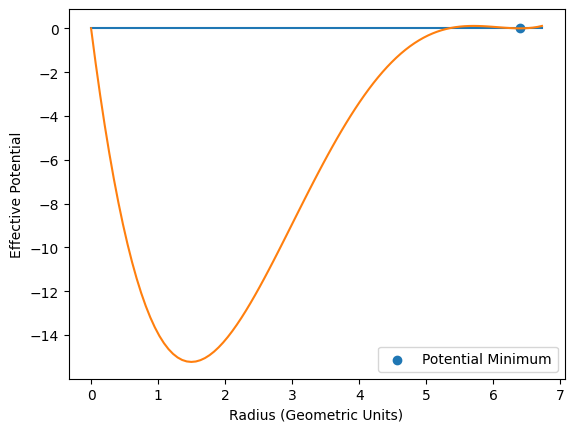

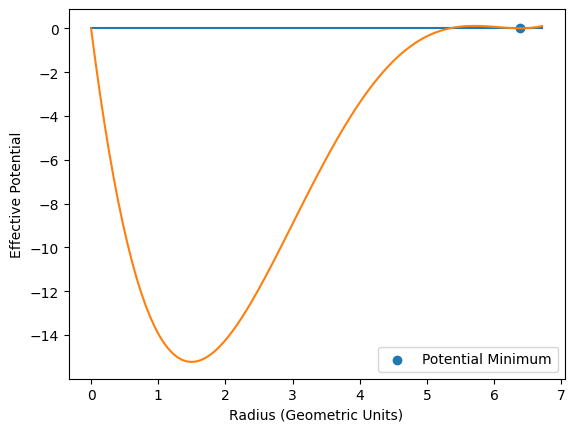

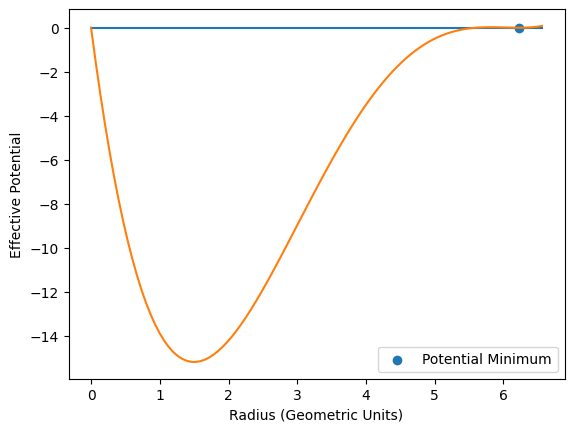

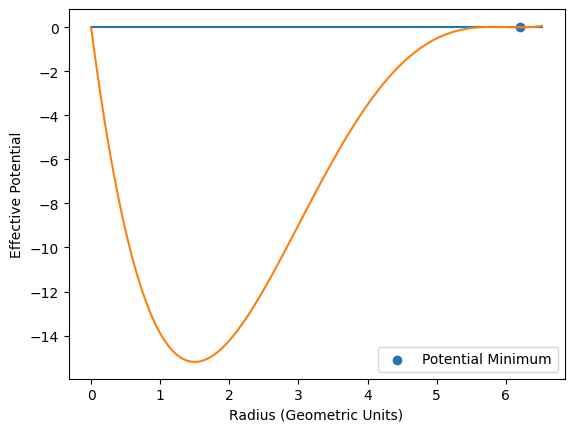

In [72]:
gwah1 = ml.EMRIGenerator(0.0, 1e-3, params=[6.7/(1-0.04**2), 0.04, np.pi/2], bonk=4, label="wink %s,%s,%s"%(10, 0.5, np.round(np.pi/2,4)), trigger=2, err_target=1e-10)
gwah2 = ml.EMRIGenerator(0.0, 1e-3, params=[6.7/(1-0.04**2), 0.04, np.pi/2], bonk=4, label="wink %s,%s,%s"%(10, 0.5, np.round(np.pi/2,4)), trigger=2, err_target=1e-11)
gwah3 = ml.EMRIGenerator(0.0, 1e-3, params=[6.7/(1-0.04**2), 0.04, np.pi/2], bonk=4, label="wink %s,%s,%s"%(10, 0.5, np.round(np.pi/2,4)), trigger=2, err_target=1e-12)
gwah4 = ml.EMRIGenerator(0.0, 1e-3, params=[6.7/(1-0.04**2), 0.04, np.pi/2], bonk=4, label="wink %s,%s,%s"%(10, 0.5, np.round(np.pi/2,4)), trigger=2, err_target=1e-13)
gwah5 = ml.EMRIGenerator(0.0, 1e-3, params=[6.7/(1-0.04**2), 0.04, np.pi/2], bonk=4, label="wink %s,%s,%s"%(10, 0.5, np.round(np.pi/2,4)), trigger=2, err_target=1e-14)
gwah6 = ml.EMRIGenerator(0.0, 1e-3, params=[6.7/(1-0.04**2), 0.04, np.pi/2], bonk=4, label="wink %s,%s,%s"%(10, 0.5, np.round(np.pi/2,4)), trigger=2, err_target=1e-15)



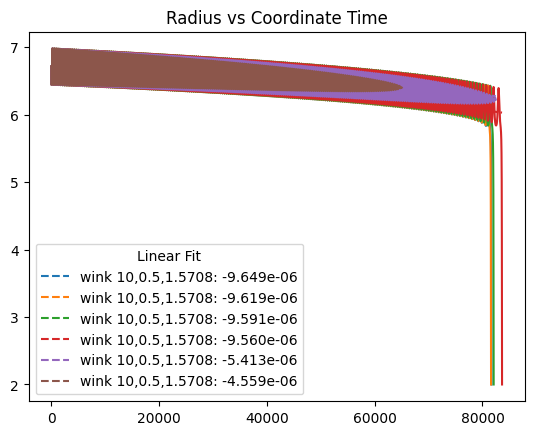

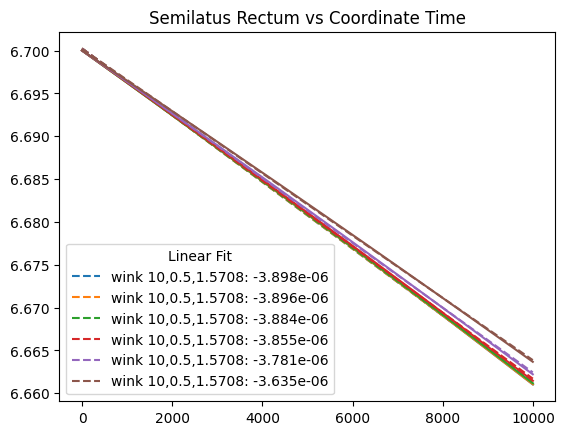

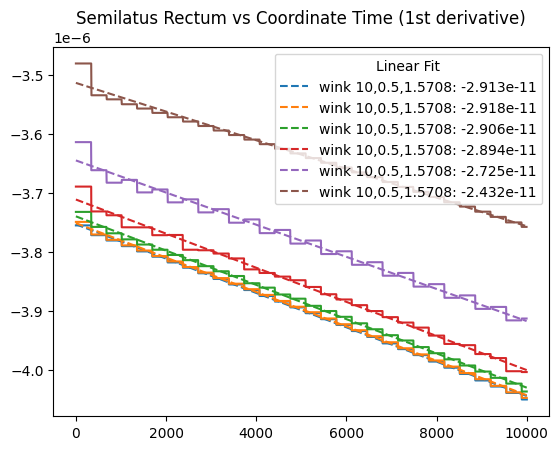

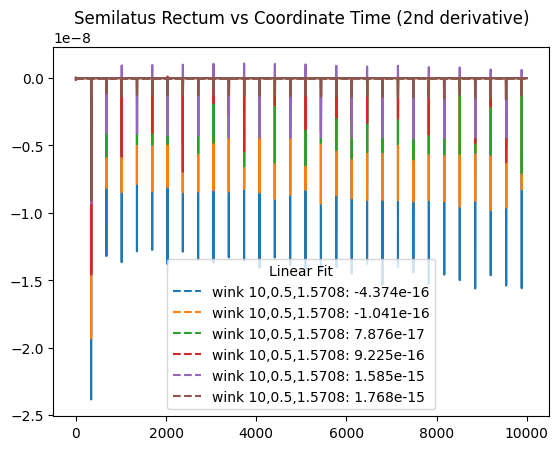

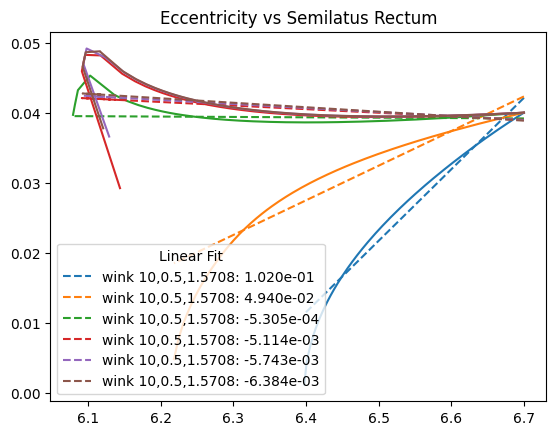

...

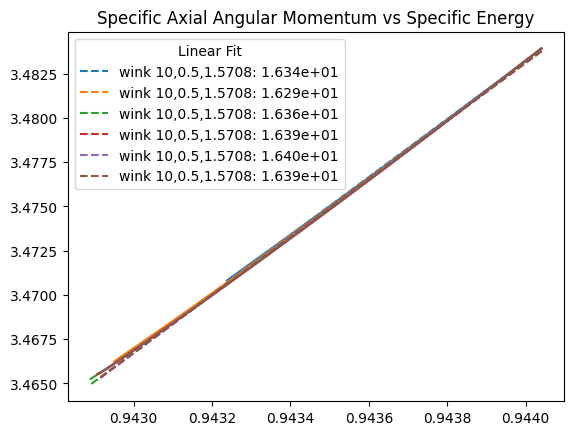

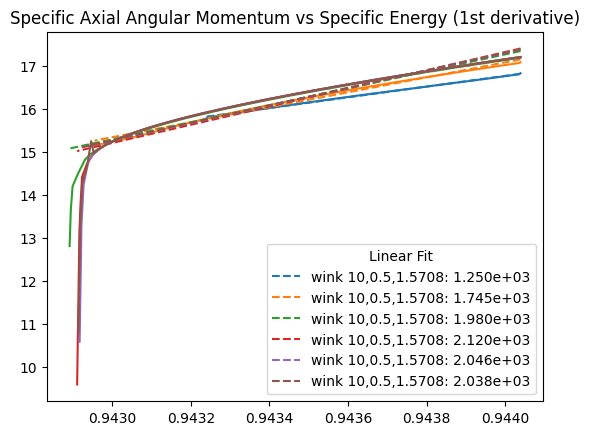

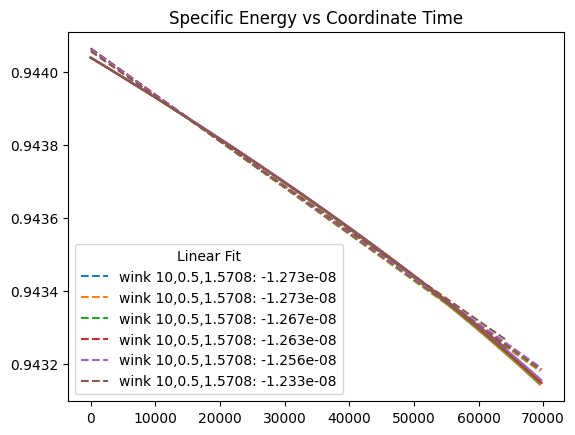

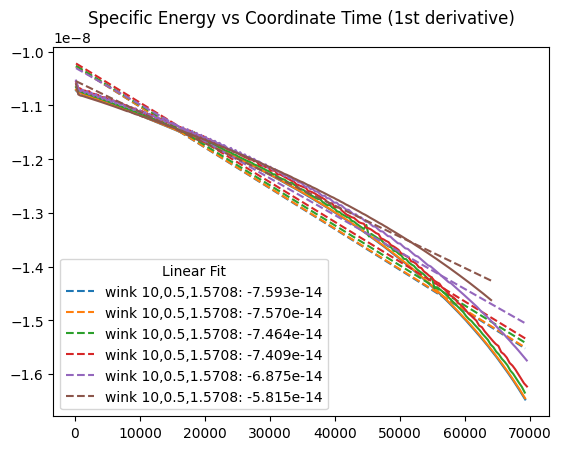

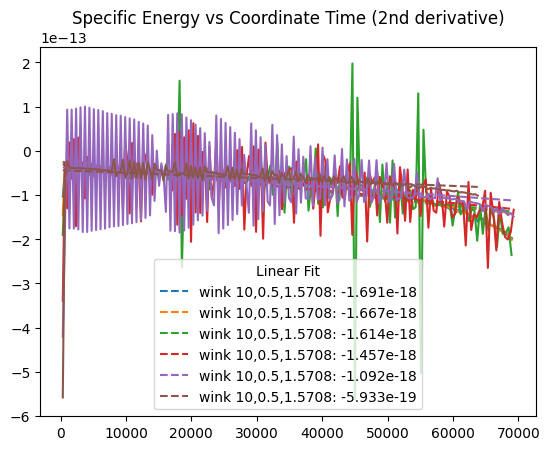

5.716648201570606
4.45605019234927
2.6973417842086893
1.6950318447671746
1.0721275876046534
0.6758917043344034


In [73]:
lis = [gwah1, gwah2, gwah3, gwah4, gwah5, gwah6]
op.plotvalue3(lis[::-1], "time", "radius")
op.plotvalue3(lis[::-1], "time", "semi_lat", end=10000)
op.plotvalue3(lis[::-1], "time", "semi_lat", end=10000, derv=1)
op.plotvalue3(lis[::-1], "time", "semi_lat", end=10000, derv=2)
op.plotvalue3(lis, "semi_lat", "ecc")
op.plotvalue3(lis, "semi_lat", "ecc", derv=1)
op.plotvalue3(lis, "energy", "L_z")
op.plotvalue3(lis, "energy", "L_z", derv=1)
op.plotvalue3(lis[::-1], "tracktime", "energy", end=70000)
op.plotvalue3(lis[::-1], "tracktime", "energy", end=70000, derv=1)
op.plotvalue3(lis[::-1], "tracktime", "energy", end=70000, derv=2)

for sim in lis:
    print(sim["time"][-1]/len(sim["time"]))

Test spins with a = 0, +/- 0.05
tighter tolerances for retrograde inclined spins
Test straight geodesic for E,L,C conservation across different tolerances

new


10000310.875757638it [00:08, 1115899.57it/s]                              


new


10998142.35602342it [00:10, 1024681.98it/s]                              


new


10968369.956831504it [00:12, 865657.39it/s]                               


new


 30%|██▉       | 2993539.9706203938/10000000 [00:16<00:52, 134592.44it/s] c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\matplotlib\cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\matplotlib\cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)
 30%|███       | 3000936.0482172198/10000000 [00:16<00:38, 180824.78it/s]

[6.88809446 5.6940929  1.51418406]
[6.88809446 5.6940929  1.51418406]
[ -0.42564145   6.         -24.8034883   25.27820479]
[6.88809446 5.6940929  1.51418406]
sta
6.888094456750045 [6.88809446 5.6940929  1.51418406]
ROOTER
(array([6.13440455e-04+0.j        , 4.91617630e+00+0.j        ,
       6.93918607e+00-0.39247622j, 6.93918607e+00+0.39247622j]), array([1.51418406+0.j, 5.6940929 +0.j, 6.88809446+0.j]), array([-101.45451693+0.j,   -0.70709324+0.j,    0.70709324+0.j,
        101.45451693+0.j]))
(-0.22639034627376808+0j) -1e-15 whoops

Ending program


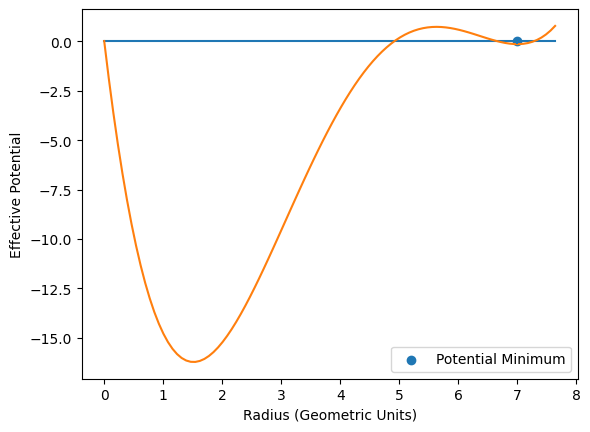

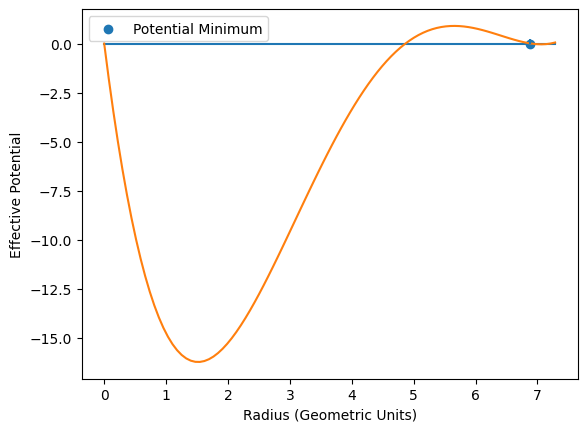

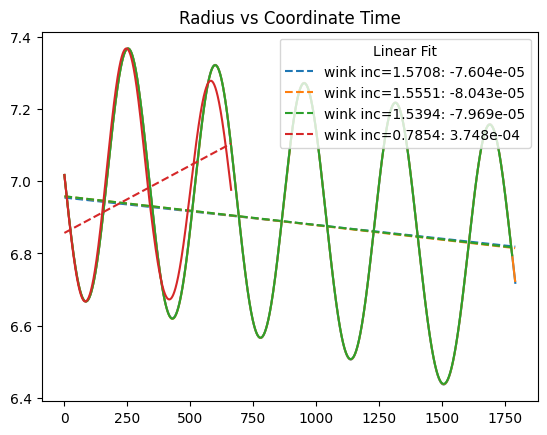

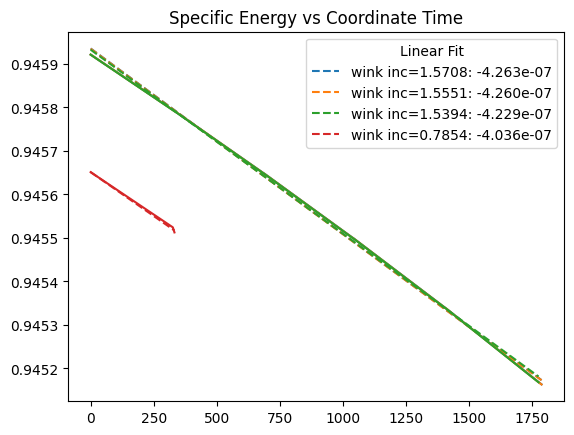

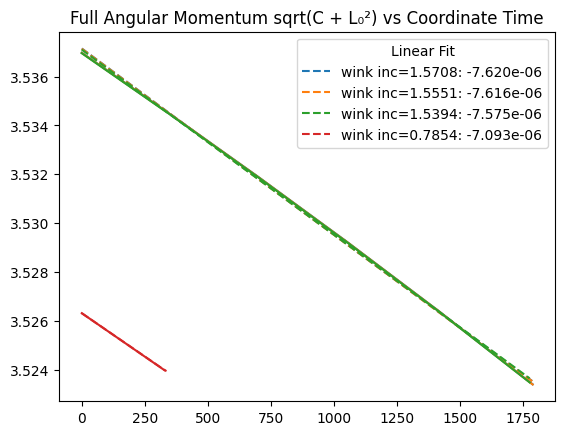

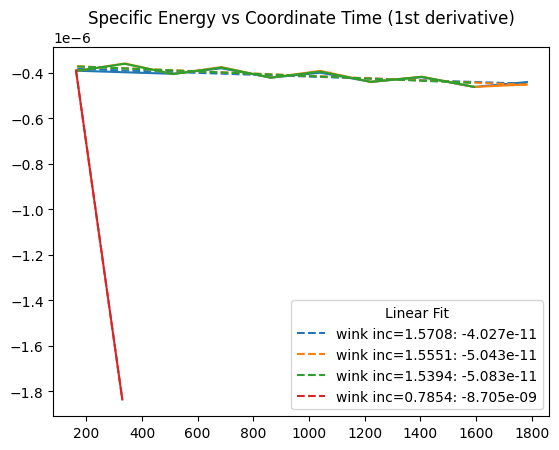

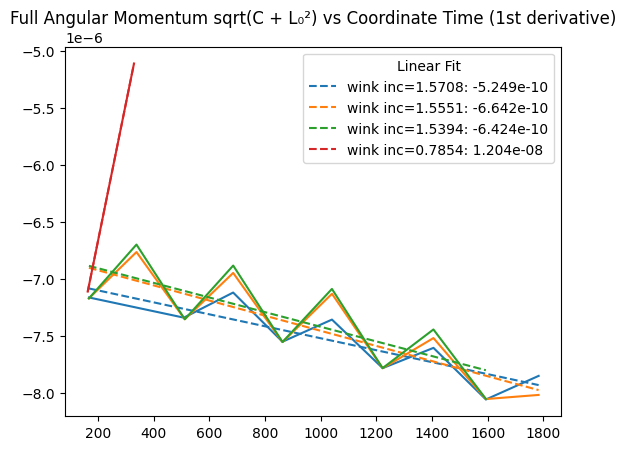

0 -----
old
[-7.60652650e-04 -3.20555734e-21  2.06711199e-21 -1.36017516e-02]
old
[-7.61069808e-04  5.83879571e-05  2.04100350e-04 -1.35934897e-02]
old
[-0.00075606  0.00011514  0.00040553 -0.01349093]
old
[-0.00039574  0.00033107  0.00336968 -0.00335853]
1 -----
old
[-7.60652650e-04 -3.20555734e-21  2.06711199e-21 -1.36017516e-02]
old
[-7.61069808e-04  5.83879571e-05  2.04100350e-04 -1.35934897e-02]
old
[-0.00075606  0.00011514  0.00040553 -0.01349093]
old
[-0.00039574  0.00033107  0.00336968 -0.00335853]
2 -----
old
[-7.60580436e-04 -3.18950887e-21  2.02855573e-21 -1.36006700e-02]
old
[-7.61103632e-04  5.83730873e-05  2.04078663e-04 -1.35919571e-02]
old
[-0.00075648  0.00011513  0.00040552 -0.01349066]
old
[-0.00054348  0.0003318   0.00337798 -0.00336685]
3 -----
[-7.60277108e-04 -3.17667672e-21  2.11269100e-21 -1.36028585e-02]
[-7.60030415e-04  5.83803405e-05  2.04116746e-04 -1.35947263e-02]
[-0.00075447  0.00011513  0.00040556 -0.01349223]
[-0.00028091  0.00033104  0.00336988 -0.00

In [27]:
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt

thoop1 = ml.EMRIGenerator(-0.05, 1e-3, endflag="rad_orbit > 10", params=[7/(1 - 0.05**2), 0.05, np.pi/2], bonk=3, label="wink inc=%s"%(np.round(np.pi/2, 4)), trigger=2, err_target=1e-15)
thoop2 = ml.EMRIGenerator(-0.05, 1e-3, endflag="rad_orbit > 10", params=[7/(1 - 0.05**2), 0.05, 0.99*np.pi/2], bonk=3, label="wink inc=%s"%(np.round(0.99*np.pi/2, 4)), trigger=2, err_target=1e-15)
thoop3 = ml.EMRIGenerator(-0.05, 1e-3, endflag="rad_orbit > 10", params=[7/(1 - 0.05**2), 0.05, 0.98*np.pi/2], bonk=3, label="wink inc=%s"%(np.round(0.98*np.pi/2, 4)), trigger=2, err_target=1e-15)
thoop4 = ml.EMRIGenerator(-0.05, 1e-3, endflag="rad_orbit > 10", params=[7/(1 - 0.05**2), 0.05, 0.50*np.pi/2], bonk=3, label="wink inc=%s"%(np.round(0.50*np.pi/2, 4)), trigger=2, err_target=1e-15)

lst = [thoop1, thoop2, thoop3, thoop4]

op.plotvalue3(lst, "time", "radius")
op.plotvalue3(lst, "tracktime", "energy")
op.plotvalue3(lst, "tracktime", "approx_L")
op.plotvalue3(lst, "tracktime", "energy", derv=1)
op.plotvalue3(lst, "tracktime", "approx_L", derv=1)
#op.plotvalue3([thoop1], "tracktime", "energy", derv=1)
#op.plotvalue3([thoop1], "tracktime", "approx_L", derv=1)



#print(thoop["trackix"])

trylist = [mm.peters_integrate6, mm.peters_integrate6_2, mm.peters_integrate6_3, mm.peters_integrate6_4, mm.peters_integrate7, mm.peters_integrate8, mm.peters_integrate9]

count = 0
for func in trylist:
    print(count, "-----")
    count += 1
    print(func(thoop1["raw"], -0.05, 1e-3, 0, thoop1["trackix"][1]))
    print(func(thoop2["raw"], -0.05, 1e-3, 0, thoop2["trackix"][1]))
    print(func(thoop3["raw"], -0.05, 1e-3, 0, thoop3["trackix"][1]))
    print(func(thoop4["raw"], -0.05, 1e-3, 0, thoop4["trackix"][1]))


In [4]:
(39574/28091)**-1

0.7098347399807954

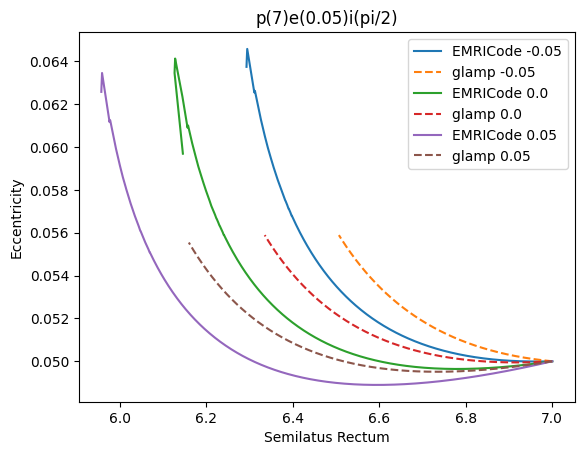

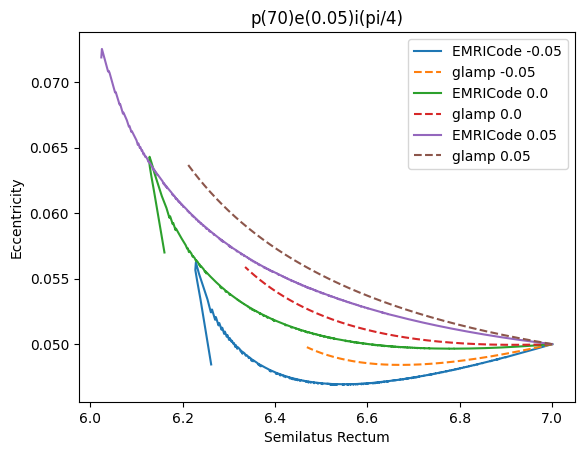

In [2]:
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt

def root_getter_oof(E, L, C, spin):
    a, b, c, d, e = np.array([(E**2 - 1.0), 2.0, ((spin**2)*(E**2 - 1.0) - L**2 - C),  (2*((L - spin*E)**2) + 2*C), -(spin**2)*C]).astype(complex)
    #print(a,b,c,d,e)
    p1 = 2*(c**3) - 9*b*c*d + 27*a*(d**2) + 27*(b**2)*e - 72*a*c*e
    p2 = p1 + (-4*(c**2 - 3*b*d + 12*a*e)**3 + p1**2)**0.5
    p3 = (c**2 - 3*b*d + 12*a*e)/(3*a*((0.5*p2)**(1/3))) + ((0.5*p2)**(1/3))/(3*a)
    p4 = ((b**2)/(4*(a**2)) - (2*c)/(3*a) + p3)**(0.5)
    p5 = (b**2)/(2*(a**2)) - (4*c)/(3*a) - p3
    p6 = (-(b**3)/(a**3) + (4*b*c)/(a**2) - 8*d/a)/(4*p4)
    x1 = -b/(4*a) - p4/2 - 0.5*((p5 - p6)**0.5)
    x2 = -b/(4*a) - p4/2 + 0.5*((p5 - p6)**0.5)
    x3 = -b/(4*a) + p4/2 - 0.5*((p5 + p6)**0.5)
    x4 = -b/(4*a) + p4/2 + 0.5*((p5 + p6)**0.5) 
    turns = np.array([np.real(num) if np.abs(np.imag(num)) < 1e-12 else num for num in [x1, x2, x3, x4]]).astype(complex)
    
    try:
        flats = np.roots([4*a,3*b,2*c,d])
    except:
        print(a,b,c,d,e)
        print(E, L, C, L**2, np.sqrt(L**2 + C))
        flats = np.array([float(input("number baybee: ")) for i in range(5)])
    flats = np.array([np.real(num) if np.abs(np.imag(num)) < 1e-12 else num for num in flats]).astype(complex)
    
    a, b, c, d, e = np.array([(a**2)*(1 - E**2), 0.0, -(C + (a**2)*(1 - E**2) + L**2), 0.0, C]).astype(complex)
    p1 = 2*(c**3) - 9*b*c*d + 27*a*(d**2) + 27*(b**2)*e - 72*a*c*e
    p2 = p1 + (-4*(c**2 - 3*b*d + 12*a*e)**3 + p1**2)**0.5
    p3 = (c**2 - 3*b*d + 12*a*e)/(3*a*((0.5*p2)**(1/3))) + ((0.5*p2)**(1/3))/(3*a)
    p4 = ((b**2)/(4*(a**2)) - (2*c)/(3*a) + p3)**(0.5)
    p5 = (b**2)/(2*(a**2)) - (4*c)/(3*a) - p3
    p6 = (-(b**3)/(a**3) + (4*b*c)/(a**2) - 8*d/a)/(4*p4)
    x1 = -b/(4*a) - p4/2 - 0.5*((p5 - p6)**0.5)
    x2 = -b/(4*a) - p4/2 + 0.5*((p5 - p6)**0.5)
    x3 = -b/(4*a) + p4/2 - 0.5*((p5 + p6)**0.5)
    x4 = -b/(4*a) + p4/2 + 0.5*((p5 + p6)**0.5) 
    zs = np.array([np.real(num) if np.abs(np.imag(num)) < 1e-5 else num for num in [x1, x2, x3, x4]]).astype(complex)
    
    return np.sort(turns), np.sort(flats), np.sort(zs)

def glamper(p, e, i, a, mu, frac):
    b = (64/5)*mu*(1 + mu)
    full = ((p/(1 - e**2))**4)/(4*b)
    dt = full*frac
    E, L, C = mm.schmidtparam3(p/(1 - e**2), e, i, a)
    print(E, L, C)
    cosi = L/np.sqrt(L**2 + C)
    f1 = lambda x: 1 + (73/24)*(x**2) + (37/96)*(x**4)
    f2 = lambda x: 73/12 + (823/24)*(x**2) + (949/32)*(x**4) + (491/192)*(x**6)
    f3 = lambda x: 1 + (7/8)*(x**2)
    f4 = lambda x: 61/24 + (63/8)*(x**2) + (94/64)*(x**4)
    f5 = lambda x: 61/8 + (91/4)*(x**2) + (461/64)*(x**4)
    f6 = lambda x: 97/12 + (37/2)*(x**2) + (211/32)*(x**4)
    vals = [[0, p, e, cosi, E, L, C]]
    p0 = p
    while p/(1 + e) > mm.find_rms(a):
        E_dot = (-32/5)*(mu**2)*(p**(-5))*((1 - e**2)**(3/2))*(f1(e) - a*(p**(-3/2))*cosi*f2(e))
        L_dot = (-32/5)*(mu**2)*(p**(-7/2))*((1 - e**2)**(3/2))*(cosi*f3(e) + a*(p**(-3/2))*(f4(e) - (cosi**2)*f5(e)))
        Q_dot = (-64/5)*(mu**3)*(p**(-3))*((1 - e**2)**(3/2))*(f3(e) - a*(p**(-3/2))*cosi*f6(e))
        C_dot = 2*(C/L)*L_dot if L != 0 else Q_dot - 2*L*L_dot
        E += E_dot*dt
        L += L_dot*dt
        C += C_dot*dt
        turns, flats, zs = root_getter_oof(E, L, C, a)
        turns = np.real(turns)
        e = (turns[-1] - turns[-2])/(turns[-1] + turns[-2])
        cosi = L/np.sqrt(L**2 + C)
        p = 0.5*(turns[-1] + turns[-2])*(1 - e**2)
        vals.append([vals[-1][0] + dt, p, e, cosi, E, L, C])
        if p < 0.9*p0:
            #print(p)
            p0 = p
        #print(p, e, cosi)
    return np.array(vals)

spins = [-0.05, 0.0, 0.05]

#sim =        ml.EMRIGenerator(-0.9, 1e-3, endflag="rad_orbit > 10", params=[20/(1 - 0.2**2), 0.2, np.pi/4], bonk=3, label="wink inc=%s"%(np.round(np.pi/4, 3)), trigger=2, err_target=1e-15)
#sims_flat = [ml.EMRIGenerator(a, 1e-5, endflag="radius < 2", params=[7/(1 - 0.05**2), 0.05, np.pi/2], bonk=3, label="wink inc=%s"%(np.round(np.pi/2, 4)), trigger=2, err_target=1e-15, override=True) for a in spins]
#sims_tilt = [ml.EMRIGenerator(a, 1e-5, endflag="radius < 2", params=[7/(1 - 0.05**2), 0.05, np.pi/4], bonk=3, label="wink inc=%s"%(np.round(np.pi/4, 4)), trigger=2, err_target=1e-15, override=True) for a in spins]
#glamps_flat = [glamper(7, 0.05, np.pi/2, a, 1e-5, 10**(-2)) for a in spins]
#glamps_tilt = [glamper(7, 0.05, np.pi/4, a, 1e-5, 10**(-2)) for a in spins]

fig1, ax1 = plt.subplots()
fig2, ax2 = plt.subplots()
for i in range(3):
    ax1.plot(sims_flat[i]["p"], sims_flat[i]["e"], label="EMRICode %s"%(spins[i]))
    ax1.plot(glamps_flat[i][:,1], glamps_flat[i][:,2], label="glamp %s"%(spins[i]),linestyle="--")
    ax2.plot(sims_tilt[i]["p"], sims_tilt[i]["e"], label="EMRICode %s"%(spins[i]))
    ax2.plot(glamps_tilt[i][:,1], glamps_tilt[i][:,2], label="glamp %s"%(spins[i]),linestyle="--")
ax1.set_title("p(7)e(0.05)i(pi/2)")
ax1.set_xlabel("Semilatus Rectum")
ax1.set_ylabel("Eccentricity")
ax2.set_title("p(70)e(0.05)i(pi/4)")
ax2.set_xlabel("Semilatus Rectum")
ax2.set_ylabel("Eccentricity")
ax1.legend()
ax2.legend()

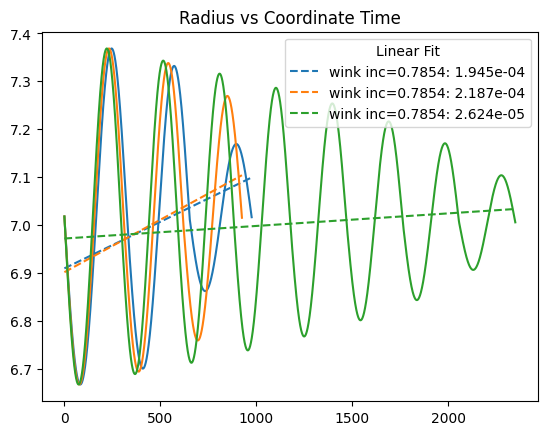

In [ ]:
op.plotvalue3(sims_tilt,"time","radius")

In [2]:
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt

def root_getter_oof(E, L, C, spin):
    a, b, c, d, e = np.array([(E**2 - 1.0), 2.0, ((spin**2)*(E**2 - 1.0) - L**2 - C),  (2*((L - spin*E)**2) + 2*C), -(spin**2)*C]).astype(complex)
    #print(a,b,c,d,e)
    p1 = 2*(c**3) - 9*b*c*d + 27*a*(d**2) + 27*(b**2)*e - 72*a*c*e
    p2 = p1 + (-4*(c**2 - 3*b*d + 12*a*e)**3 + p1**2)**0.5
    p3 = (c**2 - 3*b*d + 12*a*e)/(3*a*((0.5*p2)**(1/3))) + ((0.5*p2)**(1/3))/(3*a)
    p4 = ((b**2)/(4*(a**2)) - (2*c)/(3*a) + p3)**(0.5)
    p5 = (b**2)/(2*(a**2)) - (4*c)/(3*a) - p3
    p6 = (-(b**3)/(a**3) + (4*b*c)/(a**2) - 8*d/a)/(4*p4)
    x1 = -b/(4*a) - p4/2 - 0.5*((p5 - p6)**0.5)
    x2 = -b/(4*a) - p4/2 + 0.5*((p5 - p6)**0.5)
    x3 = -b/(4*a) + p4/2 - 0.5*((p5 + p6)**0.5)
    x4 = -b/(4*a) + p4/2 + 0.5*((p5 + p6)**0.5) 
    turns = np.array([np.real(num) if np.abs(np.imag(num)) < 1e-12 else num for num in [x1, x2, x3, x4]]).astype(complex)
    
    try:
        flats = np.roots([4*a,3*b,2*c,d])
    except:
        print(a,b,c,d,e)
        print(E, L, C, L**2, np.sqrt(L**2 + C))
        flats = np.array([float(input("number baybee: ")) for i in range(5)])
    flats = np.array([np.real(num) if np.abs(np.imag(num)) < 1e-12 else num for num in flats]).astype(complex)
    
    a, b, c, d, e = np.array([(a**2)*(1 - E**2), 0.0, -(C + (a**2)*(1 - E**2) + L**2), 0.0, C]).astype(complex)
    p1 = 2*(c**3) - 9*b*c*d + 27*a*(d**2) + 27*(b**2)*e - 72*a*c*e
    p2 = p1 + (-4*(c**2 - 3*b*d + 12*a*e)**3 + p1**2)**0.5
    p3 = (c**2 - 3*b*d + 12*a*e)/(3*a*((0.5*p2)**(1/3))) + ((0.5*p2)**(1/3))/(3*a)
    p4 = ((b**2)/(4*(a**2)) - (2*c)/(3*a) + p3)**(0.5)
    p5 = (b**2)/(2*(a**2)) - (4*c)/(3*a) - p3
    p6 = (-(b**3)/(a**3) + (4*b*c)/(a**2) - 8*d/a)/(4*p4)
    x1 = -b/(4*a) - p4/2 - 0.5*((p5 - p6)**0.5)
    x2 = -b/(4*a) - p4/2 + 0.5*((p5 - p6)**0.5)
    x3 = -b/(4*a) + p4/2 - 0.5*((p5 + p6)**0.5)
    x4 = -b/(4*a) + p4/2 + 0.5*((p5 + p6)**0.5) 
    zs = np.array([np.real(num) if np.abs(np.imag(num)) < 1e-5 else num for num in [x1, x2, x3, x4]]).astype(complex)
    
    return np.sort(turns), np.sort(flats), np.sort(zs)

def glamper(p, e, i, a, mu, frac):
    b = (64/5)*mu*(1 + mu)
    full = ((p/(1 - e**2))**4)/(4*b)
    dt = full*frac
    E, L, C = mm.schmidtparam3(p/(1 - e**2), e, i, a)
    print(E, L, C)
    cosi = L/np.sqrt(L**2 + C)
    f1 = lambda x: 1 + (73/24)*(x**2) + (37/96)*(x**4)
    f2 = lambda x: 73/12 + (823/24)*(x**2) + (949/32)*(x**4) + (491/192)*(x**6)
    f3 = lambda x: 1 + (7/8)*(x**2)
    f4 = lambda x: 61/24 + (63/8)*(x**2) + (94/64)*(x**4)
    f5 = lambda x: 61/8 + (91/4)*(x**2) + (461/64)*(x**4)
    f6 = lambda x: 97/12 + (37/2)*(x**2) + (211/32)*(x**4)
    vals = [[0, p, e, cosi, E, L, C]]
    p0 = p
    while p/(1 + e) > mm.find_rms(a):
        E_dot = (-32/5)*(mu**2)*(p**(-5))*((1 - e**2)**(3/2))*(f1(e) - a*(p**(-3/2))*cosi*f2(e))
        L_dot = (-32/5)*(mu**2)*(p**(-7/2))*((1 - e**2)**(3/2))*(cosi*f3(e) + a*(p**(-3/2))*(f4(e) - (cosi**2)*f5(e)))
        Q_dot = (-64/5)*(mu**3)*(p**(-3))*((1 - e**2)**(3/2))*(f3(e) - a*(p**(-3/2))*cosi*f6(e))
        C_dot = 2*(C/L)*L_dot if L != 0 else Q_dot - 2*L*L_dot
        E += E_dot*dt
        L += L_dot*dt
        C += C_dot*dt
        turns, flats, zs = root_getter_oof(E, L, C, a)
        turns = np.real(turns)
        e = (turns[-1] - turns[-2])/(turns[-1] + turns[-2])
        cosi = L/np.sqrt(L**2 + C)
        p = 0.5*(turns[-1] + turns[-2])*(1 - e**2)
        vals.append([vals[-1][0] + dt, p, e, cosi, E, L, C])
        if p < 0.9*p0:
            #print(p)
            p0 = p
        #print(p, e, cosi)
    return np.array(vals)

def inc_shows(p, e, a, mu):
    test = glamper(p, e, np.pi/2, a, mu, 10**(-2))
    incs = np.pi*np.array([1/2, 1/4, 1/8, 1/16, 0.0])
    sims = [ml.EMRIGenerator(a, mu, endflag="radius < 2", params=[p/(1 - e**2), e, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 3)), trigger=2, err_target=1e-14) for inc in incs]
    return test, sims, a

spins = [-0.9, -0.3, 0.0, 0.3, 0.9]

0.9623943105944508 4.204794555753398 0.0
new


10000759.444731954it [26:58, 6180.14it/s, Semilat: 9.048, Ecc 0.116]                                 


new


100%|██████████| 10000000.0/10000000 [5:56:23<00:00, 467.66it/s, Semilat: 9.108, Ecc 0.016]         


new


 82%|████████▏ | 8161365.0/10000000 [4:40:18<39:29, 775.87it/s, Semilat: 9.682, Ecc 0.001]         c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\matplotlib\cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\matplotlib\cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


[9.68223911 6.35562412 1.77386528]
[9.68223911 6.35562412 1.77386528]
[ -0.3368567    6.         -30.31227915  36.77052444]
[9.68223911 6.35562412 1.77386528]
sta
9.682239108181603 [9.68223911 6.35562412 1.77386528]
ROOTER
(array([0.32576643+0.j        , 4.05872176+0.j        ,
       9.68224158+0.00416526j, 9.68224158-0.00416526j]), array([1.77386528+0.j, 6.35562412+0.j, 9.68223911+0.j]), array([-158.94184119+0.j,   -0.92418266+0.j,    0.92418266+0.j,
        158.94184119+0.j]))
(-7.687599641492682e-05+0j) -1e-14 whoops

Ending program


 82%|████████▏ | 8161410.0/10000000 [4:40:20<1:03:09, 485.21it/s, Semilat: 9.682, Ecc 0.001]


new


 52%|█████▏    | 5227126.0/10000000 [2:47:20<2:00:21, 660.92it/s, Semilat: 9.89, Ecc 0.001]        

[9.88940855 6.12398391 1.61730315]
[9.88940855 6.12398391 1.61730315]
[ -0.34031556   6.         -29.42405367  33.33324514]
[9.88940855 6.12398391 1.61730315]
sta
9.889408545343317 [9.88940855 6.12398391 1.61730315]
ROOTER
(array([0.41371742+0.j        , 3.31486626+0.j        ,
       9.88950524-0.02739685j, 9.88950524+0.02739685j]), array([1.61730315+0.j, 6.12398391+0.j, 9.88940855+0.j]), array([-154.19998617+0.j,   -0.98087233+0.j,    0.98087233+0.j,
        154.19998617+0.j]))
(-0.00397836618776104+0j) -1e-14 whoops

Ending program


 52%|█████▏    | 5227175.0/10000000 [2:47:21<2:32:48, 520.56it/s, Semilat: 9.89, Ecc 0.001]
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MainLoopStreamline.py:315: RuntimeWarning: invalid value encountered in arccos
  inc = np.arccos(np.sqrt(z2))
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MetricMathStreamline.py:2130: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  Pk = integrate.quad(lambda p: 1/((1-(zm*np.sin(p))**2)*np.sqrt(1 - k*(np.sin(p)**2))), 0, np.pi/2)[0]


new


  8%|▊         | 814010.8092907057/10000000 [00:00<00:01, 8125818.23it/s, Semilat: 10.0, Ecc 0.1]c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MainLoopStreamline.py:594: RuntimeWarning: invalid value encountered in arccos
  if verbose == False:
 12%|█▏        | 1246930.327598366/10000000 [00:36<00:01, 8125818.23it/s, Semilat: 10.001, Ecc 0.099]c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MetricMathStreamline.py:1360: RuntimeWarning: invalid value encountered in scalar divide
  dC = 2*z2*(L0*dLz/(1-z2) - (a**2)*E0*dE)
 12%|█▏        | 1246930.327598366/10000000 [7:55:36<00:01, 8125818.23it/s, Semilat: 10.022, Ecc 0.018]c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\scipy\integrate\_quadpack_py.py:606: ComplexWarning: Casting complex values to real discards the imaginary part
  return _quadpack._qagse(func,a,b,args,full_output,epsabs,epsrel,limit)
 96%|█████████▌| 9567326.833659839/10000000 [7:56:55

0.9623943105944508 4.204794555753398 0.0
0.9602527846249658 2.867673612438215 8.255107356270546
0.958253051659752 1.4958780080525595 13.098506795939834
0.9572466100923435 0.7476340239089203 14.192349749659444
0.9563004532742482 0.0 14.193815622814295


C:\Users\camcinto\AppData\Local\Temp\1\ipykernel_19512\3425063737.py:14: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()
C:\Users\camcinto\AppData\Local\Temp\1\ipykernel_19512\3425063737.py:24: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\IPython\core\events.py:82: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


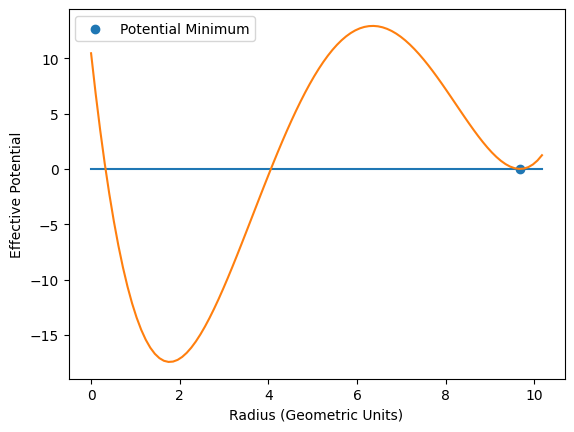

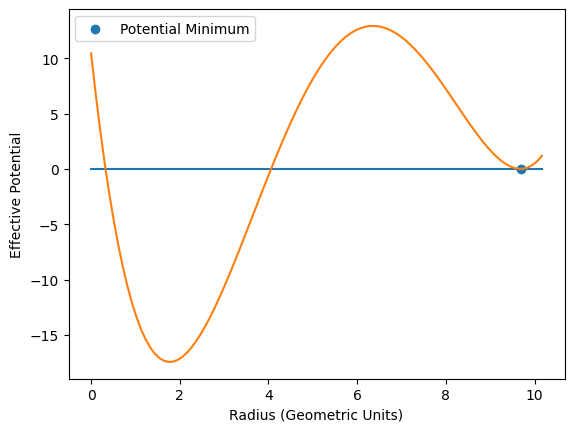

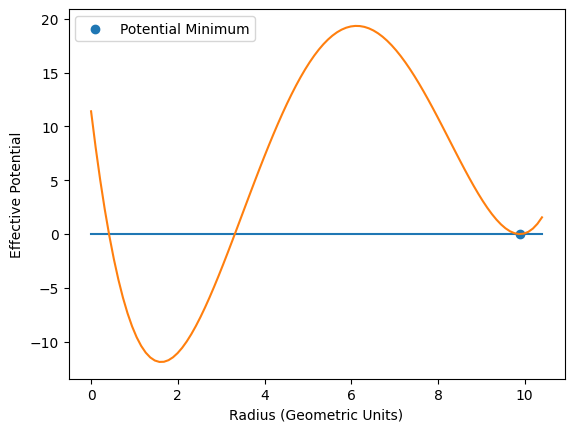

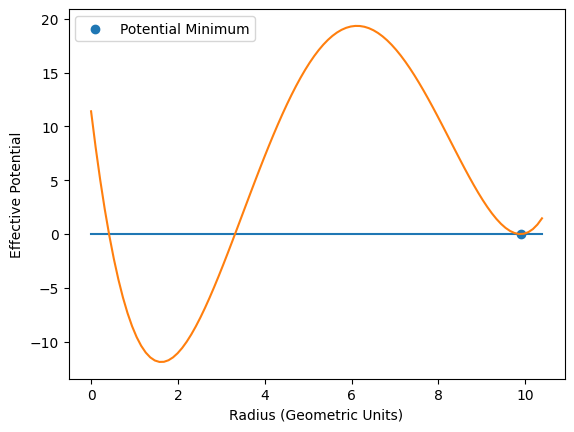

c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


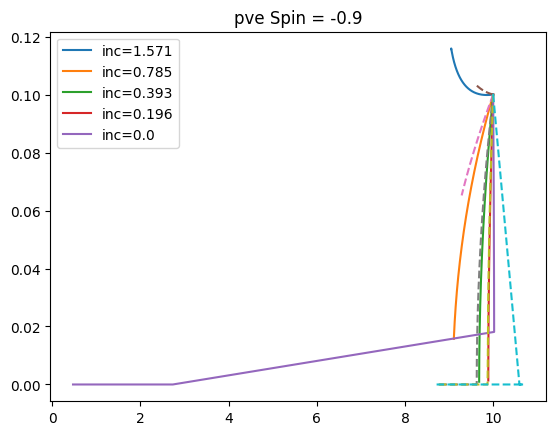

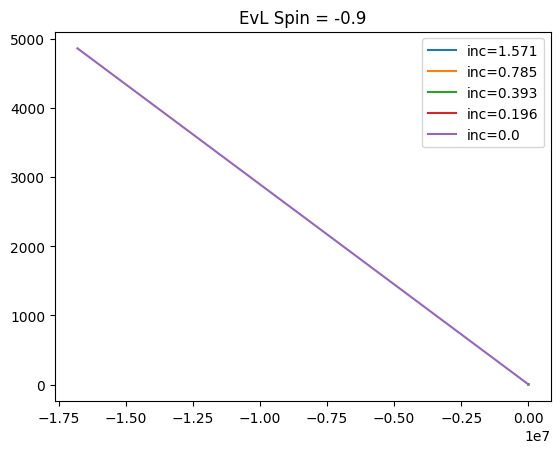

In [3]:
a = spins[0]

data = inc_shows(10, 0.1, a, 1e-5)
glamp_add = [glamper(10, 0.1, inc, a, 1e-5, 10**(-2)) for inc in np.pi*np.array([1/2, 1/4, 1/8, 1/16, 0.0])]

fig, ax = plt.subplots()
for sim in data[1]:
    ax.plot(sim["p"], sim["e"], label=sim["name"][5:])
for sim in glamp_add:
    ax.plot(sim[:,1], sim[:,2], linestyle="--")
#ax.plot(dataset[0][:,1], dataset[0][:,2], label="glamp", linestyle="--")
ax.legend()
ax.set_title("pve Spin = %s"%data[2])
fig.show()

fig, ax = plt.subplots()
for sim in data[1]:
    ax.plot(sim["energy"], np.sqrt(sim["phi_momentum"]**2 + sim["carter"]), label=sim["name"][5:])
for sim in glamp_add[:-1]:
    ax.plot(sim[:,4], np.sqrt(sim[:,5]**2 + sim[:,6]), linestyle="--")
#ax.plot(dataset[0][:,1], dataset[0][:,2], label="glamp", linestyle="--")
ax.legend()
ax.set_title("EvL Spin = %s"%data[2])
fig.show()


In [ ]:
a = spins[1]

data = inc_shows(10, 0.1, a, 1e-5)
glamp_add = [glamper(10, 0.1, inc, a, 1e-5, 10**(-2)) for inc in np.pi*np.array([1/2, 1/4, 1/8, 1/16, 0.0])]

fig, ax = plt.subplots()
for sim in data[1]:
    ax.plot(sim["p"], sim["e"], label=sim["name"][5:])
for sim in glamp_add:
    ax.plot(sim[:,1], sim[:,2], linestyle="--")
#ax.plot(dataset[0][:,1], dataset[0][:,2], label="glamp", linestyle="--")
ax.legend()
ax.set_title("pve Spin = %s"%data[2])
fig.show()

fig, ax = plt.subplots()
for sim in data[1]:
    ax.plot(sim["energy"], np.sqrt(sim["phi_momentum"]**2 + sim["carter"]), label=sim["name"][5:])
for sim in glamp_add[:-1]:
    ax.plot(sim[:,4], np.sqrt(sim[:,5]**2 + sim[:,6]), linestyle="--")
#ax.plot(dataset[0][:,1], dataset[0][:,2], label="glamp", linestyle="--")
ax.legend()
ax.set_title("EvL Spin = %s"%data[2])
fig.show()


0.958269472757148 3.911476668959177 0.0
new


 38%|███▊      | 3773208.0/10000000 [4:15:12<7:01:10, 246.41it/s, Semilat: 9.186, Ecc 0.09]           


Ending program


In [ ]:
a = spins[2]

data = inc_shows(10, 0.1, a, 1e-5)
glamp_add = [glamper(10, 0.1, inc, a, 1e-5, 10**(-2)) for inc in np.pi*np.array([1/2, 1/4, 1/8, 1/16, 0.0])]

fig, ax = plt.subplots()
for sim in data[1]:
    ax.plot(sim["p"], sim["e"], label=sim["name"][5:])
for sim in glamp_add:
    ax.plot(sim[:,1], sim[:,2], linestyle="--")
#ax.plot(dataset[0][:,1], dataset[0][:,2], label="glamp", linestyle="--")
ax.legend()
ax.set_title("pve Spin = %s"%data[2])
fig.show()

fig, ax = plt.subplots()
for sim in data[1]:
    ax.plot(sim["energy"], np.sqrt(sim["phi_momentum"]**2 + sim["carter"]), label=sim["name"][5:])
for sim in glamp_add[:-1]:
    ax.plot(sim[:,4], np.sqrt(sim[:,5]**2 + sim[:,6]), linestyle="--")
#ax.plot(dataset[0][:,1], dataset[0][:,2], label="glamp", linestyle="--")
ax.legend()
ax.set_title("EvL Spin = %s"%data[2])
fig.show()


In [ ]:
a = spins[3]

data = inc_shows(10, 0.1, a, 1e-5)
glamp_add = [glamper(10, 0.1, inc, a, 1e-5, 10**(-2)) for inc in np.pi*np.array([1/2, 1/4, 1/8, 1/16, 0.0])]

fig, ax = plt.subplots()
for sim in data[1]:
    ax.plot(sim["p"], sim["e"], label=sim["name"][5:])
for sim in glamp_add:
    ax.plot(sim[:,1], sim[:,2], linestyle="--")
#ax.plot(dataset[0][:,1], dataset[0][:,2], label="glamp", linestyle="--")
ax.legend()
ax.set_title("pve Spin = %s"%data[2])
fig.show()

fig, ax = plt.subplots()
for sim in data[1]:
    ax.plot(sim["energy"], np.sqrt(sim["phi_momentum"]**2 + sim["carter"]), label=sim["name"][5:])
for sim in glamp_add[:-1]:
    ax.plot(sim[:,4], np.sqrt(sim[:,5]**2 + sim[:,6]), linestyle="--")
#ax.plot(dataset[0][:,1], dataset[0][:,2], label="glamp", linestyle="--")
ax.legend()
ax.set_title("EvL Spin = %s"%data[2])
fig.show()


In [ ]:
a = spins[4]

data = inc_shows(10, 0.1, a, 1e-5)
glamp_add = [glamper(10, 0.1, inc, a, 1e-5, 10**(-2)) for inc in np.pi*np.array([1/2, 1/4, 1/8, 1/16, 0.0])]

fig, ax = plt.subplots()
for sim in data[1]:
    ax.plot(sim["p"], sim["e"], label=sim["name"][5:])
for sim in glamp_add:
    ax.plot(sim[:,1], sim[:,2], linestyle="--")
#ax.plot(dataset[0][:,1], dataset[0][:,2], label="glamp", linestyle="--")
ax.legend()
ax.set_title("pve Spin = %s"%data[2])
fig.show()

fig, ax = plt.subplots()
for sim in data[1]:
    ax.plot(sim["energy"], np.sqrt(sim["phi_momentum"]**2 + sim["carter"]), label=sim["name"][5:])
for sim in glamp_add[:-1]:
    ax.plot(sim[:,4], np.sqrt(sim[:,5]**2 + sim[:,6]), linestyle="--")
#ax.plot(dataset[0][:,1], dataset[0][:,2], label="glamp", linestyle="--")
ax.legend()
ax.set_title("EvL Spin = %s"%data[2])
fig.show()


C:\Users\camcinto\AppData\Local\Temp\1\ipykernel_46764\560386895.py:31: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


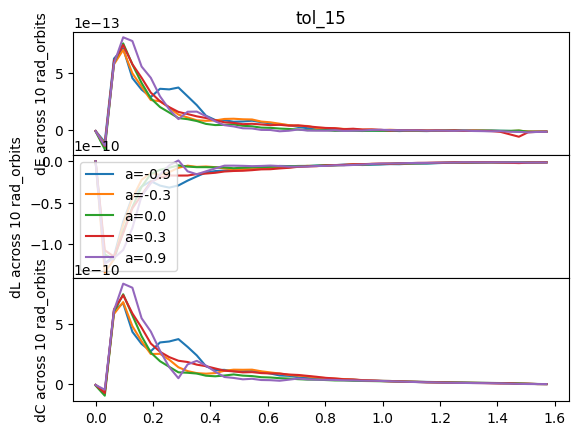

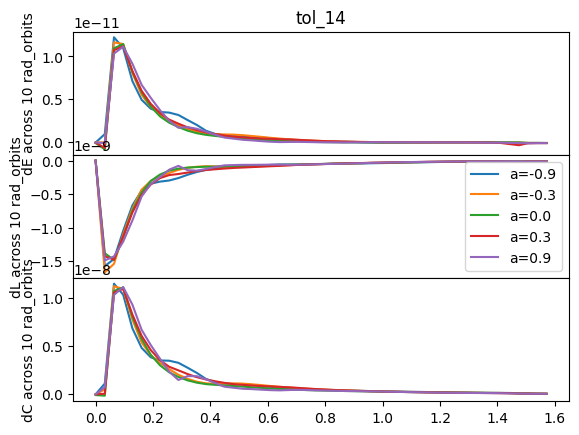

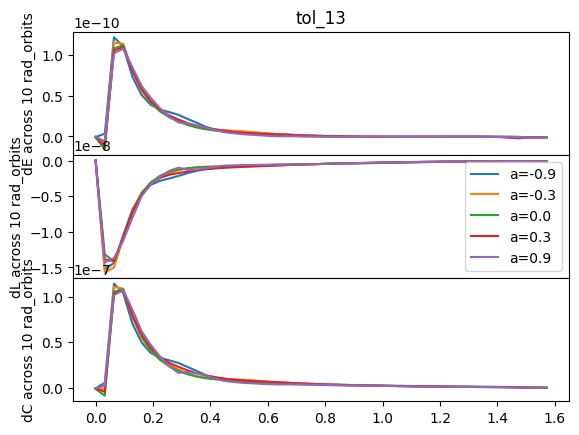

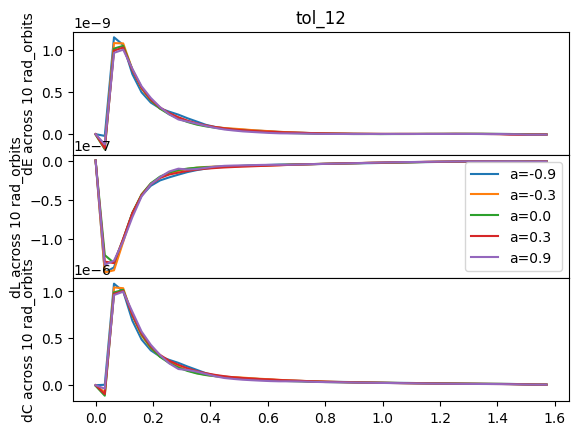

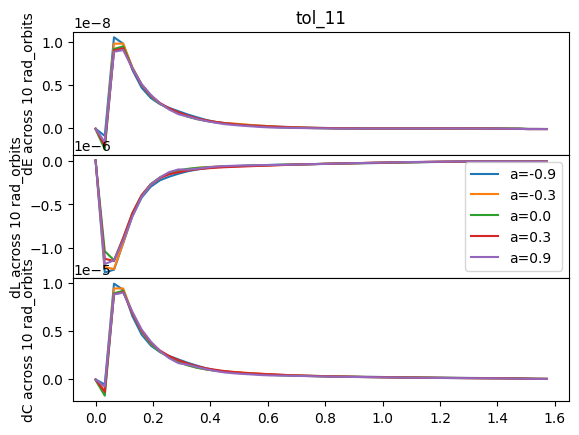

In [14]:
incs = np.linspace(0, np.pi/2)
spins = [-0.9, -0.3, 0.0, 0.3, 0.9]
#tol_15 = [[ml.EMRIGenerator(a, 0.0, endflag="rad_orbit > 10", params=[20/(1 - 0.1**2), 0.1, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 4)), trigger=2, err_target=1e-15) for inc in incs] for a in spins]
#tol_14 = [[ml.EMRIGenerator(a, 0.0, endflag="rad_orbit > 10", params=[20/(1 - 0.1**2), 0.1, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 4)), trigger=2, err_target=1e-14) for inc in incs] for a in spins]
##tol_13 = [[ml.EMRIGenerator(a, 0.0, endflag="rad_orbit > 10", params=[20/(1 - 0.1**2), 0.1, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 4)), trigger=2, err_target=1e-13) for inc in incs] for a in spins]
#tol_12 = [[ml.EMRIGenerator(a, 0.0, endflag="rad_orbit > 10", params=[20/(1 - 0.1**2), 0.1, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 4)), trigger=2, err_target=1e-12) for inc in incs] for a in spins]
#tol_11 = [[ml.EMRIGenerator(a, 0.0, endflag="rad_orbit > 10", params=[20/(1 - 0.1**2), 0.1, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 4)), trigger=2, err_target=1e-11) for inc in incs] for a in spins]

biggo = [tol_15, tol_14, tol_13, tol_12, tol_11]
bigname = ["tol_15", "tol_14", "tol_13", "tol_12", "tol_11"]
for i in range(5):
    fig, [ax1, ax2, ax3] = plt.subplots(3, 1, sharex=True)
    fig.subplots_adjust(hspace=0)
    ax1.set_title(bigname[i])
    #fig.set_title(bigname[i])
    #ax1.set_xlabel("Inclination")
    ax1.set_ylabel("dE across 10 rad_orbits")
    #ax2.set_title(bigname[i])
    #ax2.set_xlabel("Inclination")
    ax2.set_ylabel("dL across 10 rad_orbits")
    #ax3.set_title(bigname[i])
    #ax3.set_xlabel("Inclination")
    ax3.set_ylabel("dC across 10 rad_orbits")
    for j in range(5):
        ax1.plot(incs, [sim["energy"][-1] - sim["energy"][0] for sim in biggo[i][j]], label="a=%s"%(spins[j]))
        ax2.plot(incs, [sim["phi_momentum"][-1] - sim["phi_momentum"][0] for sim in biggo[i][j]], label="a=%s"%(spins[j]))
        ax3.plot(incs, [sim["carter"][-1] - sim["carter"][0] for sim in biggo[i][j]], label="a=%s"%(spins[j]))
    #ax1.legend()
    ax2.legend()
    #ax3.legend()
    fig.show()
    #fig2.show()
    #fig3.show()

[   0.          681.29862972 1362.23373185 2043.02897388 2722.81553486
 3404.07795125 4084.27213956 4764.318045   5445.05332193 6125.46768979
 6805.62275376]


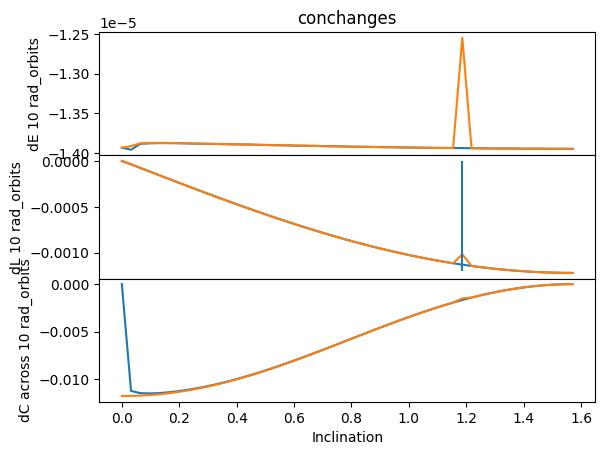

In [109]:
incs = np.linspace(0, np.pi/2)
spins = [-0.9, -0.3, 0.0, 0.3, 0.9]
#barko = [ml.EMRIGenerator(-0.05, 1e-3, endflag="rad_orbit > 10", params=[20/(1 - 0.1**2), 0.1, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 4)), trigger=2, err_target=1e-15) for inc in incs]
#barko3 = [ml.EMRIGenerator(-0.05, 1e-3, endflag="rad_orbit > 10", params=[20/(1 - 0.1**2), 0.1, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 4)), conch=9, trigger=2, err_target=1e-15) for inc in incs]

#tol_15 = [[ml.EMRIGenerator(a, 0.0, endflag="rad_orbit > 10", params=[20/(1 - 0.1**2), 0.1, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 4)), trigger=2, err_target=1e-15) for inc in incs] for a in spins]
#tol_14 = [[ml.EMRIGenerator(a, 0.0, endflag="rad_orbit > 10", params=[20/(1 - 0.1**2), 0.1, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 4)), trigger=2, err_target=1e-14) for inc in incs] for a in spins]
##tol_13 = [[ml.EMRIGenerator(a, 0.0, endflag="rad_orbit > 10", params=[20/(1 - 0.1**2), 0.1, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 4)), trigger=2, err_target=1e-13) for inc in incs] for a in spins]
#tol_12 = [[ml.EMRIGenerator(a, 0.0, endflag="rad_orbit > 10", params=[20/(1 - 0.1**2), 0.1, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 4)), trigger=2, err_target=1e-12) for inc in incs] for a in spins]
#tol_11 = [[ml.EMRIGenerator(a, 0.0, endflag="rad_orbit > 10", params=[20/(1 - 0.1**2), 0.1, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 4)), trigger=2, err_target=1e-11) for inc in incs] for a in spins]

#biggo = [tol_15, tol_14, tol_13, tol_12, tol_11]
#bigname = ["tol_15", "tol_14", "tol_13", "tol_12", "tol_11"]

fig, [ax1, ax2, ax3] = plt.subplots(3, 1, sharex=True)
fig.subplots_adjust(hspace=0)
ax1.set_title("conchanges")
#fig.set_title(bigname[i])
#ax1.set_xlabel("Inclination")
ax1.set_ylabel("dE 10 rad_orbits")
#ax2.set_title(bigname[i])
#ax2.set_xlabel("Inclination")
ax2.set_ylabel("dL 10 rad_orbits")
#ax3.set_title(bigname[i])
ax3.set_xlabel("Inclination")
ax3.set_ylabel("dC across 10 rad_orbits")

ax1.plot(incs, [sim["energy"][-1] - sim["energy"][0] for sim in barko])
ax2.plot(incs, [sim["phi_momentum"][-1] - sim["phi_momentum"][0] for sim in barko])
ax3.plot(incs, [sim["carter"][-1] - sim["carter"][0] for sim in barko])
#ax1.set_yscale("log")
#ax1.legend()
#ax2.legend()
#ax3.legend()
#fig.show()
#fig2.show()
#fig3.show()

#op.plotvalue3(barko[:1], "time", "radius", linefit=False, start=128.6, end=128.8)
#op.plotvalue3(barko[:1], "time", "theta", linefit=False, start=128.6, end=128.8)
#op.plotvalue3(barko[:1], "time", "phase", linefit=False, start=128.6, end=128.8)
#op.plotvalue3(barko[:1], "time", "radius", linefit=False, end=500)
print(barko[0]["tracktime"])

trylist = [mm.peters_integrate6, mm.peters_integrate6_2, mm.peters_integrate6_3, mm.peters_integrate6_4, mm.peters_integrate7, mm.peters_integrate8, mm.peters_integrate9]
#barko2 = np.array([mm.peters_integrate6_4(sim["raw"], -0.05, 1e-3, 0, sim["trackix"][1]) for sim in barko])
#barko4 = np.array([mm.peters_integrate6_4(sim["raw"], -0.05, 1e-3, 0, sim["trackix"][1]) for sim in barko3])


#fig, [ax1, ax2, ax3] = plt.subplots(3, 1, sharex=True)
#fig.subplots_adjust(hspace=0)
#ax1.set_title("conchanges")
#fig.set_title(bigname[i])
#ax1.set_xlabel("Inclination")
#ax1.set_ylabel("dE 10 rad_orbits")
#ax2.set_title(bigname[i])
#ax2.set_xlabel("Inclination")
#ax2.set_ylabel("dL 10 rad_orbits")
#ax3.set_title(bigname[i])
#ax3.set_xlabel("Inclination")
#ax3.set_ylabel("dC across 10 rad_orbits")

#ax1.plot(incs, barko2[:,0])
#ax2.plot(incs, barko2[:,3])
#ax3.plot(incs, barko2[:,1])
#ax3.plot(incs, barko2[:,2])
#ax3.plot(incs, barko2[:,1]**2 + barko2[:,2]**2 + ((-0.05)**2)*(np.cos(incs)**2)*(1 - barko2[:,0]))
#print(barko2[0,0])
#print(barko2[0,1])
#print(barko2[0,2])
#print(barko2[0,3])
#print(barko2[0])
#print(barko2[1])
#print(barko2[2])
#print(barko2[5])
#print(barko2[10])
#print(barko2[-1])
#ax1.set_yscale("log")
#ax1.legend()
#ax2.legend()
#ax3.legend()
#fig.show()
#fig2.show()
#fig3.show()

ax1.plot(incs, [sim["energy"][-1] - sim["energy"][0] for sim in barko3])
ax2.plot(incs, [sim["phi_momentum"][-1] - sim["phi_momentum"][0] for sim in barko3])
ax3.plot(incs, [sim["carter"][-1] - sim["carter"][0] for sim in barko3])
ax2.vlines(incs[37], -0.0012, 0)


In [86]:
incs[1]

np.float64(0.0320570678937734)

1.1623892818282235


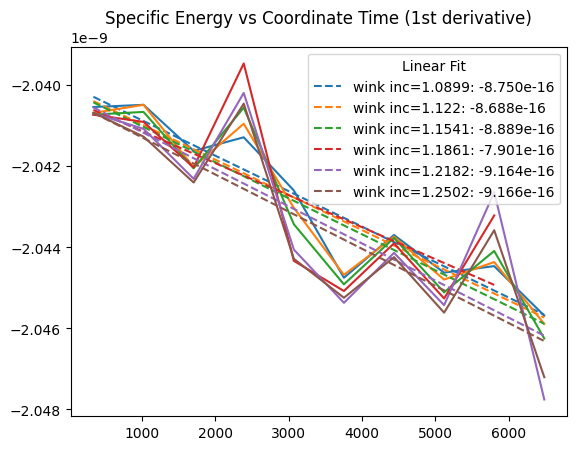

In [108]:
print((37/50)*(np.pi/2))
incs[37]
op.plotvalue3(barko3[34:40], "tracktime", "energy", derv=1)

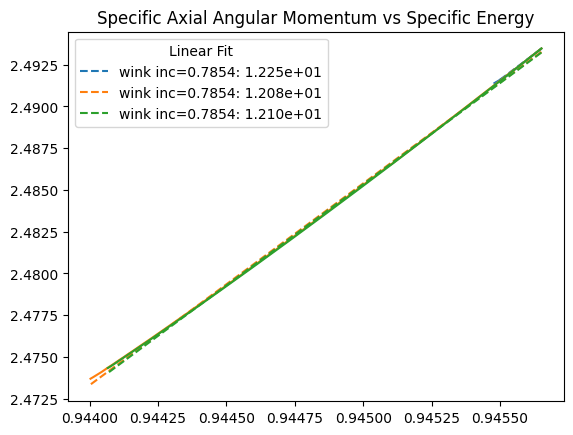

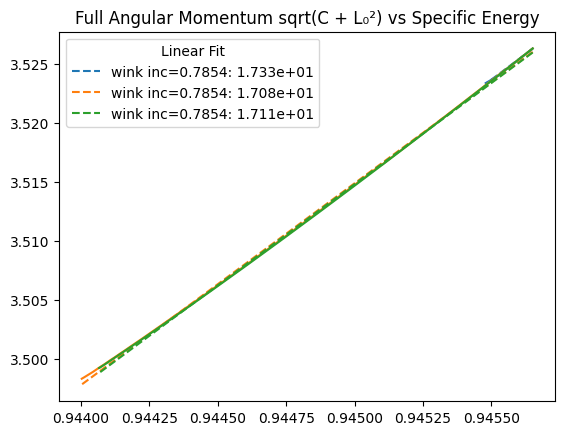

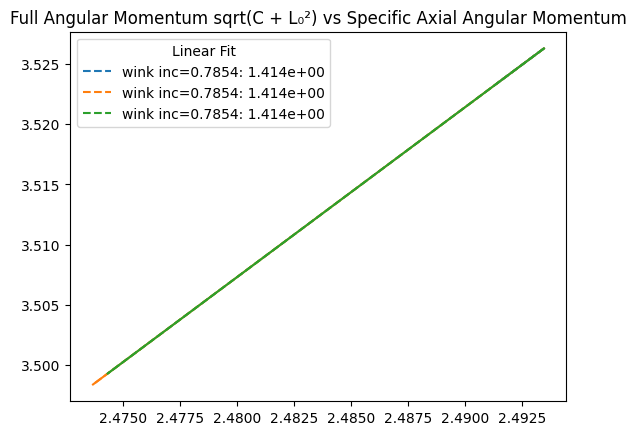

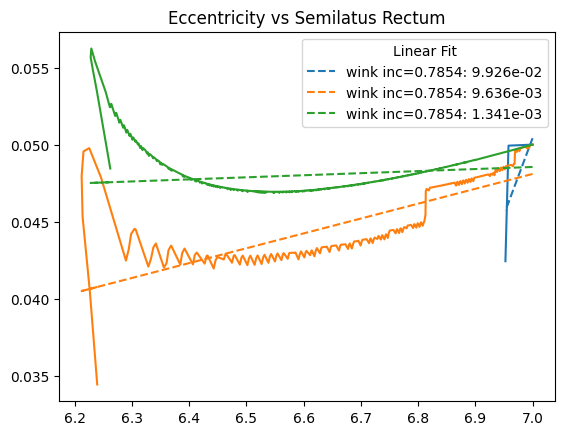

c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


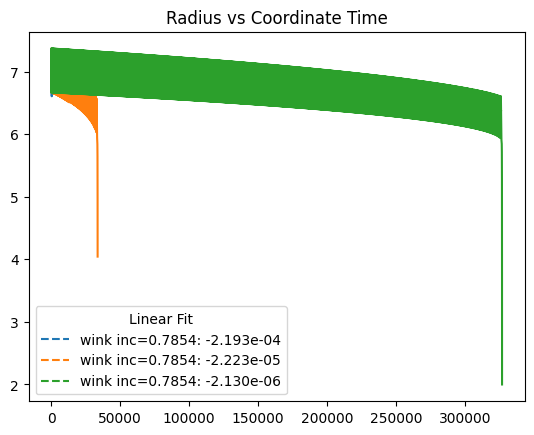

In [3]:
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt

#sim1 = ml.EMRIGenerator(-0.05, 1e-3, endflag="radius < 2", params=[7/(1 - 0.05**2), 0.05, np.pi/4], bonk=3, label="wink inc=%s"%(np.round(np.pi/4, 4)), trigger=2, err_target=1e-15)
#sim2 = ml.EMRIGenerator(-0.05, 1e-4, endflag="radius < 2", params=[7/(1 - 0.05**2), 0.05, np.pi/4], bonk=3, label="wink inc=%s"%(np.round(np.pi/4, 4)), trigger=2, err_target=1e-15)
#sim3 = ml.EMRIGenerator(-0.05, 1e-5, endflag="radius < 2", params=[7/(1 - 0.05**2), 0.05, np.pi/4], bonk=3, label="wink inc=%s"%(np.round(np.pi/4, 4)), trigger=2, err_target=1e-15)
#sim2 = ml.EMRIGenerator(-0.05, 1e-4, endflag="rad_orbit > 100", params=[7/(1 - 0.05**2), 0.05, np.pi/4], bonk=3, label="wink inc=%s"%(np.round(np.pi/4, 3)), trigger=2, err_target=1e-15)
#sim1 = ml.EMRIGenerator(a, 1e-4, endflag="radius < 2", params=[7/(1 - 0.05**2), 0.05, np.pi/4], bonk=3, label="wink inc=%s"%(np.round(np.pi/4, 4)), trigger=2, err_target=1e-15)
lst = [sim1, sim2, sim3]
#op.plotvalue3(lst, "tracktime", "energy")
#op.plotvalue3(lst, "tracktime", "L_z")
#op.plotvalue3(lst, "tracktime", "carter")
op.plotvalue3(lst, "energy", "L_z")
op.plotvalue3(lst, "energy", "approx_L")
op.plotvalue3(lst, "L_z", "approx_L")
op.plotvalue3(lst, "semi_lat", "ecc")
#op.plotvalue3(lst, "r0", "semi_lat")
op.plotvalue3(lst, "time", "radius")
#op.plotvalue3(lst, "time", "radius", derv=1)
#op.plotvalue3(lst, "tracktime", "L_z")
#op.plotvalue3(lst, "tracktime", "carter")
#plt.plot(sim["true_anom"])
#op.orthoplots(lst, azi=0, ele=0)


0 yo
876
4113
7431
10675
13933


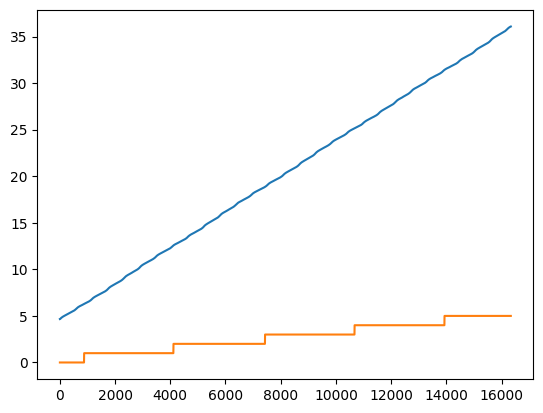

In [33]:
def get_true_anom(state, r0, e):
    pre = np.sign((r0*(1 - e**2)/state[1] - 1)) #e is always positive
    val = np.arccos(pre*min(1.0, abs((r0*(1 - e**2)/state[1] - 1)/(e + 1e-15)))) #add a little tiny bias to get rid of divide by zero errors
    if state[5] < 0:
        val = 2*np.pi - val
    return val

anom = []
orb = []
print(len(anom), "yo")
trackix = 0
add = 0
for i in range(len(sim["raw"])):
    try:
        if sim["time"][i] >= sim["tracktime"][trackix + 1]:
            trackix += 1
    except:
        break
    val = get_true_anom(sim["raw"][i], sim["r0"][trackix], sim["e"][trackix]) + add
    if (len(anom) > 0) and (val - anom[-1] < -np.pi):
        print(i)
        orb[-1] += 1
        val += 2*np.pi
        add += 2*np.pi
    anom.append(val)
    if len(orb) == 0:
        orb.append(0)
    else:
        orb.append(orb[-1])


plt.plot(anom)
plt.plot(orb)
#plt.xlim(3250, 3300)
#plt.ylim(4, 5)


c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MainLoopStreamline.py:315: RuntimeWarning: invalid value encountered in arccos
  inc = np.arccos(np.sqrt(z2))
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MetricMathStreamline.py:2134: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  Pk = integrate.quad(lambda p: 1/((1-(zm*np.sin(p))**2)*np.sqrt(1 - k*(np.sin(p)**2))), 0, np.pi/2)[0]
  1%|          | 91171.77364422062/10000000 [00:01<02:24, 68445.00it/s, Semilat: 10.0, Ecc 0.1] c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MainLoopStreamline.py:591: RuntimeWarning: invalid value encountered in arccos
  inc = np.arccos(np.sqrt(z2))
10000022.924209906it [03:31, 47308.81it/s, Semilat: 10.001, Ecc 0.097]                              
10000090.978639873it [05:48, 28734.32it/s, Semilat: 9.994, Ecc 0.099]                              
10000048.7749447it [05:37, 29594.95it/s, Semilat: 9.988, Ecc 0.099]

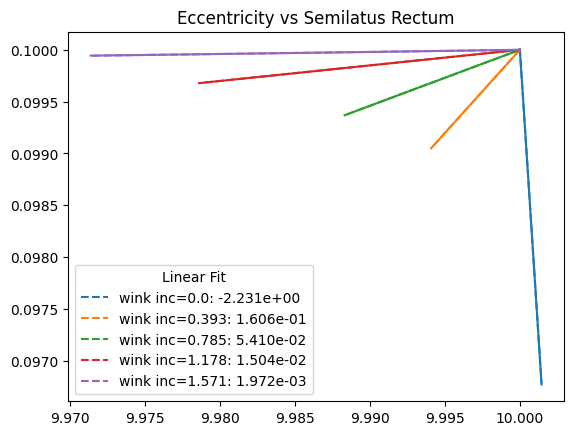

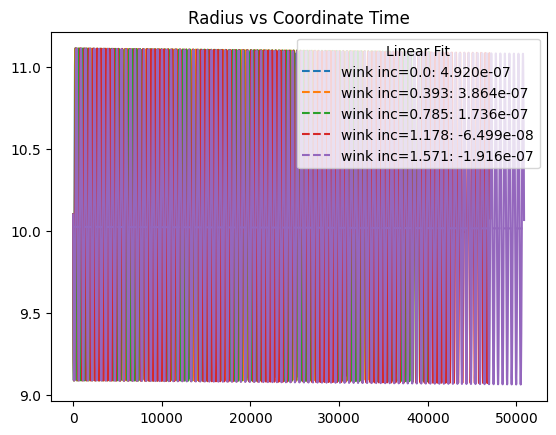

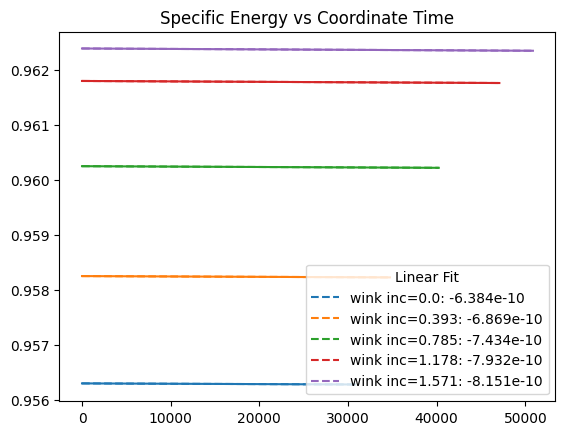

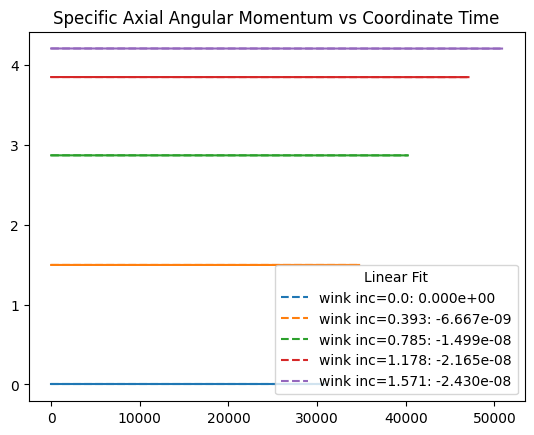

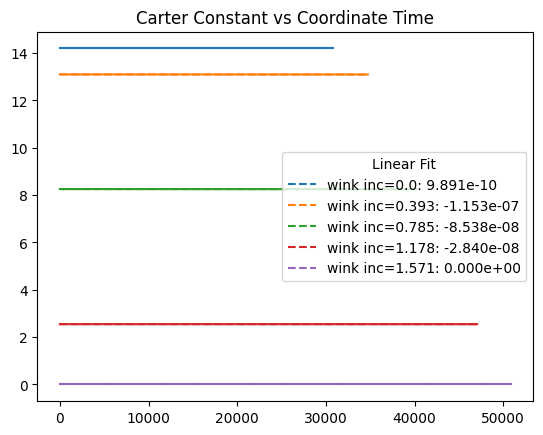

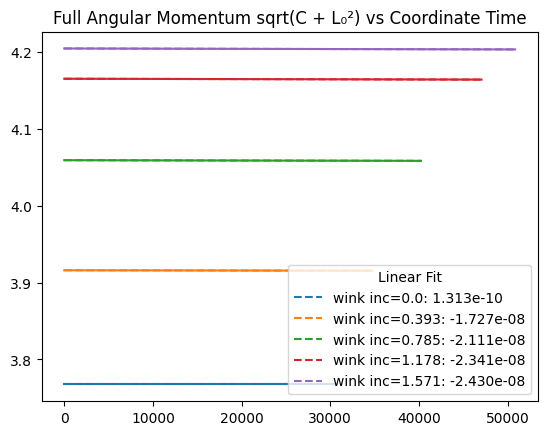

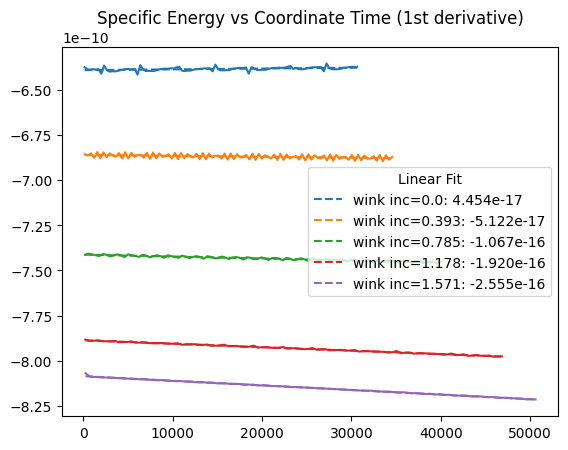

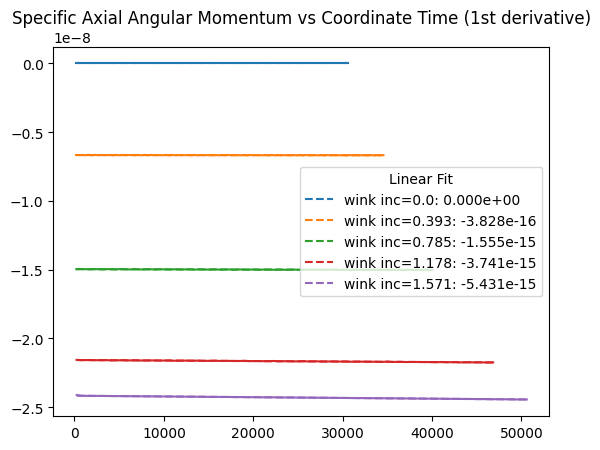

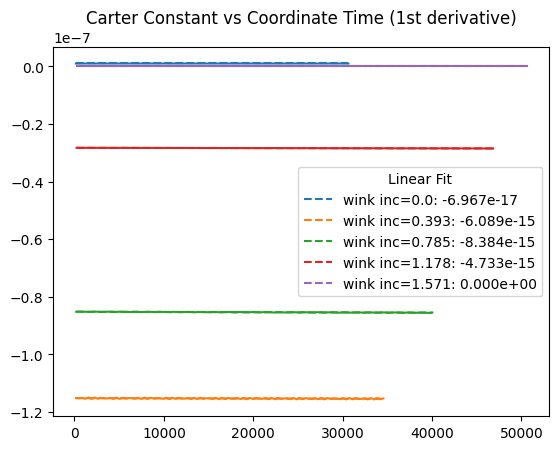

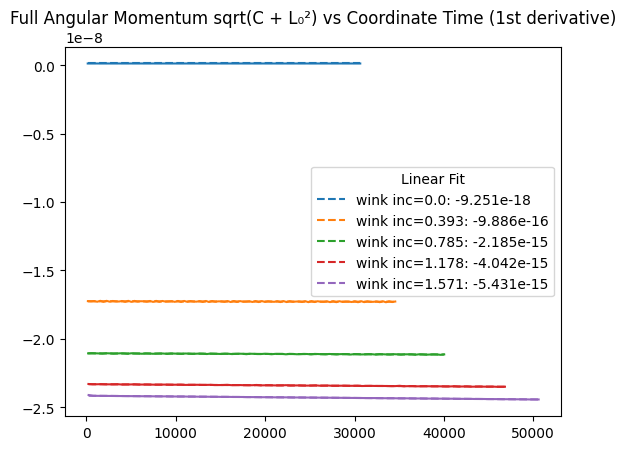

In [5]:
def inc_shows(p, e, a, mu):
    test = glamper(p, e, np.pi/2, a, mu, 10**(-2))
    incs = np.pi*np.array([1/2, 1/4, 1/8, 1/16, 0.0])
    sims = [ml.EMRIGenerator(a, mu, endflag="radius < 2", params=[p/(1 - e**2), e, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 3)), trigger=2, err_target=1e-14) for inc in incs]
    return test, sims, a

spins = [-0.9, -0.3, 0.0, 0.3, 0.9]

things = [ml.EMRIGenerator(-0.9, 1e-5, endflag="rad_orbit > 100", params=[10/(1 - 0.1**2), 0.1, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 3)), trigger=2, err_target=1e-14) for inc in np.pi*np.arange(5)/8]

op.plotvalue3(things, "semi_lat", "ecc")
op.plotvalue3(things, "time", "radius")
op.plotvalue3(things, "tracktime", "energy")
op.plotvalue3(things, "tracktime", "L_z")
op.plotvalue3(things, "tracktime", "carter")
op.plotvalue3(things, "tracktime", "approx_L")
op.plotvalue3(things, "tracktime", "energy", derv=1)
op.plotvalue3(things, "tracktime", "L_z", derv=1)
op.plotvalue3(things, "tracktime", "carter", derv=1)
op.plotvalue3(things, "tracktime", "approx_L", derv=1)

10000007.36056321it [00:41, 238942.62it/s, Semilat: 10.002, Ecc 0.097]                               
10000035.059805648it [04:26, 37588.45it/s, Semilat: 9.994, Ecc 0.1]                              
10000018.11888936it [03:54, 42621.88it/s, Semilat: 9.994, Ecc 0.1]                               
10000032.893208541it [02:54, 57364.56it/s, Semilat: 9.994, Ecc 0.1]                              
10000055.524209004it [01:27, 113648.03it/s, Semilat: 9.994, Ecc 0.1]                              


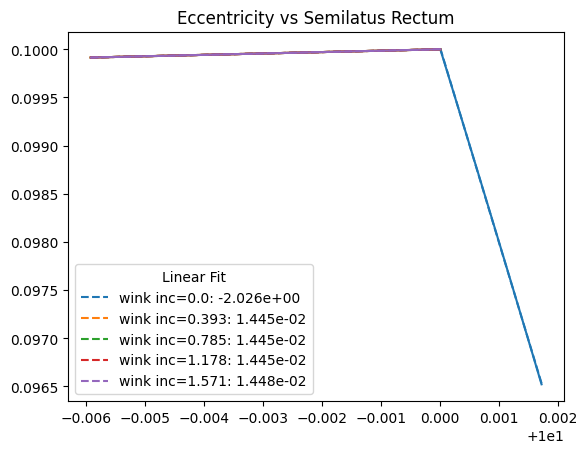

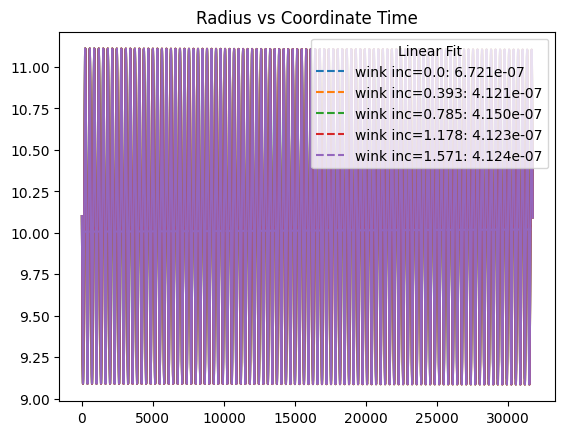

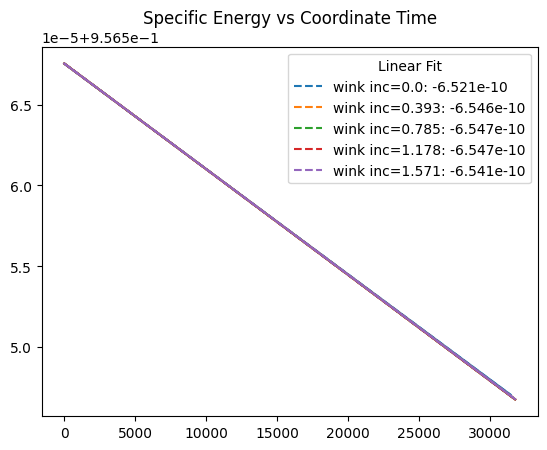

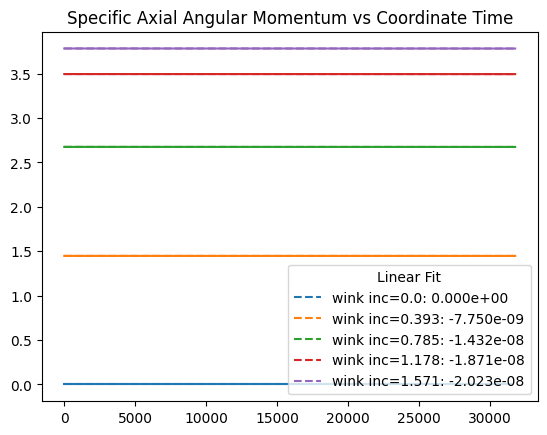

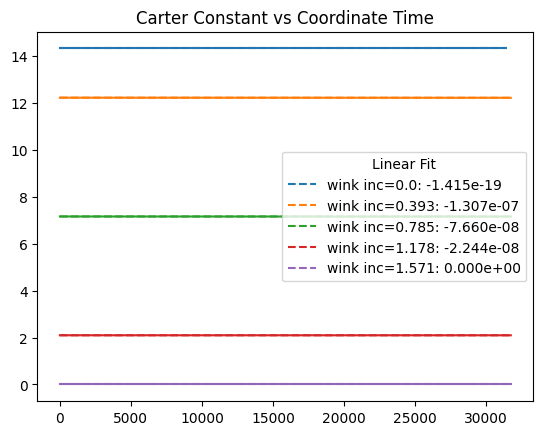

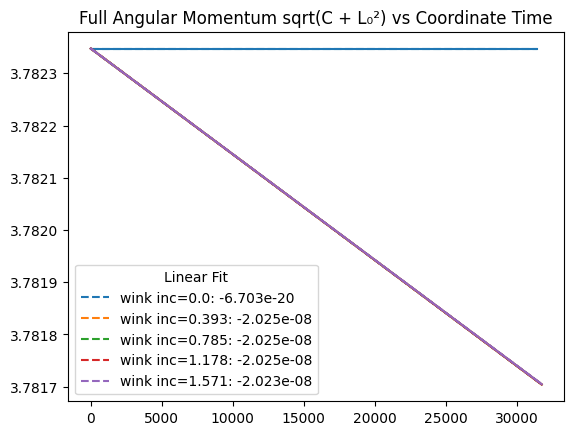

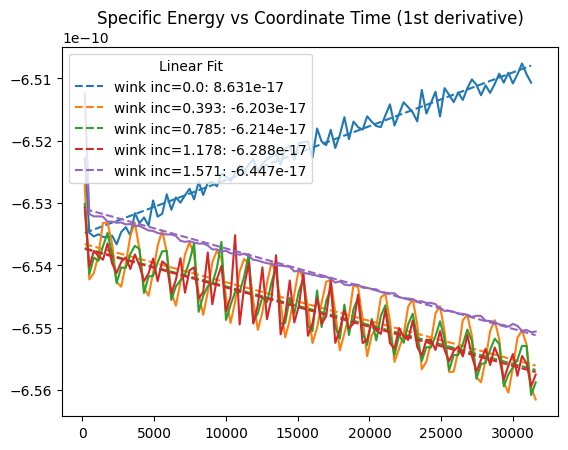

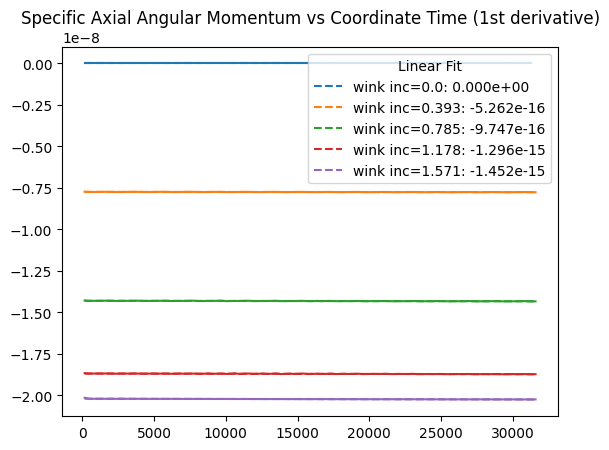

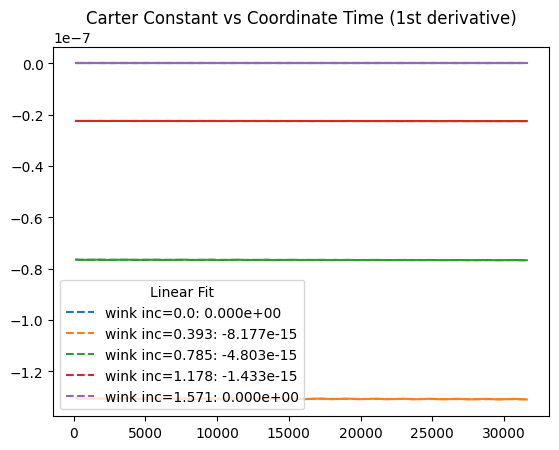

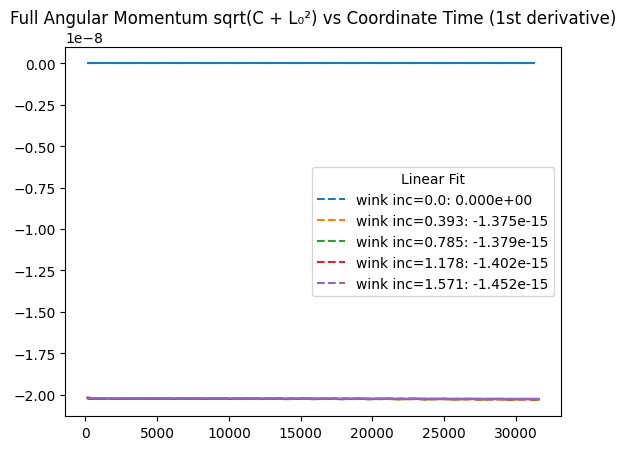

In [6]:
things2 = [ml.EMRIGenerator(0.0, 1e-5, endflag="rad_orbit > 100", params=[10/(1 - 0.1**2), 0.1, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 3)), trigger=2, err_target=1e-14) for inc in np.pi*np.arange(5)/8]

op.plotvalue3(things2, "semi_lat", "ecc")
op.plotvalue3(things2, "time", "radius")
op.plotvalue3(things2, "tracktime", "energy")
op.plotvalue3(things2, "tracktime", "L_z")
op.plotvalue3(things2, "tracktime", "carter")
op.plotvalue3(things2, "tracktime", "approx_L")
op.plotvalue3(things2, "tracktime", "energy", derv=1)
op.plotvalue3(things2, "tracktime", "L_z", derv=1)
op.plotvalue3(things2, "tracktime", "carter", derv=1)
op.plotvalue3(things2, "tracktime", "approx_L", derv=1)

10000808.467108438it [08:38, 19280.95it/s, Semilat: 9.875, Ecc 0.097]                              
10000457.771864008it [05:50, 28531.97it/s, Semilat: 9.876, Ecc 0.097]                              
10000200.062159631it [03:20, 49756.40it/s, Semilat: 9.883, Ecc 0.098]                              
10000106.214257438it [01:33, 107239.96it/s, Semilat: 9.893, Ecc 0.099]                             
10001401.921695001it [00:29, 338090.83it/s, Semilat: 9.898, Ecc 0.1]                               


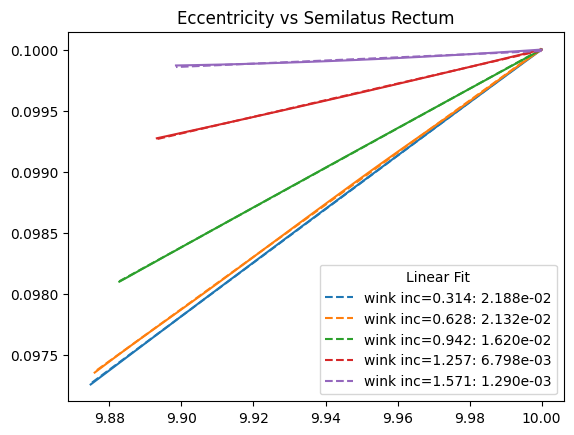

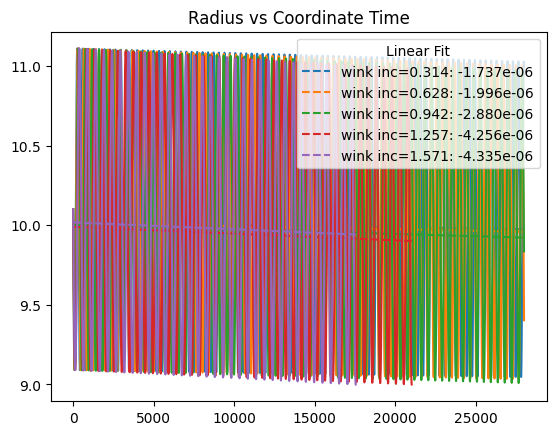

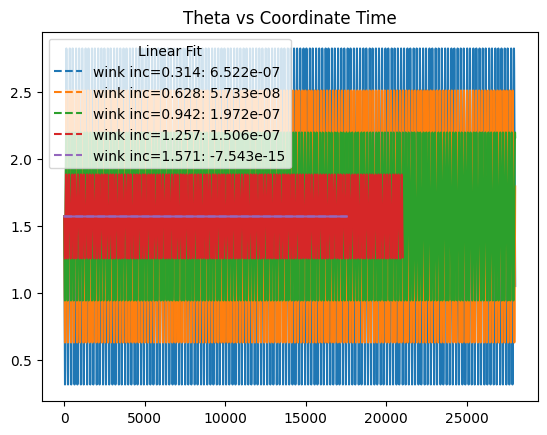

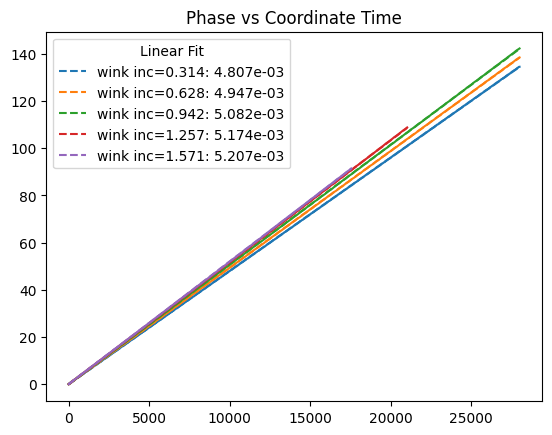

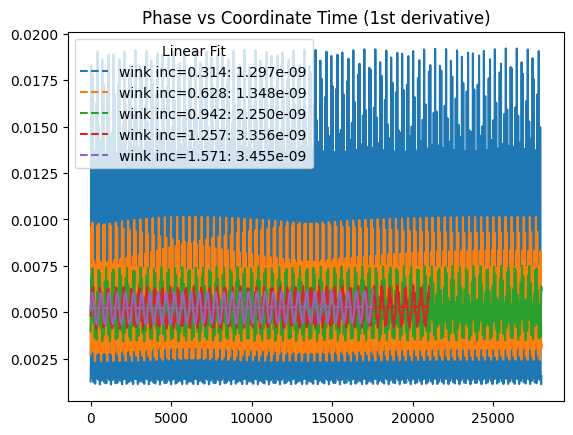

...

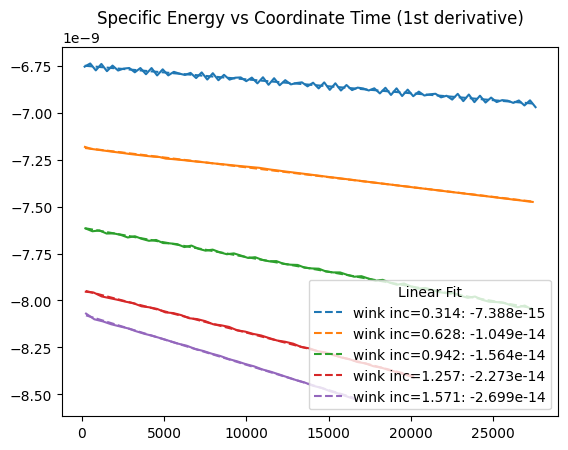

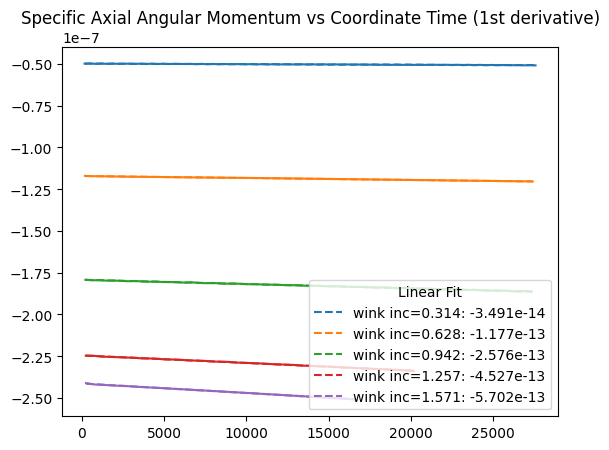

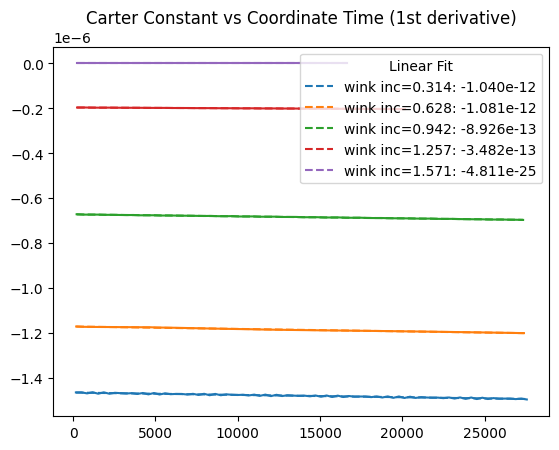

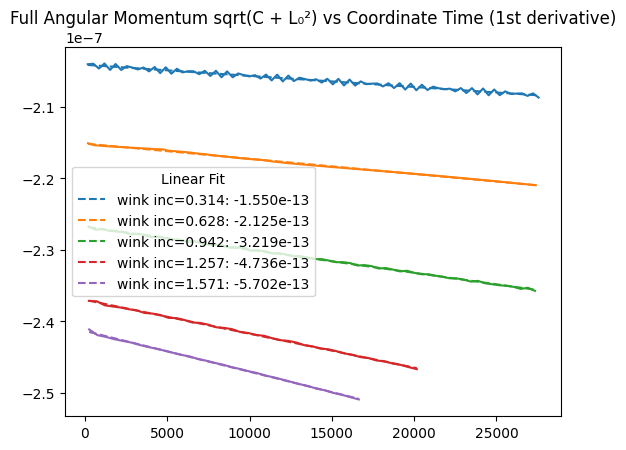

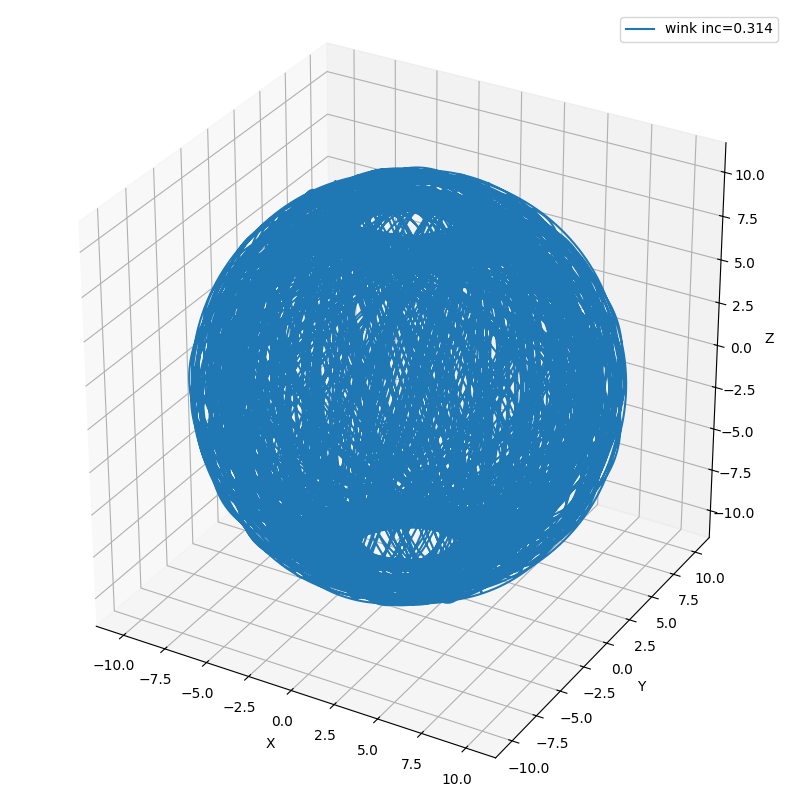

NameError: name 'things4' is not defined

In [3]:
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt

#recalcstate9 (NOT 9a)
things3 = [ml.EMRIGenerator(-0.9, 1e-4, endflag="radius < 9.0", params=[10/(1 - 0.1**2), 0.1, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 3)), trigger=2, err_target=1e-14, conch=100) for inc in np.pi*(1 + np.arange(5))/10]
#things3.append(ml.EMRIGenerator(-0.9, 1e-5, endflag="rad_orbit > 100", params=[10/(1 - 0.1**2), 0.1, np.pi/64], bonk=3, label="wink inc=%s"%(np.round(np.pi/64, 3)), trigger=2, err_target=1e-14, conch=100))
#things3.append(ml.EMRIGenerator(-0.9, 1e-5, endflag="rad_orbit > 100", params=[10/(1 - 0.1**2), 0.1, np.pi/128], bonk=3, label="wink inc=%s"%(np.round(np.pi/128, 3)), trigger=2, err_target=1e-14, conch=100))
#things3.append(ml.EMRIGenerator(-0.9, 1e-5, endflag="rad_orbit > 100", params=[10/(1 - 0.1**2), 0.1, np.pi/256], bonk=3, label="wink inc=%s"%(np.round(np.pi/256, 3)), trigger=2, err_target=1e-14, conch=100))
#things3.append(ml.EMRIGenerator(-0.9, 1e-5, endflag="rad_orbit > 100", params=[10/(1 - 0.1**2), 0.1, np.pi/512], bonk=3, label="wink inc=%s"%(np.round(np.pi/512, 3)), trigger=2, err_target=1e-14, conch=100))
#things3.append(ml.EMRIGenerator(-0.9, 1e-4, endflag="rad_orbit > 100", params=[10/(1 - 0.1**2), 0.1, np.pi/511], bonk=3, label="wink inc=%s"%(np.round(np.pi/511, 3)), trigger=2, err_target=1e-14, conch=100))


op.plotvalue3(things3, "semi_lat", "ecc")
op.plotvalue3(things3, "time", "radius", end=28000)
op.plotvalue3(things3, "time", "theta", end=28000)
op.plotvalue3(things3, "time", "phase", end=28000)
op.plotvalue3(things3, "time", "phase", derv=1, end=28000)
op.plotvalue3(things3, "tracktime", "energy", end=28000)
op.plotvalue3(things3, "tracktime", "L_z", end=28000)
op.plotvalue3(things3, "tracktime", "carter", end=28000)
op.plotvalue3(things3, "tracktime", "approx_L", end=28000)
op.plotvalue3(things3, "tracktime", "energy", derv=1, end=28000)
op.plotvalue3(things3, "tracktime", "L_z", derv=1, end=28000)
op.plotvalue3(things3, "tracktime", "carter", derv=1, end=28000)
op.plotvalue3(things3, "tracktime", "approx_L", derv=1, end=28000)
op.orthoplots(things3[0])

#things4 = [ml.EMRIGenerator(0.0, 1e-5, endflag="rad_orbit > 100", params=[10/(1 - 0.1**2), 0.1, inc], bonk=3, label="wink inc=%s"%(np.round(inc, 3)), trigger=2, err_target=1e-14, conch=100) for inc in np.pi*np.arange(5)/8]

op.plotvalue3(things4, "semi_lat", "ecc")
op.plotvalue3(things4, "time", "radius")
op.plotvalue3(things4, "tracktime", "energy")
op.plotvalue3(things4, "tracktime", "L_z")
op.plotvalue3(things4, "tracktime", "carter")
op.plotvalue3(things4, "tracktime", "approx_L")
op.plotvalue3(things4, "tracktime", "energy", derv=1)
op.plotvalue3(things4, "tracktime", "L_z", derv=1)
op.plotvalue3(things4, "tracktime", "carter", derv=1)
op.plotvalue3(things4, "tracktime", "approx_L", derv=1)

[0.32754517 0.32754822 0.32755127 0.32755432 0.32755737 0.32756042]
8.717352279606489
AAAAAAA
[np.float64(0.9624761184662202), np.float64(0.9644653982570582), np.float64(0.9662673941601808), np.float64(0.9679047146684719), np.float64(0.9693971932303451), np.float64(0.9707620420004102), np.float64(0.9720141286997702), np.float64(0.9731662801280464), np.float64(0.9742295708161609), np.float64(0.9752135810631549), np.float64(0.9761266205042722), np.float64(0.9769759186145784), np.float64(0.9777677856133022), np.float64(0.9785077477926135), np.float64(0.9792006611675846), np.float64(0.979850806948305), np.float64(0.9804619718535467), np.float64(0.981037515817019), np.float64(0.9815804292136308), np.float64(0.9820933813672635), np.float64(0.9825787617943729), np.float64(0.983038715381573), np.float64(0.9834751724846856), np.float64(0.9838898747645818), np.float64(0.9842843974326503), np.float64(0.9846601684647686), np.float64(0.9850184852463838), np.float64(0.9853605290350913), np.float64(0

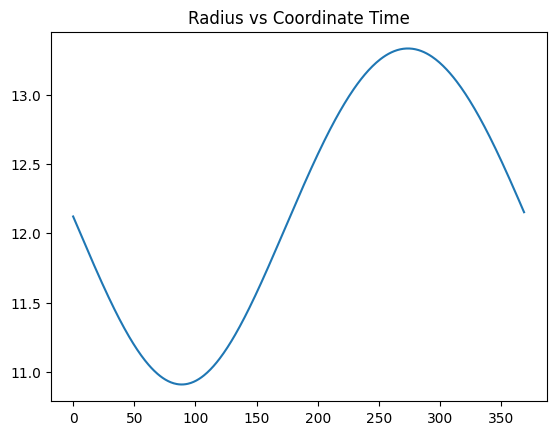

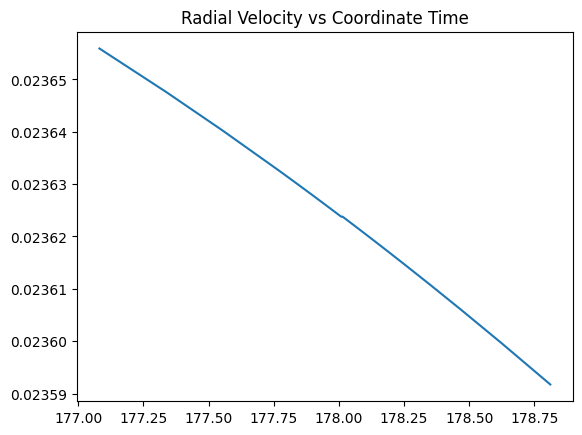

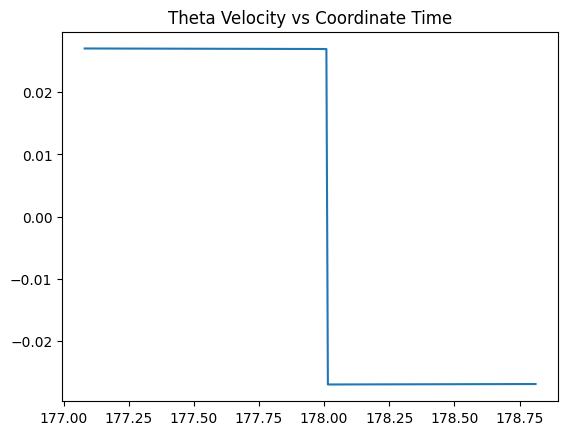

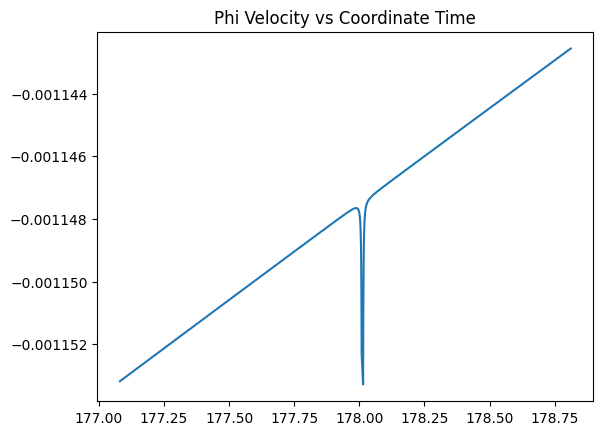

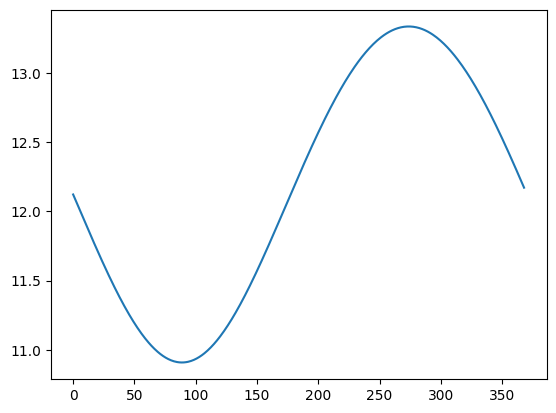

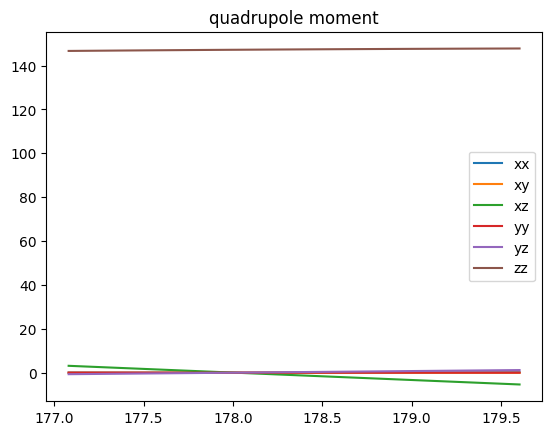

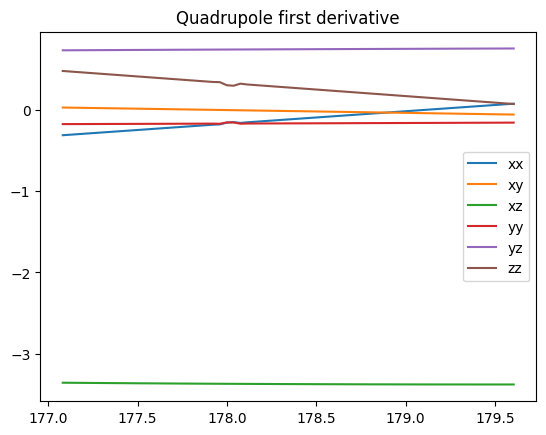

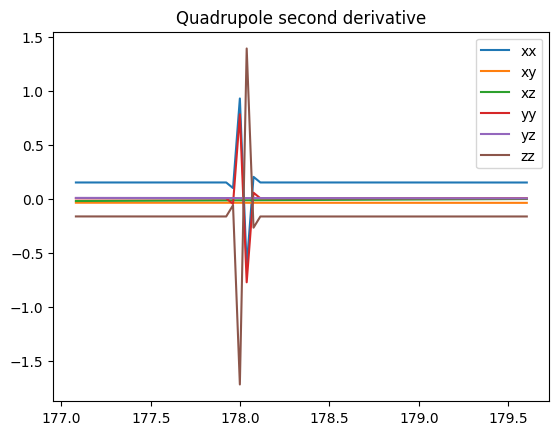

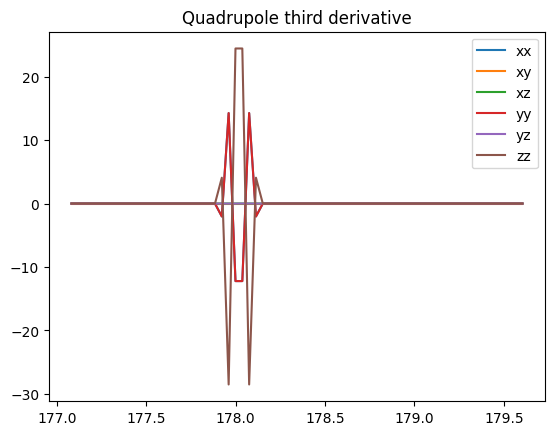

[-3.27417919e-02  1.23643134e-06  2.52318461e-06  1.33050460e-07]
yo


IndexError: index -2 is out of bounds for axis 0 with size 1

In [27]:
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt


pop = lambda a, b, f: a*(1 - f) + b*f
print(pop(335/1024, 21/64, pop(3/8, 7/16, np.array([0.5, 0.55, 0.6, 0.65, 0.7, 0.75]))))
#garp_holds = [ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[p/(1 - 0.1**2), 0.1, 0.0*np.pi], bonk=3, label="wink p=%s"%(np.round(p, 4)), trigger=2, err_target=1e-14, conch=100) for p in np.linspace(12, 50)]

#garps1 = [garp_1, garp_8, garp_3, garp_7, garp_6, garp_12, garp_13, garp_14, garp_9,  garp_10, garp_11, garp_4, garp_5, garp_2][7:-5]
garps1 = [*garp_holds]
#for val in ["energy", "phi_momentum", "carter"]:
 #   print([float(sim[val][-2]) for sim in garps1])

garp_1 = garp_holds[0].copy()

print(mm.find_rms(-0.9))
print("AAAAAAA")
print([sim["energy"][-1] for sim in garp_holds])
print([sim["phi_momentum"][-1] for sim in garp_holds])
print([sim["carter"][-1] for sim in garp_holds])
#print(garp_1["carter"][0])
#op.plotvalue3(garps1, "tracktime", "energy")
#op.plotvalue3(garps1, "tracktime", "energy", derv=1)
#op.plotvalue3(garps1, "tracktime", "energy", derv=2)
#op.plotvalue3(garps1, "tracktime", "L_z")
#op.plotvalue3(garps1, "tracktime", "L_z", derv=1)
#op.plotvalue3(garps1, "tracktime", "L_z", derv=2)
#op.plotvalue3(garps1, "tracktime", "carter")
#op.plotvalue3(garps1, "tracktime", "carter", derv=1)
#op.plotvalue3(garps1, "tracktime", "carter", derv=2)
#op.plotvalue3(garps1, "tracktime", "approx_L")
#op.plotvalue3(garps1, "tracktime", "approx_L", derv=1)
#op.plotvalue3(garps1, "tracktime", "approx_L", derv=2)
#op.plotvalue3(garps1, "tracktime", "inc")
#op.plotvalue3(garps1, "tracktime", "inc", derv=1)
#op.plotvalue3(garps1, "tracktime", "inc", derv=2)
#op.plotvalue3(garps1, "semi_lat", "ecc")
#op.plotvalue3(garps1, "periapse", "ecc")
#op.plotvalue3(garps1, "apoapse", "ecc")
#op.plotvalue3(garps1, "semi_lat", "r0")
#op.plotvalue3(garps1, "semi_lat", "pot_min")
#op.plotvalue3(garps1, "pot_min", "r0")
op.plotvalue3(garps1[0], "time", "radius", linefit=False)
op.plotvalue3(garps1[0], "time", "radial_v", linefit=False, start=177, end=179)
op.plotvalue3(garps1[0], "time", "theta_v", linefit=False, start=177, end=179)
op.plotvalue3(garps1[0], "time", "phi_v", linefit=False, start=177, end=179)
#op.orthoplots(garp_1)

def peters_integrate6_5_test(states, a, mu, ind1, ind2):
    '''
    Calculates change in characteristic orbital values from path of test particle through space 

    Parameters
    ----------
    states : N x 8 numpy array of floats
        list of state vectors - [4-position, 4-velocity] in geometric units
    a : int/float
        dimensionless spin constant of black hole, between 0 and 1 inclusive
    mu : float
        mass ratio of test particle to central body
    ind1 : int
        index value of the first entry in states relative to the master state list in clean_inspiral
    ind2 : int
        index value of the last entry in states relative to the master state list in clean_inspiral

    Returns
    -------
     4-element numpy array of floats
        change in orbital characteristics (energy, cartesian components of L) per unit mass 
    '''
    #dedt, dldt = 0, np.array([0.0, 0.0, 0.0])
    if (ind2 - ind1 - 10) > 2:
        states = np.array(states)
        sphere, time = states[5:-5, 1:4], states[5:-5, 0]
        int_sphere, int_time = mm.interpolate(sphere, time, False)
        div = np.mean(np.diff(int_time))
        quad = mm.trace_ortholize(sphere, a)
        delta = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
        coolquad = quad - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad), delta)
        dt2, dt3 = mm.matrix_derive3(coolquad, time, int_time)
        levciv = np.array([[[0, 0, 0],   #Levi-civita tensor
                            [0, 0, 1],
                            [0, -1, 0]],
                           [[0, 0, -1],
                            [0, 0, 0],
                            [1, 0, 0]],
                           [[0, 1, 0],
                            [-1, 0, 0],
                            [0, 0, 0]]])
        dedt = (-1/5)*(np.einsum('ijk,ijk ->i', dt3, dt3) - (1/3)*np.einsum('ijj,ikk ->i', dt3, dt3))
        dldt = (-2/5)*np.einsum("ijk, ljm, lkm -> li", levciv, dt2, dt3)
        dE = np.sum(dedt*div)*mu*(states[-1,0] - states[0,0])/(int_time[-1] - int_time[0])
        dLx, dLy, dLz = np.sum(dldt*div, axis=0)*mu*(states[-1,0] - states[0,0])/(int_time[-1] - int_time[0])
            #scale both changes to make up for the bits that got cut off
        #print([dE, dLx, dLy, dLz])
        #print(dE, np.sqrt(dLx**2 + dLy**2 + dLz**2))
        #print(len(time), time[-1]-time[0], dE, np.linalg.norm([dLx, dLy, dLz]))
        return np.array([dE, dLx, dLy, dLz])
    else:
        return np.array([0.0, 0.0, 0.0, 0.0])
    #return quad


def peters_integrate6_4_test(states, a, mu, ind1, ind2, yap = False):
    '''
    Calculates change in characteristic orbital values from path of test particle through space 

    Parameters
    ----------
    states : N x 8 numpy array of floats
        list of state vectors - [4-position, 4-velocity] in geometric units
    a : int/float
        dimensionless spin constant of black hole, between 0 and 1 inclusive
    mu : float
        mass ratio of test particle to central body
    ind1 : int
        index value of the first entry in states relative to the master state list in clean_inspiral
    ind2 : int
        index value of the last entry in states relative to the master state list in clean_inspiral

    Returns
    -------
     4-element numpy array of floats
        change in orbital characteristics (energy, cartesian components of L) per unit mass 
    '''
    #dedt, dldt = 0, np.array([0.0, 0.0, 0.0])
    if (ind2 - ind1) > 2  or (ind2 == -1 and len(states) > 1):
        states = np.array(states)
        sphere, time = states[5:, 1:4], states[5:, 0]
        #print(time[0], time[-1])
        int_sphere, int_time = mm.interpolate(sphere, time, False)
        div = np.mean(np.diff(int_time))
        quad = mm.trace_ortholize(sphere, a)
        delta = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
        coolquad = quad - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad), delta)
        dt2, dt3 = mm.matrix_derive3(coolquad, time, int_time)
        levciv = np.array([[[0, 0, 0],   #Levi-civita tensor
                            [0, 0, 1],
                            [0, -1, 0]],
                           [[0, 0, -1],
                            [0, 0, 0],
                            [1, 0, 0]],
                           [[0, 1, 0],
                            [-1, 0, 0],
                            [0, 0, 0]]])
        if yap == True:
            dims = ["x", "y", "z"]
            for i in range(9):
                if i%3 >= i//3:
                    plt.plot(time, quad[:, i//3, i%3], label = dims[i//3]+dims[i%3])
            plt.title("quadrupole moment")
            plt.legend()
            plt.show()
            polysd1 = [[0, 0, 0],
                       [0, 0, 0],
                       [0, 0, 0]]
            dt = np.mean(np.diff(time))
            import scipy.interpolate as spi
            for i in range(3):
                for j in range(3):
                    u = spi.CubicSpline(time, coolquad[:,i,j])
                    polysd1[i][j] = (-u(int_time + 2*dt) + 8*u(int_time + dt) - 8*u(int_time - dt) + u(int_time - 2*dt))/(12*dt)
            polysd1 = np.transpose(polysd1)
            for i in range(9):
                if i%3 >= i//3:
                    plt.plot(int_time, polysd1[:, i//3, i%3], label = dims[i//3]+dims[i%3])
            plt.title("Quadrupole first derivative")
            plt.legend()
            plt.show()
            for i in range(9):
                if i%3 >= i//3:
                    plt.plot(int_time, dt2[:, i//3, i%3], label = dims[i//3]+dims[i%3])
            plt.title("Quadrupole second derivative")
            plt.legend()
            plt.show()
            for i in range(9):
                if i%3 >= i//3:
                    plt.plot(int_time, dt3[:, i//3, i%3], label = dims[i//3]+dims[i%3])
            plt.title("Quadrupole third derivative")
            plt.legend()
            plt.show()
        dedt = (-1/5)*(np.einsum('ijk,ijk ->i', dt3, dt3) - (1/3)*np.einsum('ijj,ikk ->i', dt3, dt3))
        dldt = (-2/5)*np.einsum("ijk, ljm, lkm -> li", levciv, dt2, dt3)
        dE = np.sum(dedt*div)*mu
        dLx, dLy, dLz = np.sum(dldt*div, axis=0)*mu
        #print(np.array([dE, dLx, dLy, dLz])/(time[-1] - time[0]))
        return np.array([dE, dLx, dLy, dLz])
    else:
        return False
    #return quad

plt.show()
#print(garp_1["energy"][-5:])
for ix in garp_1["trackix"]:
    if ix == garp_1["trackix"][-1]:
        ix_end = -1
    else:
        ix_end = garp_1["trackix"][np.where(garp_1["trackix"] == ix)[0][0] + 1]
    
    #print(peters_integrate6_4_test(garp_1["raw"][ix:ix_end], -0.9, 1e-5, ix, ix_end))
    #print("---")
    plt.plot(garp_1["time"][ix:ix_end] - garp_1["time"][ix], garp_1["raw"][ix:ix_end, 1])

plt.show()
'''
combine = np.sort(np.concatenate((garp_1["trackix"], (garp_1["trackix"][1:] + garp_1["trackix"][:-1])//2, [(garp_1["trackix"][-1] + len(garp_1["time"]) -1)//2])))
for ix in combine[-10:]:
    if ix == combine[-1]:
        ix_end = -1
    else:
        ix_end = combine[np.where(combine == ix)[0][0] + 1]
    
    #print(peters_integrate6_4_test(garp_1["raw"][ix:ix_end], -0.9, 1e-5, ix, ix_end))
    plt.plot(garp_1["time"][ix:ix_end] - garp_1["time"][ix], garp_1["raw"][ix:ix_end, 1])

plt.show()
combine2 = np.sort(np.concatenate((combine, (combine[1:] + combine[:-1])//2, [(combine[-1] + len(garp_1["time"]) -1)//2])))
for ix in combine2[-5:]:
    if ix == combine2[-1]:
        ix_end = -1
    else:
        ix_end = combine2[np.where(combine2 == ix)[0][0] + 1]
    
    #print(peters_integrate6_4_test(garp_1["raw"][ix:ix_end], -0.9, 1e-5, ix, ix_end))
    plt.plot(garp_1["time"][ix:ix_end] - garp_1["time"][ix], garp_1["raw"][ix:ix_end, 1])
plt.show()
'''
#print(peters_integrate6_4_test(garp_1["raw"][combine2[-4]:combine2[-3]], -0.9, 1e-5, combine2[-4], combine2[-3], yap=True))
#print(peters_integrate6_4_test(garp_1["raw"][combine2[-2]:combine2[-1]], -0.9, 1e-5, combine2[-2], combine2[-1], yap=True))

print(peters_integrate6_4_test(garp_1["raw"][op.get_index(garp_1["time"], 175):op.get_index(garp_1["time"], 180)], -0.9, 1e-3, garp_1["trackix"][-1], -1, yap=True))
print("yo")
print(peters_integrate6_4_test(garp_1["raw"][garp_1["trackix"][-2]:garp_1["trackix"][-1]], -0.9, 1e-5, garp_1["trackix"][-2], garp_1["trackix"][-1], yap=True))
print(peters_integrate6_4_test(garp_1["raw"][garp_1["trackix"][-3]:garp_1["trackix"][-2]], -0.9, 1e-5, garp_1["trackix"][-3], garp_1["trackix"][-2], yap=True))
print(peters_integrate6_4_test(garp_1["raw"][garp_1["trackix"][-3]:garp_1["trackix"][-3]+10], -0.9, 1e-5, garp_1["trackix"][-3], garp_1["trackix"][-3]+10, yap=True))
print(peters_integrate6_4_test(garp_1["raw"][garp_1["trackix"][-4]:garp_1["trackix"][-3]], -0.9, 1e-5, garp_1["trackix"][-4], garp_1["trackix"][-3], yap=True))
print(peters_integrate6_4_test(garp_1["raw"][garp_1["trackix"][-4]:garp_1["trackix"][-4]+10], -0.9, 1e-5, garp_1["trackix"][-4], garp_1["trackix"][-4]+10, yap=True))


[0.32754517 0.32754822 0.32755127 0.32755432 0.32755737 0.32756042]
8.717352279606489
AAAAAAA
[np.float64(0.9496494945684011), np.float64(0.953271957203208), np.float64(0.9562502668965203), np.float64(0.9584931620502464), np.float64(0.9605474296456746), np.float64(0.9612922241364125)]
[np.float64(0.140387777325847), np.float64(1.1813564648874026), np.float64(2.311836069053114), np.float64(3.2730168762894998), np.float64(3.9373375185895294), np.float64(4.174613087138475)]
[np.float64(12.94341231821318), np.float64(12.77911190770558), np.float64(10.017695108770681), np.float64(5.63558273803719), np.float64(1.6358967059358576), np.float64(0.0)]


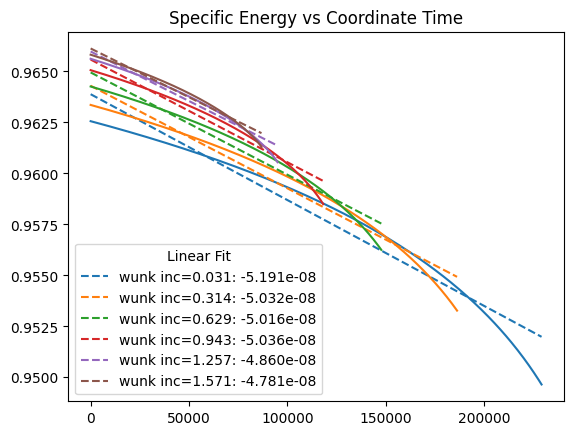

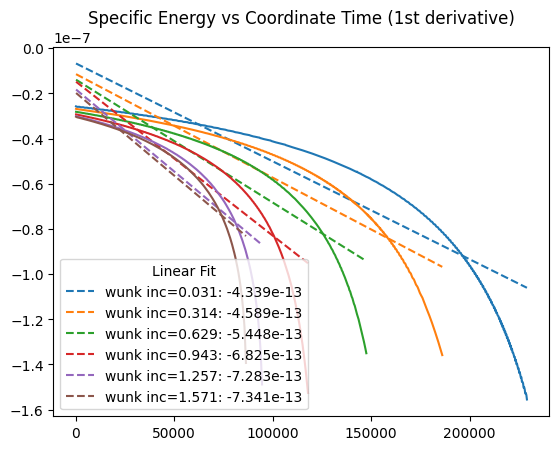

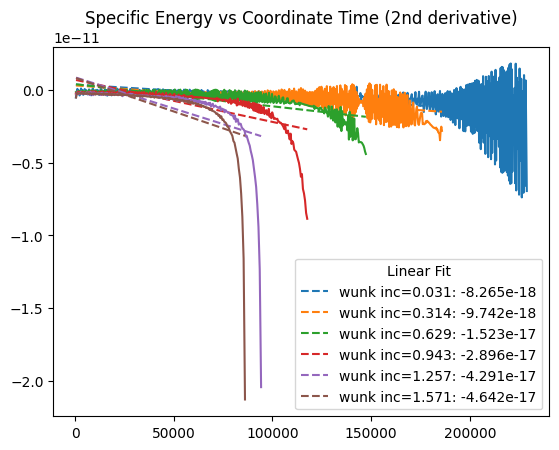

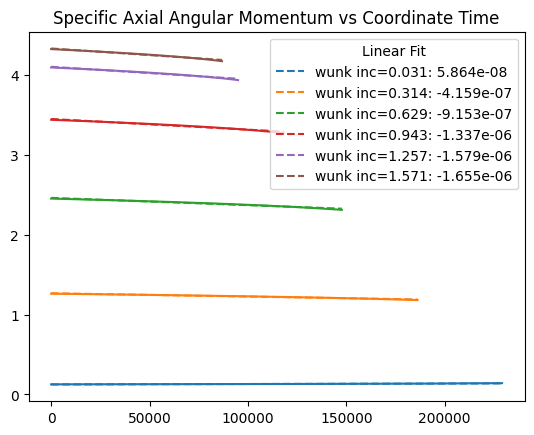

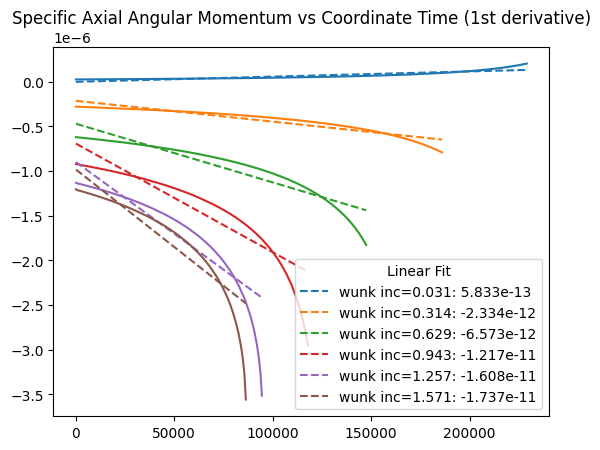

...

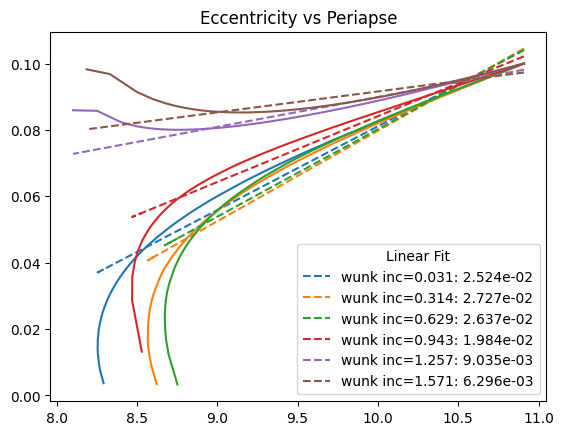

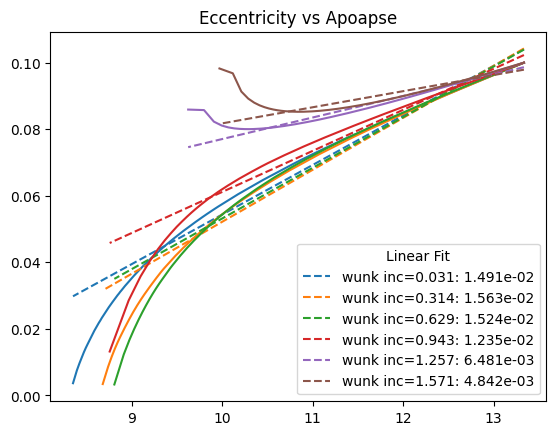

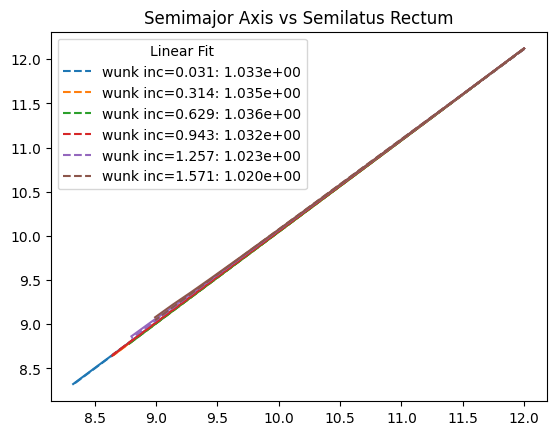

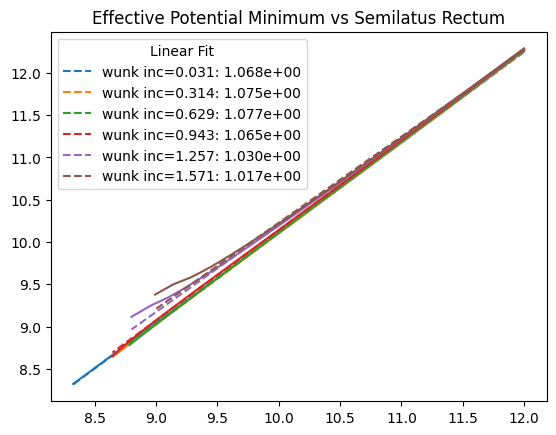

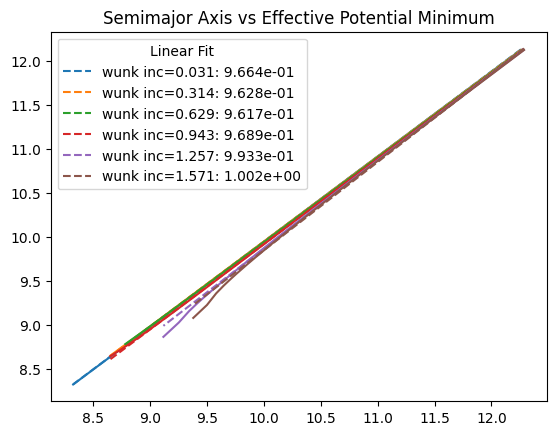

C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


In [ ]:
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt


pop = lambda a, b, f: a*(1 - f) + b*f
print(pop(335/1024, 21/64, pop(3/8, 7/16, np.array([0.5, 0.55, 0.6, 0.65, 0.7, 0.75]))))
#garp_holds = [ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[12/(1 - 0.1**2), 0.1, inc*np.pi], bonk=3, label="wunk inc=%s"%(np.round(np.pi*inc, 3)), trigger=2, err_target=1e-14, conch=100) for inc in pop(0.0001, 1/2, np.arange(6)/5)]
#garp_holds[0] = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[12/(1 - 0.1**2), 0.1, 0.01*np.pi], bonk=3, label="wunk inc=%s"%(np.round(np.pi*0.01, 3)), trigger=2, err_target=1e-14, conch=100)
#garps = [garp_1, garp_8, garp_3, garp_7, garp_6, garp_12, garp_13, garp_14, garp_9,  garp_10, garp_11, garp_4, garp_5, garp_2][7:-5]
garps = [*garp_holds]
#for val in ["energy", "phi_momentum", "carter"]:
 #   print([float(sim[val][-2]) for sim in garps])

garp_1 = garp_holds[0].copy()

print(mm.find_rms(-0.9))
print("AAAAAAA")
print([sim["energy"][-1] for sim in garp_holds])
print([sim["phi_momentum"][-1] for sim in garp_holds])
print([sim["carter"][-1] for sim in garp_holds])
#print(garp_1["carter"][0])
op.plotvalue3(garps, "tracktime", "energy")
op.plotvalue3(garps, "tracktime", "energy", derv=1)
op.plotvalue3(garps, "tracktime", "energy", derv=2)
op.plotvalue3(garps, "tracktime", "L_z")
op.plotvalue3(garps, "tracktime", "L_z", derv=1)
op.plotvalue3(garps, "tracktime", "L_z", derv=2)
op.plotvalue3(garps, "tracktime", "carter")
op.plotvalue3(garps, "tracktime", "carter", derv=1)
op.plotvalue3(garps, "tracktime", "carter", derv=2)
op.plotvalue3(garps, "tracktime", "approx_L")
op.plotvalue3(garps, "tracktime", "approx_L", derv=1)
op.plotvalue3(garps, "tracktime", "approx_L", derv=2)
op.plotvalue3(garps, "tracktime", "inc")
op.plotvalue3(garps, "tracktime", "inc", derv=1)
op.plotvalue3(garps, "tracktime", "inc", derv=2)
op.plotvalue3(garps, "semi_lat", "ecc")
op.plotvalue3(garps, "periapse", "ecc")
op.plotvalue3(garps, "apoapse", "ecc")
op.plotvalue3(garps, "semi_lat", "r0")
op.plotvalue3(garps, "semi_lat", "pot_min")
op.plotvalue3(garps, "pot_min", "r0")
op.plotvalue3(garps, "time", "radius")
#op.orthoplots(garp_1)


def peters_integrate6_4_test(states, a, mu, ind1, ind2, yap = False):
    '''
    Calculates change in characteristic orbital values from path of test particle through space 

    Parameters
    ----------
    states : N x 8 numpy array of floats
        list of state vectors - [4-position, 4-velocity] in geometric units
    a : int/float
        dimensionless spin constant of black hole, between 0 and 1 inclusive
    mu : float
        mass ratio of test particle to central body
    ind1 : int
        index value of the first entry in states relative to the master state list in clean_inspiral
    ind2 : int
        index value of the last entry in states relative to the master state list in clean_inspiral

    Returns
    -------
     4-element numpy array of floats
        change in orbital characteristics (energy, cartesian components of L) per unit mass 
    '''
    #dedt, dldt = 0, np.array([0.0, 0.0, 0.0])
    if (ind2 - ind1) > 2  or (ind2 == -1 and len(states) > 1):
        states = np.array(states)
        sphere, time = states[5:, 1:4], states[5:, 0]
        #print(time[0], time[-1])
        int_sphere, int_time = mm.interpolate(sphere, time, False)
        div = np.mean(np.diff(int_time))
        quad = mm.trace_ortholize(sphere, a)
        delta = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
        coolquad = quad - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad), delta)
        dt2, dt3 = mm.matrix_derive3(coolquad, time, int_time)
        levciv = np.array([[[0, 0, 0],   #Levi-civita tensor
                            [0, 0, 1],
                            [0, -1, 0]],
                           [[0, 0, -1],
                            [0, 0, 0],
                            [1, 0, 0]],
                           [[0, 1, 0],
                            [-1, 0, 0],
                            [0, 0, 0]]])
        if yap == True:
            dims = ["x", "y", "z"]
            for i in range(9):
                if i%3 >= i//3:
                    plt.plot(time, quad[:, i//3, i%3], label = dims[i//3]+dims[i%3])
            plt.title("quadrupole moment")
            plt.legend()
            plt.show()
            for i in range(9):
                if i%3 >= i//3:
                    plt.plot(int_time, dt2[:, i//3, i%3], label = dims[i//3]+dims[i%3])
            plt.title("Quadrupole second derivative")
            plt.legend()
            plt.show()
            for i in range(9):
                if i%3 >= i//3:
                    plt.plot(int_time, dt3[:, i//3, i%3], label = dims[i//3]+dims[i%3])
            plt.title("Quadrupole third derivative")
            plt.legend()
            plt.show()
        dedt = (-1/5)*(np.einsum('ijk,ijk ->i', dt3, dt3) - (1/3)*np.einsum('ijj,ikk ->i', dt3, dt3))
        dldt = (-2/5)*np.einsum("ijk, ljm, lkm -> li", levciv, dt2, dt3)
        dE = np.sum(dedt*div)*mu
        dLx, dLy, dLz = np.sum(dldt*div, axis=0)*mu
        #print(np.array([dE, dLx, dLy, dLz])/(time[-1] - time[0]))
        return np.array([dE, dLx, dLy, dLz])
    else:
        return False
    #return quad

plt.show()
#print(garp_1["energy"][-5:])
for ix in garp_1["trackix"]:
    if ix == garp_1["trackix"][-1]:
        ix_end = -1
    else:
        ix_end = garp_1["trackix"][np.where(garp_1["trackix"] == ix)[0][0] + 1]
    
    #print(peters_integrate6_4_test(garp_1["raw"][ix:ix_end], -0.9, 1e-5, ix, ix_end))
    #print("---")
    plt.plot(garp_1["time"][ix:ix_end] - garp_1["time"][ix], garp_1["raw"][ix:ix_end, 1])

plt.show()
'''
combine = np.sort(np.concatenate((garp_1["trackix"], (garp_1["trackix"][1:] + garp_1["trackix"][:-1])//2, [(garp_1["trackix"][-1] + len(garp_1["time"]) -1)//2])))
for ix in combine[-10:]:
    if ix == combine[-1]:
        ix_end = -1
    else:
        ix_end = combine[np.where(combine == ix)[0][0] + 1]
    
    #print(peters_integrate6_4_test(garp_1["raw"][ix:ix_end], -0.9, 1e-5, ix, ix_end))
    plt.plot(garp_1["time"][ix:ix_end] - garp_1["time"][ix], garp_1["raw"][ix:ix_end, 1])

plt.show()
combine2 = np.sort(np.concatenate((combine, (combine[1:] + combine[:-1])//2, [(combine[-1] + len(garp_1["time"]) -1)//2])))
for ix in combine2[-5:]:
    if ix == combine2[-1]:
        ix_end = -1
    else:
        ix_end = combine2[np.where(combine2 == ix)[0][0] + 1]
    
    #print(peters_integrate6_4_test(garp_1["raw"][ix:ix_end], -0.9, 1e-5, ix, ix_end))
    plt.plot(garp_1["time"][ix:ix_end] - garp_1["time"][ix], garp_1["raw"][ix:ix_end, 1])
plt.show()
'''
#print(peters_integrate6_4_test(garp_1["raw"][combine2[-4]:combine2[-3]], -0.9, 1e-5, combine2[-4], combine2[-3], yap=True))
#print(peters_integrate6_4_test(garp_1["raw"][combine2[-2]:combine2[-1]], -0.9, 1e-5, combine2[-2], combine2[-1], yap=True))
try:
    print(peters_integrate6_4_test(garp_1["raw"][garp_1["trackix"][-1]:], -0.9, 1e-5, garp_1["trackix"][-1], -1, yap=True))
except:
    pass
print(peters_integrate6_4_test(garp_1["raw"][garp_1["trackix"][-2]:garp_1["trackix"][-1]], -0.9, 1e-5, garp_1["trackix"][-2], garp_1["trackix"][-1], yap=True))
print(peters_integrate6_4_test(garp_1["raw"][garp_1["trackix"][-3]:garp_1["trackix"][-2]], -0.9, 1e-5, garp_1["trackix"][-3], garp_1["trackix"][-2], yap=True))
print(peters_integrate6_4_test(garp_1["raw"][garp_1["trackix"][-3]:garp_1["trackix"][-3]+10], -0.9, 1e-5, garp_1["trackix"][-3], garp_1["trackix"][-3]+10, yap=True))
print(peters_integrate6_4_test(garp_1["raw"][garp_1["trackix"][-4]:garp_1["trackix"][-3]], -0.9, 1e-5, garp_1["trackix"][-4], garp_1["trackix"][-3], yap=True))
print(peters_integrate6_4_test(garp_1["raw"][garp_1["trackix"][-4]:garp_1["trackix"][-4]+10], -0.9, 1e-5, garp_1["trackix"][-4], garp_1["trackix"][-4]+10, yap=True))


In [ ]:
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt

#garp_1 = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, np.pi/512], bonk=3, label="wunk inc=%s"%(np.round(np.pi/512, 3)), trigger=0, err_target=1e-14, conch=100)
#garp_2 = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, np.pi/2], bonk=3, label="wunk inc=%s"%(np.round(np.pi/2, 3)), trigger=0, err_target=1e-14, conch=100)
#garp_3 = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, np.pi/4], bonk=3, label="wunk inc=%s"%(np.round(np.pi/4, 3)), trigger=0, err_target=1e-14, conch=100)
#garp_4 = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, 3*np.pi/8], bonk=3, label="wunk inc=%s"%(np.round(np.pi*3/8, 3)), trigger=0, err_target=1e-14, conch=100)
#garp_5 = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, 7*np.pi/16], bonk=3, label="wunk inc=%s"%(np.round(np.pi*7/16, 3)), trigger=0, err_target=1e-14, conch=100)
#garp_6 = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, 5*np.pi/16], bonk=3, label="wunk inc=%s"%(np.round(np.pi*5/16, 3)), trigger=0, err_target=1e-14, conch=100)
#garp_7 = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, 9*np.pi/32], bonk=3, label="wunk inc=%s"%(np.round(np.pi*9/32, 3)), trigger=0, err_target=1e-14, conch=100)
#garp_8 = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, 7*np.pi/32], bonk=3, label="wunk inc=%s"%(np.round(np.pi*7/32, 3)), trigger=0, err_target=1e-14, conch=100)
#garp_9 = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, 21*np.pi/64], bonk=3, label="wunk inc=%s"%(np.round(np.pi*21/64, 3)), trigger=0, err_target=1e-14, conch=100)
#garp_10 = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, 11*np.pi/32], bonk=3, label="wunk inc=%s"%(np.round(np.pi*11/32, 3)), trigger=0, err_target=1e-14, conch=100)
#garp_11 = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, 23*np.pi/64], bonk=3, label="wunk inc=%s"%(np.round(np.pi*23/64, 3)), trigger=0, err_target=1e-14, conch=100)
#garp_12 = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, 81*np.pi/256], bonk=3, label="wunk inc=%s"%(np.round(np.pi*81/256, 3)), trigger=0, err_target=1e-14, conch=100)
#garp_13 = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, 41*np.pi/128], bonk=3, label="wunk inc=%s"%(np.round(np.pi*41/128, 3)), trigger=0, err_target=1e-14, conch=100)
#garp_14 = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, 83*np.pi/256], bonk=3, label="wunk inc=%s"%(np.round(np.pi*83/256, 3)), trigger=0, err_target=1e-14, conch=100)
#garp_15 = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, 333*np.pi/1024], bonk=3, label="wunk inc=%s"%(np.round(np.pi*333/1024, 3)), trigger=0, err_target=1e-14, conch=100)
#garp_16 = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, 167*np.pi/512], bonk=3, label="wunk inc=%s"%(np.round(np.pi*167/512, 3)), trigger=0, err_target=1e-14, conch=100)
#garp_17 = ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, 335*np.pi/1024], bonk=3, label="wunk inc=%s"%(np.round(np.pi*335/1024, 3)), trigger=0, err_target=1e-14, conch=100)
pop = lambda a, b, f: a*(1 - f) + b*f
print(pop(335/1024, 21/64, pop(3/8, 7/16, np.array([0.5, 0.55, 0.6, 0.65, 0.7, 0.75]))))
garp_holds = [ml.EMRIGenerator(-0.9, 1e-3, endflag="radius < 2", params=[10/(1 - 0.1**2), 0.1, inc*np.pi], bonk=3, label="wunk inc=%s"%(np.round(np.pi*inc, 3)), trigger=0, err_target=1e-14, conch=100) for inc in pop(335/1024, 21/64, pop(3/8, 7/16, np.array([0.5, 0.55, 0.6, 0.65, 0.7, 0.75])))]

garps = [garp_1, garp_8, garp_3, garp_7, garp_6, garp_12, garp_13, garp_14, garp_9,  garp_10, garp_11, garp_4, garp_5, garp_2][7:-5]
garps = [*garp_holds]
for val in ["energy", "phi_momentum", "carter"]:
    print([float(sim[val][-2]) for sim in garps])

print(mm.find_rms(-0.9))
print(garp_1["carter"][0])
op.plotvalue3(garps, "tracktime", "energy", start=1000)
op.plotvalue3(garps, "tracktime", "energy", derv=1, start=1000)
op.plotvalue3(garps, "tracktime", "energy", derv=2, start=1000)
op.plotvalue3(garps, "tracktime", "L_z", start=1000)
op.plotvalue3(garps, "tracktime", "L_z", derv=1, start=1000)
op.plotvalue3(garps, "tracktime", "L_z", derv=2, start=1000)
op.plotvalue3(garps, "tracktime", "carter", start=1000)
op.plotvalue3(garps, "tracktime", "carter", derv=1, start=1000)
op.plotvalue3(garps, "tracktime", "carter", derv=2, start=1000)
op.plotvalue3(garps, "tracktime", "approx_L", start=1000)
op.plotvalue3(garps, "tracktime", "approx_L", derv=1, start=1000)
op.plotvalue3(garps, "tracktime", "approx_L", derv=2, start=1000)
op.plotvalue3(garps, "tracktime", "inc", start=1000)
op.plotvalue3(garps, "tracktime", "inc", derv=1, start=1000)
op.plotvalue3(garps, "tracktime", "inc", derv=2, start=1000)
op.plotvalue3(garps, "semi_lat", "ecc")
op.plotvalue3(garps, "time", "radius", start=20000)
#op.orthoplots(garp_1)




def peters_integrate6_4_test(states, a, mu, ind1, ind2, yap = False):
    '''
    Calculates change in characteristic orbital values from path of test particle through space 

    Parameters
    ----------
    states : N x 8 numpy array of floats
        list of state vectors - [4-position, 4-velocity] in geometric units
    a : int/float
        dimensionless spin constant of black hole, between 0 and 1 inclusive
    mu : float
        mass ratio of test particle to central body
    ind1 : int
        index value of the first entry in states relative to the master state list in clean_inspiral
    ind2 : int
        index value of the last entry in states relative to the master state list in clean_inspiral

    Returns
    -------
     4-element numpy array of floats
        change in orbital characteristics (energy, cartesian components of L) per unit mass 
    '''
    #dedt, dldt = 0, np.array([0.0, 0.0, 0.0])
    if (ind2 - ind1) > 2  or (ind2 == -1 and len(states) > 1):
        states = np.array(states)
        sphere, time = states[5:, 1:4], states[5:, 0]
        #print(time[0], time[-1])
        int_sphere, int_time = mm.interpolate(sphere, time, False)
        div = np.mean(np.diff(int_time))
        quad = mm.trace_ortholize(sphere, a)
        delta = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
        coolquad = quad - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad), delta)
        dt2, dt3 = mm.matrix_derive3(coolquad, time, int_time)
        levciv = np.array([[[0, 0, 0],   #Levi-civita tensor
                            [0, 0, 1],
                            [0, -1, 0]],
                           [[0, 0, -1],
                            [0, 0, 0],
                            [1, 0, 0]],
                           [[0, 1, 0],
                            [-1, 0, 0],
                            [0, 0, 0]]])
        if yap == True:
            dims = ["x", "y", "z"]
            for i in range(9):
                if i%3 >= i//3:
                    plt.plot(time, quad[:, i//3, i%3], label = dims[i//3]+dims[i%3])
            plt.title("quadrupole moment")
            plt.legend()
            plt.show()
            for i in range(9):
                if i%3 >= i//3:
                    plt.plot(int_time, dt2[:, i//3, i%3], label = dims[i//3]+dims[i%3])
            plt.title("Quadrupole second derivative")
            plt.legend()
            plt.show()
            for i in range(9):
                if i%3 >= i//3:
                    plt.plot(int_time, dt3[:, i//3, i%3], label = dims[i//3]+dims[i%3])
            plt.title("Quadrupole third derivative")
            plt.legend()
            plt.show()
        dedt = (-1/5)*(np.einsum('ijk,ijk ->i', dt3, dt3) - (1/3)*np.einsum('ijj,ikk ->i', dt3, dt3))
        dldt = (-2/5)*np.einsum("ijk, ljm, lkm -> li", levciv, dt2, dt3)
        dE = np.sum(dedt*div)*mu
        dLx, dLy, dLz = np.sum(dldt*div, axis=0)*mu
        #print(np.array([dE, dLx, dLy, dLz])/(time[-1] - time[0]))
        return np.array([dE, dLx, dLy, dLz])
    else:
        return False
    #return quad

plt.show()
#print(garp_1["energy"][-5:])
for ix in garp_1["trackix"]:
    if ix == garp_1["trackix"][-1]:
        ix_end = -1
    else:
        ix_end = garp_1["trackix"][np.where(garp_1["trackix"] == ix)[0][0] + 1]
    
    #print(peters_integrate6_4_test(garp_1["raw"][ix:ix_end], -0.9, 1e-5, ix, ix_end))
    #print("---")
    plt.plot(garp_1["time"][ix:ix_end] - garp_1["time"][ix], garp_1["raw"][ix:ix_end, 1])

plt.show()
'''
combine = np.sort(np.concatenate((garp_1["trackix"], (garp_1["trackix"][1:] + garp_1["trackix"][:-1])//2, [(garp_1["trackix"][-1] + len(garp_1["time"]) -1)//2])))
for ix in combine[-10:]:
    if ix == combine[-1]:
        ix_end = -1
    else:
        ix_end = combine[np.where(combine == ix)[0][0] + 1]
    
    #print(peters_integrate6_4_test(garp_1["raw"][ix:ix_end], -0.9, 1e-5, ix, ix_end))
    plt.plot(garp_1["time"][ix:ix_end] - garp_1["time"][ix], garp_1["raw"][ix:ix_end, 1])

plt.show()
combine2 = np.sort(np.concatenate((combine, (combine[1:] + combine[:-1])//2, [(combine[-1] + len(garp_1["time"]) -1)//2])))
for ix in combine2[-5:]:
    if ix == combine2[-1]:
        ix_end = -1
    else:
        ix_end = combine2[np.where(combine2 == ix)[0][0] + 1]
    
    #print(peters_integrate6_4_test(garp_1["raw"][ix:ix_end], -0.9, 1e-5, ix, ix_end))
    plt.plot(garp_1["time"][ix:ix_end] - garp_1["time"][ix], garp_1["raw"][ix:ix_end, 1])
plt.show()
'''
#print(peters_integrate6_4_test(garp_1["raw"][combine2[-4]:combine2[-3]], -0.9, 1e-5, combine2[-4], combine2[-3], yap=True))
#print(peters_integrate6_4_test(garp_1["raw"][combine2[-2]:combine2[-1]], -0.9, 1e-5, combine2[-2], combine2[-1], yap=True))
try:
    print(peters_integrate6_4_test(garp_1["raw"][garp_1["trackix"][-1]:], -0.9, 1e-5, garp_1["trackix"][-1], -1, yap=True))
except:
    pass
print(peters_integrate6_4_test(garp_1["raw"][garp_1["trackix"][-2]:garp_1["trackix"][-1]], -0.9, 1e-5, garp_1["trackix"][-2], garp_1["trackix"][-1], yap=True))
print(peters_integrate6_4_test(garp_1["raw"][garp_1["trackix"][-3]:garp_1["trackix"][-2]], -0.9, 1e-5, garp_1["trackix"][-3], garp_1["trackix"][-2], yap=True))
print(peters_integrate6_4_test(garp_1["raw"][garp_1["trackix"][-3]:garp_1["trackix"][-3]+10], -0.9, 1e-5, garp_1["trackix"][-3], garp_1["trackix"][-3]+10, yap=True))
print(peters_integrate6_4_test(garp_1["raw"][garp_1["trackix"][-4]:garp_1["trackix"][-3]], -0.9, 1e-5, garp_1["trackix"][-4], garp_1["trackix"][-3], yap=True))
print(peters_integrate6_4_test(garp_1["raw"][garp_1["trackix"][-4]:garp_1["trackix"][-4]+10], -0.9, 1e-5, garp_1["trackix"][-4], garp_1["trackix"][-4]+10, yap=True))


[0.32754517 0.32754822 0.32755127 0.32755432 0.32755737 0.32756042]


 28%|██▊       | 2769191.9331273423/10000000 [02:26<07:55, 15192.30it/s, Semilat: 8.48, Ecc 0.079]   C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\matplotlib\cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\matplotlib\cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)
C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\numpy\ma\core.py:3413: ComplexWarning: Casting complex values to real discards the imaginary part
  _data[indx] = dval
C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\Lo

[8.24392043+0.35295358j 8.24392043-0.35295358j 2.12421811+0.j        ]
[8.24392043 8.24392043 2.12421811]
[ -0.32237164   6.         -33.23992381  46.62500183]
[2.12421811 2.12421811 2.12421811]
sta
2.124218106066045 [2.12421811]
ROOTER
(array([0.07893078+0.j        , 7.48827956+0.j        ,
       8.62443413-0.85053296j, 8.62443413+0.85053296j]), array([2.12421811+0.j        , 8.24392043+0.35295358j,
       8.24392043-0.35295358j]), array([-177.83620909+0.j,   -0.51651984+0.j,    0.51651984+0.j,
        177.83620909+0.j]))
(-0.4304533786726301+0.05782939598309958j) -1e-14 whoops

Ending program



10002728.662421845it [02:37, 63408.41it/s, Semilat: 8.477, Ecc 0.08]                                 
10002518.311397048it [02:52, 57861.87it/s, Semilat: 8.477, Ecc 0.08]                                 
10002872.391529895it [02:52, 57965.15it/s, Semilat: 8.477, Ecc 0.08]                                 
10002472.894041447it [02:37, 63651.32it/s, Semilat: 8.477, Ecc 0.08]                                 
 26%|██▌       | 2571876.100435382/10000000 [02:22<03:12, 38684.31it/s, Semilat: 8.477, Ecc 0.08]    

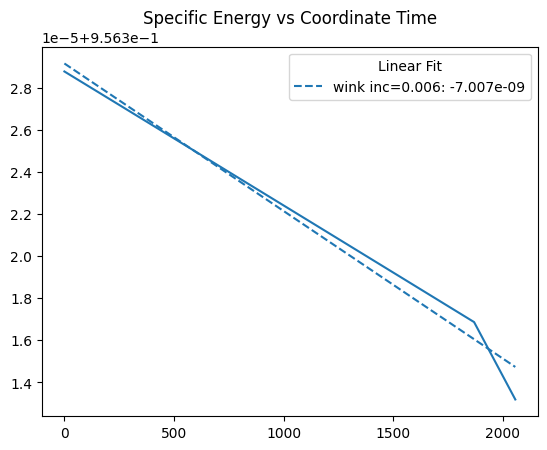

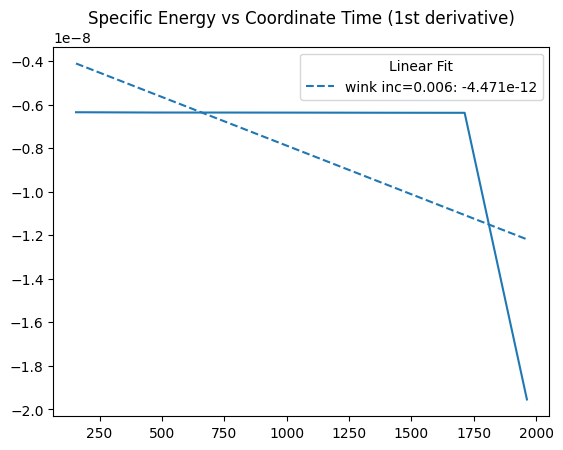

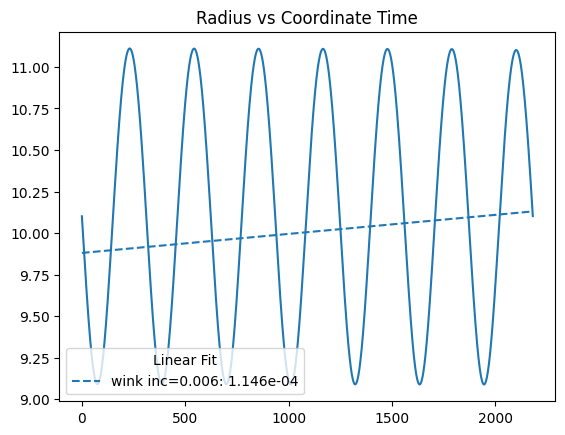

22382 22381 8


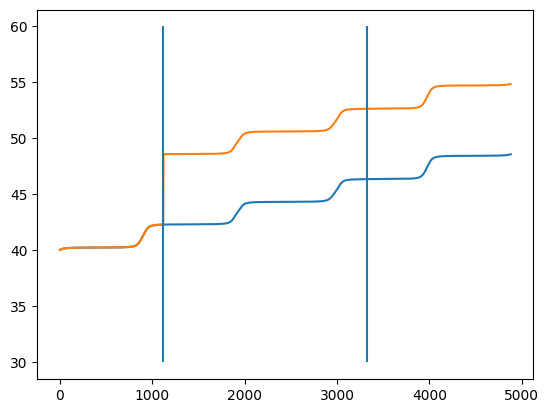

0.0 310.3396444415442
[-6.37965708e-10  5.10244297e-09  1.88454321e-08  1.31197397e-09]
[-1.97986051e-07  1.58349034e-06  5.84848470e-06  4.07157535e-07]
---
310.99891447980684 622.4024479015527
[-6.37820753e-10  1.41980895e-08  1.33959392e-08  1.31200564e-09]
[-1.98619636e-07  4.42133523e-06  4.17154280e-06  4.08563194e-07]
---
623.0380467661905 934.1687240816547
[-6.37775189e-10  1.91072539e-08  3.98731640e-09  1.31215368e-09]
[-1.98431427e-07  5.94485285e-06  1.24057645e-06  4.08251263e-07]
---
934.7498811161528 1245.5928239682207
[-6.37730308e-10  1.83727585e-08 -6.58658862e-09  1.31215186e-09]
[-1.98233966e-07  5.71104232e-06 -2.04739459e-06  4.07873144e-07]
---
1246.0496370802528 1557.697865127067
[-6.37506132e-10  1.22151856e-08 -1.52153177e-08  1.31166591e-09]
[-1.98677656e-07  3.80684095e-06 -4.74182679e-06  4.08778356e-07]
---
1557.9159897010488 1869.5434832842316
[-6.37461373e-10  2.45369668e-09 -1.93560939e-08  1.31143051e-09]
[-1.98650490e-07  7.64639346e-07 -6.03189104e-0

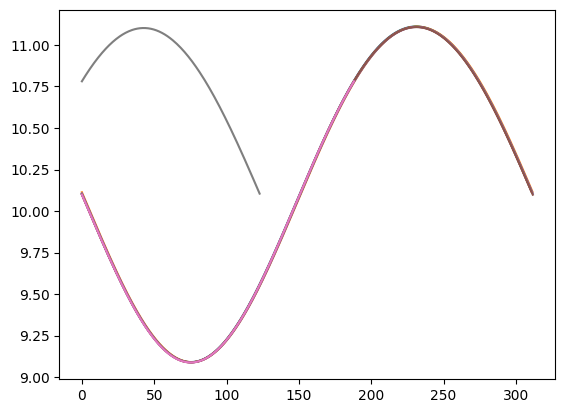

934.7498811161528 1046.914688219669
[-9.11205496e-10  2.53548305e-08 -5.17224188e-09  1.88509935e-09]
[-1.02205189e-07  2.84391967e-06 -5.80143513e-07  2.11441804e-07]
1046.9160955806494 1245.5928239682207
[-4.83706736e-10  1.44403377e-08 -7.38858115e-09  9.89407894e-10]
[-9.61012718e-08  2.86895905e-06 -1.46793913e-06  1.96572323e-07]
1246.0496370802528 1351.287111312443
[-9.10170293e-10  1.90425604e-08 -1.74928323e-08  1.88146561e-09]
[-9.57840227e-08  2.00399096e-06 -1.84090149e-06  1.98000689e-07]
1351.2883591280338 1557.697865127067
[-4.98794441e-10  8.73973483e-09 -1.40609899e-08  1.02183937e-09]
[-1.02955914e-07  1.80396435e-06 -2.90232198e-06  2.10917359e-07]
1557.9159897010488 1655.8480718899139
[-9.07788249e-10  7.27222112e-09 -2.47705439e-08  1.87501122e-09]
[-8.89015934e-08  7.12183756e-07 -2.42583094e-06  1.83623753e-07]
1655.8498886531142 1869.5434832842316
[-5.13925014e-10  2.46741507e-10 -1.68838030e-08  1.05384115e-09]
[-1.09822484e-07  5.27270796e-08 -3.60796055e-06  

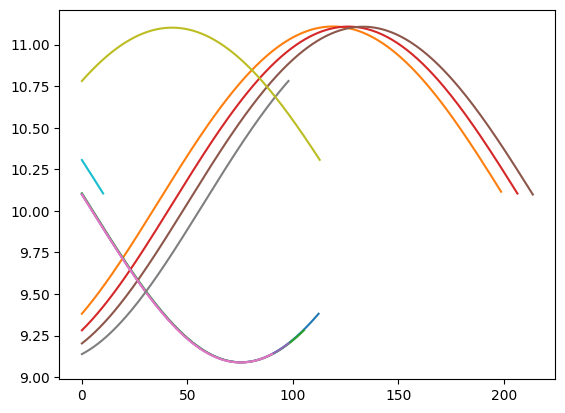

1961.391244163576 2057.5972550387532
[-6.89209088e-10 -9.08172674e-09 -1.89889512e-08  1.41796330e-09]
[-6.63060570e-08 -8.73716701e-07 -1.82685125e-06  1.36416593e-07]
2057.6014704236245 2058.761432321924
[-3.64533700e-04 -2.07226322e-08  8.15800440e-08 -5.65644259e-09]
[-4.22845202e-04 -2.40374638e-08  9.46297427e-08 -6.56125788e-09]
2058.7690013755496 2170.320250338875
[-3.89435496e-10 -8.05595862e-09 -1.14350977e-08  7.94589186e-10]
[-4.34420160e-08 -8.98652246e-07 -1.27559943e-06  8.86374161e-08]
2170.37186533675 2173.7285841887265
[-5.18822968e-10 -1.09700058e-08 -1.33197908e-08  1.06840903e-09]
[-1.74154284e-09 -3.68232251e-08 -4.47107929e-08  3.58634873e-09]
2173.7302072441253 2180.435536845881
[-5.48630735e-10 -1.15398468e-08 -1.37742091e-08  1.13015609e-09]
[-3.67874991e-09 -7.73784761e-08 -9.23606119e-08  7.57806911e-09]


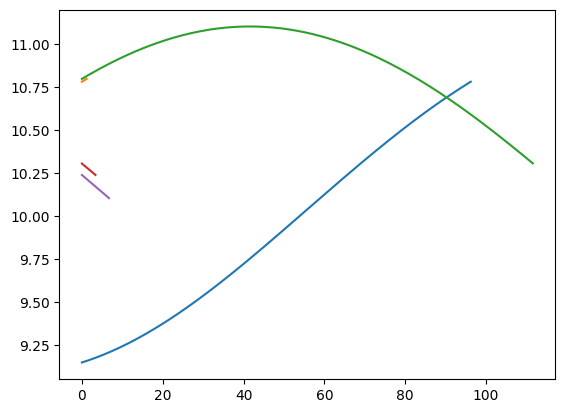

2057.6014704236245 2180.573059984363


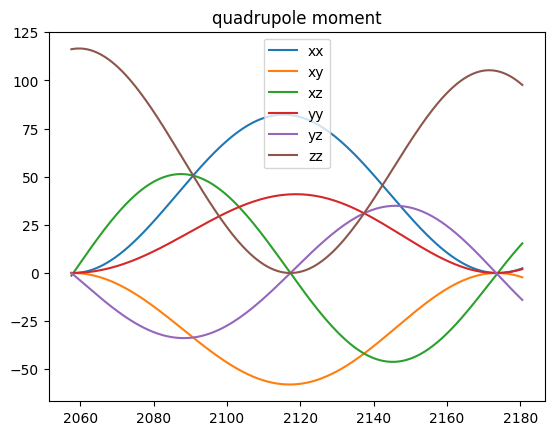

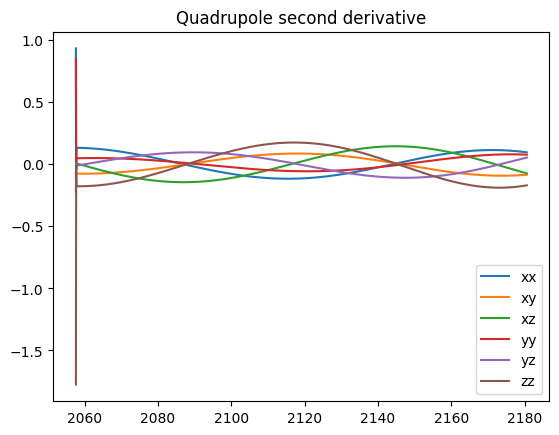

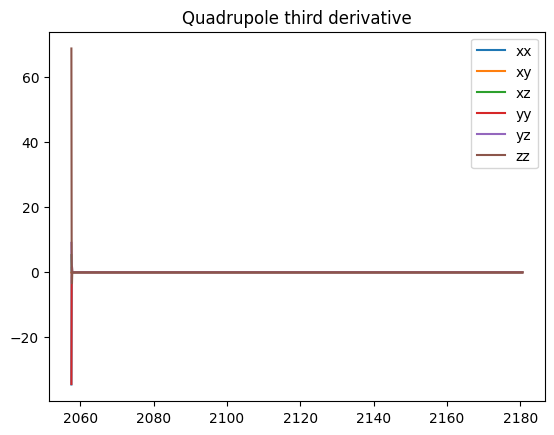

[-9.49745242e-06 -8.95594026e-09 -7.30367881e-09  5.24441259e-10]
[-1.16791682e-03 -1.10132621e-06 -8.98144993e-07  6.44913753e-08]
1869.5550418989465 2057.5972550387532


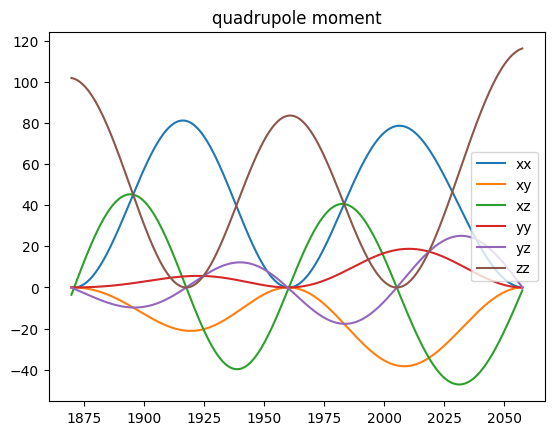

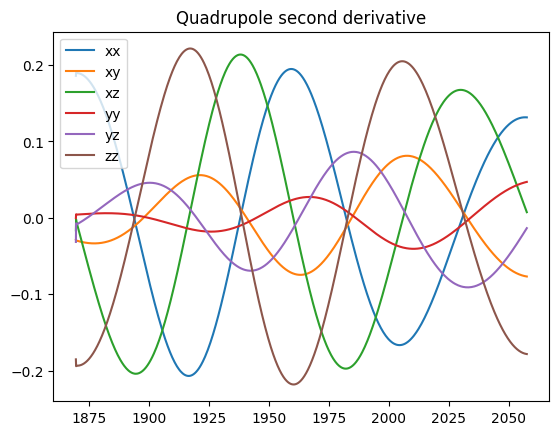

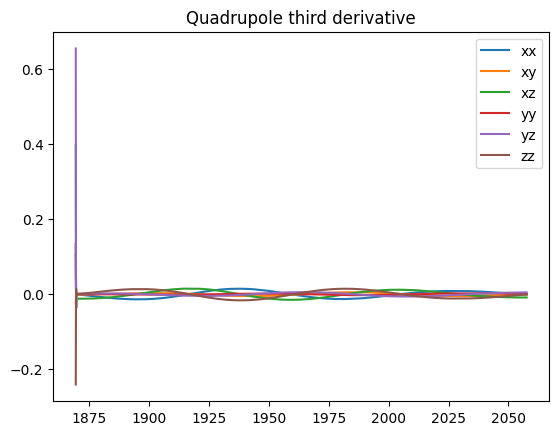

[-1.95533758e-09 -8.07146480e-09 -2.15913399e-08  1.64109556e-09]
[-3.67686005e-07 -1.51777610e-06 -4.06008333e-06  3.08595240e-07]
1557.9159897010488 1869.5434832842316


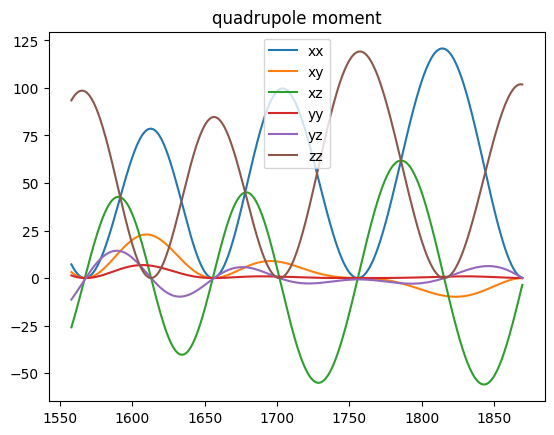

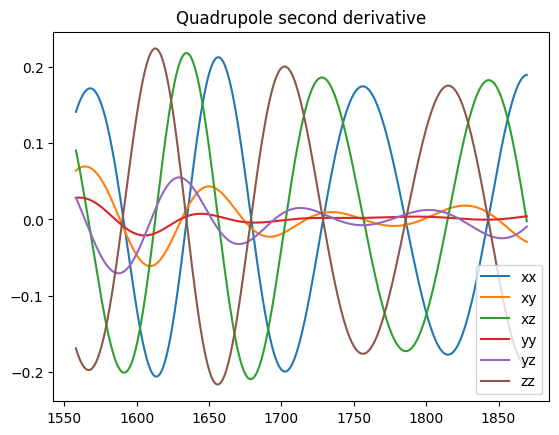

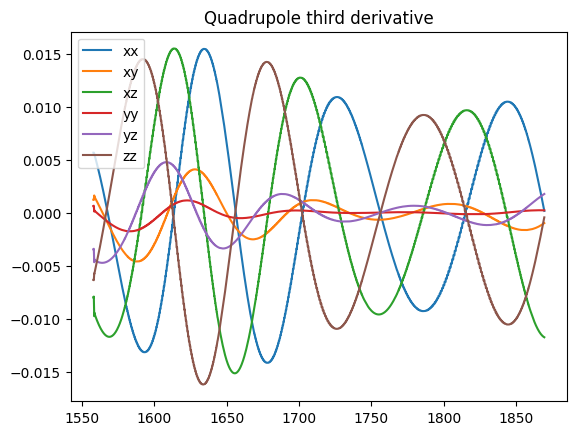

[-6.37461373e-10  2.45369668e-09 -1.93560939e-08  1.31143051e-09]
[-1.98650490e-07  7.64639346e-07 -6.03189104e-06  4.08677802e-07]
1557.9159897010488 1559.6047691817298


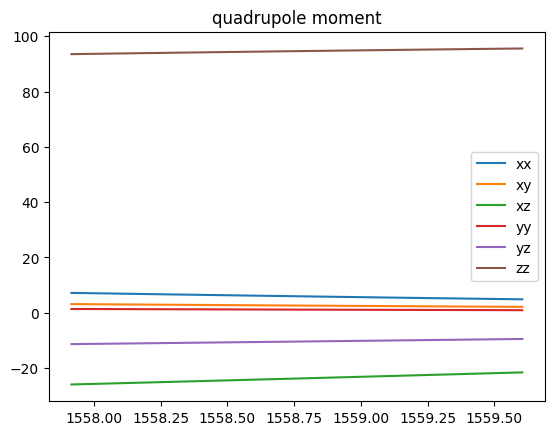

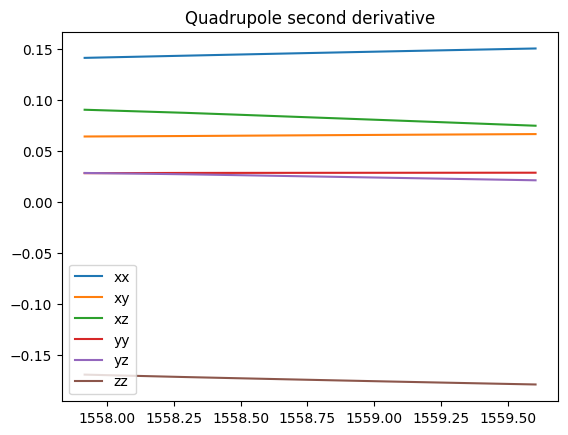

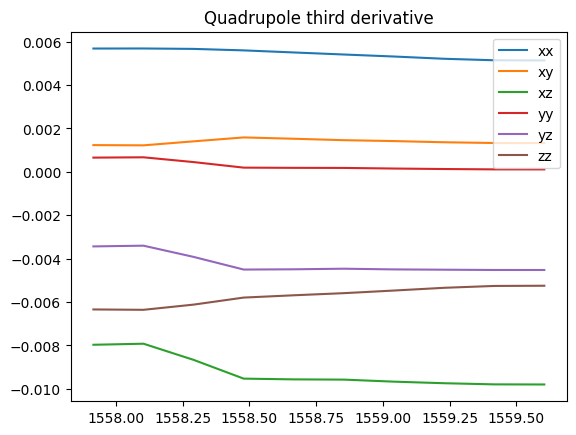

[-6.08423978e-10  7.65806380e-09 -1.86027377e-08  1.29890079e-09]
[-1.02749393e-09  1.29327810e-08 -3.14159218e-08  2.19355701e-09]
1246.0496370802528 1557.697865127067


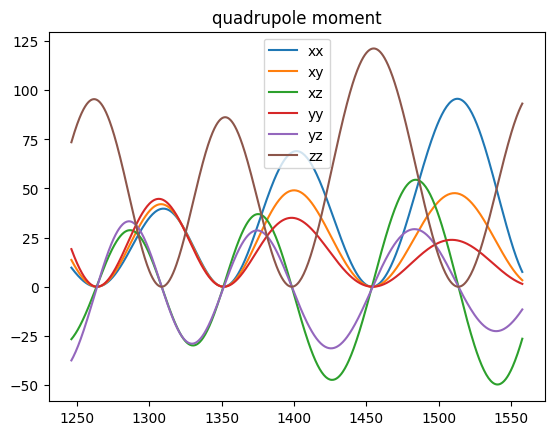

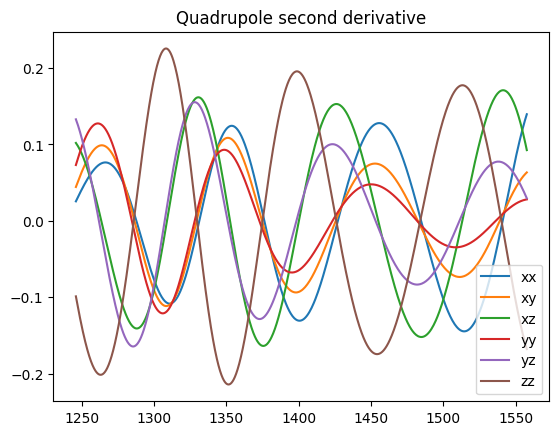

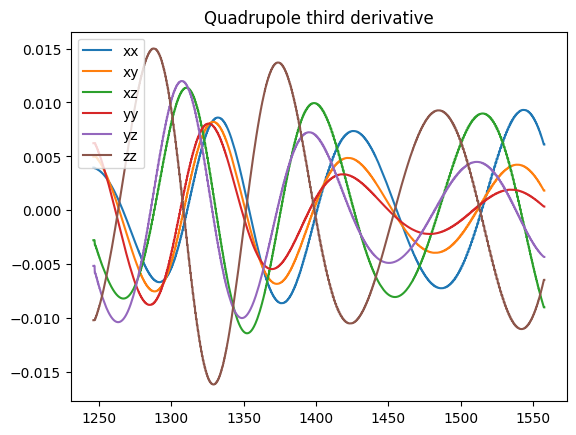

[-6.37506132e-10  1.22151856e-08 -1.52153177e-08  1.31166591e-09]
[-1.98677656e-07  3.80684095e-06 -4.74182679e-06  4.08778356e-07]
1246.0496370802528 1249.6826049877043


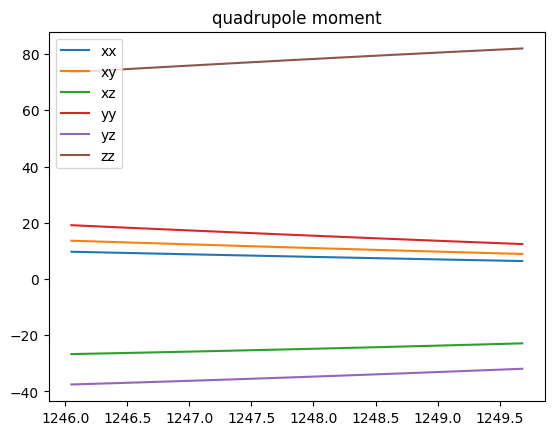

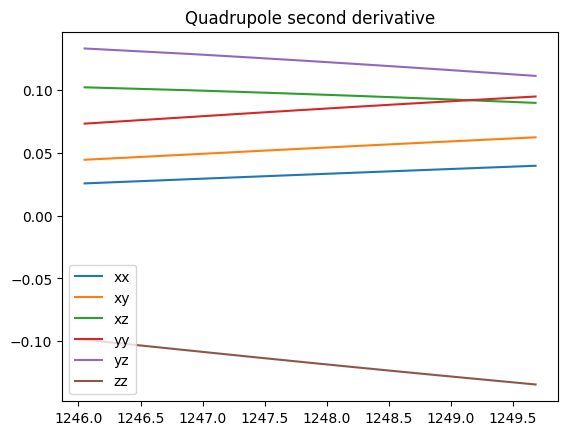

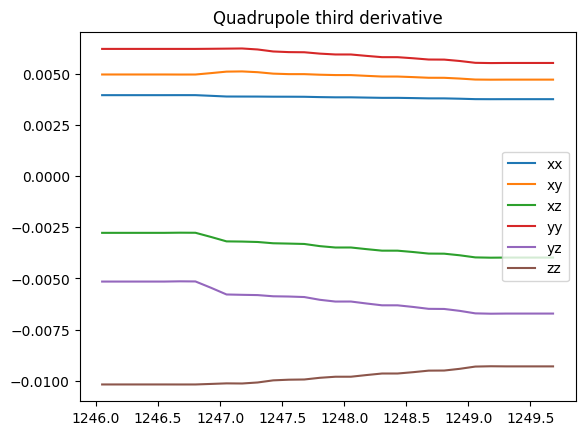

[-6.02058333e-10  1.57556314e-08 -1.14181512e-08  1.25771435e-09]
[-2.18725860e-09  5.72397032e-08 -4.14817767e-08  4.56923588e-09]


In [ ]:
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt

#garp = ml.EMRIGenerator(-0.9, 1e-4, endflag="rad_orbit > 10", params=[10/(1 - 0.1**2), 0.1, np.pi/512], bonk=3, label="wink inc=%s"%(np.round(np.pi/512, 3)), trigger=2, err_target=1e-14, conch=100)
op.plotvalue3(garp, "tracktime", "energy")
op.plotvalue3(garp, "tracktime", "energy", derv=1)
#op.plotvalue3(garp, "semi_lat", "ecc")
op.plotvalue3(garp, "time", "radius")
#op.orthoplots(garp)
#op.plotvalue3(garp, "time", "true_anom")
print(len(garp["true_anom"]), len(garp["time"]), len(garp["tracktime"]))
plt.plot(garp["true_anom"][17500:])

def get_true_anom(state, r0, e):
    pre = np.sign((r0*(1 - e**2)/state[1] - 1)) #e is always positive
    val = np.arccos(pre*min(1.0, abs((r0*(1 - e**2)/state[1] - 1)/(e + 1e-15)))) #add a little tiny bias to get rid of divide by zero errors
    if state[5] < 0:
        val = 2*np.pi - val
    return val

true_anom = []
orbcount = 0
for i in range(len(garp["time"])):
    ix = op.get_index(garp["tracktime"], garp["time"][i])
    if garp["tracktime"][ix] > garp["time"][i]:
        ix -= 1
    val = get_true_anom(garp["raw"][i], garp["r0"][ix], garp["e"][ix]) + 2*np.pi*orbcount
    if len(true_anom) > 0:
        if val < true_anom[-1]:
            val += 2*np.pi
            orbcount += 1
    true_anom.append(val)
plt.plot(true_anom[17500:])
plt.vlines(garp["trackix"][-2:] -17500, 30, 60)


def peters_integrate6_4_test(states, a, mu, ind1, ind2, yap = False):
    '''
    Calculates change in characteristic orbital values from path of test particle through space 

    Parameters
    ----------
    states : N x 8 numpy array of floats
        list of state vectors - [4-position, 4-velocity] in geometric units
    a : int/float
        dimensionless spin constant of black hole, between 0 and 1 inclusive
    mu : float
        mass ratio of test particle to central body
    ind1 : int
        index value of the first entry in states relative to the master state list in clean_inspiral
    ind2 : int
        index value of the last entry in states relative to the master state list in clean_inspiral

    Returns
    -------
     4-element numpy array of floats
        change in orbital characteristics (energy, cartesian components of L) per unit mass 
    '''
    #dedt, dldt = 0, np.array([0.0, 0.0, 0.0])
    if (ind2 - ind1) > 2 or ind2 == -1:
        states = np.array(states)
        sphere, time = states[:, 1:4], states[:, 0]
        print(time[0], time[-1])
        int_sphere, int_time = mm.interpolate(sphere, time, False)
        div = np.mean(np.diff(int_time))
        quad = mm.trace_ortholize(sphere, a)
        delta = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
        coolquad = quad - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad), delta)
        dt2, dt3 = mm.matrix_derive3(coolquad, time, int_time)
        levciv = np.array([[[0, 0, 0],   #Levi-civita tensor
                            [0, 0, 1],
                            [0, -1, 0]],
                           [[0, 0, -1],
                            [0, 0, 0],
                            [1, 0, 0]],
                           [[0, 1, 0],
                            [-1, 0, 0],
                            [0, 0, 0]]])
        if yap == True:
            dims = ["x", "y", "z"]
            for i in range(9):
                if i%3 >= i//3:
                    plt.plot(time, quad[:, i//3, i%3], label = dims[i//3]+dims[i%3])
            plt.title("quadrupole moment")
            plt.legend()
            plt.show()
            for i in range(9):
                if i%3 >= i//3:
                    plt.plot(int_time, dt2[:, i//3, i%3], label = dims[i//3]+dims[i%3])
            plt.title("Quadrupole second derivative")
            plt.legend()
            plt.show()
            for i in range(9):
                if i%3 >= i//3:
                    plt.plot(int_time, dt3[:, i//3, i%3], label = dims[i//3]+dims[i%3])
            plt.title("Quadrupole third derivative")
            plt.legend()
            plt.show()
        dedt = (-1/5)*(np.einsum('ijk,ijk ->i', dt3, dt3) - (1/3)*np.einsum('ijj,ikk ->i', dt3, dt3))
        dldt = (-2/5)*np.einsum("ijk, ljm, lkm -> li", levciv, dt2, dt3)
        dE = np.sum(dedt*div)*mu
        dLx, dLy, dLz = np.sum(dldt*div, axis=0)*mu
    print(np.array([dE, dLx, dLy, dLz])/(time[-1] - time[0]))
    return np.array([dE, dLx, dLy, dLz])
    #return quad

plt.show()
#print(garp["energy"][-5:])
for ix in garp["trackix"]:
    if ix == garp["trackix"][-1]:
        ix_end = -1
    else:
        ix_end = garp["trackix"][np.where(garp["trackix"] == ix)[0][0] + 1]
    
    print(peters_integrate6_4_test(garp["raw"][ix:ix_end], -0.9, 1e-5, ix, ix_end))
    print("---")
    plt.plot(garp["time"][ix:ix_end] - garp["time"][ix], garp["raw"][ix:ix_end, 1])

plt.show()
combine = np.sort(np.concatenate((garp["trackix"], (garp["trackix"][1:] + garp["trackix"][:-1])//2, [(garp["trackix"][-1] + len(garp["time"]) -1)//2])))
for ix in combine[-10:]:
    if ix == combine[-1]:
        ix_end = -1
    else:
        ix_end = combine[np.where(combine == ix)[0][0] + 1]
    
    print(peters_integrate6_4_test(garp["raw"][ix:ix_end], -0.9, 1e-5, ix, ix_end))
    plt.plot(garp["time"][ix:ix_end] - garp["time"][ix], garp["raw"][ix:ix_end, 1])

plt.show()
combine2 = np.sort(np.concatenate((combine, (combine[1:] + combine[:-1])//2, [(combine[-1] + len(garp["time"]) -1)//2])))
for ix in combine2[-5:]:
    if ix == combine2[-1]:
        ix_end = -1
    else:
        ix_end = combine2[np.where(combine2 == ix)[0][0] + 1]
    
    print(peters_integrate6_4_test(garp["raw"][ix:ix_end], -0.9, 1e-5, ix, ix_end))
    plt.plot(garp["time"][ix:ix_end] - garp["time"][ix], garp["raw"][ix:ix_end, 1])
plt.show()

#print(peters_integrate6_4_test(garp["raw"][combine2[-4]:combine2[-3]], -0.9, 1e-5, combine2[-4], combine2[-3], yap=True))
#print(peters_integrate6_4_test(garp["raw"][combine2[-2]:combine2[-1]], -0.9, 1e-5, combine2[-2], combine2[-1], yap=True))
print(peters_integrate6_4_test(garp["raw"][garp["trackix"][-1]:], -0.9, 1e-5, garp["trackix"][-1], -1, yap=True))
print(peters_integrate6_4_test(garp["raw"][garp["trackix"][-2]:garp["trackix"][-1]], -0.9, 1e-5, garp["trackix"][-2], garp["trackix"][-1], yap=True))
print(peters_integrate6_4_test(garp["raw"][garp["trackix"][-3]:garp["trackix"][-2]], -0.9, 1e-5, garp["trackix"][-3], garp["trackix"][-2], yap=True))
print(peters_integrate6_4_test(garp["raw"][garp["trackix"][-3]:garp["trackix"][-3]+10], -0.9, 1e-5, garp["trackix"][-3], garp["trackix"][-3]+10, yap=True))
print(peters_integrate6_4_test(garp["raw"][garp["trackix"][-4]:garp["trackix"][-3]], -0.9, 1e-5, garp["trackix"][-4], garp["trackix"][-3], yap=True))
print(peters_integrate6_4_test(garp["raw"][garp["trackix"][-4]:garp["trackix"][-4]+10], -0.9, 1e-5, garp["trackix"][-4], garp["trackix"][-4]+10, yap=True))



25443 25442 9


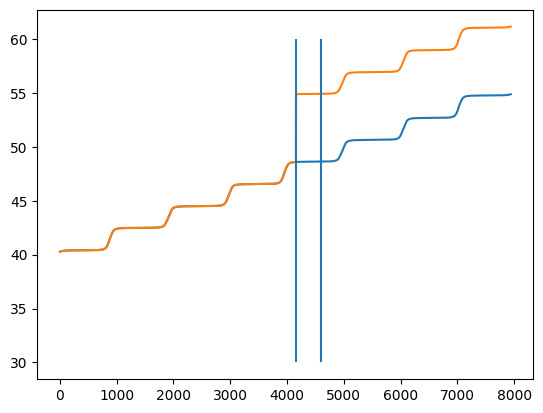

0.0 309.6681570462527
[-6.36483773e-10 -5.06432967e-09  1.88019578e-08 -1.54877662e-09]
[-1.97098757e-07 -1.56826164e-06  5.82236761e-06 -4.79606803e-07]
310.34901297670115 620.3896775547437
[-6.36480989e-10 -1.41018675e-08  1.34271739e-08 -1.54902655e-09]
[-1.97334989e-07 -4.37215238e-06  4.16296993e-06 -4.80261220e-07]
621.0811022654964 930.8453128803005
[-6.36540092e-10 -1.90287476e-08  4.13575008e-09 -1.54933637e-09]
[-1.97177339e-07 -5.89442497e-06  1.28110736e-06 -4.79928957e-07]
931.5029374518218 1241.8329552557072
[-6.36434888e-10 -1.84002839e-08 -6.36496737e-09 -1.54920836e-09]
[-1.97504850e-07 -5.71016042e-06 -1.97524044e-06 -4.80765856e-07]
1242.378713550572 1552.8255103996114
[-6.36374136e-10 -1.23980528e-08 -1.50102375e-08 -1.54909548e-09]
[-1.97560312e-07 -3.84893578e-06 -4.65988015e-06 -4.80911728e-07]
1553.232140211478 1863.963004646688
[-6.36302926e-10 -2.77268012e-09 -1.92680431e-08 -1.54887488e-09]
[-1.97718958e-07 -8.61557290e-07 -5.98717569e-06 -4.81283230e-07]
186

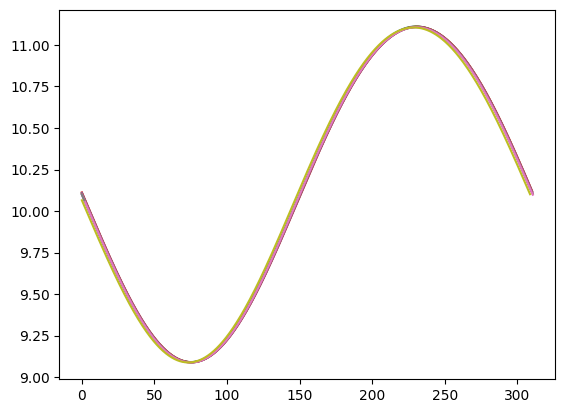

1242.378713550572 1352.0748098124056
[-9.08621365e-10 -1.91287727e-08 -1.73039888e-08 -2.19342971e-09]
[-9.96722167e-08 -2.09835169e-06 -1.89818002e-06 -2.40610677e-07]
1352.07630721345 1552.8255103996114
[-4.87951614e-10 -8.72614475e-09 -1.37642605e-08 -1.19783254e-09]
[-9.79558977e-08 -1.75176661e-06 -2.76316433e-06 -2.40463928e-07]
1553.232140211478 1656.637672677632
[-9.08272749e-10 -7.50148896e-09 -2.46761840e-08 -2.19126548e-09]
[-9.39204272e-08 -7.75695461e-07 -2.55165394e-06 -2.26588974e-07]
1656.6389006641227 1863.963004646688
[-5.00964900e-10 -4.15377078e-10 -1.65793501e-08 -1.22926457e-09]
[-1.03862099e-07 -8.61176804e-08 -3.43729890e-06 -2.54856175e-07]
1864.1506122785415 1961.3276624696698
[-9.05862544e-10  6.25285792e-09 -2.49774183e-08 -2.18446872e-09]
[-8.80290499e-08  6.07634288e-07 -2.42723183e-06 -2.12280226e-07]
1961.3293023167655 2174.853046312465
[-5.13943523e-10  8.30375148e-09 -1.46813295e-08 -1.26022127e-09]
[-1.09739145e-07  1.77304811e-06 -3.13481245e-06 -2.6

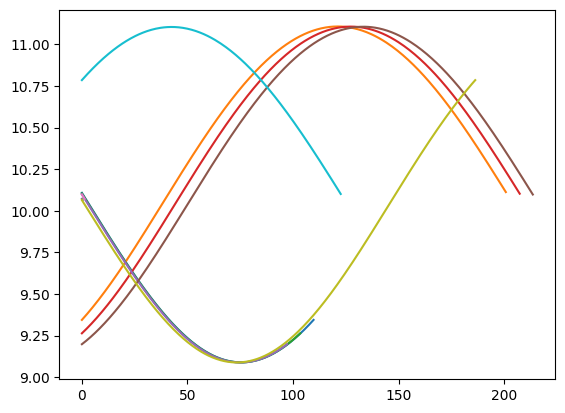

2176.298748767366 2176.4919328245846
[-6.28217925e-10  1.23470961e-08 -1.51123787e-08 -1.46198297e-09]
[-1.21361687e-10  2.38526212e-09 -2.91947063e-09 -2.82431802e-10]
2176.494777132634 2265.707779627627
[-6.73710208e-07  1.81578812e-08 -1.67492216e-08 -2.17721277e-09]
[-6.01037105e-05  1.61991910e-06 -1.49424835e-06 -1.94235688e-07]
2265.709054198596 2362.753597474942
[-6.88820380e-10  1.73694774e-08 -1.18291501e-08 -1.67415314e-09]
[-6.68462591e-08  1.68561300e-06 -1.14795447e-06 -1.62467427e-07]
2362.766499353553 2468.9225647222174
[-3.82121734e-10  1.25007196e-08 -5.81938462e-09 -9.47061425e-10]
[-4.05645398e-08  1.32702720e-06 -6.17762974e-07 -1.00536314e-07]
2469.176181516582 2485.3280977147397
[-5.21296110e-10  1.62112396e-08 -6.00049841e-09 -1.28416516e-09]
[-8.41993108e-09  2.61842584e-07 -9.69195475e-08 -2.07417281e-08]


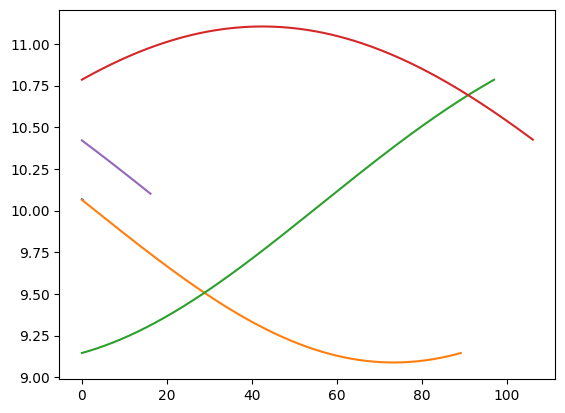

2176.494777132634 2265.707779627627


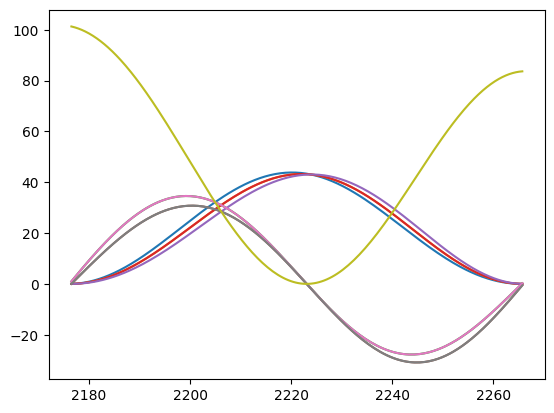

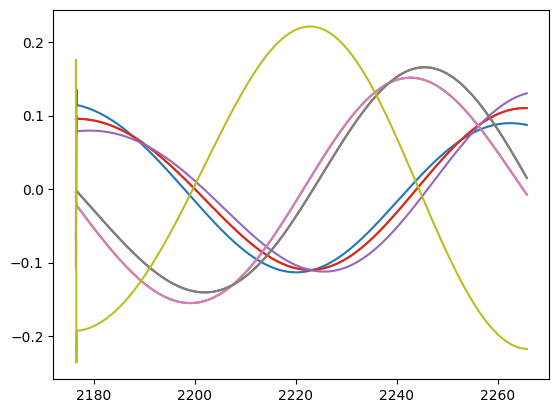

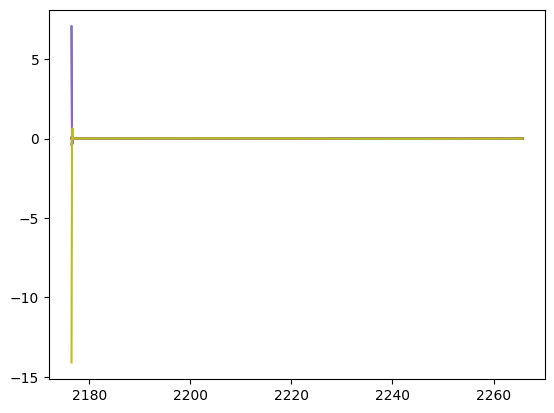

[-6.73710208e-07  1.81578812e-08 -1.67492216e-08 -2.17721277e-09]
[-6.01037105e-05  1.61991910e-06 -1.49424835e-06 -1.94235688e-07]
2362.766499353553 2468.9225647222174


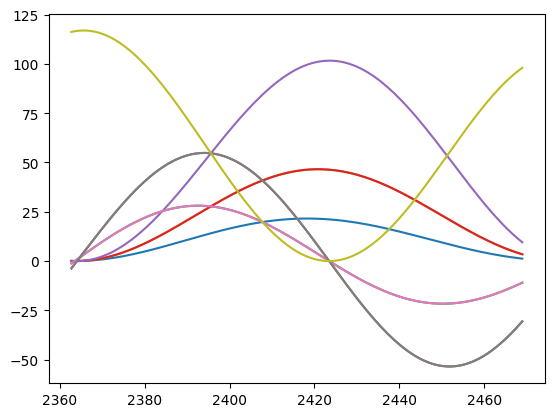

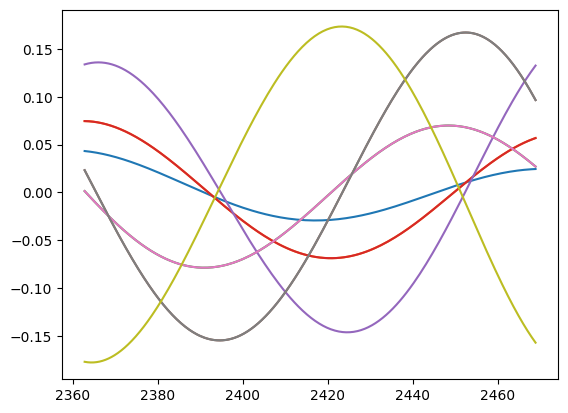

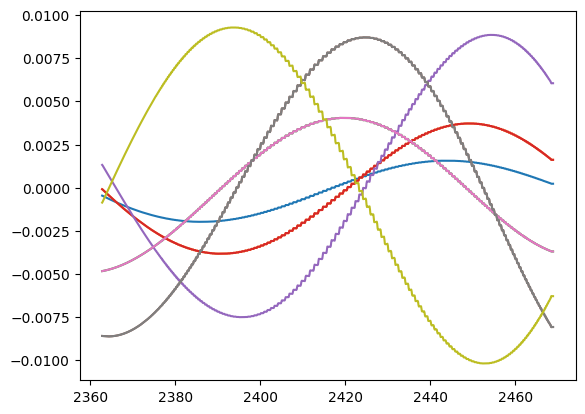

[-3.82121734e-10  1.25007196e-08 -5.81938462e-09 -9.47061425e-10]
[-4.05645398e-08  1.32702720e-06 -6.17762974e-07 -1.00536314e-07]


In [47]:
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt

#garp2 = ml.EMRIGenerator(0.9, 1e-4, endflag="rad_orbit > 10", params=[10/(1 - 0.1**2), 0.1, np.pi/512], bonk=3, label="wink inc=%s"%(np.round(np.pi/512, 3)), trigger=2, err_target=1e-14, conch=100)
#op.plotvalue3(garp2, "tracktime", "energy")
#op.plotvalue3(garp2, "tracktime", "energy", derv=1)
#op.plotvalue3(garp2, "semi_lat", "ecc")
#op.plotvalue3(garp2, "time", "radius")
#op.orthoplots(garp2)
#op.plotvalue3(garp2, "time", "true_anom")
print(len(garp2["true_anom"]), len(garp2["time"]), len(garp2["tracktime"]))
plt.plot(garp2["true_anom"][17500:])

def get_true_anom(state, r0, e):
    pre = np.sign((r0*(1 - e**2)/state[1] - 1)) #e is always positive
    val = np.arccos(pre*min(1.0, abs((r0*(1 - e**2)/state[1] - 1)/(e + 1e-15)))) #add a little tiny bias to get rid of divide by zero errors
    if state[5] < 0:
        val = 2*np.pi - val
    return val

true_anom = []
orbcount = 0
for i in range(len(garp2["time"])):
    ix = op.get_index(garp2["tracktime"], garp2["time"][i])
    if garp2["tracktime"][ix] > garp2["time"][i]:
        ix -= 1
    val = get_true_anom(garp2["raw"][i], garp2["r0"][ix], garp2["e"][ix]) + 2*np.pi*orbcount
    if len(true_anom) > 0:
        if val < true_anom[-1]:
            val += 2*np.pi
            orbcount += 1
    true_anom.append(val)
plt.plot(true_anom[17500:])
plt.vlines(garp2["trackix"][-2:] -17500, 30, 60)


def peters_integrate6_4_test(states, a, mu, ind1, ind2, yap = False):
    '''
    Calculates change in characteristic orbital values from path of test particle through space 

    Parameters
    ----------
    states : N x 8 numpy array of floats
        list of state vectors - [4-position, 4-velocity] in geometric units
    a : int/float
        dimensionless spin constant of black hole, between 0 and 1 inclusive
    mu : float
        mass ratio of test particle to central body
    ind1 : int
        index value of the first entry in states relative to the master state list in clean_inspiral
    ind2 : int
        index value of the last entry in states relative to the master state list in clean_inspiral

    Returns
    -------
     4-element numpy array of floats
        change in orbital characteristics (energy, cartesian components of L) per unit mass 
    '''
    #dedt, dldt = 0, np.array([0.0, 0.0, 0.0])
    if (ind2 - ind1) > 2 or ind2 == -1:
        states = np.array(states)
        sphere, time = states[:, 1:4], states[:, 0]
        print(time[0], time[-1])
        int_sphere, int_time = mm.interpolate(sphere, time, False)
        div = np.mean(np.diff(int_time))
        quad = mm.trace_ortholize(sphere, a)
        delta = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
        coolquad = quad - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad), delta)
        dt2, dt3 = mm.matrix_derive3(coolquad, time, int_time)
        levciv = np.array([[[0, 0, 0],   #Levi-civita tensor
                            [0, 0, 1],
                            [0, -1, 0]],
                           [[0, 0, -1],
                            [0, 0, 0],
                            [1, 0, 0]],
                           [[0, 1, 0],
                            [-1, 0, 0],
                            [0, 0, 0]]])
        if yap == True:
            for i in range(9):
                plt.plot(time, quad[:, i//3, i%3])
            plt.show()
            for i in range(9):
                plt.plot(int_time, dt2[:, i//3, i%3])
            plt.show()
            for i in range(9):
                plt.plot(int_time, dt3[:, i//3, i%3])
            plt.show()
        dedt = (-1/5)*(np.einsum('ijk,ijk ->i', dt3, dt3) - (1/3)*np.einsum('ijj,ikk ->i', dt3, dt3))
        dldt = (-2/5)*np.einsum("ijk, ljm, lkm -> li", levciv, dt2, dt3)
        dE = np.sum(dedt*div)*mu
        dLx, dLy, dLz = np.sum(dldt*div, axis=0)*mu
    print(np.array([dE, dLx, dLy, dLz])/(time[-1] - time[0]))
    return np.array([dE, dLx, dLy, dLz])
    #return quad

plt.show()
#print(garp2["energy"][-5:])
for ix in garp2["trackix"]:
    if ix == garp2["trackix"][-1]:
        ix_end = -1
    else:
        ix_end = garp2["trackix"][np.where(garp2["trackix"] == ix)[0][0] + 1]
    
    print(peters_integrate6_4_test(garp2["raw"][ix:ix_end], 0.9, 1e-5, ix, ix_end))
    plt.plot(garp2["time"][ix:ix_end] - garp2["time"][ix], garp2["raw"][ix:ix_end, 1])

plt.show()
combine = np.sort(np.concatenate((garp2["trackix"], (garp2["trackix"][1:] + garp2["trackix"][:-1])//2, [(garp2["trackix"][-1] + len(garp2["time"]) -1)//2])))
for ix in combine[-10:]:
    if ix == combine[-1]:
        ix_end = -1
    else:
        ix_end = combine[np.where(combine == ix)[0][0] + 1]
    
    print(peters_integrate6_4_test(garp2["raw"][ix:ix_end], 0.9, 1e-5, ix, ix_end))
    plt.plot(garp2["time"][ix:ix_end] - garp2["time"][ix], garp2["raw"][ix:ix_end, 1])

plt.show()
combine2 = np.sort(np.concatenate((combine, (combine[1:] + combine[:-1])//2, [(combine[-1] + len(garp2["time"]) -1)//2])))
for ix in combine2[-5:]:
    if ix == combine2[-1]:
        ix_end = -1
    else:
        ix_end = combine2[np.where(combine2 == ix)[0][0] + 1]
    
    print(peters_integrate6_4_test(garp2["raw"][ix:ix_end], 0.9, 1e-5, ix, ix_end))
    plt.plot(garp2["time"][ix:ix_end] - garp2["time"][ix], garp2["raw"][ix:ix_end, 1])
plt.show()

print(peters_integrate6_4_test(garp2["raw"][combine2[-4]:combine2[-3]], 0.9, 1e-5, combine2[-4], combine2[-3], yap=True))
print(peters_integrate6_4_test(garp2["raw"][combine2[-2]:combine2[-1]], 0.9, 1e-5, combine2[-2], combine2[-1], yap=True))


 11%|█         | 1083563.1545524644/10000000 [00:05<00:29, 307185.76it/s, Semilat: 9.999, Ecc 0.1]

(True and True) or (False and (False and True))


 20%|██        | 2010040.675964452/10000000 [00:10<00:34, 228957.59it/s, Semilat: 9.999, Ecc 0.1] 

(True and True) or (False and (True and False))


 30%|██▉       | 2999975.192792479/10000000 [00:16<00:30, 230102.73it/s, Semilat: 9.998, Ecc 0.1] 

(True and True) or (False and (False and True))


 34%|███▍      | 3393855.3920541313/10000000 [00:19<00:46, 142706.60it/s, Semilat: 9.998, Ecc 0.1]

(False and False) or (True and (True and True))


 40%|████      | 4013418.1400457392/10000000 [00:23<00:46, 130046.74it/s, Semilat: 9.999, Ecc 0.098]

(False and False) or (True and (True and True))


 45%|████▌     | 4545526.84955827/10000000 [00:25<00:21, 249738.95it/s, Semilat: 9.999, Ecc 0.098]  C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\matplotlib\cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\matplotlib\cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)
 46%|████▌     | 4578745.580299355/10000000 [00:27<00:32, 168118.94it/s, Semilat: 9.999, Ecc 0.098]

(False and False) or (True and (True and True))
[9.9216682  6.1934633  1.35545383]
[9.9216682  6.1934633  1.35545383]
[ -0.3434344    6.         -28.60561441  28.60531877]
[9.9216682  6.1934633  1.35545383]
sta
9.921668197331769 [9.9216682  6.1934633  1.35545383]
ROOTER
(array([1.25072914e-03+0.j        , 3.32313561e+00+0.j        ,
       9.98486372e+00-0.70488322j, 9.98486372e+00+0.70488322j]), array([1.35545383+0.j, 6.1934633 +0.j, 9.9216682 +0.j]), array([-150.32516139+0.j,   -0.99998118+0.j,    0.99998118+0.j,
        150.32516139+0.j]))
(-2.8149603641425154+0j) -1e-14 whoops

Ending program


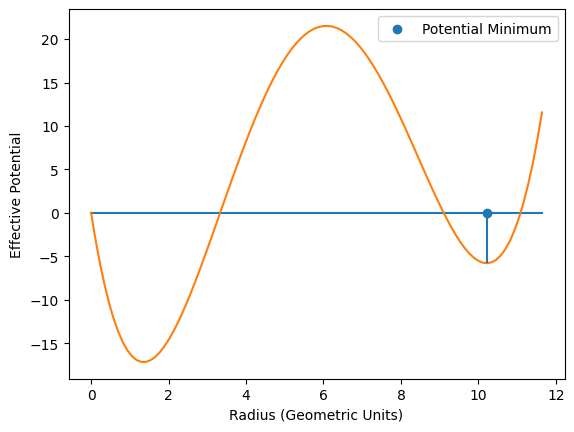

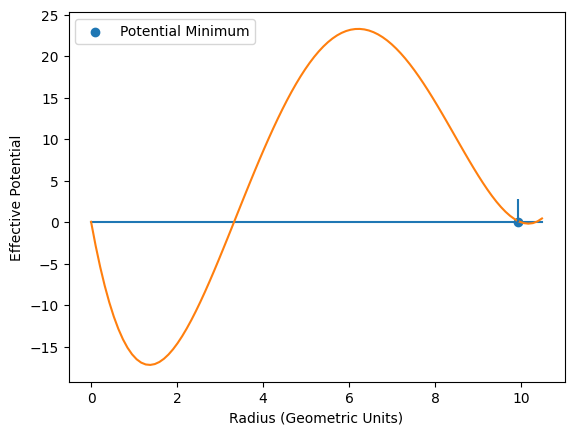

15098 15097 6


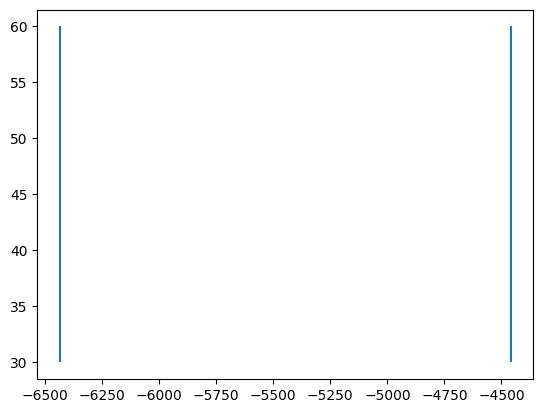

0.0 316.7081988599165
[-6.54056410e-10 -3.06997296e-10  2.02349030e-08 -2.05905405e-10]
[-2.07145028e-07 -9.72285607e-08  6.40855967e-06 -6.52119300e-08]
317.40494672883125 634.4036669707472
[-6.54169051e-10 -9.44532743e-10  2.02180939e-08 -2.05961985e-10]
[-2.07370752e-07 -2.99415671e-07  6.40910989e-06 -6.52896857e-08]
634.9062374948118 952.6139733497516
[-6.54209138e-10 -1.58192136e-09  2.01798194e-08 -2.05941585e-10]
[-2.07847304e-07 -5.02588654e-07  6.41128472e-06 -6.54292346e-08]
952.6239451071643 1044.1539262690003
[-1.56881016e-09 -2.62265822e-09  2.57369682e-08 -2.74431060e-10]
[-1.43593165e-07 -2.40051858e-07  2.35570421e-06 -2.51186698e-08]
1044.1719082844045 1255.7157448409498
[-5.35367230e-09 -2.02368749e-09  1.75859970e-08 -1.76466951e-10]
[-1.13253638e-06 -4.28098616e-07  3.72020927e-06 -3.73304958e-08]
1255.7349011809888 1439.6994389610609
[-2.38481894e-07 -3.24321466e-09  2.36352138e-08 -2.51031818e-10]
[-4.38722114e-05 -5.96636485e-07  4.34804119e-06 -4.61809523e-08]


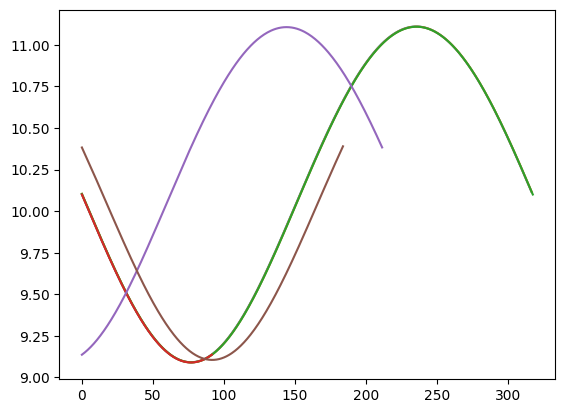

317.40494672883125 435.97277317672814
[-9.35664179e-10 -1.03208315e-09  2.66091159e-08 -2.80175865e-10]
[-1.10939668e-07 -1.22371856e-07  3.15498503e-06 -3.32198434e-08]
435.97479048186545 634.4036669707472
[-4.86333030e-10 -8.92711028e-10  1.64095433e-08 -1.61725248e-10]
[-9.65025168e-08 -1.77139646e-07  3.25612724e-06 -3.20909593e-08]
634.9062374948118 739.2442569764542
[-9.34919494e-10 -1.84464015e-09  2.65401228e-08 -2.79777683e-10]
[-9.75476484e-08 -1.92466100e-07  2.76914385e-06 -2.91914494e-08]
739.2458431979079 952.6139733497516
[-5.17294706e-10 -1.45419070e-09  1.70790103e-08 -1.69936212e-10]
[-1.10374204e-07 -3.10277951e-07  3.64411650e-06 -3.62589719e-08]
952.6239451071643 1028.4514322289526
[-1.89294608e-09 -2.51874000e-09  2.47231634e-08 -2.64106927e-10]
[-1.43537344e-07 -1.90989725e-07  1.87469536e-06 -2.00265646e-08]
1028.822233557102 1044.1539262690003
[-1.08687590e-09 -3.11256823e-09  2.96233668e-08 -3.20303638e-10]
[-1.66636473e-08 -4.77209396e-08  4.54176358e-07 -4.9

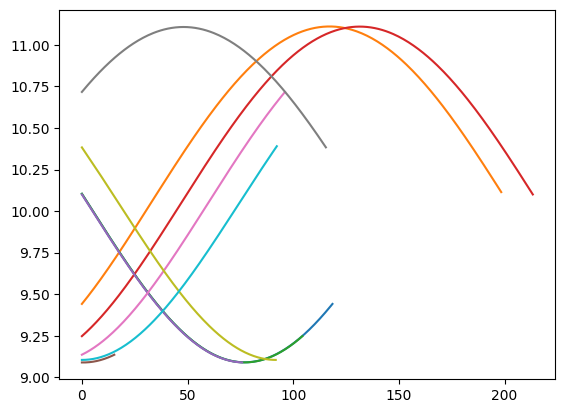

1253.6612532765796 1255.7157448409498
[-5.10526356e-10 -2.13061730e-09  1.70391915e-08 -1.68878968e-10]
[-1.04887209e-09 -4.37733526e-09  3.50068751e-08 -3.46960415e-10]
1255.7349011809888 1346.0844289615604
[-5.03948104e-07 -3.05323602e-09  2.29792894e-08 -2.47551795e-10]
[-4.55314732e-05 -2.75858432e-07  2.07616795e-06 -2.23661878e-08]
1346.087860791056 1347.4554446704633
[-1.09578620e-09 -4.03049707e-09  2.96443561e-08 -3.21711161e-10]
[-1.49857955e-09 -5.51204281e-09  4.05411435e-08 -4.39966997e-10]
1347.4652528575327 1437.737726177518
[-8.39337242e-10 -3.43556910e-09  2.43038165e-08 -2.55219163e-10]
[-7.57690488e-08 -3.10137320e-07  2.19396562e-06 -2.30392651e-08]
1437.7431184719235 1439.6994389610609
[-5.20775587e-10 -2.53182315e-09  1.72255263e-08 -1.71528353e-10]
[-1.01880395e-09 -4.95305750e-09  3.36986501e-08 -3.35564431e-10]


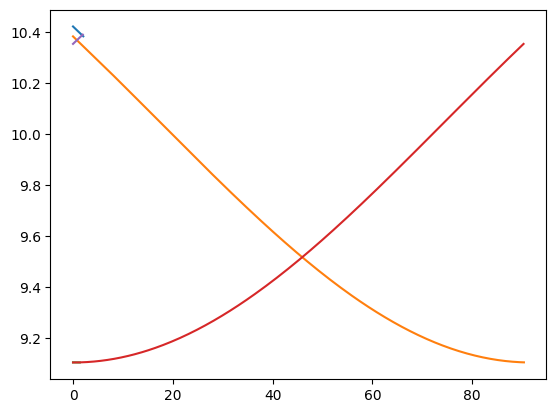

1255.7349011809888 1346.0844289615604


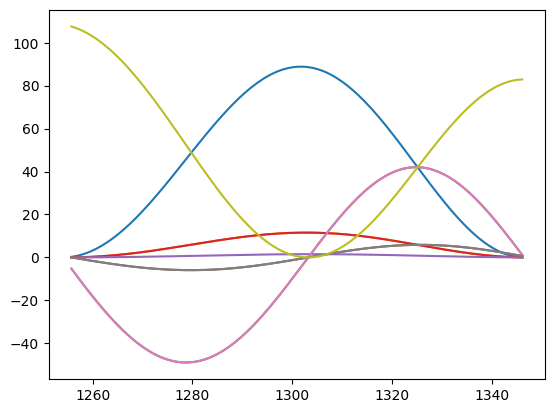

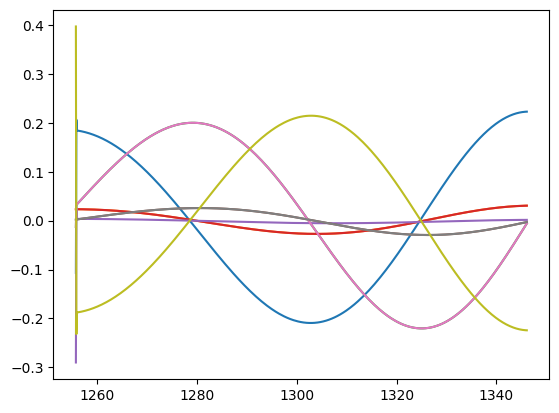

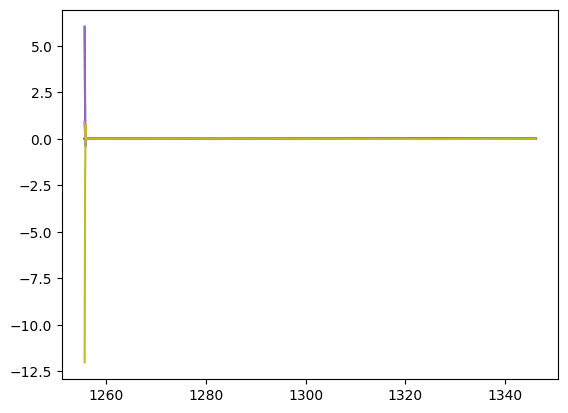

[-5.03948130e-07 -3.05332736e-09  2.29799764e-08 -2.47562581e-10]
[-4.55314756e-05 -2.75866685e-07  2.07623002e-06 -2.23671623e-08]
1347.4652528575327 1437.737726177518


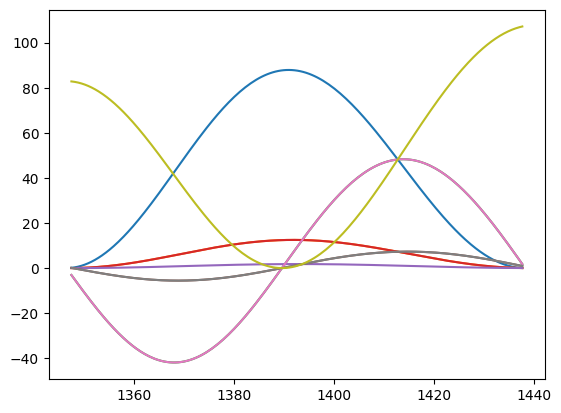

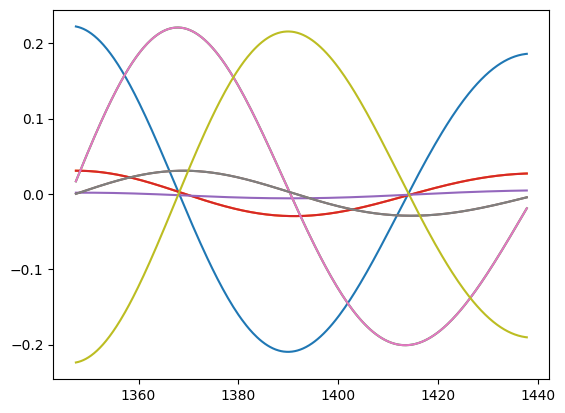

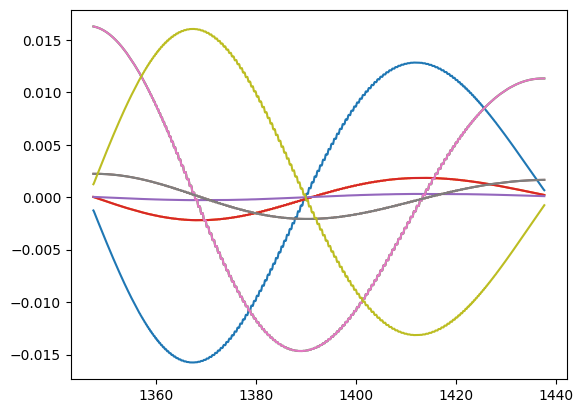

[-8.39361265e-10 -3.43566595e-09  2.43045011e-08 -2.55229944e-10]
[-7.57712174e-08 -3.10146063e-07  2.19402742e-06 -2.30402383e-08]


In [48]:
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt

garp3 = ml.EMRIGenerator(0.050, 1e-4, endflag="rad_orbit > 10", params=[10/(1 - 0.1**2), 0.1, np.pi/512], bonk=3, label="wink inc=%s"%(np.round(np.pi/512, 3)), trigger=2, err_target=1e-14, conch=100)
plt.show()
#op.plotvalue3(garp3, "tracktime", "energy")
#op.plotvalue3(garp3, "tracktime", "energy", derv=1)
#op.plotvalue3(garp3, "semi_lat", "ecc")
#op.plotvalue3(garp3, "time", "radius")
#op.orthoplots(garp3)
#op.plotvalue3(garp3, "time", "true_anom")
print(len(garp3["true_anom"]), len(garp3["time"]), len(garp3["tracktime"]))
plt.plot(garp3["true_anom"][17500:])

def get_true_anom(state, r0, e):
    pre = np.sign((r0*(1 - e**2)/state[1] - 1)) #e is always positive
    val = np.arccos(pre*min(1.0, abs((r0*(1 - e**2)/state[1] - 1)/(e + 1e-15)))) #add a little tiny bias to get rid of divide by zero errors
    if state[5] < 0:
        val = 2*np.pi - val
    return val

true_anom = []
orbcount = 0
for i in range(len(garp3["time"])):
    ix = op.get_index(garp3["tracktime"], garp3["time"][i])
    if garp3["tracktime"][ix] > garp3["time"][i]:
        ix -= 1
    val = get_true_anom(garp3["raw"][i], garp3["r0"][ix], garp3["e"][ix]) + 2*np.pi*orbcount
    if len(true_anom) > 0:
        if val < true_anom[-1]:
            val += 2*np.pi
            orbcount += 1
    true_anom.append(val)
plt.plot(true_anom[17500:])
plt.vlines(garp3["trackix"][-2:] -17500, 30, 60)


def peters_integrate6_4_test(states, a, mu, ind1, ind2, yap = False):
    '''
    Calculates change in characteristic orbital values from path of test particle through space 

    Parameters
    ----------
    states : N x 8 numpy array of floats
        list of state vectors - [4-position, 4-velocity] in geometric units
    a : int/float
        dimensionless spin constant of black hole, between 0 and 1 inclusive
    mu : float
        mass ratio of test particle to central body
    ind1 : int
        index value of the first entry in states relative to the master state list in clean_inspiral
    ind2 : int
        index value of the last entry in states relative to the master state list in clean_inspiral

    Returns
    -------
     4-element numpy array of floats
        change in orbital characteristics (energy, cartesian components of L) per unit mass 
    '''
    #dedt, dldt = 0, np.array([0.050, 0.050, 0.050])
    if (ind2 - ind1) > 2 or (ind2 == -1 and len(states) > 1):
        states = np.array(states)
        sphere, time = states[:, 1:4], states[:, 0]
        print(time[0], time[-1])
        int_sphere, int_time = mm.interpolate(sphere, time, False)
        div = np.mean(np.diff(int_time))
        quad = mm.trace_ortholize(sphere, a)
        delta = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
        coolquad = quad - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad), delta)
        dt2, dt3 = mm.matrix_derive3(coolquad, time, int_time)
        levciv = np.array([[[0, 0, 0],   #Levi-civita tensor
                            [0, 0, 1],
                            [0, -1, 0]],
                           [[0, 0, -1],
                            [0, 0, 0],
                            [1, 0, 0]],
                           [[0, 1, 0],
                            [-1, 0, 0],
                            [0, 0, 0]]])
        if yap == True:
            for i in range(9):
                plt.plot(time, quad[:, i//3, i%3])
            plt.show()
            for i in range(9):
                plt.plot(int_time, dt2[:, i//3, i%3])
            plt.show()
            for i in range(9):
                plt.plot(int_time, dt3[:, i//3, i%3])
            plt.show()
        dedt = (-1/5)*(np.einsum('ijk,ijk ->i', dt3, dt3) - (1/3)*np.einsum('ijj,ikk ->i', dt3, dt3))
        dldt = (-2/5)*np.einsum("ijk, ljm, lkm -> li", levciv, dt2, dt3)
        dE = np.sum(dedt*div)*mu
        dLx, dLy, dLz = np.sum(dldt*div, axis=0)*mu
        print(np.array([dE, dLx, dLy, dLz])/(time[-1] - time[0]))
        return np.array([dE, dLx, dLy, dLz])
    else:
        return False
    #return quad

plt.show()
#print(garp3["energy"][-5:])
for ix in garp3["trackix"]:
    if ix == garp3["trackix"][-1]:
        if garp3["tracktime"][-1] == garp3["time"][-1]:
            break
        else:
            ix_end = -1
    else:
        ix_end = garp3["trackix"][np.where(garp3["trackix"] == ix)[0][0] + 1]
    
    print(peters_integrate6_4_test(garp3["raw"][ix:ix_end], -0.050, 1e-5, ix, ix_end))
    plt.plot(garp3["time"][ix:ix_end] - garp3["time"][ix], garp3["raw"][ix:ix_end, 1])

plt.show()
combine = np.sort(np.concatenate((garp3["trackix"], (garp3["trackix"][1:] + garp3["trackix"][:-1])//2, [(garp3["trackix"][-1] + len(garp3["time"]) -1)//2])))
for ix in combine[-10:]:
    if ix == combine[-1]:
        if combine[-1] == garp3["time"][-1]:
            break
        else:
            ix_end = -1
    else:
        ix_end = combine[np.where(combine == ix)[0][0] + 1]
    
    print(peters_integrate6_4_test(garp3["raw"][ix:ix_end], -0.050, 1e-5, ix, ix_end))
    plt.plot(garp3["time"][ix:ix_end] - garp3["time"][ix], garp3["raw"][ix:ix_end, 1])

plt.show()
combine2 = np.sort(np.concatenate((combine, (combine[1:] + combine[:-1])//2, [(combine[-1] + len(garp3["time"]) -1)//2])))
for ix in combine2[-5:]:
    if ix == combine2[-1]:
        if combine2[-1] == garp3["time"][-1]:
            break
        else:
            ix_end = -1
    else:
        ix_end = combine2[np.where(combine2 == ix)[0][0] + 1]
    
    print(peters_integrate6_4_test(garp3["raw"][ix:ix_end], -0., 1e-5, ix, ix_end))
    plt.plot(garp3["time"][ix:ix_end] - garp3["time"][ix], garp3["raw"][ix:ix_end, 1])
plt.show()

print(peters_integrate6_4_test(garp3["raw"][combine2[-4]:combine2[-3]], -0.050, 1e-5, combine2[-4], combine2[-3], yap=True))
print(peters_integrate6_4_test(garp3["raw"][combine2[-2]:combine2[-1]], -0.050, 1e-5, combine2[-2], combine2[-1], yap=True))


 11%|█▏        | 1149621.5616034265/10000000 [00:01<00:08, 1047455.62it/s, Semilat: 9.997, Ecc 0.1]

(True and True) or (False and (False and True))


 21%|██        | 2057553.422758732/10000000 [00:01<00:07, 1014362.37it/s, Semilat: 9.994, Ecc 0.1] 

(True and True) or (False and (True and False))


 31%|███       | 3083518.8759356565/10000000 [00:02<00:06, 1063756.44it/s, Semilat: 9.992, Ecc 0.1]

(True and True) or (False and (False and True))


 42%|████▏     | 4168158.2517086146/10000000 [00:03<00:04, 1216338.52it/s, Semilat: 9.989, Ecc 0.1]

(True and True) or (False and (True and False))


 52%|█████▏    | 5168302.342942173/10000000 [00:04<00:04, 1048693.23it/s, Semilat: 9.986, Ecc 0.1] 

(True and True) or (False and (True and False))


 62%|██████▏   | 6178021.609665694/10000000 [00:05<00:03, 1116733.45it/s, Semilat: 9.983, Ecc 0.1] 

(True and True) or (False and (False and True))


 71%|███████   | 7095510.0475498205/10000000 [00:06<00:02, 1136690.75it/s, Semilat: 9.98, Ecc 0.1] 

(True and True) or (False and (True and False))


 81%|████████  | 8086128.591929657/10000000 [00:07<00:01, 1115409.06it/s, Semilat: 9.977, Ecc 0.1]

(True and True) or (False and (True and False))


 92%|█████████▏| 9195219.631443944/10000000 [00:08<00:00, 1206739.21it/s, Semilat: 9.974, Ecc 0.1]

(True and True) or (False and (False and True))


10001161.81600249it [00:08, 1117951.33it/s, Semilat: 9.971, Ecc 0.1]                              


(True and True) or (False and (True and False))
5391 5391 11


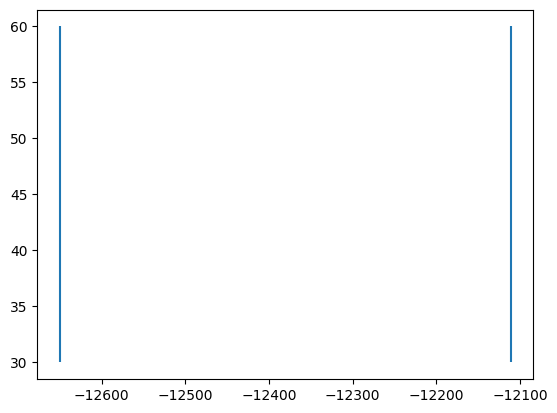

0.0 505.6344188377653
[-8.09604069e-10 -2.28012921e-26  5.57019551e-26 -2.41815603e-08]
[-4.09363683e-07 -1.15291181e-23  2.81648257e-23 -1.22270292e-05]
506.74754241645786 1012.8860100883364
[-8.10795723e-10 -2.46835193e-17  5.06478690e-17 -2.42071508e-08]
[-4.10374905e-07 -1.24932786e-14  2.56348348e-14 -1.22521702e-05]
1013.991546172647 1521.3400674872237
[-8.11901732e-10  6.53953306e-17  1.30531335e-17 -2.42311703e-08]
[-4.11917143e-07  3.31782243e-14  6.62248799e-15 -1.22936484e-05]
1522.4541670507854 2028.8455156070552
[-8.13376244e-10  6.53147156e-17 -2.69270746e-17 -2.42616916e-08]
[-4.11886693e-07  3.30748069e-14 -1.36356376e-14 -1.22859107e-05]
2029.945126765646 2537.34817529227
[-8.14530369e-10 -1.14602262e-17 -8.09578160e-17 -2.42865971e-08]
[-4.13295192e-07 -5.81495372e-15 -4.10782426e-14 -1.23230934e-05]
2538.447971360641 3046.070877525662
[-8.15823203e-10 -5.00802083e-17 -6.64488891e-17 -2.43139435e-08]
[-4.14130545e-07 -2.54218609e-14 -3.37309782e-14 -1.23423147e-05]
30

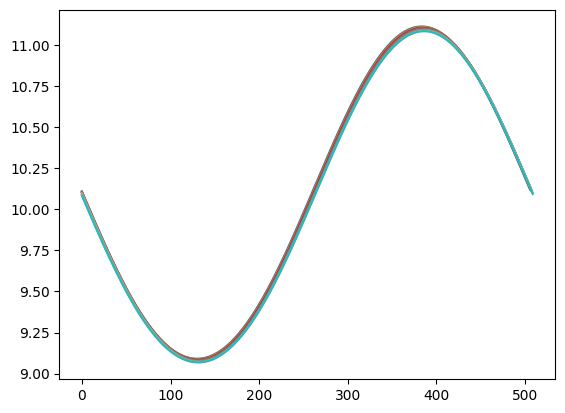

3047.1768439836164 3285.153779656647
[-1.11352927e-09 -1.31745429e-16  1.96293260e-17 -3.08012415e-08]
[-2.64994283e-07 -3.13523736e-14  4.67132685e-15 -7.32998507e-06]
3286.098736460711 3555.8636019735736
[-5.55509784e-10 -5.56350078e-17  5.01332249e-17 -1.86421652e-08]
[-1.49857022e-07 -1.50083704e-14  1.35241827e-14 -5.02900118e-06]
3556.9810726121177 3794.901903626865
[-1.11588648e-09 -9.04797147e-18  1.48982996e-16 -3.08484253e-08]
[-2.65492640e-07 -2.15270089e-15  3.54461582e-14 -7.33948298e-06]
3795.8513512164136 4064.637679296755
[-5.55400138e-10  3.41853175e-17  7.33289510e-17 -1.86401842e-08]
[-1.49283964e-07  9.18854597e-15  1.97098195e-14 -5.01022667e-06]
4065.74266343675 4303.76021157505
[-1.11733442e-09  1.10609606e-16  9.31401044e-17 -3.08759147e-08]
[-2.65945199e-07  2.63270271e-14  2.21689793e-14 -7.34900952e-06]
4304.705070219728 4574.546280460831
[-5.57217681e-10  8.51278047e-17  6.75598932e-18 -1.86829381e-08]
[-1.50360293e-07  2.29709898e-14  1.82304433e-15 -5.0414

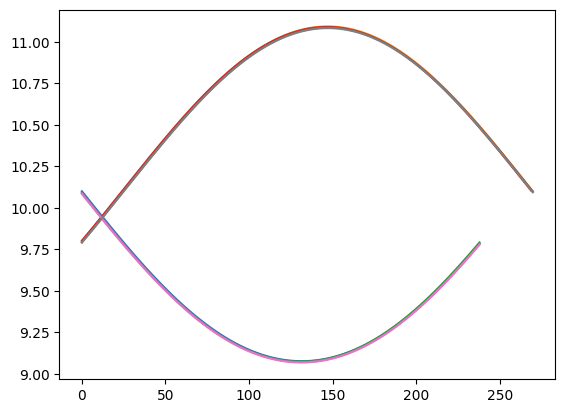

4949.392892059074 5084.511986555421
[-5.17643897e-10  3.22355964e-17 -7.93643012e-17 -1.76710108e-08]
[-6.99435747e-08  4.35564460e-15 -1.07236325e-14 -2.38769098e-06]
False
False
False
False


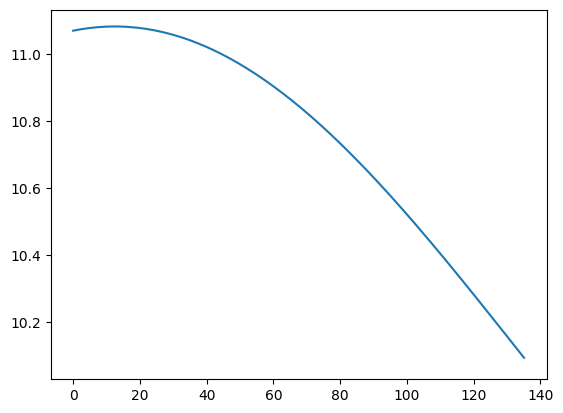

False
False


In [52]:
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt

garp4 = ml.EMRIGenerator(-0.9, 1e-4, endflag="rad_orbit > 10", params=[10/(1 - 0.1**2), 0.1, np.pi/2], bonk=3, label="wink inc=%s"%(np.round(np.pi/2, 3)), trigger=2, err_target=1e-14, conch=100)
plt.show()
#op.plotvalue3(garp4, "tracktime", "energy")
#op.plotvalue3(garp4, "tracktime", "energy", derv=1)
#op.plotvalue3(garp4, "semi_lat", "ecc")
#op.plotvalue3(garp4, "time", "radius")
#op.orthoplots(garp4)
#op.plotvalue3(garp4, "time", "true_anom")
print(len(garp4["true_anom"]), len(garp4["time"]), len(garp4["tracktime"]))
plt.plot(garp4["true_anom"][17500:])

def get_true_anom(state, r0, e):
    pre = np.sign((r0*(1 - e**2)/state[1] - 1)) #e is always positive
    val = np.arccos(pre*min(1.0, abs((r0*(1 - e**2)/state[1] - 1)/(e + 1e-15)))) #add a little tiny bias to get rid of divide by zero errors
    if state[5] < 0:
        val = 2*np.pi - val
    return val

true_anom = []
orbcount = 0
for i in range(len(garp4["time"])):
    ix = op.get_index(garp4["tracktime"], garp4["time"][i])
    if garp4["tracktime"][ix] > garp4["time"][i]:
        ix -= 1
    val = get_true_anom(garp4["raw"][i], garp4["r0"][ix], garp4["e"][ix]) + 2*np.pi*orbcount
    if len(true_anom) > 0:
        if val < true_anom[-1]:
            val += 2*np.pi
            orbcount += 1
    true_anom.append(val)
plt.plot(true_anom[17500:])
plt.vlines(garp4["trackix"][-2:] -17500, 30, 60)


def peters_integrate6_4_test(states, a, mu, ind1, ind2, yap = False):
    '''
    Calculates change in characteristic orbital values from path of test particle through space 

    Parameters
    ----------
    states : N x 8 numpy array of floats
        list of state vectors - [4-position, 4-velocity] in geometric units
    a : int/float
        dimensionless spin constant of black hole, between 0 and 1 inclusive
    mu : float
        mass ratio of test particle to central body
    ind1 : int
        index value of the first entry in states relative to the master state list in clean_inspiral
    ind2 : int
        index value of the last entry in states relative to the master state list in clean_inspiral

    Returns
    -------
     4-element numpy array of floats
        change in orbital characteristics (energy, cartesian components of L) per unit mass 
    '''
    #dedt, dldt = 0, np.array([-0.9, -0.9, -0.9])
    if (ind2 - ind1) > 2 or (ind2 == -1 and len(states) > 1):
        states = np.array(states)
        sphere, time = states[:, 1:4], states[:, 0]
        print(time[0], time[-1])
        int_sphere, int_time = mm.interpolate(sphere, time, False)
        div = np.mean(np.diff(int_time))
        quad = mm.trace_ortholize(sphere, a)
        delta = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
        coolquad = quad - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad), delta)
        dt2, dt3 = mm.matrix_derive3(coolquad, time, int_time)
        levciv = np.array([[[0, 0, 0],   #Levi-civita tensor
                            [0, 0, 1],
                            [0, -1, 0]],
                           [[0, 0, -1],
                            [0, 0, 0],
                            [1, 0, 0]],
                           [[0, 1, 0],
                            [-1, 0, 0],
                            [0, 0, 0]]])
        if yap == True:
            for i in range(9):
                plt.plot(time, quad[:, i//3, i%3])
            plt.show()
            for i in range(9):
                plt.plot(int_time, dt2[:, i//3, i%3])
            plt.show()
            for i in range(9):
                plt.plot(int_time, dt3[:, i//3, i%3])
            plt.show()
        dedt = (-1/5)*(np.einsum('ijk,ijk ->i', dt3, dt3) - (1/3)*np.einsum('ijj,ikk ->i', dt3, dt3))
        dldt = (-2/5)*np.einsum("ijk, ljm, lkm -> li", levciv, dt2, dt3)
        dE = np.sum(dedt*div)*mu
        dLx, dLy, dLz = np.sum(dldt*div, axis=0)*mu
        print(np.array([dE, dLx, dLy, dLz])/(time[-1] - time[0]))
        return np.array([dE, dLx, dLy, dLz])
    else:
        return False
    #return quad

plt.show()
#print(garp4["energy"][-5:])
for ix in garp4["trackix"]:
    if ix == garp4["trackix"][-1]:
        if garp4["tracktime"][-1] == garp4["time"][-1]:
            break
        else:
            ix_end = -1
    else:
        ix_end = garp4["trackix"][np.where(garp4["trackix"] == ix)[0][0] + 1]
    
    print(peters_integrate6_4_test(garp4["raw"][ix:ix_end], -0.9, 1e-5, ix, ix_end))
    plt.plot(garp4["time"][ix:ix_end] - garp4["time"][ix], garp4["raw"][ix:ix_end, 1])

plt.show()
combine = np.sort(np.concatenate((garp4["trackix"], (garp4["trackix"][1:] + garp4["trackix"][:-1])//2, [(garp4["trackix"][-1] + len(garp4["time"]) -1)//2])))
for ix in combine[-10:]:
    if ix == combine[-1]:
        if combine[-1] == garp4["time"][-1]:
            break
        else:
            ix_end = -1
    else:
        ix_end = combine[np.where(combine == ix)[0][0] + 1]
    
    print(peters_integrate6_4_test(garp4["raw"][ix:ix_end], -0.9, 1e-5, ix, ix_end))
    plt.plot(garp4["time"][ix:ix_end] - garp4["time"][ix], garp4["raw"][ix:ix_end, 1])

plt.show()
combine2 = np.sort(np.concatenate((combine, (combine[1:] + combine[:-1])//2, [(combine[-1] + len(garp4["time"]) -1)//2])))
for ix in combine2[-5:]:
    if ix == combine2[-1]:
        if combine2[-1] == garp4["time"][-1]:
            break
        else:
            ix_end = -1
    else:
        ix_end = combine2[np.where(combine2 == ix)[0][0] + 1]
    
    print(peters_integrate6_4_test(garp4["raw"][ix:ix_end], -0., 1e-5, ix, ix_end))
    plt.plot(garp4["time"][ix:ix_end] - garp4["time"][ix], garp4["raw"][ix:ix_end, 1])
plt.show()

print(peters_integrate6_4_test(garp4["raw"][combine2[-4]:combine2[-3]], -0.9, 1e-5, combine2[-4], combine2[-3], yap=True))
print(peters_integrate6_4_test(garp4["raw"][combine2[-2]:combine2[-1]], -0.9, 1e-5, combine2[-2], combine2[-1], yap=True))


(25442, 3, 3)
[10.14102584 10.14102081 10.14100865 ...  0.61618878  0.62621753
  0.63648878]
[10.1010101   1.57079633  0.        ]
[   0.          311.02610951  621.76922365  932.15172829 1242.91409858
 1553.62814817 1864.33262818 2174.88411519 2176.49769313]
25442


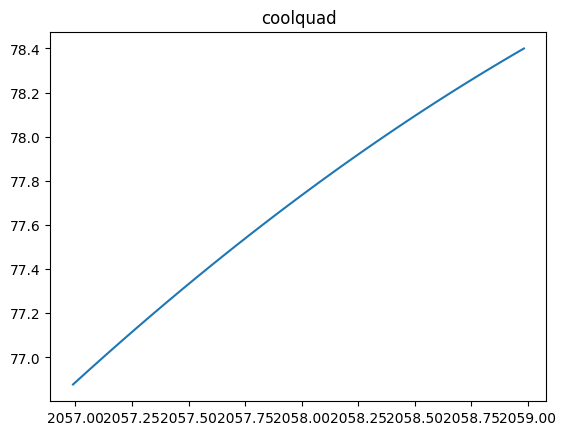

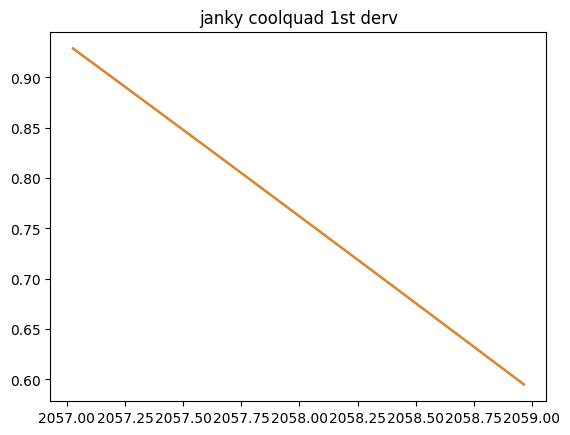

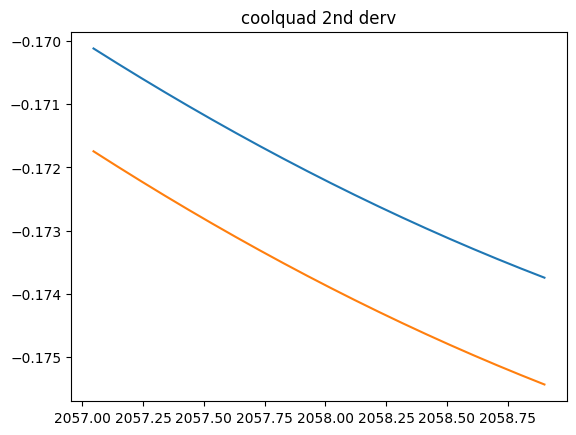

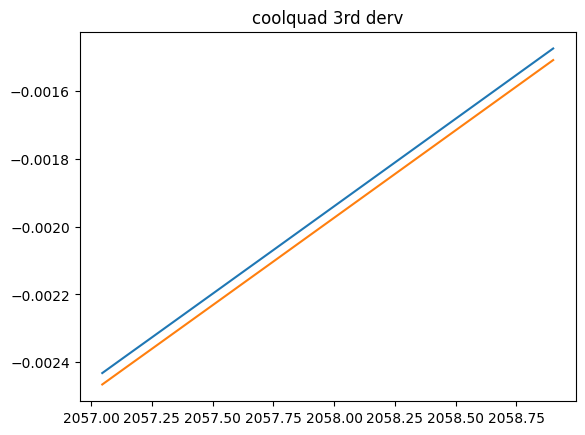

[10.14102584 10.14102081 10.14100865 ...  0.61618878  0.62621753
  0.63648878]
[10.1010101   1.57079633  0.        ]


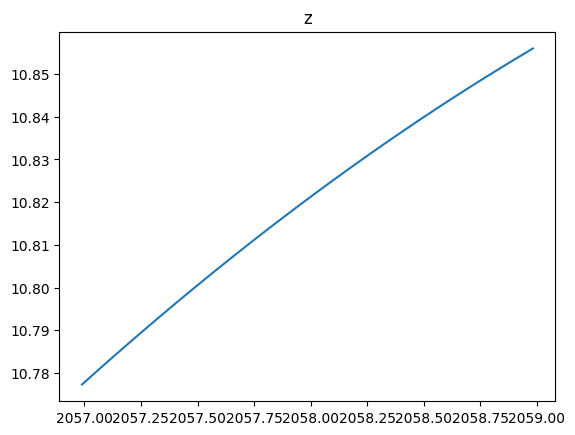

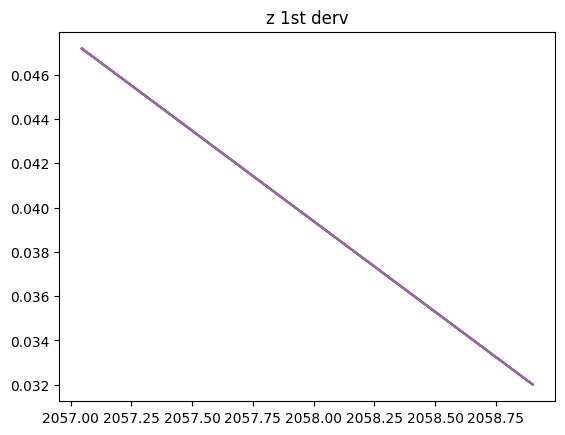

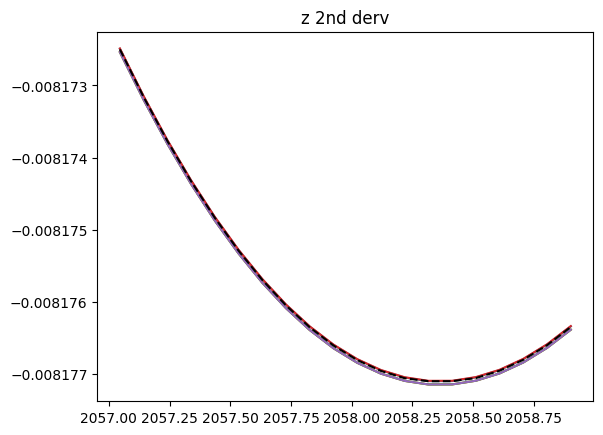

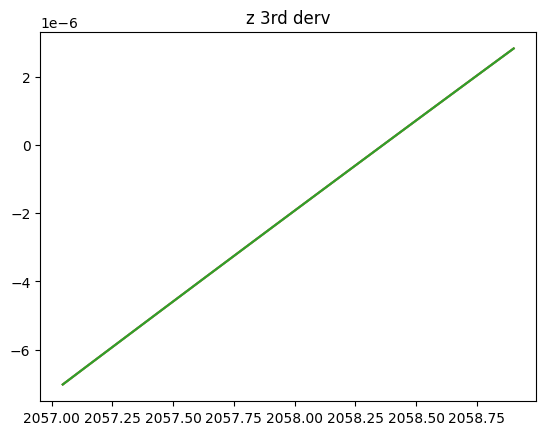

25442 25442
[[ 0.08280552  0.00108092 -0.00223943  0.00095229]
 [ 0.08084445  0.00105339 -0.00218591  0.0009583 ]
 [ 0.07894436  0.00102679 -0.00213408  0.00096445]
 [ 0.07709539  0.00100097 -0.00208366  0.00097065]
 [ 0.07531173  0.00097613 -0.00203502  0.0009771 ]
 [ 0.07357501  0.00095201 -0.00198769  0.00098359]
 [ 0.07189029  0.00092868 -0.00194178  0.00099021]
 [ 0.07025388  0.00090607 -0.0018972   0.00099692]
 [ 0.06866601  0.00088419 -0.00185395  0.00100375]]
[[-2.66087152e-05 -2.86702640e-05  7.69215026e-06  4.07501212e-04]
 [-2.59120961e-05 -2.80198626e-05  7.55911452e-06  4.19038114e-04]
 [-2.52397212e-05 -2.73885170e-05  7.43272475e-06  4.30829913e-04]
 [-2.45881406e-05 -2.67729344e-05  7.31202439e-06  4.42836817e-04]
 [-2.39616026e-05 -2.61781707e-05  7.19834117e-06  4.55156103e-04]
 [-2.33539936e-05 -2.55979717e-05  7.08991891e-06  4.67697575e-04]
 [-2.27666778e-05 -2.50341987e-05  6.98722255e-06  4.80504888e-04]
 [-2.21982564e-05 -2.44856752e-05  6.88988818e-06  4.935695

In [33]:
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt

#garp = ml.EMRIGenerator(-0.9, 1e-4, endflag="rad_orbit > 10", params=[10/(1 - 0.1**2), 0.1, np.pi/512], bonk=3, label="wink inc=%s"%(np.round(np.pi/512, 3)), trigger=2, err_target=1e-14, conch=100)
#op.plotvalue3(garp, "tracktime", "energy")
#op.plotvalue3(garp, "tracktime", "energy", derv=1)
#op.plotvalue3(garp, "semi_lat", "ecc")
#op.plotvalue3(garp, "time", "radius")
#op.plotvalue3(garp, "time", "radius", derv=1)
#op.plotvalue3(garp, "time", "theta")
#op.plotvalue3(garp, "time", "theta", derv=1)
#op.plotvalue3(garp, "time", "phase")
#op.plotvalue3(garp, "time", "phase", derv=1)

def trace_ortholize_test(pos_list, a=None):
    '''
    Calculates quadrupole moment in cartesian coords from position in spherical coords 

    Parameters
    ----------
    pos : N x 3 numpy array of floats
        full data package of an orbit given by clean_inspiral, assumed interpolated to be evenly spaced across time

    Returns
    -------
    qmom : N x 3 x 3 numpy array of floats
        quadrupole moment of test particle per unit mass
    '''
    if a == None:
        print('old')
        return trace_ortholize_old(pos_list)
    x = np.sqrt(pos_list[:,0]**2 + a**2) * np.sin(pos_list[:,1]) * np.cos(pos_list[:,2])
    y = np.sqrt(pos_list[:,0]**2 + a**2) * np.sin(pos_list[:,1]) * np.sin(pos_list[:,2])
    z = pos_list[:,0] * np.cos(pos_list[:,1]) 
    print(x)
    print(pos_list[0])
    
    qmom = np.transpose(np.array([[x*x, x*y, x*z],
                                  [y*x, y*y, y*z],
                                  [z*x, z*y, z*z]]))
    return qmom

quad = mm.trace_ortholize(garp["pos"], -0.9)
delta = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
coolquad = quad - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad), delta)
print(np.shape(quad))
quad2 = trace_ortholize_test(garp["pos"], -0.9)
#delta = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
coolquad2 = quad2 - (1/3)*np.einsum('i, jk -> ijk', np.einsum('ijj -> i', quad2), delta)

int_sphere, int_time = mm.interpolate(garp["pos"], garp["time"], False)
dt2, dt3 = mm.matrix_derive3(coolquad, garp["time"], int_time)
dt2_2, dt3_2 = mm.matrix_derive3(quad, garp["time"], int_time)
print(garp["tracktime"])
print(len(int_time))
#int_time2 = np.linspace(garp["time"][0], garp['time'][-1], len(int_time)*10)

a, b = 2057, 2059
ix1, ix2 = op.get_index(garp["time"], a), op.get_index(garp["time"], b)#-1#op.get_index(garp["time"], 2058.28)
ix1_2, ix2_2 = op.get_index(int_time, a), op.get_index(int_time, b)#-1 #op.get_index(int_time, 2058.28)
for i in [8]:
    #print(i//3, i%3)
    plt.plot(garp["time"][ix1:ix2], coolquad[ix1:ix2, i//3, i%3])
    #plt.plot(garp["time"][ix1:ix2], coolquad2[ix1:ix2, i//3, i%3])
    #plt.scatter(garp["time"][ix1:ix2], dt3[ix1:ix2, i//3, i%3])
plt.title("coolquad")
plt.show()

for i in [8]:#range(9):
    #print(i//3, i%3)
    plt.plot(0.5*(garp["time"][ix1:ix2-1] + garp["time"][ix1+1:ix2]), np.diff(coolquad[ix1:ix2, i//3, i%3])/np.diff(garp["time"][ix1:ix2]))
    plt.plot(0.5*(garp["time"][ix1:ix2-1] + garp["time"][ix1+1:ix2]), np.diff(coolquad[ix1:ix2, i//3, i%3])/np.diff(garp["time"][ix1:ix2]))
    #plt.scatter(garp["time"][ix1:ix2-1], np.diff(coolquad[ix1:ix2, i//3, i%3])/np.diff(garp["time"][ix1:ix2]))
    #plt.scatter(garp["time"][ix1:ix2], dt3[ix1:ix2, i//3, i%3])
plt.title("janky coolquad 1st derv")
plt.show()

for i in [8]:
    #print(i//3, i%3)
    plt.plot(int_time[ix1_2:ix2_2], dt2[ix1_2:ix2_2, i//3, i%3])
    plt.plot(int_time[ix1_2:ix2_2], dt2_2[ix1_2:ix2_2, i//3, i%3])
    #plt.scatter(garp["time"][ix1:ix2], dt3[ix1:ix2, i//3, i%3])
plt.title("coolquad 2nd derv")
plt.show()

for i in [8]:
    #print(i//3, i%3)
    plt.plot(int_time[ix1_2:ix2_2], dt3[ix1_2:ix2_2, i//3, i%3])
    plt.plot(int_time[ix1_2:ix2_2], dt3_2[ix1_2:ix2_2, i//3, i%3])
    #plt.scatter(garp["time"][ix1:ix2], dt3[ix1:ix2, i//3, i%3])
plt.title("coolquad 3rd derv")
plt.show()
a = -0.9
x = np.sqrt(garp["pos"][:,0]**2 + a**2) * np.sin(garp["pos"][:,1]) * np.cos(garp["pos"][:,2])
z = garp["pos"][:,0] * np.cos(garp["pos"][:,1]) 
print(x)
print(garp["pos"][0])
plt.plot(garp["time"][ix1:ix2], z[ix1:ix2])
#plt.plot(garp["time"][ix1:ix2], garp["pos"][ix1:ix2, 1])
#plt.scatter(garp["time"][ix1:ix2], z[ix1:ix2])
plt.title("z")
plt.show()
#plt.plot(garp["time"][ix1:ix2], z[ix1:ix2]**2)

import scipy.interpolate as spi

u = spi.CubicSpline(garp["time"], z)
dt = np.mean(np.diff(int_time))

c1d4o = (-u(int_time + 2*dt) + 8*u(int_time + dt) - 8*u(int_time - dt) + u(int_time - 2*dt))/(12*dt)
l1d2o = (3*u(int_time) - 4*u(int_time - dt) + u(int_time - 2*dt))/(2*dt)
r1d2o = (-3*u(int_time) + 4*u(int_time + dt) - u(int_time + 2*dt))/(2*dt)
c1d2o = (u(int_time + dt) - u(int_time - dt))/(2*dt)
med1d = np.median([c1d4o, l1d2o, r1d2o, c1d2o], axis=0)
plt.plot(int_time[ix1_2:ix2_2], c1d4o[ix1_2:ix2_2])
plt.plot(int_time[ix1_2:ix2_2], l1d2o[ix1_2:ix2_2])
plt.plot(int_time[ix1_2:ix2_2], r1d2o[ix1_2:ix2_2])
plt.plot(int_time[ix1_2:ix2_2], c1d2o[ix1_2:ix2_2])
plt.plot(int_time[ix1_2:ix2_2], med1d[ix1_2:ix2_2])
plt.title("z 1st derv")
plt.show()

c2d4o = (-u(int_time + 2*dt) + 16*u(int_time + dt) - 30*u(int_time) + 16*u(int_time - dt) - u(int_time - 2*dt))/(12*dt*dt)
l2d2o = (2*u(int_time) - 5*u(int_time - dt) + 4*u(int_time - 2*dt) - u(int_time - 3*dt))/(dt*dt)
r2d2o = (2*u(int_time) - 5*u(int_time + dt) + 4*u(int_time + 2*dt) - u(int_time + 3*dt))/(dt*dt)
c2d2o = (u(int_time + dt) - 2*u(int_time) + u(int_time - dt))/(dt*dt)
med2d = np.median([c2d4o, l2d2o, r2d2o], axis=0)
ud1 = spi.CubicSpline(int_time, med1d)
c1d4o_ud1 = (-ud1(int_time + 2*dt) + 8*ud1(int_time + dt) - 8*ud1(int_time - dt) + ud1(int_time - 2*dt))/(12*dt)
plt.plot(int_time[ix1_2:ix2_2], c2d4o[ix1_2:ix2_2])
plt.plot(int_time[ix1_2:ix2_2], l2d2o[ix1_2:ix2_2])
plt.plot(int_time[ix1_2:ix2_2], r2d2o[ix1_2:ix2_2])
plt.plot(int_time[ix1_2:ix2_2], c2d2o[ix1_2:ix2_2])
plt.plot(int_time[ix1_2:ix2_2], med2d[ix1_2:ix2_2])
plt.plot(int_time[ix1_2:ix2_2], c1d4o_ud1[ix1_2:ix2_2], c="k", linestyle = "--")
plt.title("z 2nd derv")
plt.show()

c3d4o = (-u(int_time + 3*dt) + 8*u(int_time + 2*dt) - 13*u(int_time + dt) + 13*u(int_time - dt) - 8*u(int_time - 2*dt) + u(int_time - 3*dt))/(8*dt*dt*dt)
c3d2o = (u(int_time + 2*dt) - 2*u(int_time + dt) + 2*u(int_time - dt) - u(int_time - 2*dt))/(2*dt*dt*dt)
med3d = np.median([c3d4o, c3d2o], axis=0)
plt.plot(int_time[ix1_2:ix2_2], c3d4o[ix1_2:ix2_2])
plt.plot(int_time[ix1_2:ix2_2], c3d2o[ix1_2:ix2_2])
plt.plot(int_time[ix1_2:ix2_2], med3d[ix1_2:ix2_2])
plt.title("z 3rd derv")
plt.show()
print(len(garp["time"]), len(int_time))

print(np.diff(garp["raw"][ix1-5:ix1+5, :4], axis=0))
print(np.diff(garp["raw"][ix1-5:ix1+5, 4:], axis=0))
print(np.diff(np.diff(garp["raw"][ix1-5:ix1+5, 4:], axis=0), axis=0))
print(np.diff(np.diff(np.diff(garp["raw"][ix1-5:ix1+5, 4:], axis=0), axis=0), axis=0))

In [29]:
print(things3[-1]["time"][-90000:-87000])
#op.plotvalue3(things, "energy", "approx_L")
#op.plotvalue3(things2, "energy", "approx_L")
#op.plotvalue3(things3, "energy", "approx_L")
#op.plotvalue3(things4, "energy", "approx_L")
#op.plotvalue3(things, "energy", "approx_L", derv=1)
#op.plotvalue3(things2, "energy", "approx_L", derv=1)
#op.plotvalue3(things3, "energy", "approx_L", derv=1)
#op.plotvalue3(things4, "energy", "approx_L", derv=1)
#for sims in things:
    #plt.plot(np.diff(sims["energy"]), np.diff(sims["carter"] + sims["phi_momentum"]**2))
op.plotvalue3(things[0], "tracktime", "energy")
op.plotvalue3(things[0], "tracktime", "L_z")
op.plotvalue3(things[0], "tracktime", "carter")
op.plotvalue3(things[0], "tracktime", "approx_L")

[28752.85922121 28752.87715467 28752.89537364 ... 29006.23625748
 29006.23916507 29006.24205717]


NameError: name 'things' is not defined

In [2]:
sim_stuff = [[ml.EMRIGenerator(a, 1e-3, endflag="radius < 2", params=[10/(1 - e**2), e, 0.5*np.pi], bonk=3, label="wink e=%s, a=%s"%(e, a), trigger=2, err_target=1e-14, conch=100) for a in [0.0, 0.2, 0.5]] for e in [0.01, 0.2, 0.5]]


100%|█████████▉| 9999753.893961787/10000000 [02:24<00:00, 69205.00it/s, Semilat: 6.093, Ecc 0.053]  
10000192.047326924it [03:13, 51634.60it/s, Semilat: 5.432, Ecc 0.062]                               
10000937.222720578it [04:59, 33337.56it/s, Semilat: 4.316, Ecc 0.069]                               
100%|█████████▉| 9999762.449038291/10000000 [03:39<00:00, 45625.83it/s, Semilat: 6.308, Ecc 0.155]    
10000102.307818439it [05:10, 32160.98it/s, Semilat: 5.511, Ecc 0.111]                                 
10000771.872519296it [08:41, 19167.44it/s, Semilat: 4.373, Ecc 0.106]                                 
100%|█████████▉| 9999826.98116999/10000000 [05:37<00:00, 29649.54it/s, Semilat: 6.704, Ecc 0.353]    
10000046.780271921it [08:40, 19201.01it/s, Semilat: 5.836, Ecc 0.285]                                
10000661.220115265it [12:54, 12915.26it/s, Semilat: 4.524, Ecc 0.206]                                


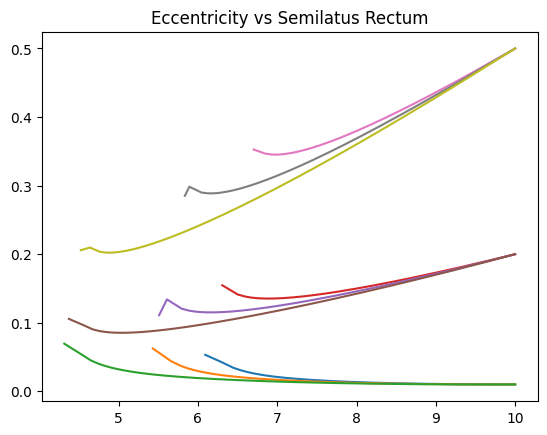

In [6]:
simflat = [sim for simsub in sim_stuff for sim in simsub]
op.plotvalue3(simflat, "semi_lat", "ecc", linefit=False)

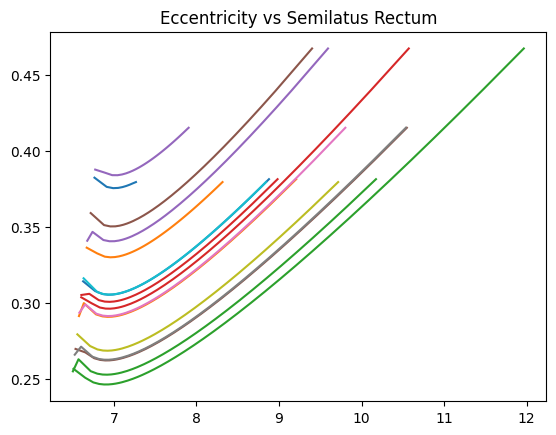

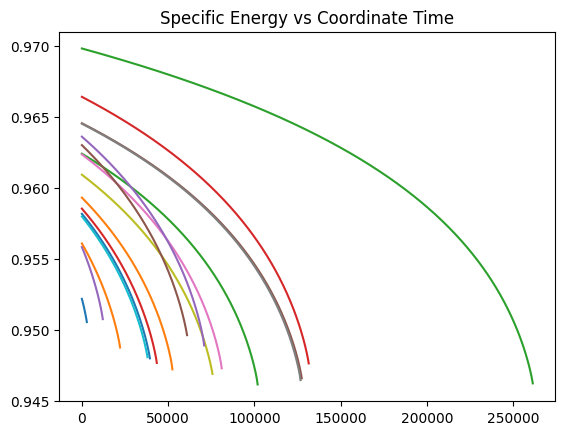

In [11]:
#rand_sim = [[ml.EMRIGenerator(0.0, 1e-3, endflag="radius < 2", params=[p/(1 - e**2), e, 0.5*np.pi], bonk=3, label="wink p=%s, e=%s"%(p, e), trigger=2, err_target=1e-14, conch=100) for p in np.random.uniform(7, 12, 4)] for e in np.random.uniform(0.1, 0.5, 4)]
randflat = [sim for simsub in rand_sim for sim in simsub]
op.plotvalue3(randflat, "semi_lat", "ecc", linefit=False)
op.plotvalue3(randflat, "tracktime", "energy", linefit=False)

In [7]:
vast_sim = [[ml.EMRIGenerator(0.0, 1e-3, endflag="radius < 2", params=[p/(1 - e**2), e, 0.5*np.pi], bonk=3, label="wink p=%s, e=%s"%(p, e), trigger=2, err_target=1e-14, conch=100) for a in np.random.uniform(7, 12, 4)]
randflat = [sim for simsub in rand_sim for sim in simsub]
op.plotvalue3(randflat, "semi_lat", "ecc", linefit=False)
op.plotvalue3(randflat, "tracktime", "energy", linefit=False)

array([11.83459822, 10.15980596, 11.67771406])

In [18]:
np.arange(-1, 1.1, 0.1)

array([-1.00000000e+00, -9.00000000e-01, -8.00000000e-01, -7.00000000e-01,
       -6.00000000e-01, -5.00000000e-01, -4.00000000e-01, -3.00000000e-01,
       -2.00000000e-01, -1.00000000e-01, -2.22044605e-16,  1.00000000e-01,
        2.00000000e-01,  3.00000000e-01,  4.00000000e-01,  5.00000000e-01,
        6.00000000e-01,  7.00000000e-01,  8.00000000e-01,  9.00000000e-01,
        1.00000000e+00])

10003234.64787576it [00:11, 891841.09it/s, Semilat: 9.199, Ecc 0.069]                                
10000777.157874074it [00:17, 569555.59it/s, Semilat: 8.908, Ecc 0.068]                               
10001670.234511865it [00:26, 373076.63it/s, Semilat: 8.637, Ecc 0.074]                               
10001540.04786952it [00:38, 261547.68it/s, Semilat: 8.309, Ecc 0.065]                                
10000245.169803584it [00:51, 193517.91it/s, Semilat: 7.953, Ecc 0.047]                              
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MainLoopStreamline.py:725: ComplexWarning: Casting complex values to real discards the imaginary part
  "trackix": np.array([int(num) for num in tracker[:,6]]),
10000076.639417693it [01:08, 145462.95it/s, Semilat: 7.696, Ecc 0.062]                              
10000774.52054593it [01:25, 116556.01it/s, Semilat: 7.4, Ecc 0.065]                                 
10000262.830591809it [01:46, 94109.68it/s, Semilat: 7.108, E

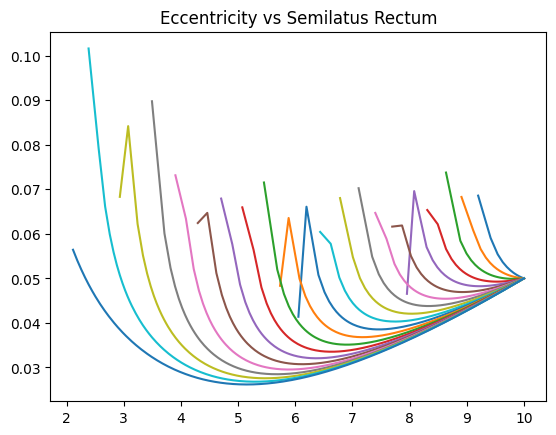

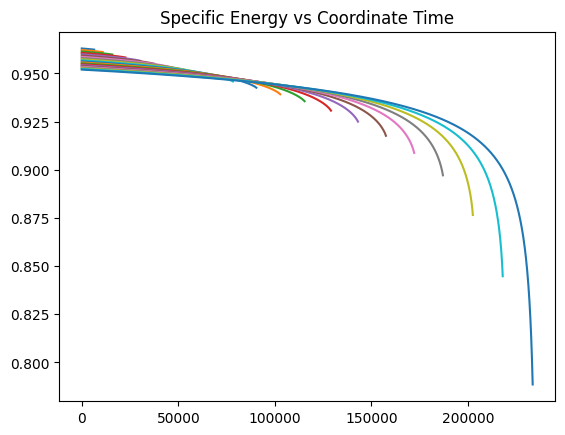

In [19]:
oof = [ml.EMRIGenerator(a, 1e-3, endflag="radius < 2", params=[10/(1 - 0.05**2), 0.05, 0.5*np.pi], bonk=3, label="wink a=%s"%(a), trigger=2, err_target=1e-14, conch=100) for a in np.arange(-1.0, 1.1, 0.1)]# for p in np.random.uniform(7, 12, 4)] for e in np.random.uniform(0.1, 0.5, 4)]
#randflat = [sim for simsub in rand_sim for sim in simsub]
op.plotvalue3(oof, "semi_lat", "ecc", linefit=False)
op.plotvalue3(oof, "tracktime", "energy", linefit=False)

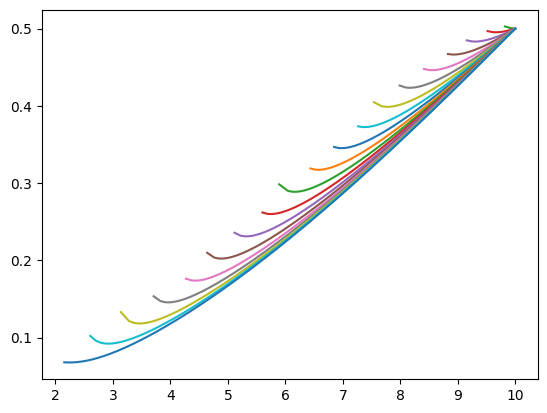

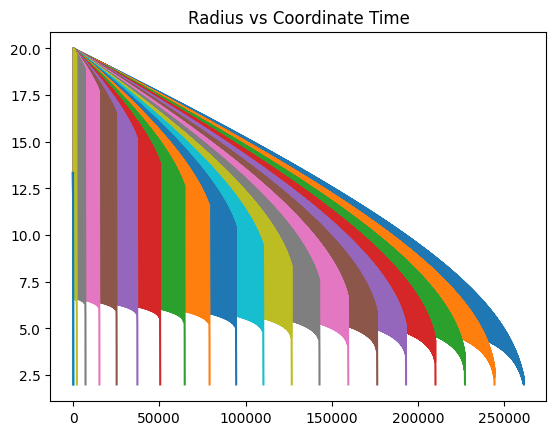

In [25]:
for sim in oof:
    plt.plot(sim["p"][:-1], sim["e"][:-1])
op.plotvalue3(oof[::-1], "time", "radius", linefit=False)

10002282.977861848it [00:01, 5413764.62it/s, Semilat: 10.078, Ecc 0.496]                               
10000073.570914496it [00:02, 4719873.41it/s, Semilat: 10.015, Ecc 0.499]                               
10000122.446217285it [00:08, 1208117.39it/s, Semilat: 9.757, Ecc 0.501]                             
10000898.999532579it [00:22, 443939.43it/s, Semilat: 9.421, Ecc 0.498]                                
10000525.713281201it [00:49, 204007.65it/s, Semilat: 9.061, Ecc 0.486]                              
10000556.99516654it [01:23, 119816.90it/s, Semilat: 8.693, Ecc 0.471]                                 
10000192.599584572it [01:58, 84484.93it/s, Semilat: 8.304, Ecc 0.449]                                
10000085.144831937it [02:45, 60605.88it/s, Semilat: 7.908, Ecc 0.425]                               
10000108.83808555it [03:55, 42424.79it/s, Semilat: 7.5, Ecc 0.397]                                   
10000032.276439698it [04:35, 36349.29it/s, Semilat: 7.116, Ecc 0.38]           

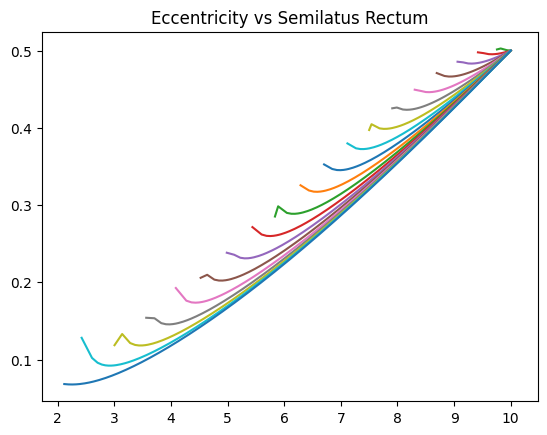

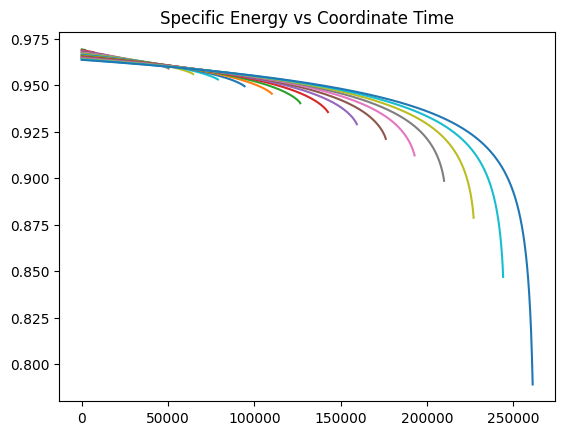

In [20]:
oof = [ml.EMRIGenerator(a, 1e-3, endflag="radius < 2", params=[10/(1 - 0.5**2), 0.5, 0.5*np.pi], bonk=3, label="wink a=%s"%(a), trigger=2, err_target=1e-14, conch=100) for a in np.arange(-1.0, 1.1, 0.1)]# for p in np.random.uniform(7, 12, 4)] for e in np.random.uniform(0.1, 0.5, 4)]
#randflat = [sim for simsub in rand_sim for sim in simsub]
op.plotvalue3(oof, "semi_lat", "ecc", linefit=False)
op.plotvalue3(oof, "tracktime", "energy", linefit=False)

 67%|██████▋   | 6715365.404045061/10000000 [15:03<24:29, 2234.80it/s, Semilat: 7.775, Ecc 0.107]    C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\matplotlib\cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\matplotlib\cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)
C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\numpy\ma\core.py:3413: ComplexWarning: Casting complex values to real discards the imaginary part
  _data[indx] = dval
C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\Lo

[5.22489898+2.9082908j 5.22489898-2.9082908j 1.47379548+0.j       ]
[5.22489898 5.22489898 1.47379548]
[ -0.50320401   6.         -25.74320736  26.51863642]
[1.47379548 1.47379548 1.47379548]
sta
1.4737954847445967 [1.47379548]
ROOTER
(array([0.04344912+0.j        , 3.57512624+0.j        ,
       6.13977461+4.47554877j, 6.13977461-4.47554877j]), array([1.47379548+0.j       , 5.22489898-2.9082908j,
       5.22489898+2.9082908j]), array([-80.3711055+0.j,  -0.9872378+0.j,   0.9872378+0.j,  80.3711055+0.j]))
(-13.4405501760367-30.954612127172286j) -1e-14 whoops

Ending program



10000354.012916435it [11:10, 14921.59it/s, Semilat: 7.089, Ecc 0.328]                               
10000122.929392703it [07:32, 22100.71it/s, Semilat: 7.492, Ecc 0.386]                                
10000135.822707089it [05:51, 28445.88it/s, Semilat: 7.768, Ecc 0.417]                                
10000304.095002297it [06:21, 26214.54it/s, Semilat: 7.901, Ecc 0.428]                               
10000154.421926837it [06:22, 26134.59it/s, Semilat: 7.901, Ecc 0.428]                               


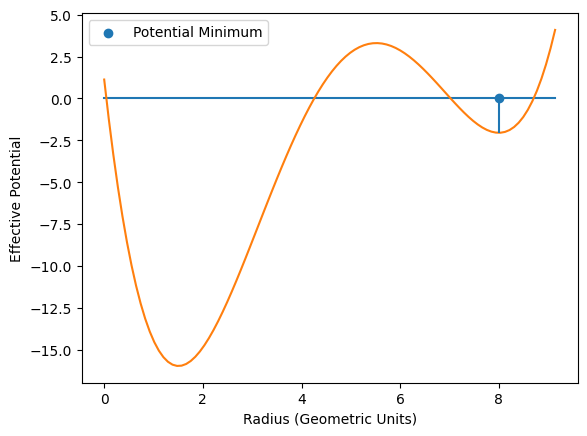

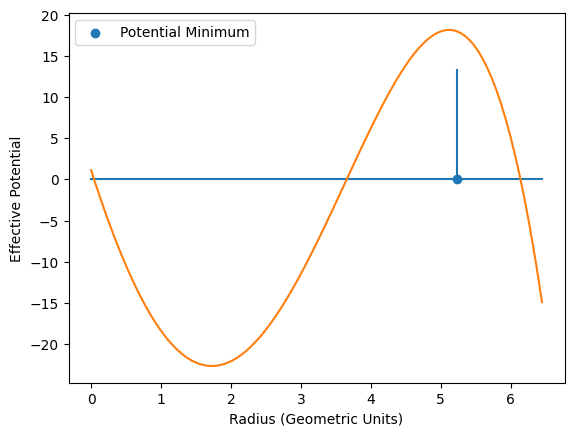

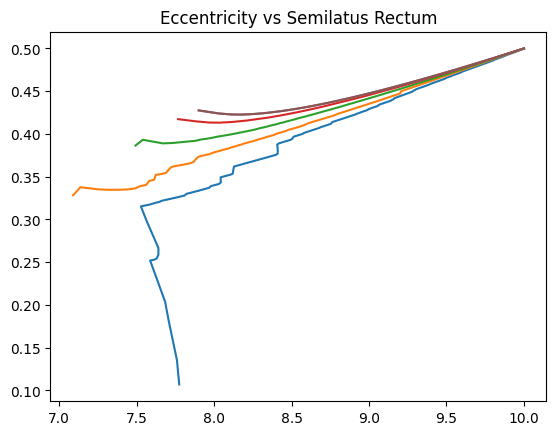

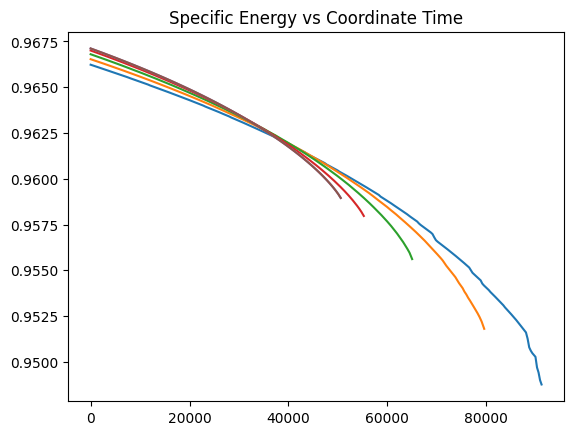

In [6]:
oof2 = [ml.EMRIGenerator(-0.3, 1e-3, endflag="radius < 2", params=[10/(1 - 0.5**2), 0.5, i*np.pi], bonk=3, label="wink i=%s*pi"%(i), trigger=2, err_target=1e-14, conch=100) for i in np.arange(0.05, 0.56, 0.1)]# for p in np.random.uniform(7, 12, 4)] for e in np.random.uniform(0.1, 0.5, 4)]
#randflat = [sim for simsub in rand_sim for sim in simsub]
op.plotvalue3(oof2, "semi_lat", "ecc", linefit=False)
op.plotvalue3(oof2, "tracktime", "energy", linefit=False)

In [1]:
10/(1+0.25)

8.0

In [5]:
mm.find_rmb(-0.3)
mm.find_rms(-0.3)

np.float64(6.949272527004718)

 11%|█         | 1107099.3848579277/10000000 [00:00<00:02, 3286845.88it/s, Semilat: 6.05, Ecc 0.003]C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\matplotlib\cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\matplotlib\cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)
C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\numpy\ma\core.py:3413: ComplexWarning: Casting complex values to real discards the imaginary part
  _data[indx] = dval
C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\Loc

[5.886337  +0.62707861j 5.886337  -0.62707861j 1.50592688+0.j        ]
[5.886337   5.886337   1.50592688]
[ -0.45185483   6.         -23.84482109  23.84482109]
[1.50592688 1.50592688 1.50592688]
sta
1.5059268773718848 [1.50592688]
ROOTER
(array([-4.44089210e-16+0.j        ,  5.38116068e+00+0.j        ,
        6.16182024e+00-1.12180023j,  6.16182024e+00+1.12180023j]), array([1.50592688+0.j        , 5.886337  -0.62707861j,
       5.886337  +0.62707861j]), array([-90.949408+0.j,   0.      +0.j,   0.      +0.j,  90.949408+0.j]))
(-0.43075061080912863-0.3253781737162092j) -1e-14 whoops

Ending program


 12%|█▏        | 1199466.1652901524/10000000 [00:00<00:06, 1437578.52it/s, Semilat: 7.468, Ecc 0.106]c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MetricMathStreamline.py:2289: RuntimeWarning: invalid value encountered in scalar divide
  p6 = (-(b**3)/(a**3) + (4*b*c)/(a**2) - 8*d/a)/(4*p4)
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MetricMathStreamline.py:2201: RuntimeWarning: invalid value encountered in scalar power
  Xt = integrate.quad(lambda x: 1/(J2(x)**0.5), 0.0, np.pi)[0]
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MetricMathStreamline.py:2201: IntegrationWarning: The occurrence of roundoff error is detected, which prevents 
  the requested tolerance from being achieved.  The error may be 
  underestimated.
  Xt = integrate.quad(lambda x: 1/(J2(x)**0.5), 0.0, np.pi)[0]
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MetricMathStreamline.py:2202: RuntimeWarning: invalid value encountered 


Ending program



c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MainLoopStreamline.py:725: ComplexWarning: Casting complex values to real discards the imaginary part
  "trackix": np.array([int(num) for num in tracker[:,6]]),
  6%|▌         | 612818.443106692/10000000 [00:02<00:39, 236354.21it/s, Semilat: 5.756, Ecc 0.243]   
  6%|▌         | 604120.9915327535/10000000 [00:02<00:41, 226501.36it/s, Semilat: 5.979, Ecc 0.314]  
  6%|▋         | 626939.208915703/10000000 [00:02<00:42, 222930.81it/s, Semilat: 6.099, Ecc 0.401]   
  7%|▋         | 658638.2986045833/10000000 [00:02<00:37, 249492.76it/s, Semilat: 6.204, Ecc 0.494] 
  7%|▋         | 695869.3315308067/10000000 [00:02<00:35, 259942.81it/s, Semilat: 6.308, Ecc 0.591] 
  7%|▋         | 738744.5729124019/10000000 [00:02<00:36, 252280.72it/s, Semilat: 6.415, Ecc 0.69] 
  8%|▊         | 789605.7087302841/10000000 [00:02<00:32, 280316.12it/s, Semilat: 6.527, Ecc 0.794] 
 65%|██████▌   | 6503183.151914983/10000000 [00:04<00:02, 143

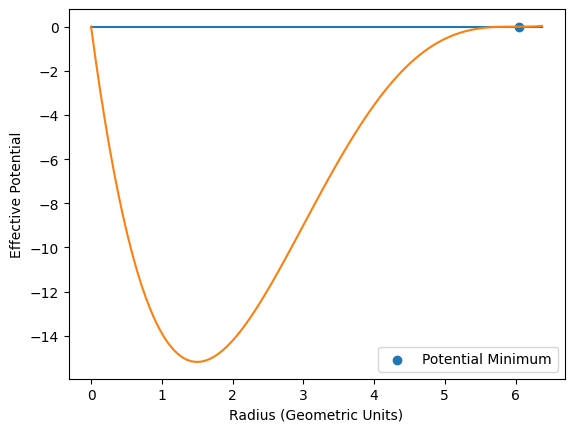

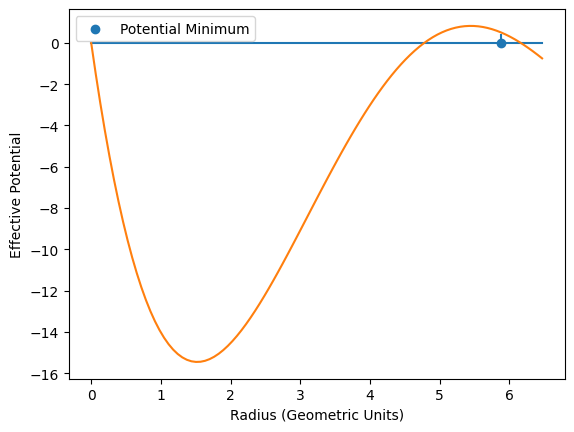

In [2]:
#oof3 = [[ml.EMRIGenerator(0.0, 1e-3, endflag="rad_orbit > 10", params=[p/(1 - e**2), e, 0.5*np.pi], bonk=3, label="wink p=%s, e=%s"%(p, e), trigger=2, err_target=1e-14, conch=100) for p in np.arange(6.01, 10.01, 0.5)] for e in np.arange(0.01, 1.1, 0.1)]
#oof_flat = [sim for simsub in oof3 for sim in simsub]
oof_flat = []
for p in np.arange(6.01, 10.02, 0.5):
    for e in np.arange(0.01, 0.9, 0.1):
        try:
            sim = ml.EMRIGenerator(0.0, 1e-3, endflag="rad_orbit > 5", params=[p/(1 - e**2), e, 0.5*np.pi], bonk=3, label="wink p=%s, e=%s"%(p, e), trigger=2, err_target=1e-14, conch=100)
        except:
            sim = {"stop": True}
        if sim["stop"] == False:
            oof_flat.append(sim)
#op.plotvalue3(oof2, "semi_lat", "ecc", linefit=False)
#op.plotvalue3(oof2, "tracktime", "energy", linefit=False)

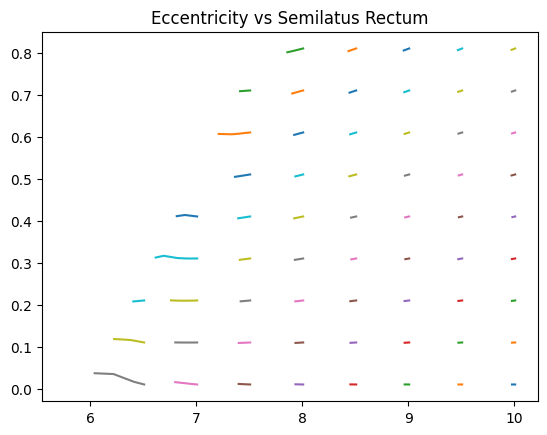

In [3]:
op.plotvalue3(oof_flat, "semi_lat", "ecc", linefit=False)

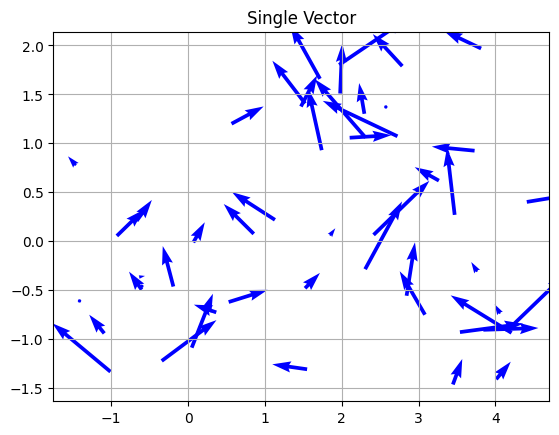

In [14]:
# Vector origin location 
X = np.random.uniform(-1.5, 4.5, 50)
Y = np.random.uniform(-1.5, 2, 50)
  
# Directional vectors 
R = np.random.uniform(0, 1, 50)
PHI = np.random.uniform(0, np.pi, 50)
U = R*np.cos(PHI)   
V = R*np.sin(PHI)     
  
# Creating plot 
plt.quiver(X, Y, U, V, color='b', units='xy', scale=1) 
plt.title('Single Vector') 
  
# x-lim and y-lim 
#plt.xlim(-2, 5) 
#plt.ylim(-2, 2.5) 
  
# Show plot with grid 
plt.grid() 
plt.show() 

 29%|██▊       | 2853521.9646761147/10000000 [00:09<00:23, 304353.01it/s, Semilat: 7.785, Ecc 0.893]
10000787.817766033it [00:10, 944751.44it/s, Semilat: 7.53, Ecc 0.502]                                
  7%|▋         | 696142.9235558929/10000000 [00:03<00:43, 211689.69it/s, Semilat: 6.325, Ecc 0.591] 
10000945.492098058it [00:10, 912817.38it/s, Semilat: 7.502, Ecc 0.516]                               
 26%|██▋       | 2627565.238205952/10000000 [00:05<00:16, 454565.74it/s, Semilat: 6.776, Ecc 0.39]  
10000046.778822826it [00:05, 1734497.04it/s, Semilat: 7.365, Ecc 0.139]                             
10001056.422433414it [00:07, 1276864.23it/s, Semilat: 6.597, Ecc 0.229]                              
  6%|▌         | 561389.0020843386/10000000 [00:03<00:57, 165409.39it/s, Semilat: 6.336, Ecc 0.183]  
  7%|▋         | 714110.0343449516/10000000 [00:03<00:44, 208948.29it/s, Semilat: 7.055, Ecc 0.625] 
10003525.092063516it [00:03, 3334392.03it/s, Semilat: 7.264, Ecc 0.025]                

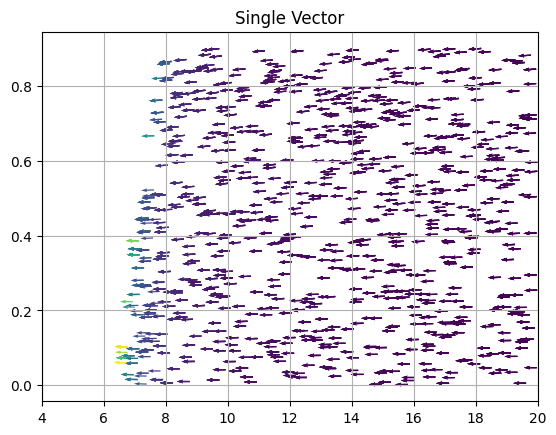

In [11]:
#oof3 = [[ml.EMRIGenerator(0.0, 1e-3, endflag="rad_orbit > 10", params=[p/(1 - e**2), e, 0.5*np.pi], bonk=3, label="wink p=%s, e=%s"%(p, e), trigger=2, err_target=1e-14, conch=100) for p in np.arange(6.01, 10.01, 0.5)] for e in np.arange(0.01, 1.1, 0.1)]
#oof_flat = [sim for simsub in oof3 for sim in simsub]
#oof_flat2 = []
#circE = lambda a, r: (1 - (2/r) + a/(r**(3/2)))/np.sqrt(1 - 3/r + 2*a/(r**(3/2)))
#circL = lambda a, r: (np.sqrt(r) - (2*a/r) + (a**2)/(r**(3/2)))/np.sqrt(1 - 3/r + 2*a/(r**(3/2)))
num = 0
while num < 20:
    p = np.random.uniform(6, 8)
    e = np.random.uniform(0, 0.9)
    if p/(1 - e**2) > 6:
        try:
            sim = ml.EMRIGenerator(0.0, 1e-3, endflag="rad_orbit > 5", params=[p/(1 - e**2), e, 0.5*np.pi], bonk=3, label="wink p=%s, e=%s"%(p, e), trigger=2, err_target=1e-14, conch=100)
        except:
            sim = {"stop": True, "plunge":True}
        if sim["stop"] == False and sim["plunge"] == False:
            oof_flat2.append(sim)
            num += 1
#pl, el, dpl, de_l = [],[],[],[]
for sim in oof_flat2:
    pl.append(sim["p"][0])
    el.append(sim["e"][0])
    dpl.append(sim["p"][-1] - sim["p"][0])
    de_l.append(sim["e"][-1] - sim["e"][0])

dpl2 = np.array(dpl)/np.sqrt(np.array(dpl)**2 + np.array(de_l)**2)
de_l2 = np.array(de_l)/np.sqrt(np.array(dpl)**2 + np.array(de_l)**2)
ramp = np.hypot(dpl, de_l)
#'''
# Creating plot 
plt.quiver(pl, el, dpl2, de_l2, ramp, units='xy', scale=3) 
#plt.scatter(pl, el)
plt.title('Single Vector') 
  
# x-lim and y-lim 
plt.xlim(4, 20) 
#plt.ylim(-2, 2.5) 
  
# Show plot with grid 
plt.grid() 
plt.show() 

#op.plotvalue3(oof2, "semi_lat", "ecc", linefit=False)
#op.plotvalue3(oof2, "tracktime", "energy", linefit=False)

 12%|█▏        | 1212564.3222243486/10000000 [00:00<00:03, 2572086.71it/s, Semilat: 6.062, Ecc 0.0]C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\matplotlib\cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\matplotlib\cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)
C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\numpy\ma\core.py:3413: ComplexWarning: Casting complex values to real discards the imaginary part
  _data[indx] = dval
C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\Loca

[5.99665333+0.15802232j 5.99665333-0.15802232j 1.49989783+0.j        ]
[5.99665333 5.99665333 1.49989783]
[ -0.44466828   6.         -24.00032859  24.00032859]
[1.49989783 1.49989783 1.49989783]
sta
1.499897833464157 [1.49989783]
ROOTER
(array([-1.25077726e-11+4.20252722e-12j,  5.54966372e+00-2.49184229e-10j,
        6.22063781e+00+4.53743598e-01j,  6.22063781e+00-4.53743597e-01j]), array([1.49989783+0.j        , 5.99665333-0.15802232j,
       5.99665333+0.15802232j]), array([-9.34661211e+01+0.j, -1.12270754e-07+0.j,  1.12270754e-07+0.j,
        9.34661211e+01+0.j]))
(-0.07622833913478334-0.005260166531345614j) -1e-14 whoops

Ending program


10002687.178147987it [00:02, 4911660.75it/s, Semilat: 16.0, Ecc 0.01]                              
10001248.803676989it [00:02, 4253404.83it/s, Semilat: 26.0, Ecc 0.01]                              
10003938.017869845it [00:02, 4228270.28it/s, Semilat: 36.0, Ecc 0.01]                              
10003114.376869045it [00:02, 3839292.09it/s, Semilat: 46.0, Ecc 0.01]                              
10000966.360246293it [00:02, 4412567.95it/s, Semilat: 56.0, Ecc 0.01]                              
10004889.563639496it [00:02, 3842571.92it/s, Semilat: 66.0, Ecc 0.01]                              
10002043.32166267it [00:02, 3946432.77it/s, Semilat: 76.0, Ecc 0.01]                               
10005022.15595751it [00:02, 3993408.71it/s, Semilat: 86.0, Ecc 0.01]                               
10005791.052010965it [00:02, 3820386.65it/s, Semilat: 96.0, Ecc 0.01]                              
 14%|█▍        | 1410789.183123421/10000000 [00:01<00:05, 1598943.82it/s, Semilat: 7.505, Ecc 0.113]


Ending program


10002167.13972782it [00:04, 2258176.37it/s, Semilat: 16.0, Ecc 0.11]                               
10001108.664792508it [00:03, 2673791.35it/s, Semilat: 26.0, Ecc 0.11]                              
10004103.861844834it [00:03, 2684011.54it/s, Semilat: 36.0, Ecc 0.11]                              
10002369.963507954it [00:03, 2636734.53it/s, Semilat: 46.0, Ecc 0.11]                              
10001708.66043263it [00:03, 2610769.63it/s, Semilat: 56.0, Ecc 0.11]                               
10004133.849274311it [00:04, 2471500.61it/s, Semilat: 66.0, Ecc 0.11]                              
10003190.042511588it [00:04, 2345390.71it/s, Semilat: 76.0, Ecc 0.11]                              
10003167.832016757it [00:04, 2481250.57it/s, Semilat: 86.0, Ecc 0.11]                              
10002836.846309679it [00:04, 2343697.21it/s, Semilat: 96.0, Ecc 0.11]                              
  6%|▌         | 613841.1599233921/10000000 [00:02<00:42, 218950.62it/s, Semilat: 5.74, Ecc 0.244]  

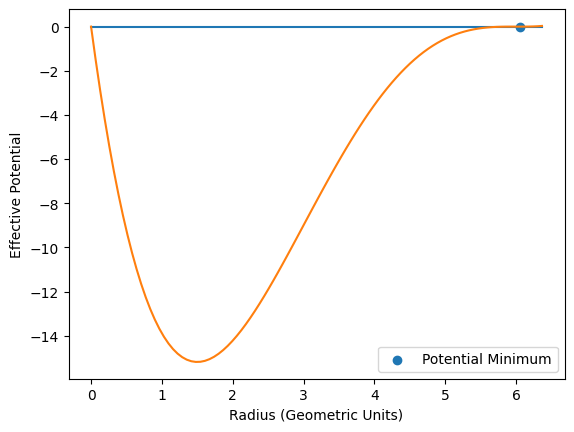

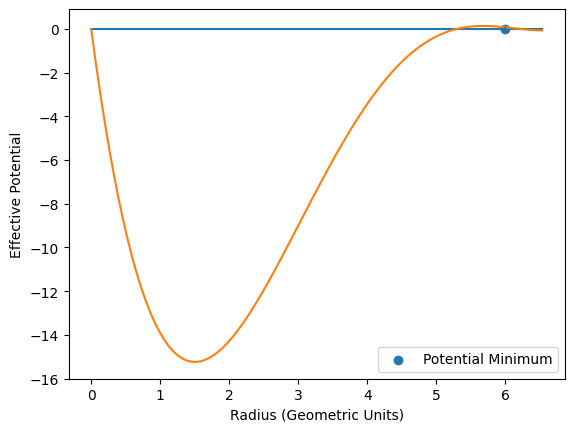

In [78]:
import matplotlib.cm as cm

p_list = np.arange(6, 100, 10)
e_list = np.arange(0.01, 0.9, 0.1)
X, Y = np.meshgrid(p_list, e_list)
Zx = []
Zy = []
for e in e_list:
    sub_Zx = []
    sub_Zy = []
    for p in p_list:
        try:
            sim = ml.EMRIGenerator(0.0, 1e-5, endflag="rad_orbit > 5", params=[p/(1 - e**2), e, 0.5*np.pi], bonk=3, label="wink p=%s, e=%s"%(p, e), trigger=2, err_target=1e-14, conch=100)
        except:
            sim = {"stop": True, "plunge":True}
        if sim["plunge"] == True or sim["stop"] == True:
            sub_Zx.append(np.nan)
            sub_Zy.append(np.nan)
        else:
            sub_Zx.append((sim["p"][-1] - sim["p"][0]))
            sub_Zy.append((sim["e"][-1] - sim["e"][0]))
    Zx.append(sub_Zx)
    Zy.append(sub_Zy)
Zx = np.array(Zx)
Zy = np.array(Zy)
Z_mag = np.hypot(Zx, Zy)


nan


Text(0.5, 1.0, 'Simplest default with labels')

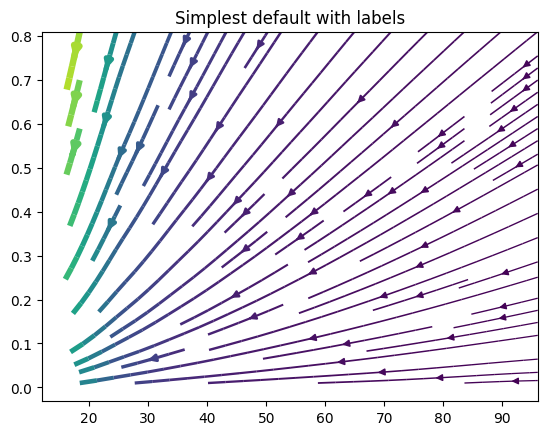

In [ ]:
fig, ax = plt.subplots()
lw = 5*np.sqrt(Z_mag/np.nanmax(Z_mag))
strm = ax.streamplot(X, Y, Zx, Zy, linewidth=lw, color=Z_mag)
ax.set_title('Simplest default with labels')

In [97]:
def streamy(a):
    p_list = np.arange(6, 100, 10)
    e_list = np.arange(0.01, 0.9, 0.1)
    X, Y = np.meshgrid(p_list, e_list)
    Zx = []
    Zy = []
    for e in e_list:
        sub_Zx = []
        sub_Zy = []
        for p in p_list:
            try:
                sim = ml.EMRIGenerator(a, 1e-5, endflag="rad_orbit > 5", params=[p/(1 - e**2), e, 0.5*np.pi], bonk=3, label="wink p=%s, e=%s"%(p, e), trigger=2, err_target=1e-14, conch=100)
            except:
                sim = {"stop": True, "plunge":True}
            if sim["plunge"] == True or sim["stop"] == True:
                sub_Zx.append(np.nan)
                sub_Zy.append(np.nan)
            else:
                sub_Zx.append((sim["p"][-1] - sim["p"][0]))
                sub_Zy.append((sim["e"][-1] - sim["e"][0]))
        Zx.append(sub_Zx)
        Zy.append(sub_Zy)
    Zx = np.array(Zx)
    Zy = np.array(Zy)
    Z_mag = np.hypot(Zx, Zy)
    fig, ax = plt.subplots()
    lw = 5*np.sqrt(Z_mag/np.nanmax(Z_mag))
    strm = ax.streamplot(X, Y, Zx, Zy, linewidth=lw, color=Z_mag)
    ax.set_title('EMRI Observable Evolution, Spin=%s'%(a))
    ax.set_xlabel("Semilatus Rectum")
    ax.set_ylabel("Eccentricity")
    plt.show()
    return (Zx, Zy)

#stuff = []
#for spin in [-0.9, -0.3, 0.0, 0.3, 0.9]:
    #stuff.append(streamy(spin))

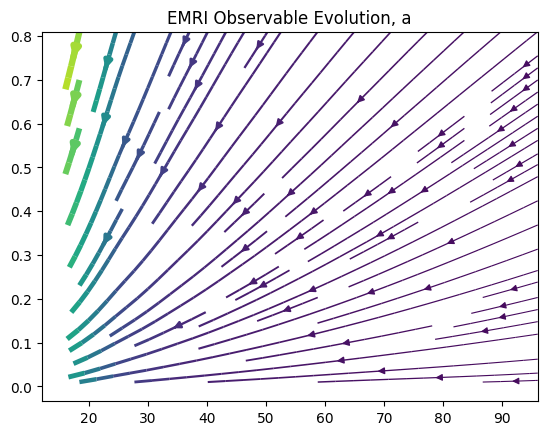

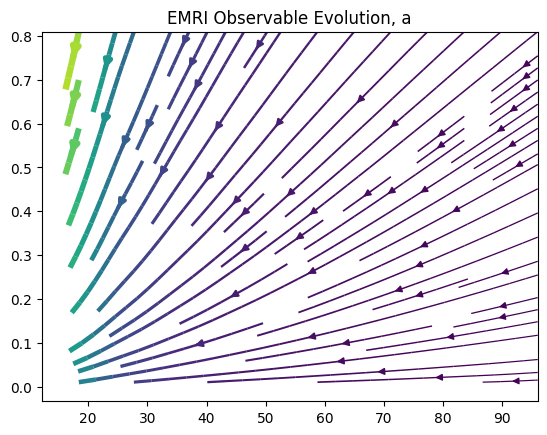

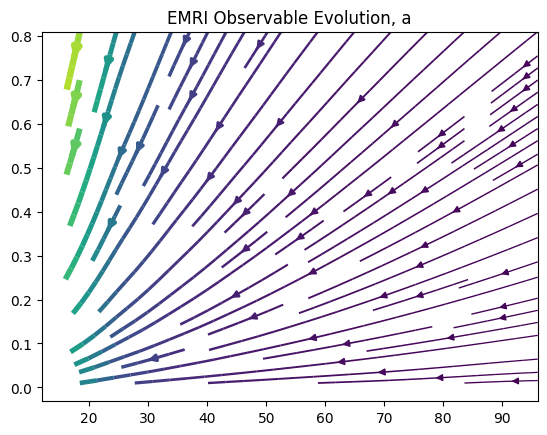

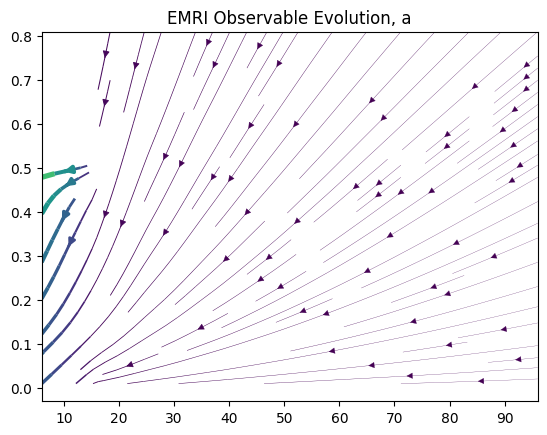

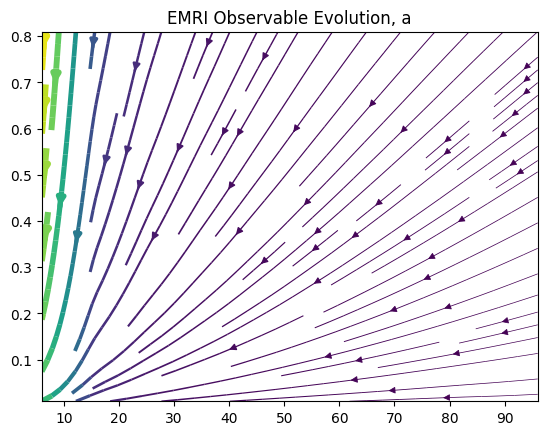

[np.float64(0.00019626742801498483), np.float64(0.00015119538021497885), np.float64(0.00013634000133244835), np.float64(0.004930970289764474), np.float64(0.0004775112203459813)]


10003648.863276457it [00:02, 4479084.11it/s, Semilat: 5.998, Ecc 0.01]                              
10001192.523334986it [00:02, 4632353.09it/s, Semilat: 16.0, Ecc 0.01]                              
10004401.47075113it [00:02, 4410466.13it/s, Semilat: 26.0, Ecc 0.01]                               
10000279.171283046it [00:02, 4019840.24it/s, Semilat: 36.0, Ecc 0.01]                              
10006726.03309413it [00:02, 4170780.78it/s, Semilat: 46.0, Ecc 0.01]                               
10006119.226784969it [00:02, 4258723.44it/s, Semilat: 56.0, Ecc 0.01]                              
10002935.513889413it [00:02, 3805463.79it/s, Semilat: 66.0, Ecc 0.01]                              
10004529.018827017it [00:02, 3576650.18it/s, Semilat: 76.0, Ecc 0.01]                              
10006739.76372007it [00:02, 3520437.33it/s, Semilat: 86.0, Ecc 0.01]                               
10005272.373511922it [00:02, 3502520.40it/s, Semilat: 96.0, Ecc 0.01]                              

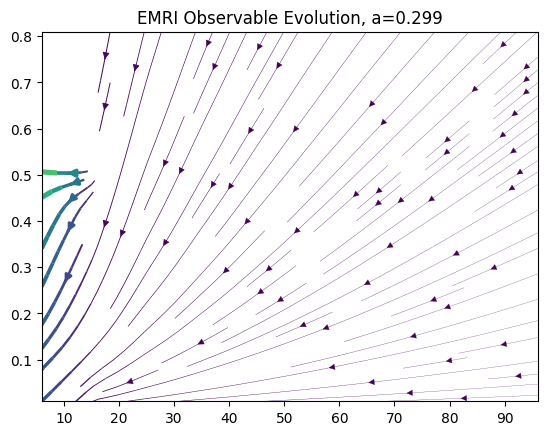

(array([[-1.61112031e-03, -8.47830834e-05, -3.59088089e-05,
         -2.09350161e-05, -1.41115692e-05, -1.03261071e-05,
         -7.97376225e-06, -6.39878138e-06, -5.28193642e-06,
         -4.45520951e-06],
        [-1.65584039e-03, -8.56190249e-05, -3.62993484e-05,
         -2.11752005e-05, -1.42646419e-05, -1.04411524e-05,
         -8.06485293e-06, -6.47086978e-06, -5.34286804e-06,
         -4.50577082e-06],
        [-1.78592133e-03, -8.76987119e-05, -3.72469421e-05,
         -2.17477183e-05, -1.46570045e-05, -1.07296561e-05,
         -8.29031282e-06, -6.65182425e-06, -5.49196554e-06,
         -4.63152946e-06],
        [-2.06135085e-03, -9.09618744e-05, -3.87744802e-05,
         -2.26690389e-05, -1.52874388e-05, -1.11942156e-05,
         -8.65062384e-06, -6.94345002e-06, -5.73137757e-06,
         -4.83419885e-06],
        [-2.69743470e-03, -9.53998533e-05, -4.08538034e-05,
         -2.39277458e-05, -1.61500784e-05, -1.18324571e-05,
         -9.14664817e-06, -7.34246369e-06, -6.061707

In [95]:
for thing in stuff:
    Zx, Zy = thing
    Z_mag = np.hypot(Zx, Zy)
    fig, ax = plt.subplots()
    lw = 5*np.sqrt(Z_mag/np.nanmax(Z_mag))
    strm = ax.streamplot(X, Y, Zx, Zy, linewidth=lw, color=Z_mag)
    ax.set_title('EMRI Observable Evolution, a')
    plt.show()

print([np.nanmax(np.hypot(*thing)) for thing in stuff])
streamy(0.299)

  0%|          | 1564/10000000 [00:04<8:06:25, 342.58it/s, Semilat: 11.14, Ecc 0.838]
10004834.51902016it [00:02, 3449782.58it/s, Semilat: 16.0, Ecc 0.01]                               
10005967.936835194it [00:02, 3476879.87it/s, Semilat: 26.0, Ecc 0.01]                              
10003181.355503872it [00:03, 3049312.46it/s, Semilat: 36.0, Ecc 0.01]                              
10001336.27571056it [00:03, 3209148.27it/s, Semilat: 46.0, Ecc 0.01]                               
10001155.401392844it [00:03, 3219800.50it/s, Semilat: 56.0, Ecc 0.01]                              
10002421.181156054it [00:03, 3107982.74it/s, Semilat: 66.0, Ecc 0.01]                              
10004125.356251843it [00:03, 3050549.36it/s, Semilat: 76.0, Ecc 0.01]                              
10005884.820621148it [00:03, 3097680.76it/s, Semilat: 86.0, Ecc 0.01]                              
10005334.86800236it [00:03, 2978504.73it/s, Semilat: 96.0, Ecc 0.01]                               
c:\Users\camci

Don't trust this! [1.0, -0.9, 1e-05, 'rad_orbit > 5', 1e-14, 'wink p=6, e=0.11', False, False, False, [np.float64(6.0734892195566355), np.float64(0.11), 1.5707963267948966], False, 'grav']


  6%|▌         | 564136.8200667182/10000000 [00:01<00:29, 320026.28it/s, Semilat: 4.584, Ecc 0.32]
10003714.943132222it [00:04, 2066388.18it/s, Semilat: 16.0, Ecc 0.11]                              
10000895.038082773it [00:04, 2228229.59it/s, Semilat: 26.0, Ecc 0.11]                              
10000064.809947636it [00:04, 2111065.59it/s, Semilat: 36.0, Ecc 0.11]                              
10001000.00700709it [00:04, 2140504.00it/s, Semilat: 46.0, Ecc 0.11]                               
10003108.411576131it [00:04, 2129170.93it/s, Semilat: 56.0, Ecc 0.11]                              
10004744.497828342it [00:04, 2075241.10it/s, Semilat: 66.0, Ecc 0.11]                              
10001529.602491923it [00:05, 1984217.70it/s, Semilat: 76.0, Ecc 0.11]                              
10001663.904227978it [00:04, 2007227.11it/s, Semilat: 86.0, Ecc 0.11]                              
10002733.001873013it [00:05, 1941978.66it/s, Semilat: 96.0, Ecc 0.11]                              
 

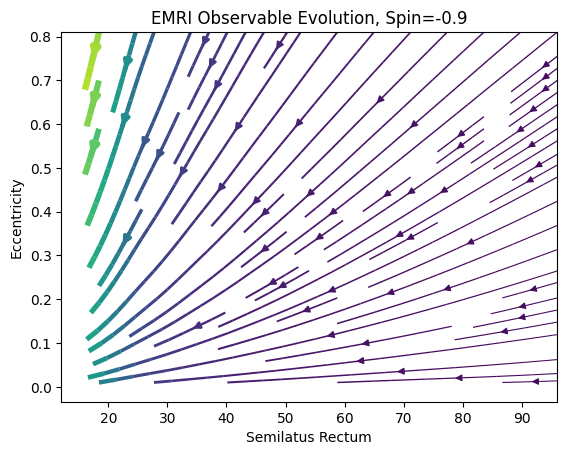

10006180.027251568it [00:02, 3753377.15it/s, Semilat: 6.0, Ecc 0.01]                              
10001774.107478173it [00:02, 3615755.93it/s, Semilat: 16.0, Ecc 0.01]                              
10003165.742192289it [00:02, 3503119.69it/s, Semilat: 26.0, Ecc 0.01]                              
10006173.40592154it [00:02, 3338176.46it/s, Semilat: 36.0, Ecc 0.01]                               
10005843.68720364it [00:03, 3308289.94it/s, Semilat: 46.0, Ecc 0.01]                               
10000461.974460853it [00:03, 3237875.53it/s, Semilat: 56.0, Ecc 0.01]                              
10001758.045370955it [00:03, 2986094.67it/s, Semilat: 66.0, Ecc 0.01]                              
10005168.390445458it [00:03, 3050903.78it/s, Semilat: 76.0, Ecc 0.01]                              
10004616.02440265it [00:03, 2782112.22it/s, Semilat: 86.0, Ecc 0.01]                               
10005055.729061466it [00:03, 2907864.95it/s, Semilat: 96.0, Ecc 0.01]                              
1

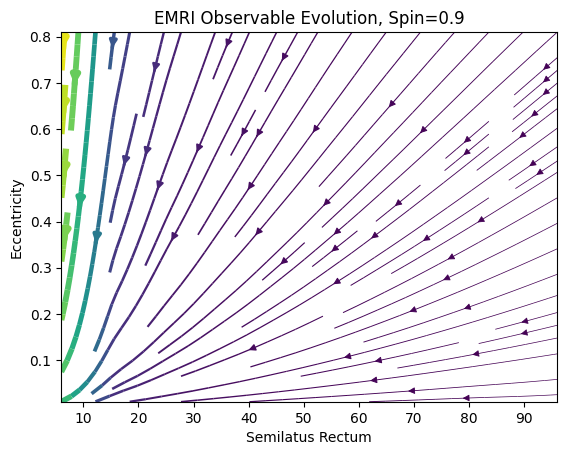

(array([[-3.79186273e-04, -7.28989028e-05, -3.35788534e-05,
         -2.01289199e-05, -1.37318945e-05, -1.01151079e-05,
         -7.84895751e-06, -6.31888777e-06, -5.22426939e-06,
         -4.41689566e-06],
        [-3.81069486e-04, -7.36142387e-05, -3.39377168e-05,
         -2.03430635e-05, -1.38842617e-05, -1.02329021e-05,
         -7.93963726e-06, -6.38998077e-06, -5.28696408e-06,
         -4.46502794e-06],
        [-3.86703046e-04, -7.54185178e-05, -3.48255658e-05,
         -2.08927341e-05, -1.42627332e-05, -1.05162143e-05,
         -8.16045797e-06, -6.56816036e-06, -5.43341191e-06,
         -4.58955239e-06],
        [-3.94743832e-04, -7.82097863e-05, -3.62458184e-05,
         -2.17737529e-05, -1.48743564e-05, -1.09690438e-05,
         -8.51577362e-06, -6.85458770e-06, -5.67107386e-06,
         -4.79218387e-06],
        [-4.05467072e-04, -8.20371197e-05, -3.81842328e-05,
         -2.29763170e-05, -1.57073998e-05, -1.15920777e-05,
         -8.99950257e-06, -7.24580798e-06, -5.998187

In [98]:
streamy(-0.9)
streamy(0.9)

In [106]:
mm.find_rms(0)

np.float64(6.0)

In [115]:
sim = ml.EMRIGenerator(0.73, 1e-7, endflag="rad_orbit > 5", cons=[0.955645, -0.36155, 13], bonk=3, label="wink WTF", trigger=2, err_target=1e-14, conch=100)

10001107.549808783it [01:40, 99077.92it/s, Semilat: 6.861, Ecc 0.497]                               


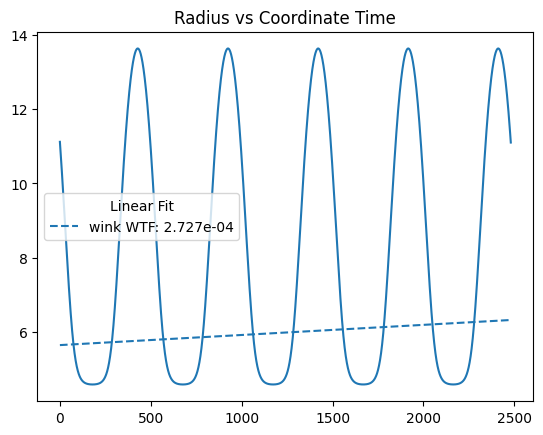

In [116]:
op.plotvalue3(sim, "time", "radius")

In [145]:
import scipy as sp

Yfunc = lambda r, a, C: r**5 - C*(r - 3)*(r**3) + (a*C)**2

#print(Yfunc(20, 0.54, 13.7))
circE2 = lambda r, a, C: ((r**3)*(r - 2) - a*(a*C - (Yfunc(r, a, C))**0.5))/((r**2)*np.sqrt((r**3)*(r - 3) - 2*a*(a*C - (Yfunc(r, a, C))**0.5)))
#print(circE2(20, 0.54, 13.7))
testfunc = lambda r, a, C, z: circE2(r, a, C) - z
testfunc2 = lambda r, a, C, z: circL2(r, a, C) - z
circL2 = lambda r, a, C: -(2*a*(r**3) + (r**2 + a**2)*(a*C - (Yfunc(r, a, C))**0.5))/((r**2)*np.sqrt((r**3)*(r - 3) - 2*a*(a*C - (Yfunc(r, a, C))**0.5)))

o = 10
circE3 = lambda r, a, C: ((r**3/o)*(r**1/o - 2) - a*(a*C - (Yfunc(r**1/o, a, C))**0.5))/((r**2/o)*np.sqrt((r**3/o)*(r**1/o - 3) - 2*a*(a*C - (Yfunc(r**1/o, a, C))**0.5)))
testfunc3 = lambda r, a, C, z: circE3(r, a, C) - z


a_val, C_val, want_E = 1, 12.6, 0.954
ytest = sp.optimize.fsolve(Yfunc, [mm.find_rms(a_val), C_val], args=(a_val, C_val))

ytest2 = np.roots([1, -C_val, 3*C_val, 0, 0, (a_val*C_val)**2])
guess = [mm.find_rms(a_val), mm.find_rms(a_val) + a_val , C_val] if (len(ytest2) > 2 and circE2(ytest2[1], a_val, C_val) < 0) else [mm.find_rmb(a_val), C_val]
etest = sp.optimize.fsolve(testfunc, guess, args=(a_val, C_val, want_E))
etest2 = sp.optimize.fsolve(testfunc, np.real(ytest2[1])*0.9, args=(a_val, C_val, want_E))
etest3 = sp.optimize.fsolve(testfunc, np.real(ytest2[1])*1.001, args=(a_val, C_val, want_E))
etest4 = sp.optimize.fsolve(testfunc, np.real(ytest2[1])*np.array([0.9, 0.99]), args=(a_val, C_val, want_E))
ltest = sp.optimize.fsolve(testfunc2, np.real(ytest2[1])*0.9, args=(a_val, C_val, 0))
etest5 = sp.optimize.fsolve(testfunc, (np.real(ytest2[1])*1.0)**o, args=(a_val, C_val, want_E))
#print(ytest)
#print(np.isclose(*ytest), Yfunc(ytest[1]+1, a_val, C_val))
#print(guess)
print(ytest2)
print(etest, "yo")
print(etest2, "yoyo")
print(etest3, "yoyoyo")
print(etest4, "yoyoyoyo")
print(etest5, etest5**(1/o), "yoyoyoyoyo")
print(ltest, "uh")
print(circE2(ltest[0], a_val, C_val), "oof")
#print(ytest2)
#print(ytest2[:2]*np.array([1.1, 0.9]))
print(sp.optimize.fmin(circE2, mm.find_rms(a_val), args=(a_val, C_val)))
#print(sp.optimize.fmin(circE2, np.real(ytest2[1]), args=(a_val, C_val)))
#r_s = sp.optimize.fsolve(circL2, np.real(ytest2[:2])*np.array([1.1, 0.9]), args=(a_val, C_val))
#print(sp.optimize.fsolve(circL2, np.real(ytest2[:2])*np.array([1.1, 0.9]), args=(a_val, C_val)))
#Em, Ex = circE2(r_s, a_val, C_val)
#print(Em, Ex)
#ltest = sp.optimize.fsolve(testfunc2, C_val, args=(a_val, C_val, 0.5), full_output=True)
#print(ltest)

[ 7.53227288+0.j          5.37005046+0.j          0.55048508+1.57922085j
  0.55048508-1.57922085j -1.40329349+0.j        ]
[ 1.  12.6] yo
[4.178412] yoyo
[5.37542051] yoyoyo
[4.83304541 5.31634995] yoyoyoyo
[19942686.56113984] [5.37005046] yoyoyoyoyo
[3.85485] uh
0.9589266397919726 oof
Optimization terminated successfully.
         Current function value: 0.949960
         Iterations: 21
         Function evaluations: 42
[4.92519531]


C:\Users\camcinto\AppData\Local\Temp\1\ipykernel_17460\2027954645.py:6: RuntimeWarning: invalid value encountered in divide
  circE2 = lambda r, a, C: ((r**3)*(r - 2) - a*(a*C - (Yfunc(r, a, C))**0.5))/((r**2)*np.sqrt((r**3)*(r - 3) - 2*a*(a*C - (Yfunc(r, a, C))**0.5)))
C:\Users\camcinto\AppData\Local\Temp\1\ipykernel_17460\2027954645.py:6: RuntimeWarning: invalid value encountered in sqrt
  circE2 = lambda r, a, C: ((r**3)*(r - 2) - a*(a*C - (Yfunc(r, a, C))**0.5))/((r**2)*np.sqrt((r**3)*(r - 3) - 2*a*(a*C - (Yfunc(r, a, C))**0.5)))
C:\Users\camcinto\AppData\Local\Temp\1\ipykernel_17460\2027954645.py:22: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  etest = sp.optimize.fsolve(testfunc, guess, args=(a_val, C_val, want_E))
C:\Users\camcinto\AppData\Local\Temp\1\ipykernel_17460\2027954645.py:24: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten itera

In [23]:
np.linspace(0,5,5)

array([0.  , 1.25, 2.5 , 3.75, 5.  ])

In [192]:
np.linspace(-0.99999, 0.99999, 9)


array([-0.99999  , -0.7499925, -0.499995 , -0.2499975,  0.       ,
        0.2499975,  0.499995 ,  0.7499925,  0.99999  ])

In [391]:
import itertools
from scipy.optimize import fmin, fsolve

#From Teo 2021
Yfunc = lambda r, a, C: r**5 - C*(r - 3)*(r**3) + (a*C)**2
#pm = 1 for E_a, pm = -1 for E_b
#functions will go to 0 at E = val (or L = val, whichever one its for)
    #really just using that for fsolve, need an offset
Efunc = lambda r, a, C, pm, val: ((r**3)*(r - 2) - a*(a*C - pm*(Yfunc(r, a, C))**0.5))/((r**2)*np.sqrt((r**3)*(r - 3) - 2*a*(a*C - pm*(Yfunc(r, a, C))**0.5))) - val
Lfunc = lambda r, a, C, pm, val: -(2*a*(r**3) + (r**2 + a**2)*(a*C - pm*(Yfunc(r, a, C))**0.5))/((r**2)*np.sqrt((r**3)*(r - 3) - 2*a*(a*C - pm*(Yfunc(r, a, C))**0.5))) - val

mu_list, a_list, C_list = 10**(-1.0*np.arange(4, 13, 2)), np.linspace(-0.99999, 0.99999), np.linspace(0, 24.5)**2   #Var

run_vals = []

def verifyE_r(r, e, a, C, pm, loud=False, tag="none"):
    bias, bias_add = 0.1, 0.1
    rightE = Efunc(r, a, C, pm, 0)
    count = 0
    orgdiff = rightE - e
    rightE = Efunc(r + bias, a, C, pm, 0)
    print(count, r+bias, rightE, e)
    while (abs(rightE - e)/e > 0.000001) or np.iscomplex(rightE):
        count += 1 
        if count > 98:
            print(r + bias, a, C)
            raise KeyboardInterrupt
        rightE = Efunc(r + bias, a, C, pm, 0)
        if count%100 == 0 or loud:
            print(count, r+bias, bias, rightE, e, tag)
        if (rightE - e)*orgdiff > 0:
            bias += bias_add
        else:
            bias -= bias_add
            bias_add *= 0.1
    return r + bias

for mu, a, C in itertools.product(mu_list, a_list, C_list):
    #get unique real roots for Yfunc, sort them from highest to lowest
    y_roots = np.sort(np.unique([root for root in np.roots([1, -C, 3*C, 0, 0, (a*C)**2]) if np.isreal(root)]))[::-1] 
    #If there's only 1 real root, there's no stable L=0 solutions (polar orbits), the a and b solution spaces are disconnected
    r_isco = fmin(Efunc, mm.find_rms(a)*10, args=(a, C, 1, 0))
    #Add a bit of upward bias to E_min so it doesn't freak out. TINY amount
    if len(y_roots) == 1:
        #E's at "tip of the horn" and a while up the curve
        #Actually a little short of the tip because it's yelling at me
        E_min, E_max = Efunc(r_isco, a, C, 1, 0)*1.000001, Efunc(100*r_isco, a, C, 1, 0)
    #If there's more than 1 real root, there are stable L=0 solutions, the a and b solution spaces are connected
    else: 
        r_1 = np.real(y_roots[0])
        if a >= 0:
            #Where the Ea line intersects L=0
            E_min = Efunc(fsolve(Lfunc, 1.1*r_1, args=(a, C, 1, 0)), a, C, 1, 0)
        else:
            #Where the Eb line intersects L=0
            E_min = Efunc(fmin(Efunc, 1.1*r_1, args=(a, C, -1, 0)), a, C, -1, 0)
        #A while up the curve
        E_min = E_min*1.000001
        E_max = Efunc(100*r_isco, a, C, 1, 0)
    #Now get the L range
    for E in np.linspace(E_min, E_max): 
        #placeholders for now
        L_down, L_up = 1e9, -1e9
        r_1 = np.real(y_roots[0])
        if len(y_roots) == 1:
            #Where La line intersects Ea=E
            L_min, L_max = Lfunc(fsolve(Efunc, mm.find_rms(a), args=(a, C, 1, E)), a, C, 1, 0), Lfunc(fsolve(Efunc, r_isco, args=(a, C, 1, E)), a, C, 1, 0)
        else:
            r_2 = np.real(y_roots[1])
            if a >= 0:
                L_max = Lfunc(fsolve(Efunc, 1.1*r_1, args=(a, C, 1, E)), a, C, 1, 0)
                if E < Efunc(fmin(Efunc, 0.9*r_2, args=(a, C, 1, 0)), a, C, 1, 0):
                    L_min = 0
                else:
                    L_min = max(0, Lfunc(fsolve(Efunc, 0.9*r_2, args=(a, C, 1, 0)), a, C, 1, 0))
            else:
                try:
                    r = verifyE_r(r_1, E, a, C, -1, True)
                    L_max = Lfunc(r, a, C, -1, 0)
                except:
                    r = verifyE_r(r_1, E, a, C, 1)
                    L_max = Lfunc(r, a, C, 1, 0)
                if (E < Efunc(fsolve(Lfunc, 0.9*r_2, args=(a, C, -1, 0)), a, C, -1, 0) or C >= 16):   #If E is less than where L=0
                    Lmin = max(0, Lfunc(fsolve(Efunc, 1.1*r_1, args = (a, C, -1, E)), a, C, -1, 0))
                else:
                    try:
                        r = verifyE_r(r_2, E, a, C, -1)
                        L_min = Lfunc(r, a, C, 1, 0)
                    except:
                        r = verifyE_r(r_2, E, a, C, 1)
                        L_min = Lfunc(r, a, C, 1, 0)
                if E >= Efunc(fmin(Efunc, 0.9*r_2, args = (a, C, -1, 0)), a, C, -1, 0):       #If E is MORE than the small r minimum (tip of plunge separator)
                    r = verifyE_r(fmin(Efunc, 0.9*r_2, args = (a, C, -1, 0)), E, a, C, -1)    #start from plunge separator tip
                    Ldown = Lfunc(r, a, C, -1, 0)
                    try:
                        r = verifyE_r(r_2, E, a, C, -1)                                       #start from second Y root
                        L_up = Lfunc(r, a, C, -1, 0)
                    except:
                        r = verifyE_r(r_2, E, a, C, 1)                                       #start from second Y root
                        L_up = Lfunc(r, a, C, 1, 0)
                    '''
                    except:
                        print("durrr fsolve has FAILED ME")
                        mult, mult_add = 1, 0.1
                        rightE = Efunc(mult*r_2, a, C, -1, 0)
                        count = 0
                        while not np.isclose(rightE, E) or np.iscomplex(rightE):
                            count += 1 
                            if count%100 == 0:
                                print(count, "First while loop!")
                            if rightE < E:
                                mult += mult_add
                            elif rightE > E:
                                mult -= mult_add*0.9
                                mult_add = mult_add/10
                            rightE = Efunc(mult*r_2, a, C, -1, 0)
                        L_up = Lfunc(mult*r_2, a, C, -1, 0)
                    '''

        n = 50
        while len([val for val in np.linspace(L_min, L_max, n) if (val < L_down or val > L_up)]) < 50:
            n += 1
            if n%100 == 0:
                print(n, "Second while loop!", r_isco, L_min, L_down, L_up, L_max, E_min, E_max, a, C, E, "yo", (E < Efunc(fsolve(Lfunc, 0.9*r_2, args=(a, C, -1, 0)), a, C, -1, 0) or C >= 16), max(0, Lfunc(fsolve(Efunc, 1.1*r_1, args = (a, C, -1, E)), a, C, -1, 0)), fsolve(Lfunc, 0.9*r_2, args=(a, C, -1, 0)), y_roots)
                        #100 Second while loop! [nan] 1000000000.0 -1000000000.0 [-inf] 1.0 0.0 [nan] yo False 0 [9.01010371] [0.]
        for L in [L_val for L_val in np.unique(np.linspace(L_min, L_max, n)) if L_val < L_down or L_val > L_up]:
            run_vals.append([E, L, C, a, mu])
                                    

                                    


                    





C:\Users\camcinto\AppData\Local\Temp\1\ipykernel_17460\582840495.py:9: RuntimeWarning: invalid value encountered in sqrt
  Efunc = lambda r, a, C, pm, val: ((r**3)*(r - 2) - a*(a*C - pm*(Yfunc(r, a, C))**0.5))/((r**2)*np.sqrt((r**3)*(r - 3) - 2*a*(a*C - pm*(Yfunc(r, a, C))**0.5))) - val
C:\Users\camcinto\AppData\Local\Temp\1\ipykernel_17460\582840495.py:67: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  L_min, L_max = Lfunc(fsolve(Efunc, mm.find_rms(a), args=(a, C, 1, E)), a, C, 1, 0), Lfunc(fsolve(Efunc, r_isco, args=(a, C, 1, E)), a, C, 1, 0)


Optimization terminated successfully.
         Current function value: 0.962250
         Iterations: 24
         Function evaluations: 48
Optimization terminated successfully.
         Current function value: 0.962150
         Iterations: 24
         Function evaluations: 48
Optimization terminated successfully.
         Current function value: 0.961840
         Iterations: 24
         Function evaluations: 48
Optimization terminated successfully.
         Current function value: 0.961280
         Iterations: 24
         Function evaluations: 48
Optimization terminated successfully.
         Current function value: 0.960387
         Iterations: 24
         Function evaluations: 48
Optimization terminated successfully.
         Current function value: 0.958973
         Iterations: 25
         Function evaluations: 50
Optimization terminated successfully.
         Current function value: 0.956498
         Iterations: 24
         Function evaluations: 48
Optimization terminated successful

KeyboardInterrupt: 

[np.float64(12.25), np.float64(-0.99999), np.float64(1e-06)]


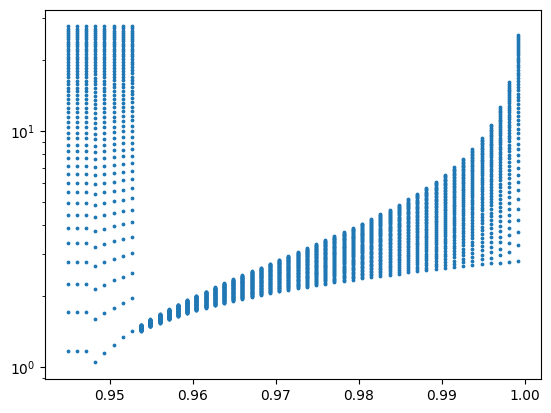

[5]
[[ 9.44912127e-01  1.17203282e+00  1.22500000e+01 -9.99990000e-01
   1.00000000e-06]
 [ 9.44912127e-01  1.71440440e+00  1.22500000e+01 -9.99990000e-01
   1.00000000e-06]
 [ 9.44912127e-01  2.25677599e+00  1.22500000e+01 -9.99990000e-01
   1.00000000e-06]
 ...
 [ 9.99246172e-01  2.46343398e+01  1.22500000e+01 -9.99990000e-01
   1.00000000e-06]
 [ 9.99246172e-01  2.50984558e+01  1.22500000e+01 -9.99990000e-01
   1.00000000e-06]
 [ 9.99246172e-01  2.55625718e+01  1.22500000e+01 -9.99990000e-01
   1.00000000e-06]]


C:\Users\camcinto\AppData\Local\Temp\1\ipykernel_17460\4001527448.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  arr.append(float(lil))


In [382]:
import random
import matplotlib.pyplot as plt
orp = random.choice(run_vals)
while orp[2] != 12.25 or orp[3] != -0.99999:
    orp = random.choice(run_vals)
print(orp[2:])
sub_vals = [val for val in run_vals if (val[2:] == orp[2:])]
plt.scatter([thing[0] for thing in sub_vals], [thing[1] for thing in sub_vals], s=3)
plt.yscale("log")
plt.show()
#plt.plot(Efunc(np.linspace(4.3,100), -0.7499925000000001, 0, 1, 0), Lfunc(np.linspace(0,50), -0.7499925000000001, 0, 1, 0))'
lenghts = []
newl = []
for val in sub_vals:
    arr = []
    for lil in val:
        arr.append(float(lil))
    newl.append(np.array(arr))
    if len(arr) not in lenghts:
        lenghts.append(len(val))

print(lenghts)
print(np.array(newl))


In [385]:
def verifyE_r(r, e, a, C, pm, loud=False, tag="none"):
    bias, bias_add = 0.1, 0.1
    rightE = Efunc(r, a, C, pm, 0)
    count = 0
    orgdiff = rightE - e
    rightE = Efunc(r + bias, a, C, pm, 0)
    print(count, r+bias, rightE, e)
    while (abs(rightE - e)/e > 0.000001) or np.iscomplex(rightE):
        count += 1 
        if count%100 == 0 or loud:
            print(count, r+bias, rightE, e, tag)
        rightE = Efunc(r + bias, a, C, pm, 0)
        if (rightE - e)*orgdiff > 0:
            bias += bias_add
        else:
            bias -= bias_add
            bias_add *= 0.1
    return r + bias

E, a, C, mu = 0.95, -0.99999, 12.25, 0
y_roots = np.sort(np.unique([root for root in np.roots([1, -C, 3*C, 0, 0, (a*C)**2]) if np.isreal(root)]))[::-1] 
oop = []
L_down, L_up = 1e9, -1e9
r_1 = np.real(y_roots[0])
if len(y_roots) == 1:
    #Where La line intersects Ea=E
    L_min, L_max = Lfunc(fsolve(Efunc, mm.find_rms(a), args=(a, C, 1, E)), a, C, 1, 0), Lfunc(fsolve(Efunc, r_isco, args=(a, C, 1, E)), a, C, 1, 0)
else:
    r_2 = np.real(y_roots[1])
    if a >= 0:
        L_max = Lfunc(fsolve(Efunc, 1.1*r_1, args=(a, C, 1, E)), a, C, 1, 0)
        if E < Efunc(fmin(Efunc, 0.9*r_2, args=(a, C, 1, 0)), a, C, 1, 0):
            L_min = 0
        else:
            L_min = max(0, Lfunc(fsolve(Efunc, 0.9*r_2, args=(a, C, 1, 0)), a, C, 1, 0))
    else:
        try:
            print("a")
            L_max = Lfunc(verifyE_r(1.01*r_1, E, a, C, -1, tag="Lmax a<0"), a, C, -1, 0)
            print("a0")
            if L_max < 0:
                print("a1")
                L_max = Lfunc(verifyE_r(1.01*r_1, E, a, C, 1, tag="Try other Lmax branch"), a, C, 1, 0)
                print("a2")
        except:
            L_max = Lfunc(fsolve(Efunc, 1.1*r_1, args=(a, C, 1, E)), a, C, 1, 0) 
        if (E < Efunc(fsolve(Lfunc, 0.9*r_2, args=(a, C, -1, 0)), a, C, -1, 0) or C >= 16):
            print("b", E < Efunc(fsolve(Lfunc, 0.9*r_2, args=(a, C, -1, 0)), a, C, -1, 0), Efunc(fsolve(Lfunc, 0.9*r_2, args=(a, C, -1, 0)), a, C, -1, 0), fsolve(Lfunc, 0.9*r_2, args=(a, C, -1, 0)))
            r = verifyE_r(1.01*r_1, E, a, C, -1, tag = "get Lmin if E less than a<0 intersect")
            print("b0", r)
            L_min = max(0, Lfunc(verifyE_r(r, E, a, C, -1, tag="Still getting Lmin"), a, C, -1, 0))
            print("b1", verifyE_r(r, E, a, C, -1), L_min)
        else:
            try:
                L_min = Lfunc(fsolve(Efunc, 0.9*r_2, args=(a, C, 1, E)), a, C, 1, 0)
            except:
                L_min = Lfunc(fsolve(Efunc, 0.9*r_2, args=(a, C, -1, E)), a, C, -1, 0)
        if E >= Efunc(fmin(Efunc, 0.9*r_2, args = (a, C, -1, 0)), a, C, -1, 0):
            print("is happen?")
            L_down = Lfunc(fsolve(Efunc, 0.9*r_2, args=(a, C, -1, E)), a, C, -1, 0)
            r = fsolve(Efunc, 0.9*r_2, args=(a, C, -1, E))
            print("YA", L_down)
            try:
                print("c")
                try:
                    print("c1")
                    L_up = Lfunc(fsolve(Efunc, r_2, args=(a, C, -1, E)), a, C, -1, 0)
                    print("c1a", L_up)
                except:
                    print("c2")
                    L_up = Lfunc(fsolve(Efunc, r_2, args=(a, C, -1, E)), a, C, -1, 0)
            except:
                print("d")
                mult, mult_add = 1, 0.1
                rightE = Efunc(mult*r_2, a, C, -1, 0)
                count = 0
                while not np.isclose(rightE, E) or np.iscomplex(rightE):
                    count += 1 
                    if count%100 == 0:
                        print(count, "First while loop!")
                    if rightE < E:
                        mult += mult_add
                    elif rightE > E:
                        mult -= mult_add*0.9
                        mult_add = mult_add/10
                    rightE = Efunc(mult*r_2, a, C, -1, 0)
                L_up = Lfunc(mult*r_2, a, C, -1, 0)
n = 50
while len([val for val in np.linspace(L_min, L_max, n) if (val < L_down or val > L_up)]) < 50:
    n += 1
    #if n%100 == 0:
    #    print(n, "Second while loop!", r_isco, L_min, L_down, L_up, L_max, E_min, E_max, a, C, E, "yo", (E < Efunc(fsolve(Lfunc, 0.9*r_2, args=(a, C, -1, 0)), a, C, -1, 0) or C >= 16), max(0, Lfunc(fsolve(Efunc, 1.1*r_1, args = (a, C, -1, E)), a, C, -1, 0)), fsolve(Lfunc, 0.9*r_2, args=(a, C, -1, 0)), y_roots)
                #100 Second while loop! [nan] 1000000000.0 -1000000000.0 [-inf] 1.0 0.0 [nan] yo False 0 [9.01010371] [0.]
for L in [L_val for L_val in np.unique(np.linspace(L_min, L_max, n)) if (L_val < L_down or L_val > L_up)]:
    oop.append([E, float(L), C, a, mu])

#print(y_roots)
print(L_min, L_down, L_up, L_max)
print(np.unique(np.array(oop)[:,1]))

a
0 6.790667356165253 0.9451231195347971 0.95
a0
a1
0 6.790667356165253 0.9476177532648387 0.95
a2
b [ True] [0.95290907] [3.99336559]
0 6.790667356165253 0.9451231195347971 0.95
b0 8.801667356165254
0 8.901667356165254 0.9503766583176791 0.95
0 8.901667356165254 0.9503766583176791 0.95
b1 8.801667356165254 0
Optimization terminated successfully.
         Current function value: 0.945611
         Iterations: 13
         Function evaluations: 26
is happen?
YA [0.11716031]
c
c1
c1a [1.01378647]
0 [0.11716031] [1.01378647] 1.208211768083323
[0.         0.00646103 0.01292205 0.01938308 0.0258441  0.03230513
 0.03876615 0.04522718 0.0516882  0.05814923 0.06461025 0.07107128
 0.07753231 0.08399333 0.09045436 0.09691538 0.10337641 0.10983743
 0.11629846 1.014381   1.02084203 1.02730305 1.03376408 1.04022511
 1.04668613 1.05314716 1.05960818 1.06606921 1.07253023 1.07899126
 1.08545228 1.09191331 1.09837433 1.10483536 1.11129639 1.11775741
 1.12421844 1.13067946 1.13714049 1.14360151 1.1500625

C:\Users\camcinto\AppData\Local\Temp\1\ipykernel_17460\474124032.py:9: RuntimeWarning: invalid value encountered in sqrt
  Efunc = lambda r, a, C, pm, val: ((r**3)*(r - 2) - a*(a*C - pm*(Yfunc(r, a, C))**0.5))/((r**2)*np.sqrt((r**3)*(r - 3) - 2*a*(a*C - pm*(Yfunc(r, a, C))**0.5))) - val
C:\Users\camcinto\AppData\Local\Temp\1\ipykernel_17460\2861717427.py:67: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  L_up = Lfunc(fsolve(Efunc, r_2, args=(a, C, -1, E)), a, C, -1, 0)


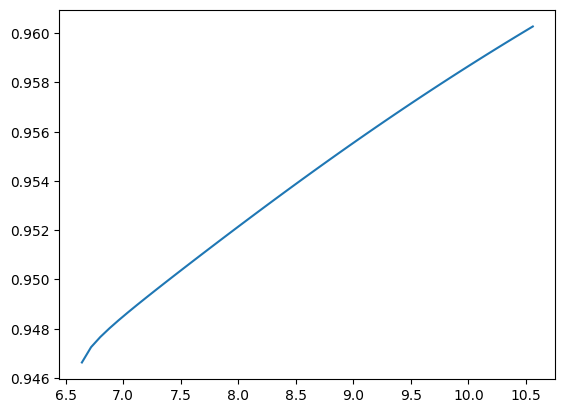

In [341]:
plt.plot(np.linspace(6.64, 10.56), Efunc(np.linspace(6.64, 10.56), -0.99999, 12.25, 1, 0))

In [384]:
mm.set_u_kerr(-0.99999, [9.44912127e-01,  1.17203282e+00,  1.22500000e+01])

(array([ 0.        ,  1.90067414,  1.57079633,  0.        ,  8.11888195,
        -1.03880691, -0.96884145, -1.3012055 ]),
 [0.944912127, 1.17203282, 12.25])

Running sim 4195 of 68581.


c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MetricMathStreamline.py:2272: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  Pk = integrate.quad(lambda p: 1/((1-(zm*np.sin(p))**2)*np.sqrt(1 - k*(np.sin(p)**2))), 0, np.pi/2)[0]
c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MainLoopStreamline.py:803: RuntimeWarning: invalid value encountered in arccos
  inc = np.arccos(np.sqrt(z2))
C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\numpy\ma\core.py:3413: ComplexWarning: Casting complex values to real discards the imaginary part
  _data[indx] = dval
C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\matplotlib\cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
C:\Users\c


Ending program
Running sim 4958 of 68581.


c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MetricMathStreamline.py:2250: RuntimeWarning: invalid value encountered in arccos
  k, i = (zm**2)/(zp**2), np.arccos(zm)


Running sim 6482 of 68581.

Ending program
Running sim 22135 of 68581.

Ending program
Running sim 27474 of 68581.
Running sim 29766 of 68581.

Ending program
Running sim 30148 of 68581.


c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MetricMathStreamline.py:2272: IntegrationWarning: The algorithm does not converge.  Roundoff error is detected
  in the extrapolation table.  It is assumed that the requested tolerance
  cannot be achieved, and that the returned result (if full_output = 1) is 
  the best which can be obtained.
  Pk = integrate.quad(lambda p: 1/((1-(zm*np.sin(p))**2)*np.sqrt(1 - k*(np.sin(p)**2))), 0, np.pi/2)[0]



Ending program
Running sim 35054 of 68581.
Running sim 35114 of 68581.
Running sim 35155 of 68581.
Running sim 35235 of 68581.
Running sim 35335 of 68581.
Running sim 35435 of 68581.
Running sim 35475 of 68581.
Running sim 35495 of 68581.
Running sim 35496 of 68581.
Running sim 35497 of 68581.
Running sim 35518 of 68581.
Running sim 35578 of 68581.
Running sim 35598 of 68581.
Running sim 35638 of 68581.
Running sim 35678 of 68581.
Running sim 35718 of 68581.
Running sim 35778 of 68581.
Running sim 35798 of 68581.
Running sim 35838 of 68581.
Running sim 35858 of 68581.
Running sim 35878 of 68581.
Running sim 35879 of 68581.
Running sim 36000 of 68581.
Running sim 36040 of 68581.
Running sim 36060 of 68581.
Running sim 36100 of 68581.
Running sim 36200 of 68581.
Running sim 36260 of 68581.
Running sim 36281 of 68581.
Running sim 36301 of 68581.
Running sim 36321 of 68581.
Running sim 36341 of 68581.
Running sim 36421 of 68581.
Running sim 36461 of 68581.
Running sim 36481 of 68581.
Runn

C:\Users\camcinto\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\scipy\integrate\_quadpack_py.py:606: ComplexWarning: Casting complex values to real discards the imaginary part
  return _quadpack._qagse(func,a,b,args,full_output,epsabs,epsrel,limit)



Ending program
Running sim 45450 of 68581.
Running sim 45470 of 68581.
Running sim 45490 of 68581.
Running sim 45550 of 68581.
Running sim 45650 of 68581.
Running sim 45710 of 68581.
Running sim 45750 of 68581.
Running sim 45790 of 68581.
Running sim 45811 of 68581.
Running sim 45891 of 68581.
Running sim 45991 of 68581.
Running sim 46051 of 68581.
Running sim 46071 of 68581.
Running sim 46131 of 68581.
Running sim 46234 of 68581.
Running sim 46274 of 68581.
Running sim 46294 of 68581.
Running sim 46374 of 68581.
Running sim 46434 of 68581.
Running sim 46494 of 68581.
Running sim 46575 of 68581.
Running sim 46656 of 68581.
Running sim 46676 of 68581.
Running sim 46756 of 68581.
Running sim 46816 of 68581.
Running sim 46957 of 68581.

Ending program
Running sim 46997 of 68581.
Running sim 47017 of 68581.
Running sim 47037 of 68581.
Running sim 47137 of 68581.
Running sim 47277 of 68581.
Running sim 47297 of 68581.
Running sim 47337 of 68581.
Running sim 47398 of 68581.
Running sim 4741

c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MainLoopStreamline.py:247: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()



Ending program
Running sim 51939 of 68581.
Running sim 52099 of 68581.
Running sim 52139 of 68581.
Running sim 52159 of 68581.
Running sim 52239 of 68581.
Running sim 52259 of 68581.
Running sim 52302 of 68581.

Ending program
Running sim 52322 of 68581.
Running sim 52342 of 68581.
Running sim 52382 of 68581.
Running sim 52422 of 68581.
Running sim 52442 of 68581.
Running sim 52502 of 68581.
Running sim 52542 of 68581.
Running sim 52602 of 68581.
Running sim 52622 of 68581.
Running sim 52662 of 68581.
Running sim 52683 of 68581.

Ending program
Running sim 52703 of 68581.
Running sim 52723 of 68581.
Running sim 52743 of 68581.
Running sim 52783 of 68581.
Running sim 52803 of 68581.
Running sim 52823 of 68581.
Running sim 53023 of 68581.
Running sim 53043 of 68581.
Running sim 53063 of 68581.
Running sim 53065 of 68581.

Ending program
Running sim 53085 of 68581.
Running sim 53125 of 68581.
Running sim 53185 of 68581.
Running sim 53205 of 68581.
Running sim 53245 of 68581.
Running sim 

c:\Users\camcinto\OneDrive - NASA\Documents\GitHub\Black-Hole-Stuff\MetricMathStreamline.py:2272: RuntimeWarning: divide by zero encountered in scalar divide
  Pk = integrate.quad(lambda p: 1/((1-(zm*np.sin(p))**2)*np.sqrt(1 - k*(np.sin(p)**2))), 0, np.pi/2)[0]


Running sim 59870 of 68581.
Running sim 59871 of 68581.
Running sim 59872 of 68581.
Running sim 59873 of 68581.
Running sim 59874 of 68581.
Running sim 59875 of 68581.
Running sim 59876 of 68581.
Running sim 59877 of 68581.
Running sim 59878 of 68581.
Running sim 59879 of 68581.
Running sim 59880 of 68581.
Running sim 59881 of 68581.
Running sim 59882 of 68581.
Running sim 59883 of 68581.
Running sim 59884 of 68581.
Running sim 59885 of 68581.
Running sim 59886 of 68581.
Running sim 59887 of 68581.
Running sim 59888 of 68581.
Running sim 59889 of 68581.
Running sim 59890 of 68581.
Running sim 59891 of 68581.
Running sim 59892 of 68581.
Running sim 59893 of 68581.
Running sim 59894 of 68581.
Running sim 59895 of 68581.
Running sim 59896 of 68581.
Running sim 59897 of 68581.
Running sim 59898 of 68581.
Running sim 59899 of 68581.
Running sim 59900 of 68581.
Running sim 59901 of 68581.
Running sim 59902 of 68581.
Running sim 59903 of 68581.
Running sim 59904 of 68581.
Running sim 59905 of

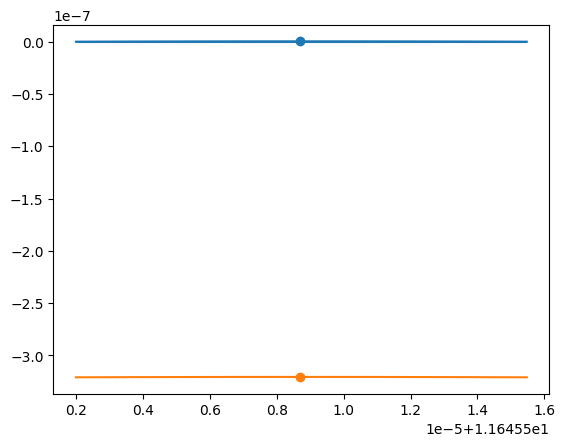

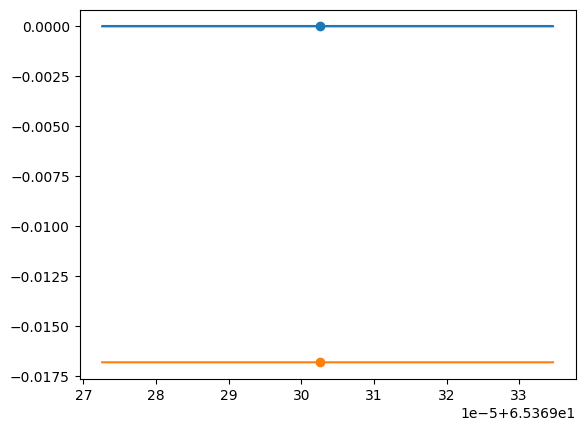

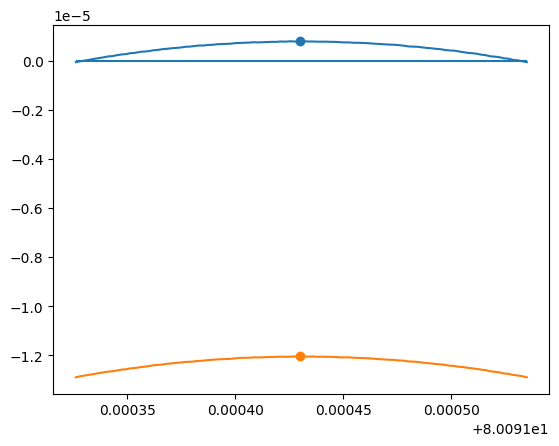

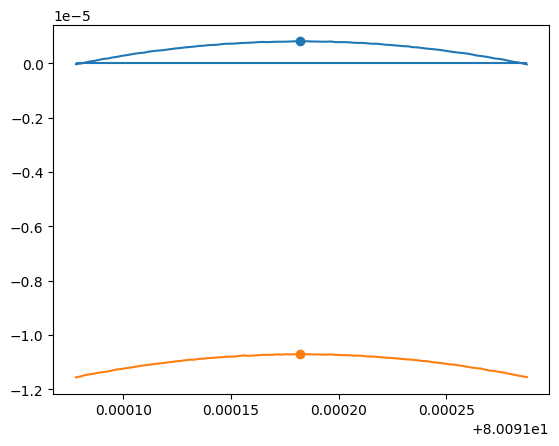

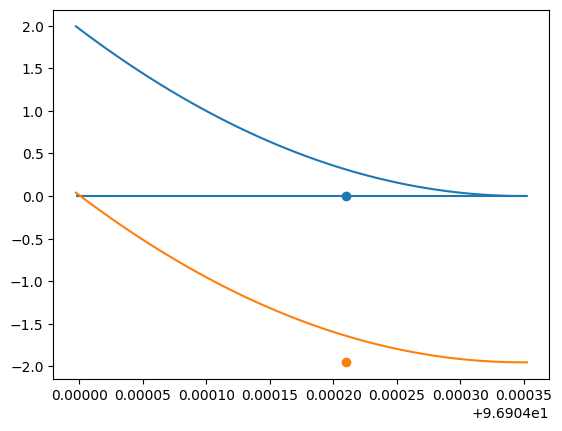

...

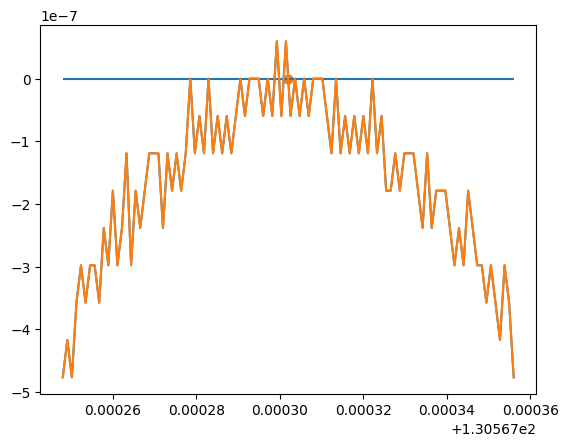

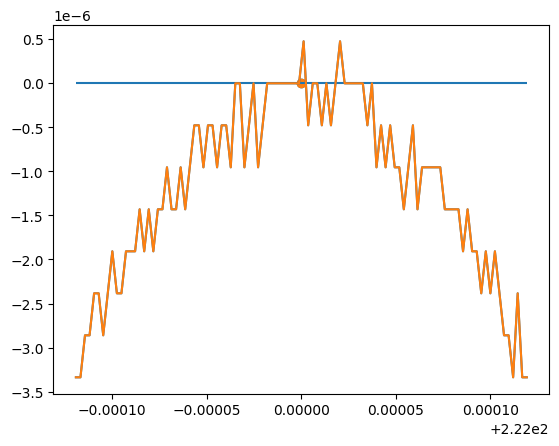

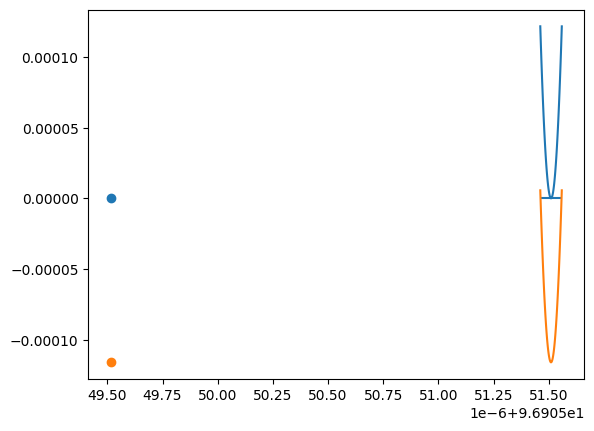

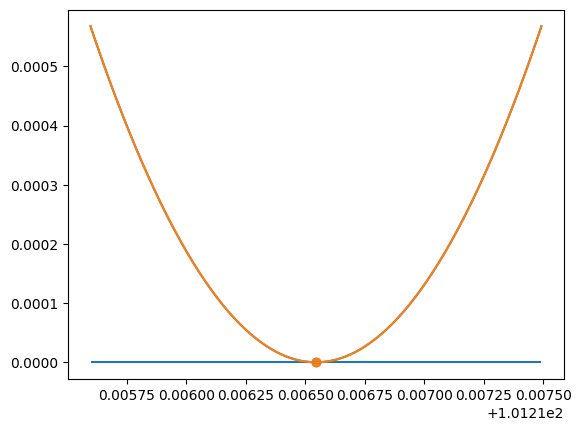

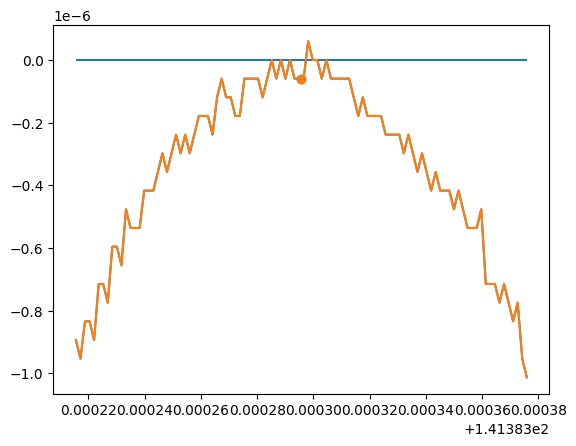

In [1]:
#Okay All my shit is gone which is GREAT AWESOME COOL
#But the important stuff is saved I just have to remake the function stuff
#I really thought I saved it ha HA

import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt

readfile = open("param_space2b.txt", "r")
full_len = len(readfile.readlines())
readfile.close()

checkfile = open("param_space_data2.txt", "r")
sub_goo = [thing.split(":") for thing in checkfile.readlines()]
keylist = {key: val[1:-1] for key, val in sub_goo}
checkfile.close()

readfile = open("param_space2b.txt", "r")
writefile = open("param_space_data2.txt", "a")

num = 0
for key in readfile.readlines():
    num += 1
    key = key[:-1]
    if key in keylist.keys() and "nan" not in keylist[key]:
        pass
        #print("Sim %s of %s already completed."%(num, full_len))
    else:
        E, L, C, a, mu = eval(key)
        try:
            #print(E, L, C, a, mu)
            print("Running sim %s of %s."%(num, full_len))
            sim = ml.EMRIGenerator( a, mu, endflag="rad_orbit > 5", cons=[E, L, C], bonk=3, label="wenk", trigger=2, err_target=1e-14, conch=100, verbose=0)
            if sim["stop"] == True:
                abort = input("Did this break? Type anything to abort, or just enter to continue. ")
                if abort != "":
                    writefile.write("%s: %s\n"%(key, np.nan*np.ones(14)))
                    break
            else:
                vals = [sim["plunge"], sim["stop"], np.real(sim["p"][0]), np.real(sim["e"][0]), np.real(sim["inc"][0])]
                for thing in ["tracktime", "time", "energy", "phi_momentum", "carter", "r0", "p", "e", "inc"]:
                    vals.append(np.real(sim[thing][-1] - sim[thing][0]))
                writefile.write("%s: %s\n"%(key, vals))
        except:
            print("Error running sim %s of %s."%(num, full_len))
            #print("%s: %s\n"%(key, np.nan*np.ones(14)))
            writefile.write("%s: %s\n"%(key, np.nan*np.ones(14)))

#sim = ml.EMRIGenerator(a, 1e-5, endflag="rad_orbit > 5", params=[p/(1 - e**2), e, 0.5*np.pi], bonk=3, label="wink p=%s, e=%s"%(p, e), trigger=2, err_target=1e-14, conch=100)
readfile.close()
print(E, L, C, a, mu)
#print(num)
#print(bark[0])
#print(keylist[0])
#print(bark[0][:-1] in keylist)

In [35]:
'''readfile = open("param_space_data2.txt", "r")
data_dict = {}
fail_dict = {}
for line in readfile.readlines():
    key, val = line.split(": ")
    try:
        data_dict[tuple(eval(key))] = eval(val)
    except:
        fail_dict[key] = val
readfile.close()
'''
print(len(fail_dict), len(data_dict))

writefile = open("param_space_data_2b.txt", "w")
key_str = ["E", "L", "C", "a", "mu"]
key_str = "[{:^20}|{:^20}|{:^20}|{:^15}|{:^10}]".format(*key_str)
val_str = ["plunge", "stop", "initial p", "initial e", "initial inc", "tracktime", "time", "delta_E", "delta_L", "delta_C", "delta_r0", "delta_p", "delta_e", "delta_inc"]
val_str = "[{:^8}|{:^8}|{:^28}|{:^28}|{:^28}|{:^28}|{:^28}|{:^28}|{:^28}|{:^28}|{:^28}|{:^28}|{:^28}|{:^28}]".format(*val_str)
writefile.write("%s: %s\n"%(key_str, val_str))
for key, val in data_dict.items():
    key_str = "[{:^20}|{:^20}|{:^20}|{:^15}|{:^10}]".format(*key)
    val_str = "[{:^8}|{:^8}|{:^28}|{:^28}|{:^28}|{:^28}|{:^28}|{:^28}|{:^28}|{:^28}|{:^28}|{:^28}|{:^28}|{:^28}]".format(*val)
    writefile.write("%s: %s\n"%(key_str, val_str))
writefile.close()
#put all the info in a dictionary (any duplicates will get overwritten)
#close file
#open new file
#put everything in the new file
#close new file
#order doesn't really matter I guess, it's just convenient



1253 68581


In [ ]:
data_key = []
data_val = []
for item in data_dict.items():
    if item[0][3] == -0.99999 and item[0][2] == 0:
        data_key.append(item[0])
        data_val.append(item[1])

data_key, data_val = np.array(data_key), np.array(data_val)
plt.scatter(data_key[:,0], data_key[:,1], c=data_val[:,])

381
381


In [51]:
import MetricMathStreamline as mm
import MainLoopStreamline as ml
import OrbitPlotter as op
import numpy as np
import matplotlib.pyplot as plt

sim = ml.EMRIGenerator(a, mu, endflag="rad_orbit > 5", cons=[E, L, C], bonk=3, label="wenk", trigger=2, err_target=1e-14, conch=100)

print(sim["plunge"])
print(sim["stop"])
print(sim["p"][0])
print(sim["e"][0])
print(sim["inc"][0])
for thing in ["tracktime", "time", "energy", "phi_momentum", "carter", "r0", "p", "e", "inc"]:
    print(np.real(sim[thing][-1] - sim[thing][0]))


#print(sim["inc"])
#print(mm.root_getter(0.988412718775125, 0.0, 44.765973939582565, -0.99999))
op.plotvalue3(sim, "time", "radius")
op.plotvalue3(sim, "time", "theta")
op.plotvalue3(sim, "time", "phase")
op.plotvalue3(sim, "tracktime", "inc")


Normalizing initial state


TypeError: EMRIGenerator.<locals>.viable_cons() missing 1 required positional argument: 'a'

In [32]:
checkfile = open("param_space_data2.txt", "r")
sub_goo = [thing.split(":") for thing in checkfile.readlines()]
file_dict = {key: val[1:-1] for key, val in sub_goo}
checkfile.close()
print(len(sub_goo))
print(len(file_dict))
print(sub_goo[459])
print(file_dict[sub_goo[459][0]])
wrong = 0
for thing in sub_goo:
    if len(thing) != 2:
        wrong += 1
print(wrong)

all_keys = list(np.array(sub_goo)[:,0])
dict_keys = list(file_dict.keys())

36727
35060
['[0.9751367982921813, 4.472142924407794, 0.004489911251762354, -0.99999, 1e-12]', ' [nan nan nan nan nan nan nan nan nan nan nan]\n']
[nan nan nan nan nan nan nan nan nan nan nan]
0


In [50]:
file = open("param_space2b.txt", "w")
readfile = open("param_space2.txt", "r")
stuff = np.array((readfile.readlines()))
readfile.close()

_, idx = np.unique(stuff, return_index=True)
vals = stuff[np.sort(idx)]



print(len(vals))
for thing in vals:
    file.write(thing)
file.close()
print(vals[:10])

68581
['[0.9624052582538133, 4.238129374336959, 0.0, -0.99999, 1e-12]\n'
 '[0.9624053658706166, 4.238129374336959, 0.0, -0.99999, 1e-12]\n'
 '[0.962405607901839, 4.238129374336959, 0.0, -0.99999, 1e-12]\n'
 '[0.9624059548582253, 4.238129374336959, 0.0, -0.99999, 1e-12]\n'
 '[0.9624063942636005, 4.238129374336959, 0.0, -0.99999, 1e-12]\n'
 '[0.9624069183341106, 4.238129374336959, 0.0, -0.99999, 1e-12]\n'
 '[0.9624075215282254, 4.238129374336959, 0.0, -0.99999, 1e-12]\n'
 '[0.9624081996041536, 4.238129374336959, 0.0, -0.99999, 1e-12]\n'
 '[0.9624089491605013, 4.238129374336959, 0.0, -0.99999, 1e-12]\n'
 '[0.962409767379634, 4.238129374336959, 0.0, -0.99999, 1e-12]\n']


In [56]:
list(keylist.keys())[0]

'[0.9624052582538133, 4.238129374336959, 0.0, -0.99999, 1e-12]'

In [62]:
checkfile = open("param_space_data2.txt", "r")
sub_goo = [thing.split(":") for thing in checkfile.readlines()]
for thing in sub_goo:
    if len(thing) != 2:
        print(thing, sub_goo.index(thing))
keylist = {key: val[1:-1] for key, val in sub_goo}
checkfile.close()

In [ ]:
big_data = {}
checkfile = open("param_space_data_2b.txt", "r")
for line in checkfile.readlines():
    key, val = line.split(":")
    key, val = [eval(bit) for bit in key[1:-1].split("|")], [eval(bit) for bit in val[2:-1].split("|")]
    big_data[tuple(key)] = val
checkfile.close()

In [ ]:

def jumper(data, key):
    if key not in data.keys():
